# To run this code for the first time, you need to uncomment and run the code in the following cell.

In [1]:
# %%capture
# !pip install -r requirements.txt
# import nltk
# nltk.download('stopwords')
# !pip install --upgrade numpy==1.22

In [2]:
%%capture
from __future__ import annotations

# To reload modules on update without restarting the kernel
%load_ext autoreload
%autoreload 2

from helpers import Corpus, Model
from sentence_transformers import SentenceTransformer

In [3]:
core_concepts = {
    "artificial intelligence" : {
        "ai domain" : {}, 
        "ai system" : { 
            "no risk ai system" : {},
            "high risk ai system" : {},
            "low risk ai system" : {},
            "ai system properties" : {}
            
        },
        "ai system development process" : {
            "ai system approach" : {},
            "ai system quality measure" : {}, 
            
        },
    },

    "data" : {
        "personal data" : {},
        "anonymous data" : {},
    },

    "organization or person" : {
        "provider" : {},
        "user" : {
            "affected entity" : {},
        },
        "regulator" : {
            "eu country" : {},
        },
    },

    "risk": {
        "data risk" : {
            "poisoning risk" : {},
        },
        "system risk" : {
            "terrorist attack risk" : {},
        },
        "risk management" : {},
    },

    "law": {
        "regulation": {
            "right": {},
            "rule": {},
            "requirement": {},
            "obligation": {},
        },
        "law text": {},
        "authority": {},
    },

    "market": {
        "product": {}, # 
        "service": {}, # 
    },

    "other": {},
}

# Test Function

In [4]:
# get core ontology of cs corpus
def read_cs_core_ontology(path):
    core_dict = {}
    with open(path,"r") as f:
        lines = f.readlines()   
        i = 0
        while i < len(lines):
            core_concept = lines[i].strip("\n")
            core_dict[core_concept] ={}
            hyponyms = lines[i+1].strip("\n").split(",")[:10] # only use the first ten hyponyms(CC-seeds)
            for hyponym in hyponyms:
                core_dict[core_concept][hyponym] = {}
            i += 2
    core_dict["other"]= {}
    return core_dict


# remove all hyponym relation from core ontology, only keep the core concepts.
def flatten_dict(d):
    """
    flatten dict
    """
    items = {}
    for k, v in d.items():
        if not v=={}:
            items.update(flatten_dict(v).items())
        items[k]={}
#     print(items)
    return dict(items)

In [23]:
# import csv
# import os
import pandas as pd

def run_and_store_results(clusterer = "c-dbscan",
                          reducer = "umap",
                          classifier = None,
                          iterations = [1,2,5,10,15],
                          cc_removal = False,
                          dimensions = 10,
                          min_points = 4,
                          prefix = "",
                          corpus_name = "ai"):
    """
    test function
    """
    
    results = []
    prediction_df = []
    iterations = iterations
    for iteration in iterations:
        
        print(str(iteration)+" iterations:")
#         core_ontology = core_concepts
        
        if corpus_name == "cs":
            source = source = r".\Data\transformed_cs_file.csv"
#             columns = ["term","label"]
            corpus = Corpus(
                source=source,
                core_concepts=read_cs_core_ontology(r".\Data\cs_seed_words.txt"),
#                 columns = columns
            )
        else:
            source = r".\Data\IA Regulation Taxonomy.xlsx"#r".\Data\new term classification risk.xlsx"#
            corpus = Corpus(
                source=source,
                core_concepts=core_concepts,
                prefix=prefix
            )
        
        corpus.extract_terms_from_onto()
        
        X, y = corpus.get_training_data()
        
        model = Model(corpus, min_points=min_points, dimensions=dimensions, clusterer=clusterer, classifier=classifier,reducer=reducer)

        y_pred = model.iterate(X, y, iteration, verbose=1)

        # result showing 
        
        accuracy = model.accuracy
        precision = model.precision
        recall = model.recall
        f1 = model.f1
        silhouette = model.silhouette_scores[-1] if not len(model.silhouette_scores) == 0 else None
        davies_bouldin = model.davies_bouldin_scores[-1] if not len(model.davies_bouldin_scores) == 0 else None
        calinski_harabasz = model.calinski_harabasz_scores[-1] if not len(model.calinski_harabasz_scores) == 0 else None

        results.append([accuracy, precision, recall, f1,silhouette,davies_bouldin,calinski_harabasz])
        
        prediction_df.append(model.pred_df)
        
        if classifier is not None or clusterer in ["cosine","dbscan"]:
            iterations = iterations[:1]
            break
    
    
    
    if classifier==None:
        print()
        print("Summary:")
        df = pd.DataFrame(results,columns=["Accuracy", "Precision", "Recall", "F1", "Silhouette","Davies Bouldin","Calinski Harabasz"])
        df.index = iterations 
        print(df)
    
    
    return prediction_df

       

# Corpus：AI Act ( 900 terms)
## All the experimentations of the paper

## 1. Default Setting

1 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
0.09526011


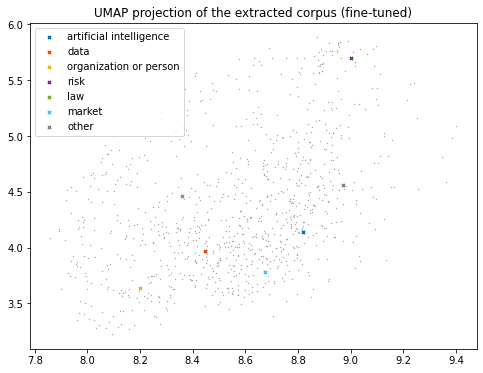

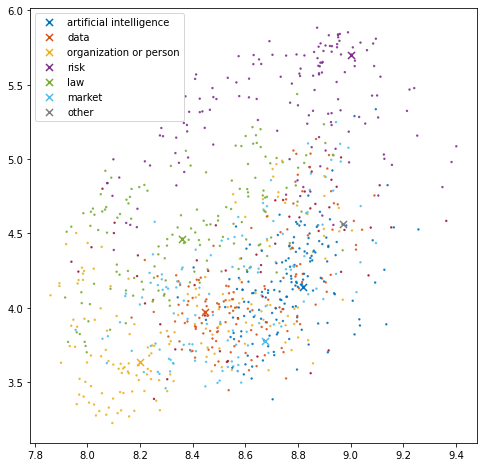

cluster size :
|-artificial intelligence : 152
|-data : 142
|-organization or person : 168
|-risk : 144
|-law : 148
|-market : 127
|-other : 55
  |-unlabeled terms within 'other': 0


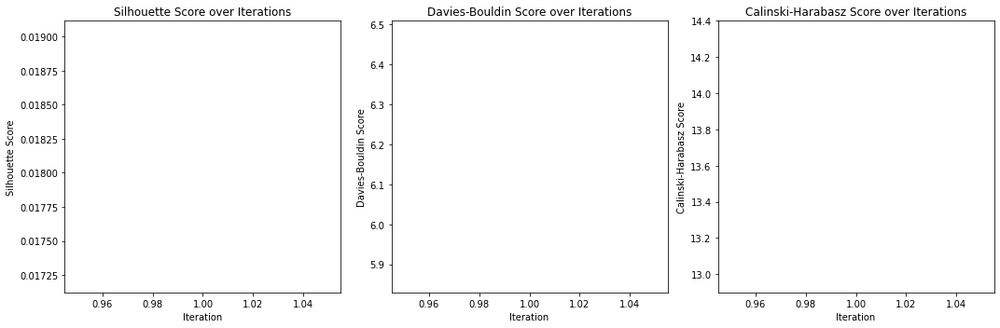

Silhouette : 0.018118415
Davies Bouldin : 6.169077808826984
Calinski Harabasz : 13.64951464777411


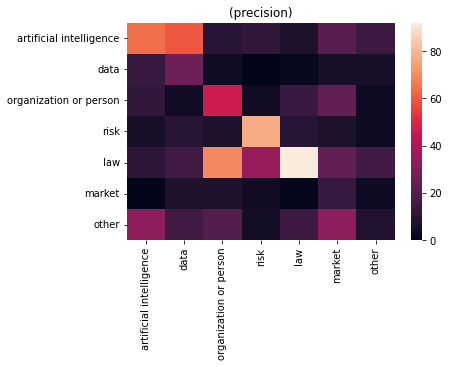

size of predicted terms: 900
Accuracy : 0.3622222222222222
Precision : 0.4315877908305657
Recall : 0.3622222222222222
f1 : 0.3706447921966653
                      Term               Prediction Ground truth
0                    point  artificial intelligence        other
1       regulatory sandbox                      law          law
2      data protection law                     risk          law
3     particular situation                     risk          law
4  common procedure (other   organization or person          law


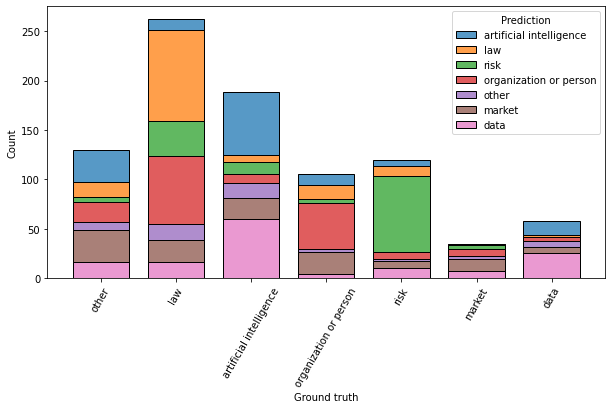

2 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.0051301536


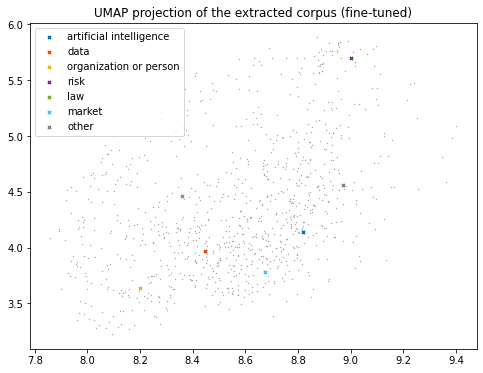

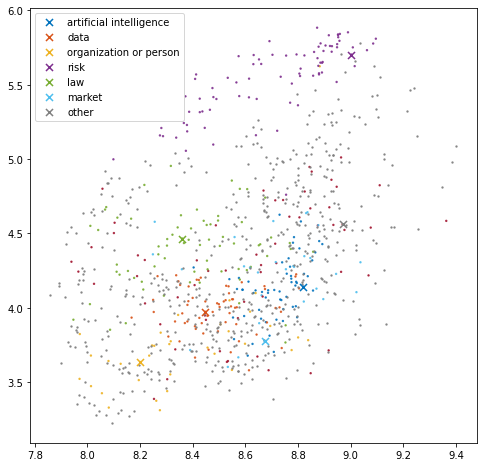

cluster size :
|-artificial intelligence : 57
|-data : 63
|-organization or person : 35
|-risk : 82
|-law : 69
|-market : 29
|-other : 601
  |-unlabeled terms within 'other': 541
0.13592453


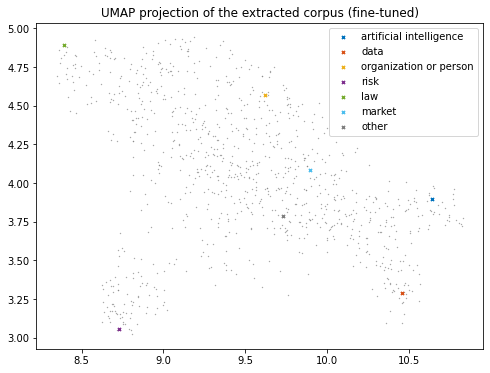

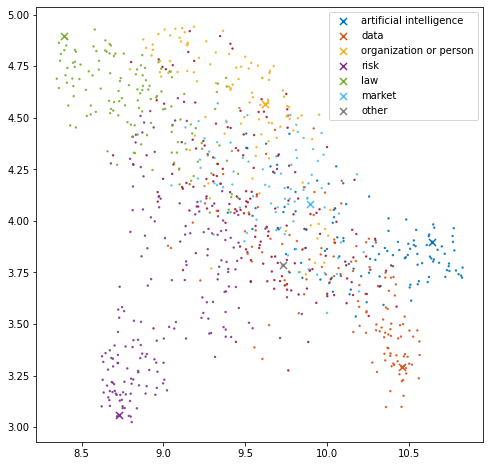

cluster size :
|-artificial intelligence : 115
|-data : 131
|-organization or person : 104
|-risk : 190
|-law : 142
|-market : 84
|-other : 170
  |-unlabeled terms within 'other': 0


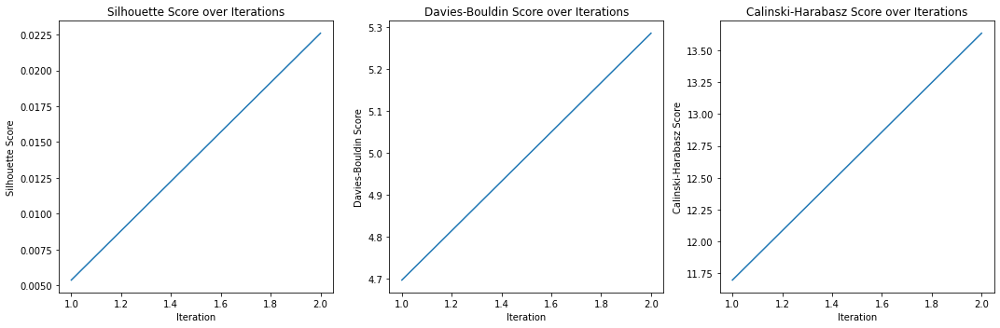

Silhouette : 0.022592036
Davies Bouldin : 5.2858774569747204
Calinski Harabasz : 13.633886872280543


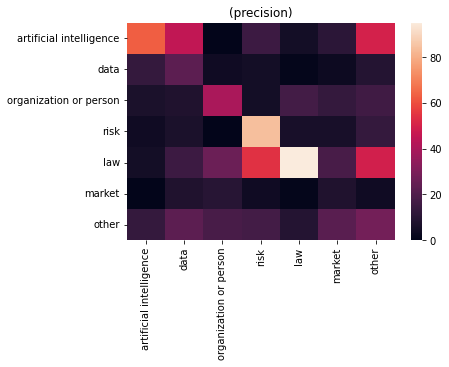

size of predicted terms: 900
Accuracy : 0.3788888888888889
Precision : 0.48058946712005973
Recall : 0.3788888888888889
f1 : 0.3978158662274808
                      Term Prediction Ground truth
0                    point     market        other
1       regulatory sandbox        law          law
2      data protection law       risk          law
3     particular situation       risk          law
4  common procedure (other      other          law


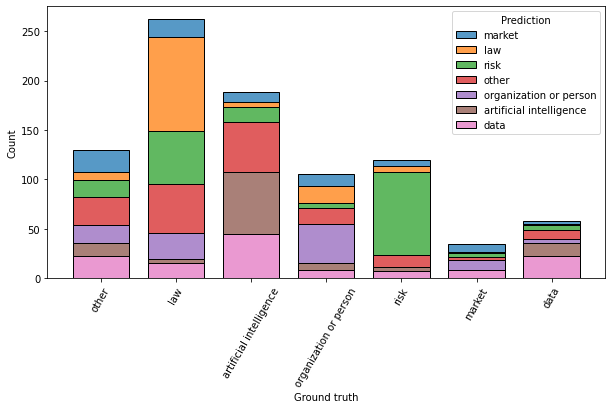

5 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.0051301536


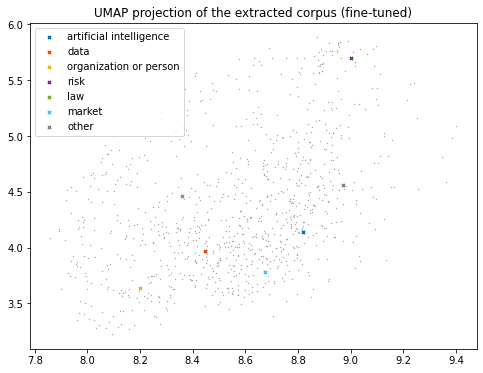

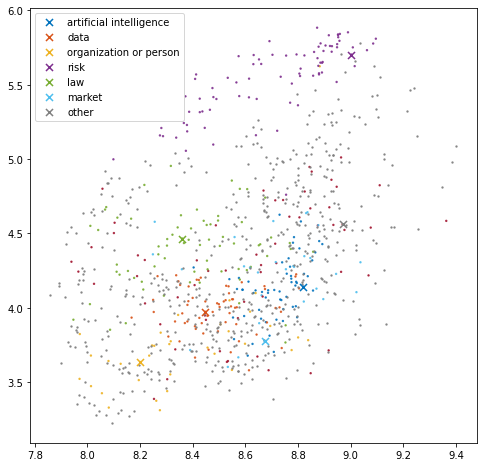

cluster size :
|-artificial intelligence : 57
|-data : 63
|-organization or person : 35
|-risk : 82
|-law : 69
|-market : 29
|-other : 601
  |-unlabeled terms within 'other': 541
0.10663835


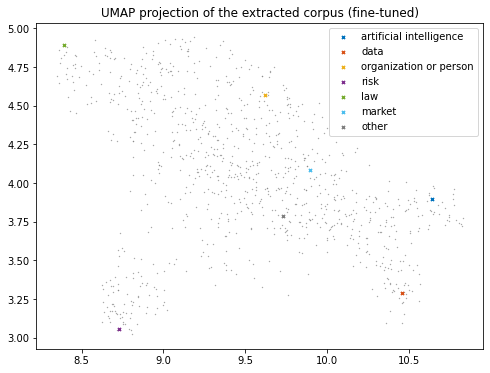

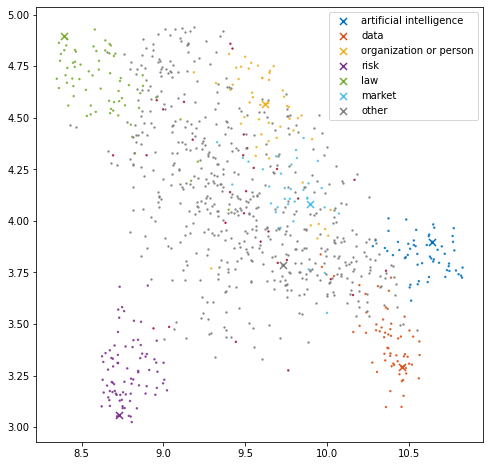

cluster size :
|-artificial intelligence : 57
|-data : 63
|-organization or person : 52
|-risk : 82
|-law : 69
|-market : 35
|-other : 578
  |-unlabeled terms within 'other': 547
0.13209267


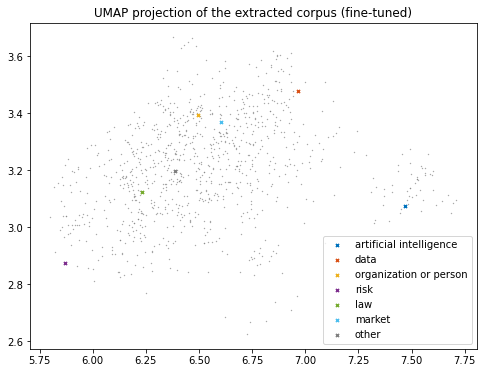

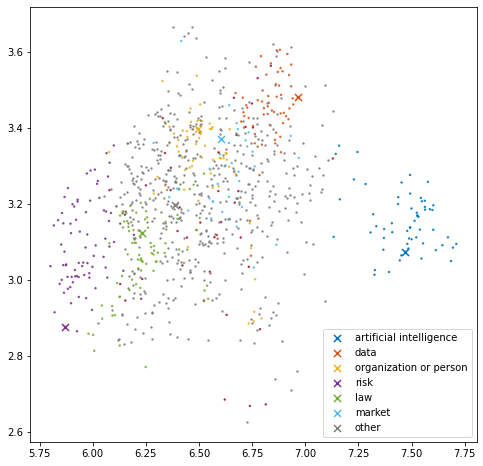

cluster size :
|-artificial intelligence : 59
|-data : 63
|-organization or person : 62
|-risk : 82
|-law : 89
|-market : 38
|-other : 543
  |-unlabeled terms within 'other': 504
0.17843321


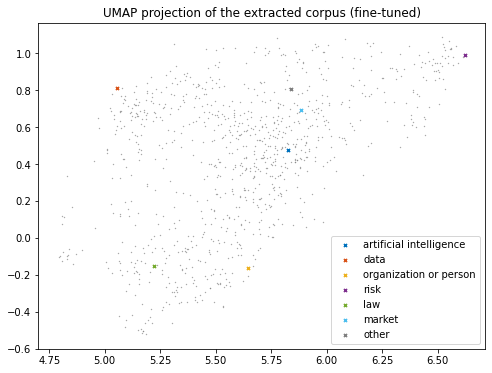

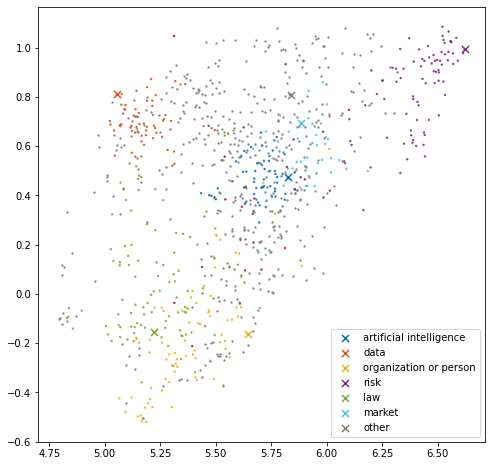

cluster size :
|-artificial intelligence : 60
|-data : 63
|-organization or person : 82
|-risk : 82
|-law : 101
|-market : 40
|-other : 508
  |-unlabeled terms within 'other': 478
0.19025019


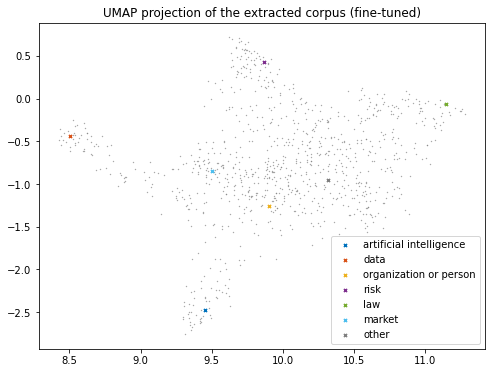

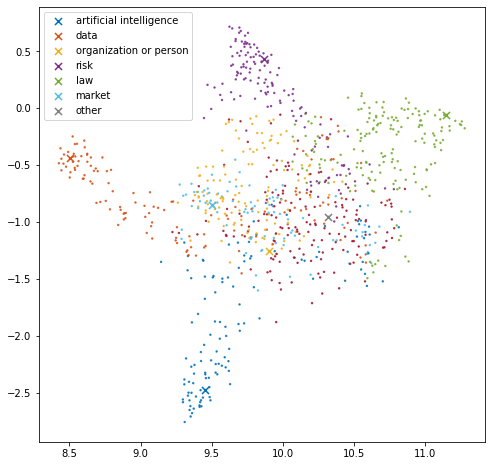

cluster size :
|-artificial intelligence : 122
|-data : 143
|-organization or person : 126
|-risk : 139
|-law : 171
|-market : 86
|-other : 149
  |-unlabeled terms within 'other': 0


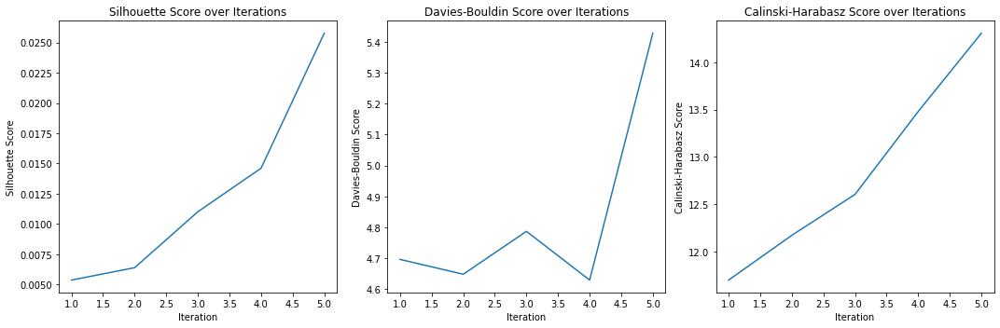

Silhouette : 0.025763815
Davies Bouldin : 5.42742707342254
Calinski Harabasz : 14.307225593346848


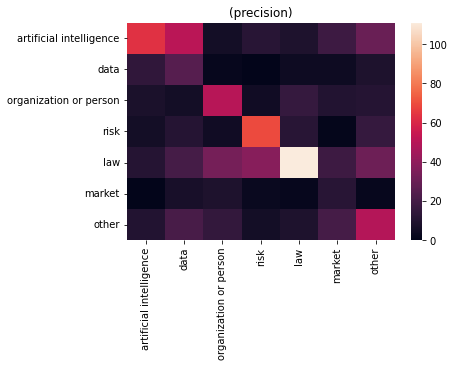

size of predicted terms: 900
Accuracy : 0.4211111111111111
Precision : 0.4994849479179776
Recall : 0.4211111111111111
f1 : 0.43983199610967316
                      Term Prediction Ground truth
0                    point      other        other
1       regulatory sandbox        law          law
2      data protection law       risk          law
3     particular situation     market          law
4  common procedure (other       data          law


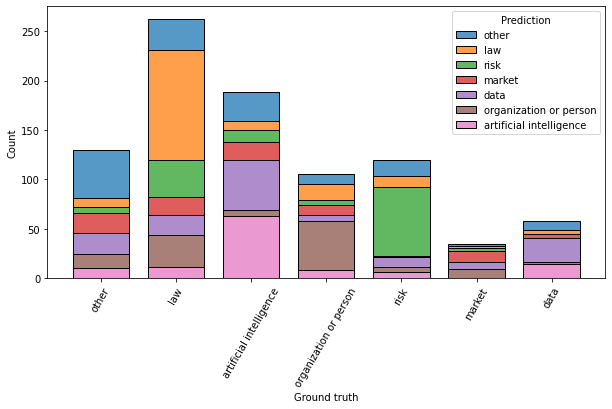

10 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.0051301536


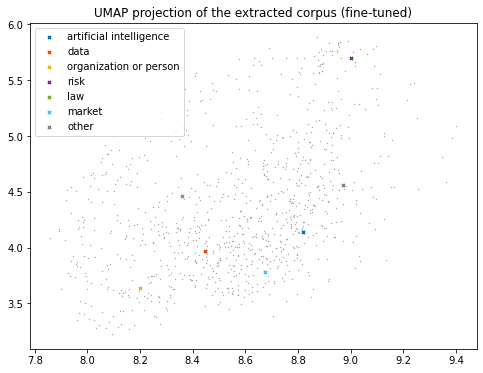

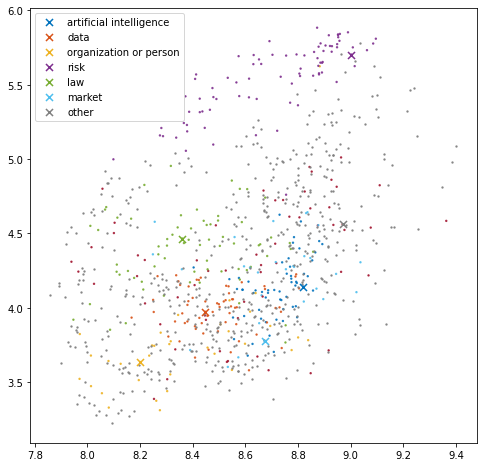

cluster size :
|-artificial intelligence : 57
|-data : 63
|-organization or person : 35
|-risk : 82
|-law : 69
|-market : 29
|-other : 601
  |-unlabeled terms within 'other': 541
0.10663835


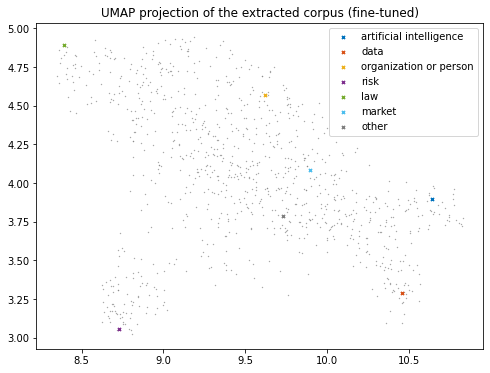

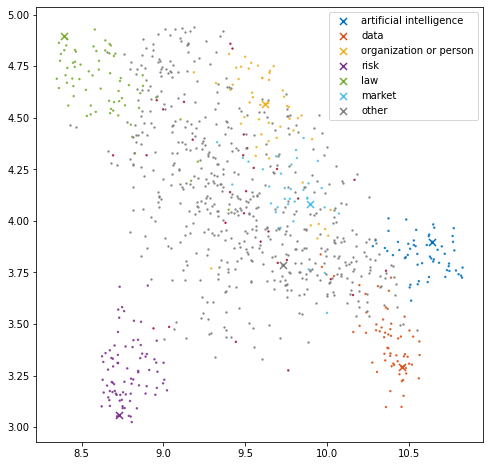

cluster size :
|-artificial intelligence : 57
|-data : 63
|-organization or person : 52
|-risk : 82
|-law : 69
|-market : 35
|-other : 578
  |-unlabeled terms within 'other': 547
0.13209267


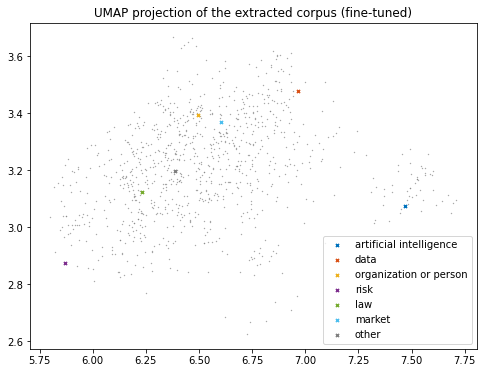

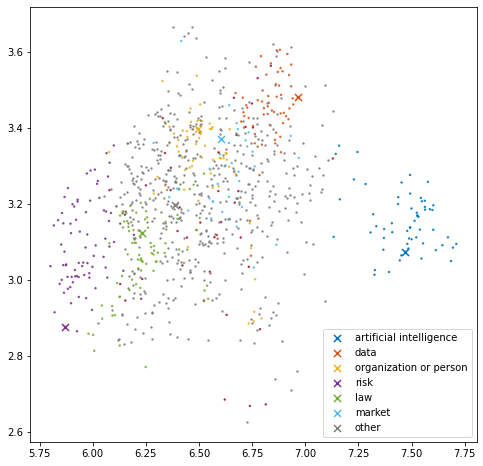

cluster size :
|-artificial intelligence : 59
|-data : 63
|-organization or person : 62
|-risk : 82
|-law : 89
|-market : 38
|-other : 543
  |-unlabeled terms within 'other': 504
0.17843321


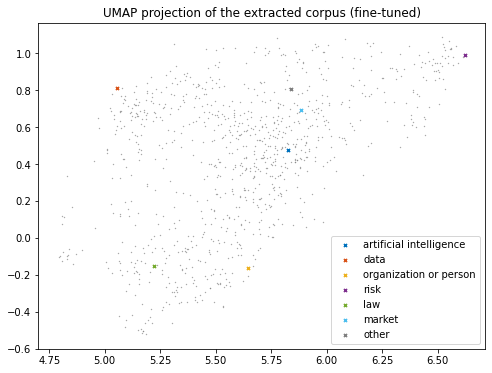

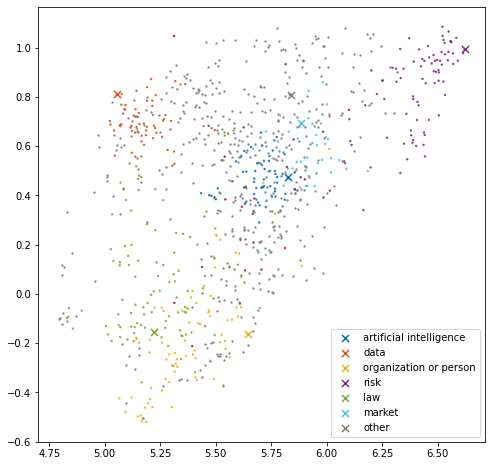

cluster size :
|-artificial intelligence : 60
|-data : 63
|-organization or person : 82
|-risk : 82
|-law : 101
|-market : 40
|-other : 508
  |-unlabeled terms within 'other': 478
0.2090361


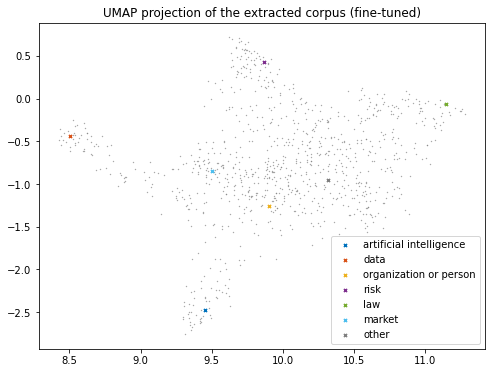

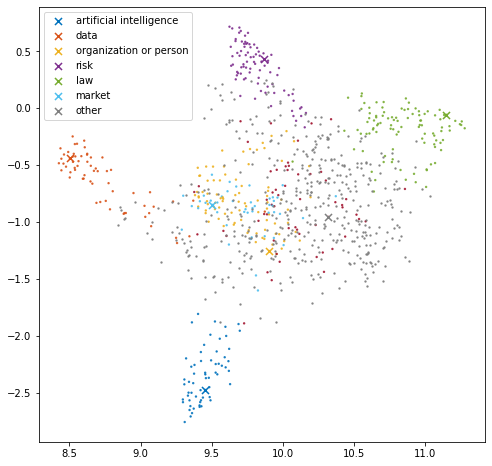

cluster size :
|-artificial intelligence : 61
|-data : 63
|-organization or person : 88
|-risk : 82
|-law : 101
|-market : 46
|-other : 495
  |-unlabeled terms within 'other': 438
0.21035297


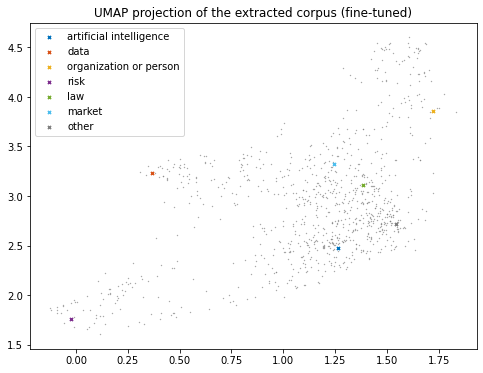

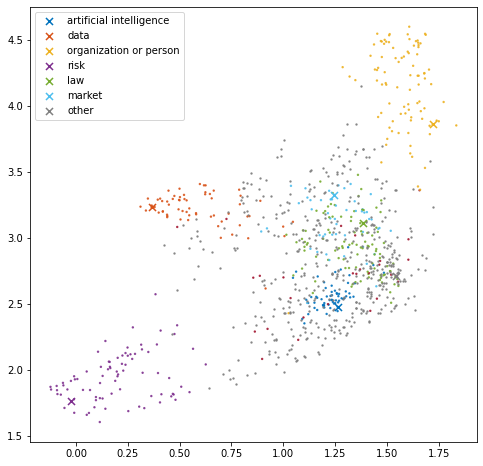

cluster size :
|-artificial intelligence : 63
|-data : 63
|-organization or person : 92
|-risk : 82
|-law : 101
|-market : 51
|-other : 484
  |-unlabeled terms within 'other': 456
0.22628798


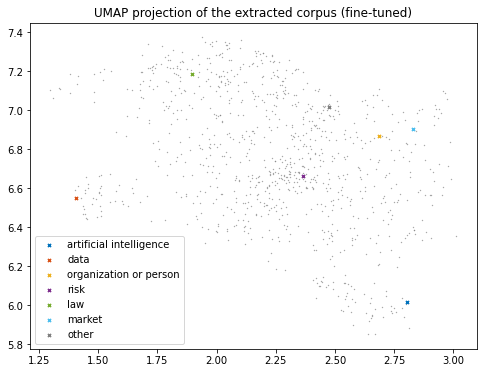

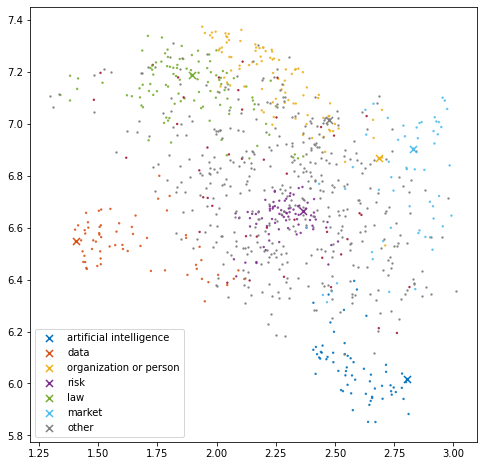

cluster size :
|-artificial intelligence : 63
|-data : 63
|-organization or person : 96
|-risk : 82
|-law : 105
|-market : 57
|-other : 470
  |-unlabeled terms within 'other': 426
0.24988833


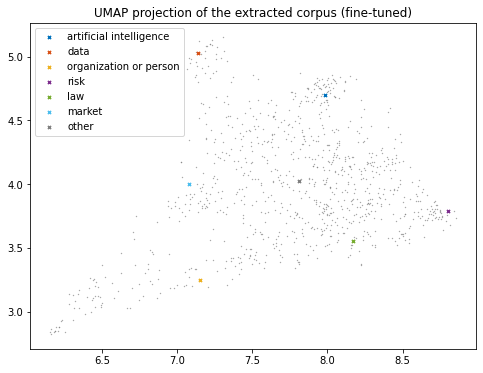

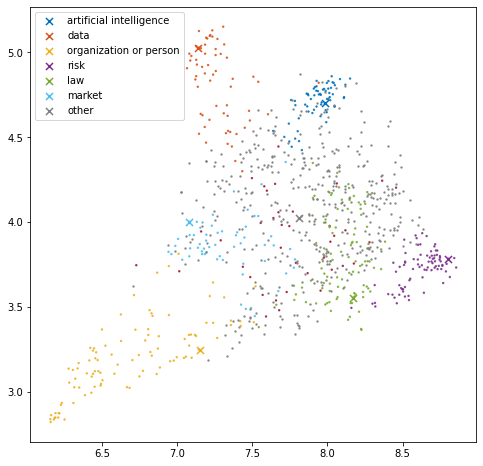

cluster size :
|-artificial intelligence : 64
|-data : 63
|-organization or person : 98
|-risk : 82
|-law : 105
|-market : 58
|-other : 466
  |-unlabeled terms within 'other': 427
0.24242109


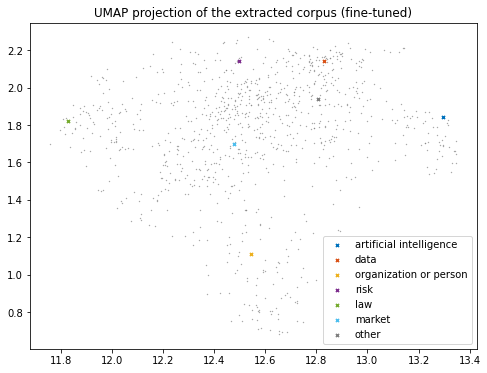

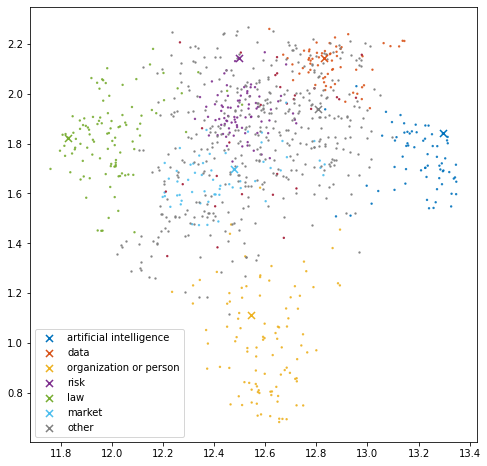

cluster size :
|-artificial intelligence : 68
|-data : 63
|-organization or person : 102
|-risk : 82
|-law : 105
|-market : 59
|-other : 457
  |-unlabeled terms within 'other': 427
0.21774329


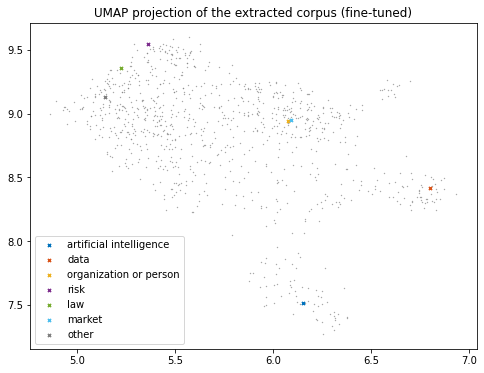

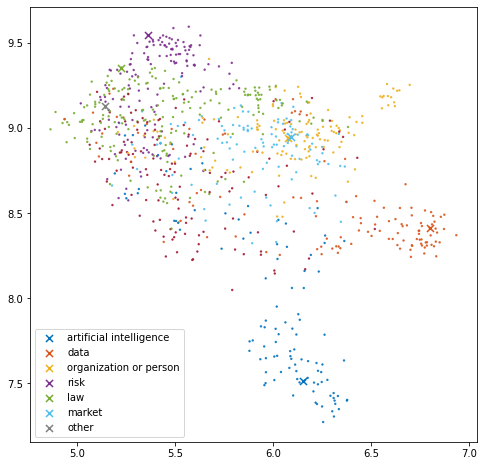

cluster size :
|-artificial intelligence : 109
|-data : 121
|-organization or person : 136
|-risk : 146
|-law : 193
|-market : 103
|-other : 128
  |-unlabeled terms within 'other': 0


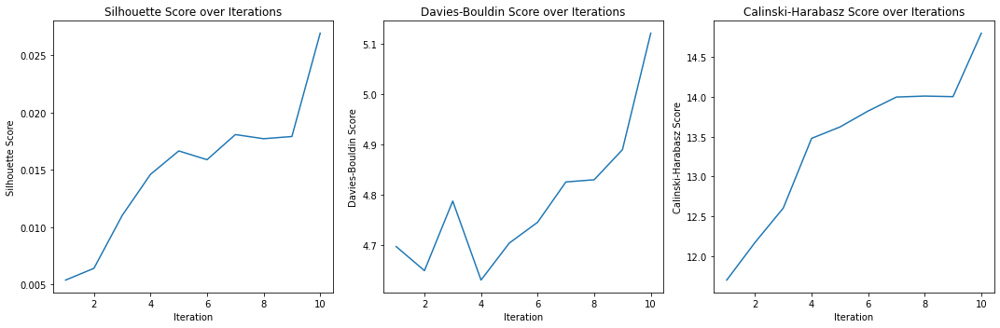

Silhouette : 0.026942004
Davies Bouldin : 5.121906871980241
Calinski Harabasz : 14.801605392296203


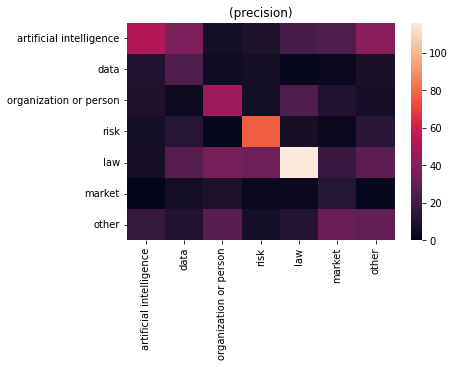

size of predicted terms: 900
Accuracy : 0.39444444444444443
Precision : 0.4563721423489835
Recall : 0.39444444444444443
f1 : 0.40734235229536453
                      Term              Prediction Ground truth
0                    point  organization or person        other
1       regulatory sandbox                     law          law
2      data protection law                    data          law
3     particular situation                     law          law
4  common procedure (other                     law          law


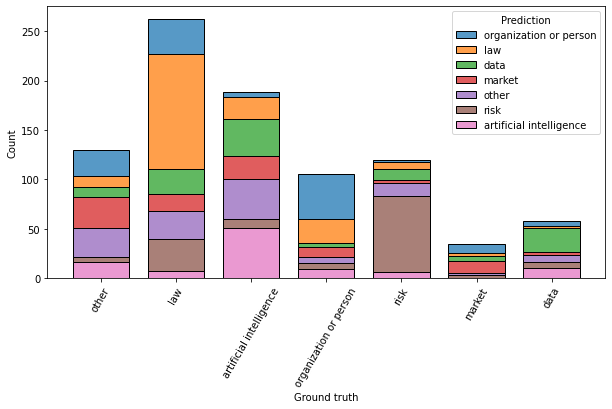

15 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.0051301536


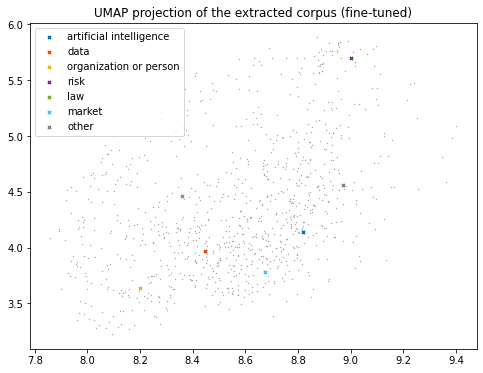

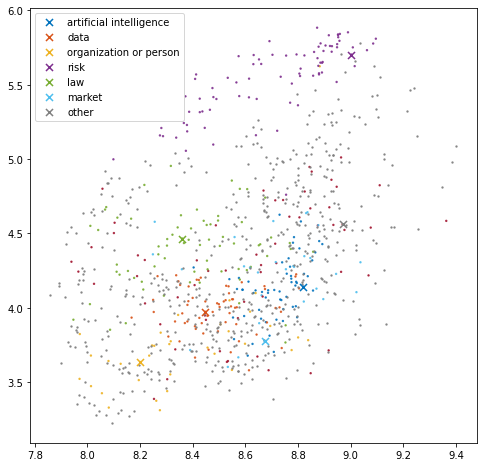

cluster size :
|-artificial intelligence : 57
|-data : 63
|-organization or person : 35
|-risk : 82
|-law : 69
|-market : 29
|-other : 601
  |-unlabeled terms within 'other': 541
0.10663835


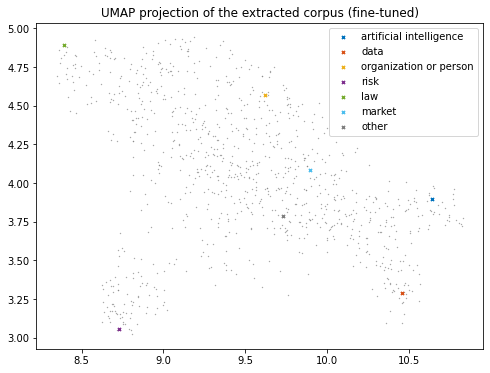

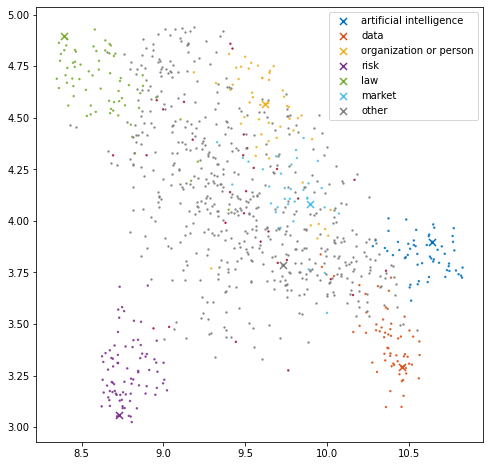

cluster size :
|-artificial intelligence : 57
|-data : 63
|-organization or person : 52
|-risk : 82
|-law : 69
|-market : 35
|-other : 578
  |-unlabeled terms within 'other': 547
0.13209267


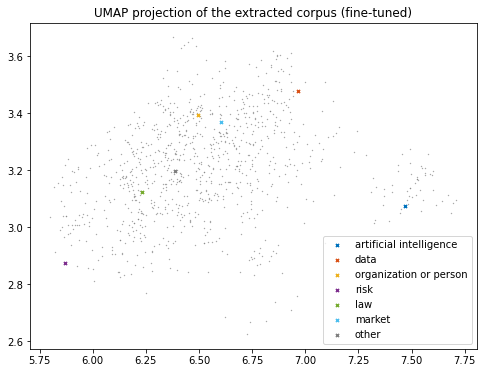

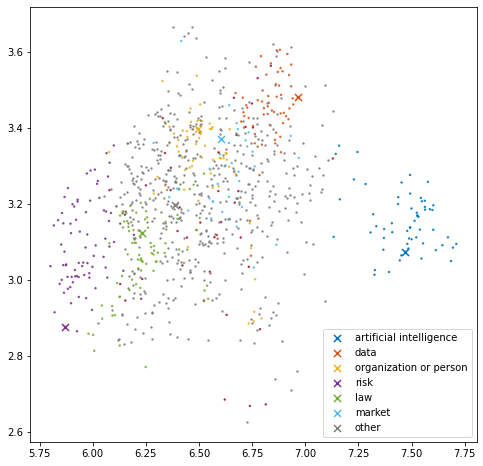

cluster size :
|-artificial intelligence : 59
|-data : 63
|-organization or person : 62
|-risk : 82
|-law : 89
|-market : 38
|-other : 543
  |-unlabeled terms within 'other': 504
0.17843321


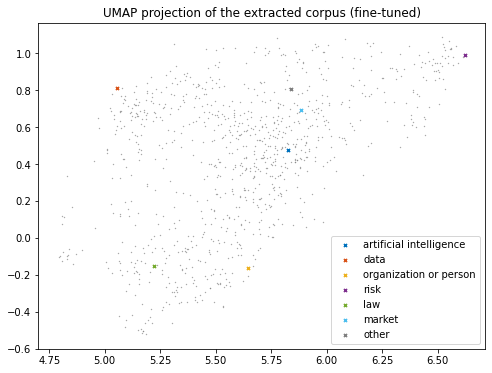

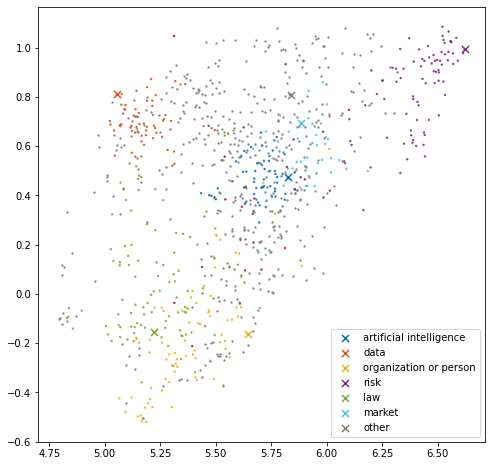

cluster size :
|-artificial intelligence : 60
|-data : 63
|-organization or person : 82
|-risk : 82
|-law : 101
|-market : 40
|-other : 508
  |-unlabeled terms within 'other': 478
0.2090361


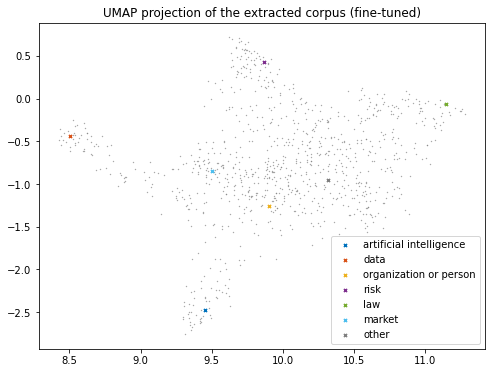

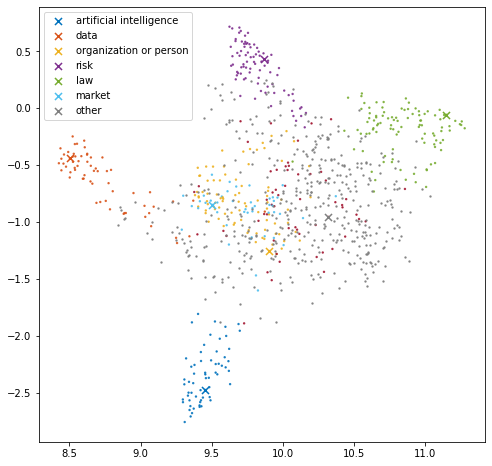

cluster size :
|-artificial intelligence : 61
|-data : 63
|-organization or person : 88
|-risk : 82
|-law : 101
|-market : 46
|-other : 495
  |-unlabeled terms within 'other': 438
0.21035297


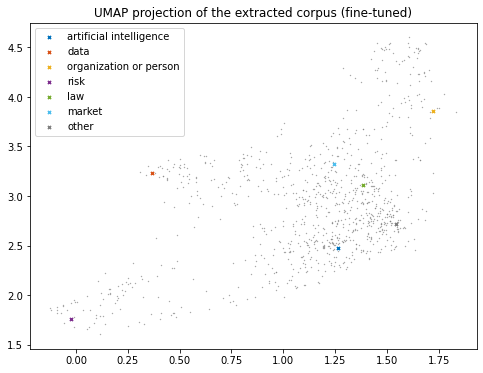

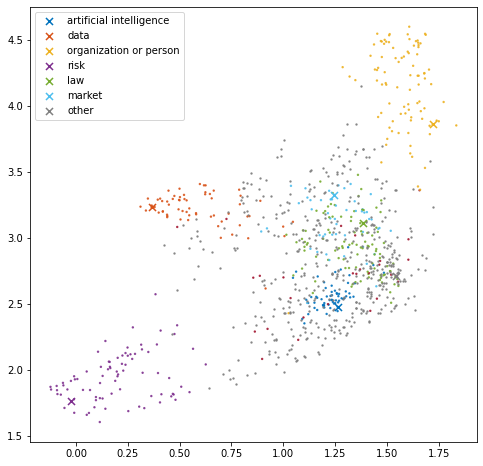

cluster size :
|-artificial intelligence : 63
|-data : 63
|-organization or person : 92
|-risk : 82
|-law : 101
|-market : 51
|-other : 484
  |-unlabeled terms within 'other': 456
0.22628798


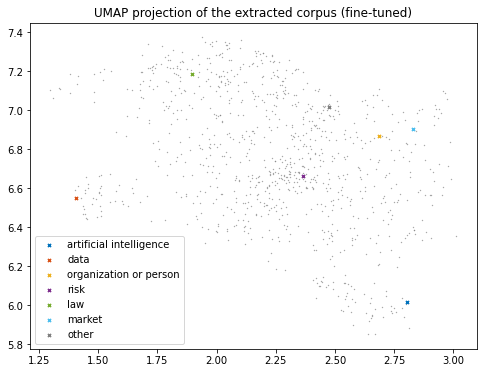

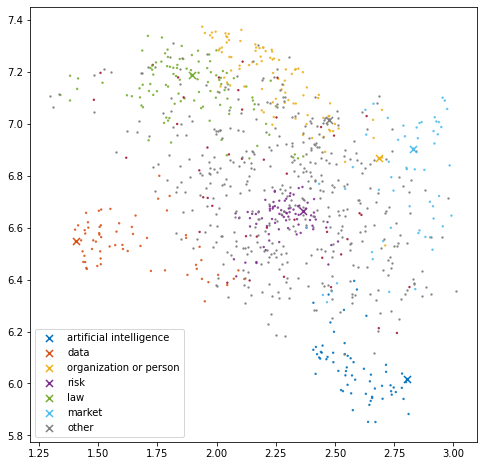

cluster size :
|-artificial intelligence : 63
|-data : 63
|-organization or person : 96
|-risk : 82
|-law : 105
|-market : 57
|-other : 470
  |-unlabeled terms within 'other': 426
0.24988833


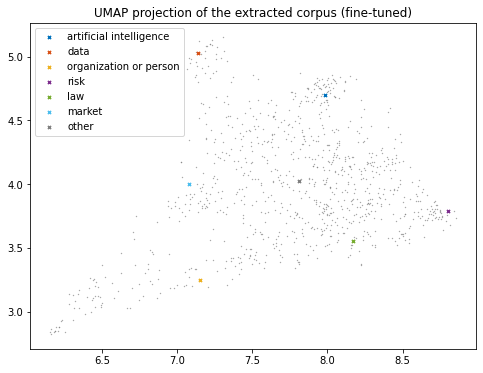

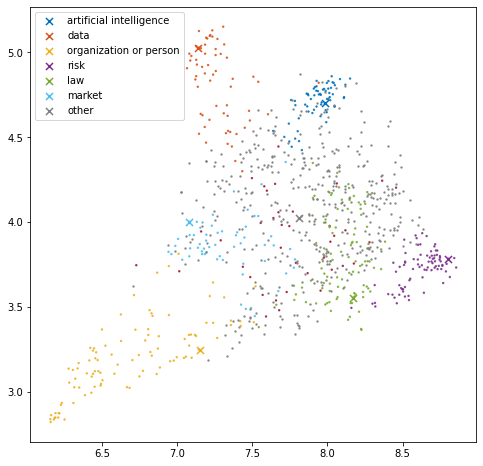

cluster size :
|-artificial intelligence : 64
|-data : 63
|-organization or person : 98
|-risk : 82
|-law : 105
|-market : 58
|-other : 466
  |-unlabeled terms within 'other': 427
0.24242109


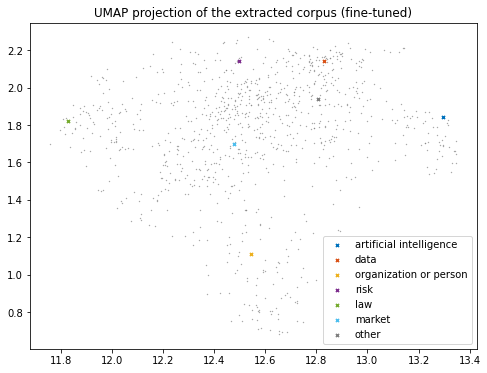

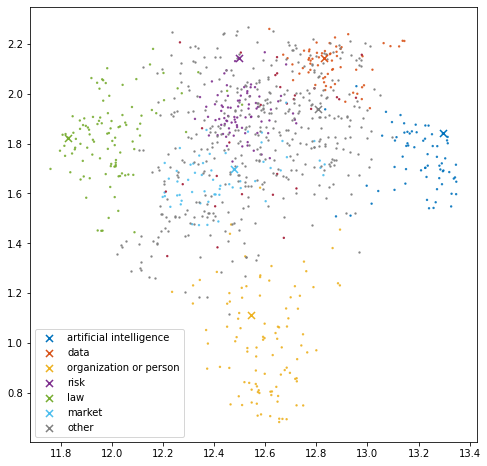

cluster size :
|-artificial intelligence : 68
|-data : 63
|-organization or person : 102
|-risk : 82
|-law : 105
|-market : 59
|-other : 457
  |-unlabeled terms within 'other': 427
0.25619373


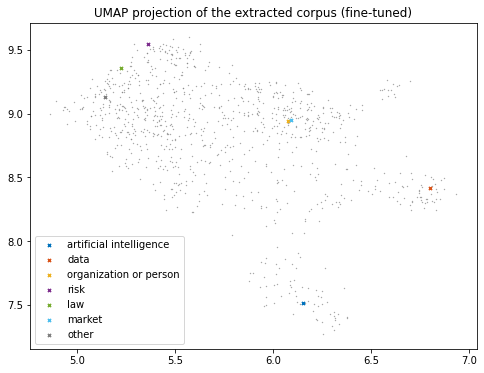

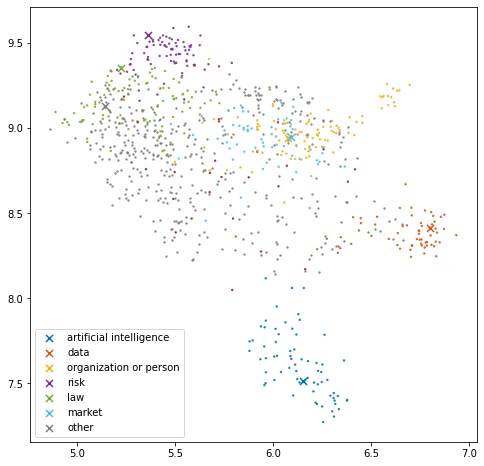

cluster size :
|-artificial intelligence : 69
|-data : 63
|-organization or person : 102
|-risk : 82
|-law : 105
|-market : 63
|-other : 452
  |-unlabeled terms within 'other': 423
0.26192617


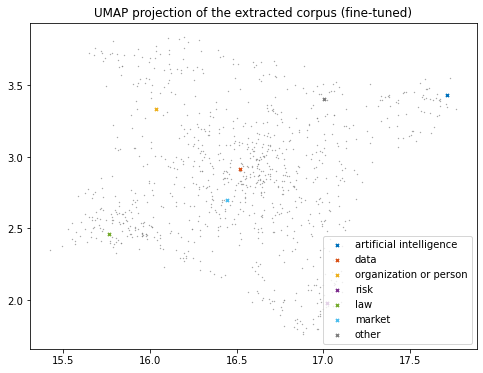

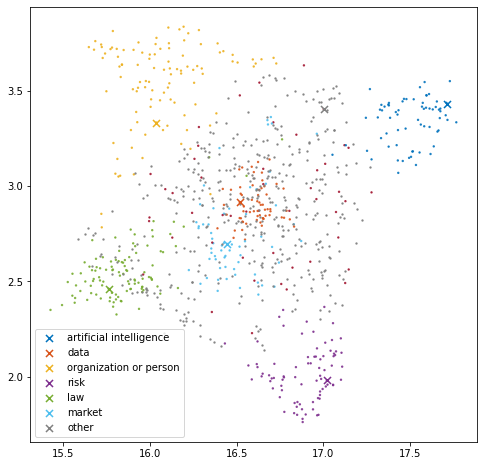

cluster size :
|-artificial intelligence : 69
|-data : 63
|-organization or person : 105
|-risk : 82
|-law : 105
|-market : 63
|-other : 449
  |-unlabeled terms within 'other': 401
0.24703132


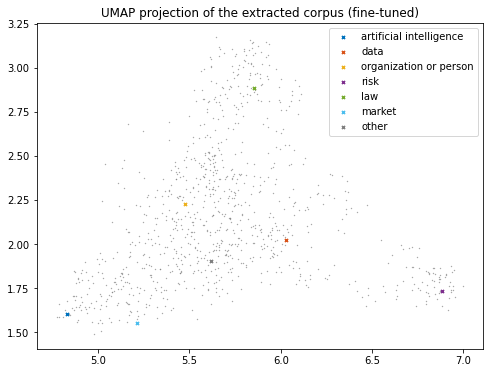

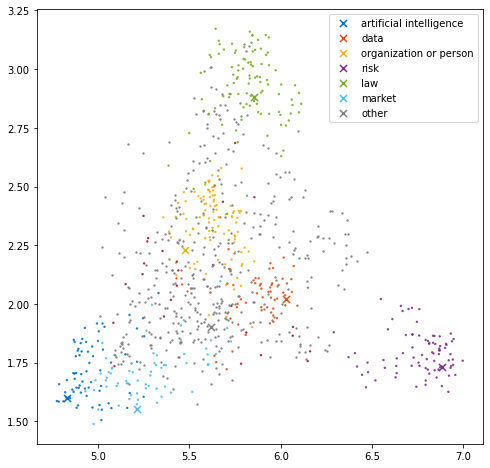

cluster size :
|-artificial intelligence : 70
|-data : 63
|-organization or person : 105
|-risk : 82
|-law : 105
|-market : 65
|-other : 446
  |-unlabeled terms within 'other': 419
0.27175426


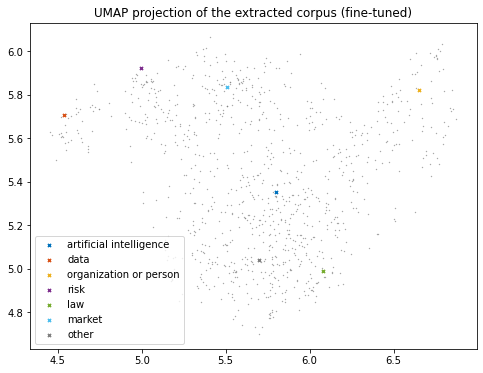

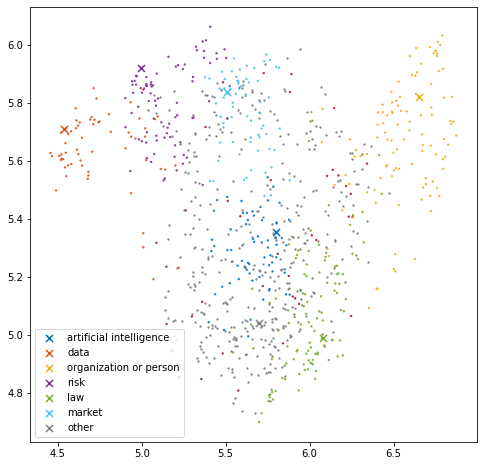

cluster size :
|-artificial intelligence : 70
|-data : 63
|-organization or person : 108
|-risk : 82
|-law : 114
|-market : 72
|-other : 427
  |-unlabeled terms within 'other': 386
0.28881606


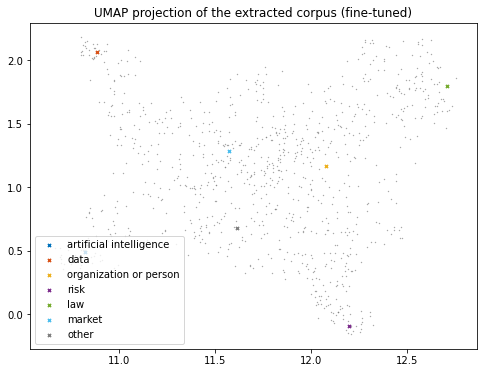

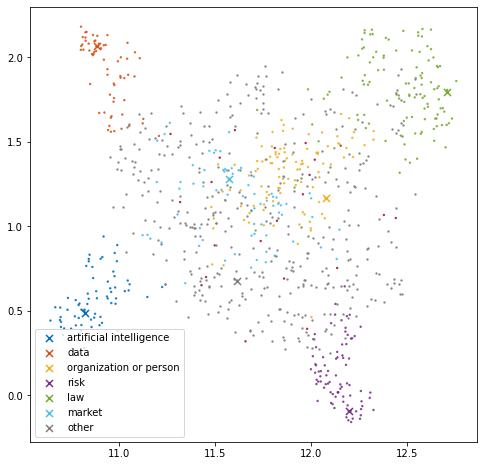

cluster size :
|-artificial intelligence : 71
|-data : 63
|-organization or person : 108
|-risk : 82
|-law : 115
|-market : 76
|-other : 421
  |-unlabeled terms within 'other': 398
0.22627074


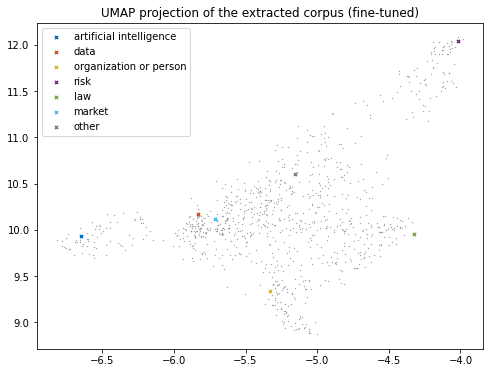

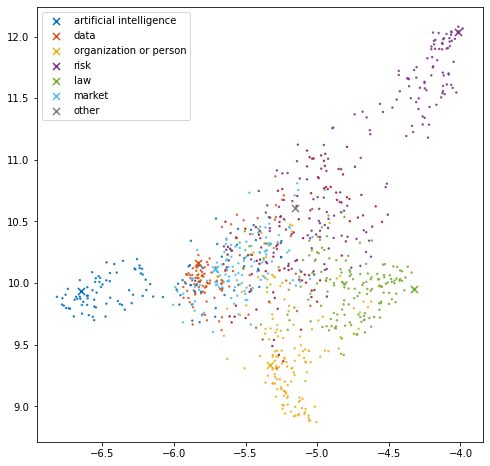

cluster size :
|-artificial intelligence : 116
|-data : 110
|-organization or person : 148
|-risk : 169
|-law : 166
|-market : 117
|-other : 110
  |-unlabeled terms within 'other': 0


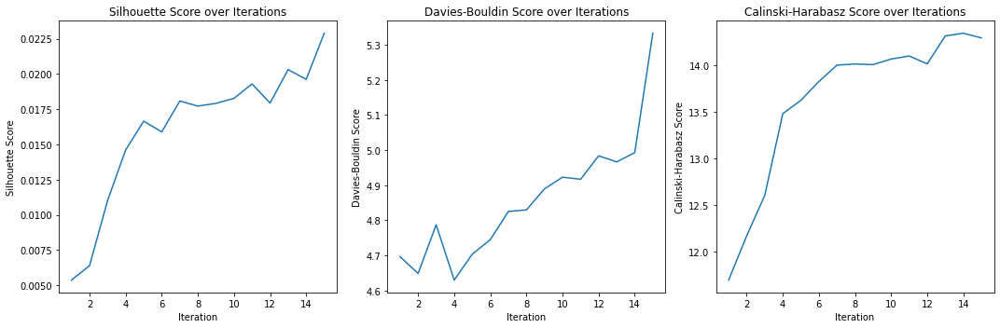

Silhouette : 0.022898173
Davies Bouldin : 5.333237846400493
Calinski Harabasz : 14.290346281204817


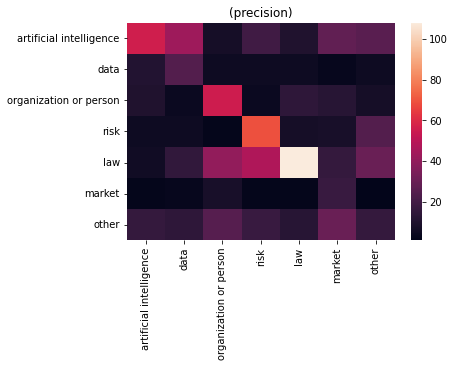

size of predicted terms: 900
Accuracy : 0.38333333333333336
Precision : 0.4533136713122129
Recall : 0.38333333333333336
f1 : 0.3935492652196877
                      Term Prediction Ground truth
0                    point       data        other
1       regulatory sandbox        law          law
2      data protection law       risk          law
3     particular situation      other          law
4  common procedure (other      other          law


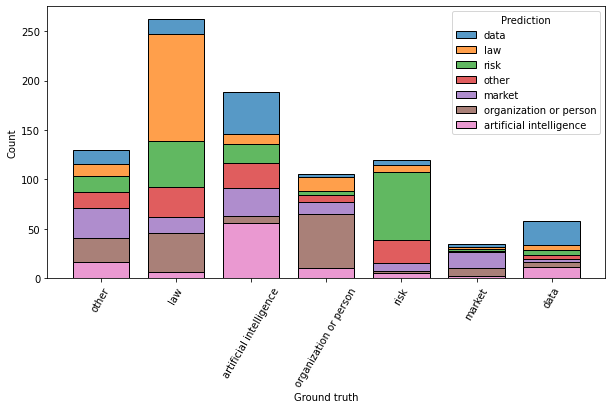


Summary:
    Accuracy  Precision    Recall        F1  Silhouette  Davies Bouldin  \
1   0.362222   0.431588  0.362222  0.370645    0.018118        6.169078   
2   0.378889   0.480589  0.378889  0.397816    0.022592        5.285877   
5   0.421111   0.499485  0.421111  0.439832    0.025764        5.427427   
10  0.394444   0.456372  0.394444  0.407342    0.026942        5.121907   
15  0.383333   0.453314  0.383333  0.393549    0.022898        5.333238   

    Calinski Harabasz  
1           13.649515  
2           13.633887  
5           14.307226  
10          14.801605  
15          14.290346  


In [27]:
df=run_and_store_results(min_points=4,dimensions=10,clusterer="c-dbscan",reducer="umap")

## 2.SVM classifier

1 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30


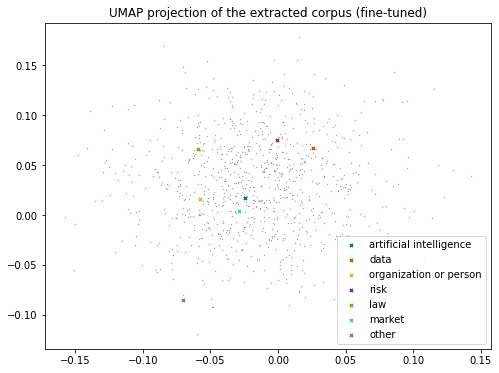

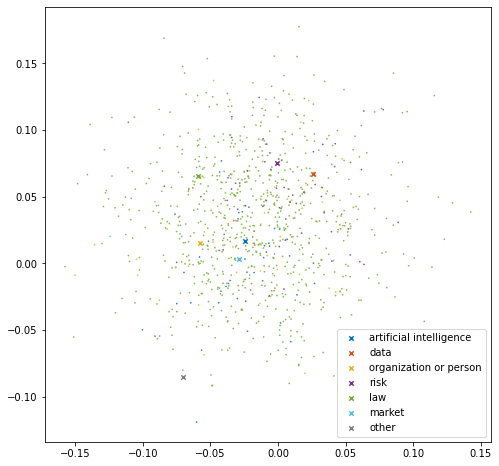

cluster size :
|-artificial intelligence : 43
|-data : 15
|-organization or person : 44
|-risk : 59
|-law : 772
|-market : 3
|-other : 0
  |-unlabeled terms within 'other': 0


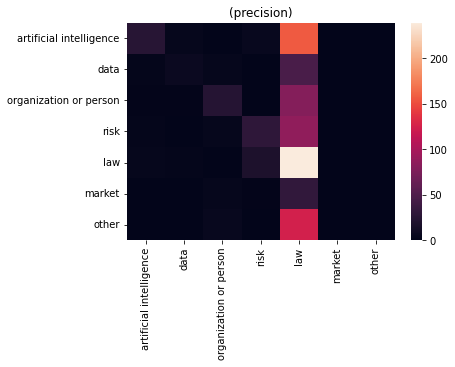

size of predicted terms: 900
Accuracy : 0.36
Precision : 0.4323205391373171
Recall : 0.36
f1 : 0.2797224421185303
                            Term              Prediction  \
0            administrative task                     law   
1             particular account  organization or person   
2        common procedure (other                     law   
3                     safe space                     law   
4  council of the european union                     law   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


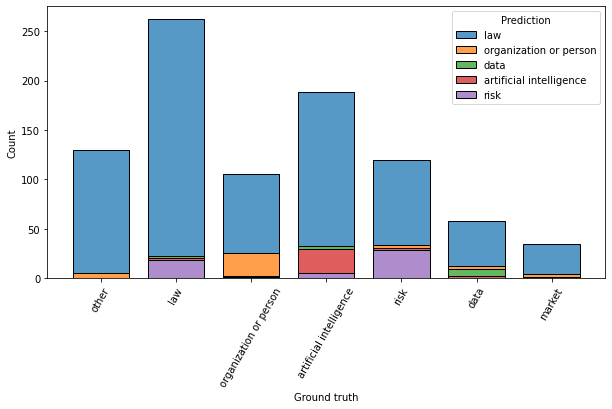

In [7]:
_ = run_and_store_results(classifier="svm",clusterer=None,reducer="none")  

## 3.ANN classifier

1 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30


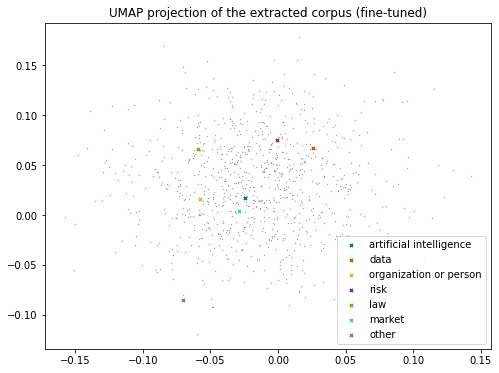

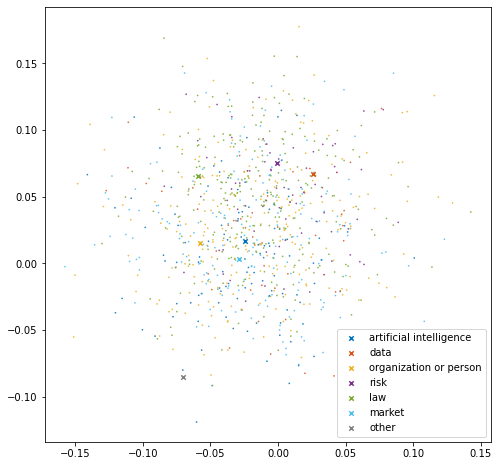

cluster size :
|-artificial intelligence : 108
|-data : 50
|-organization or person : 235
|-risk : 73
|-law : 278
|-market : 189
|-other : 3
  |-unlabeled terms within 'other': 0


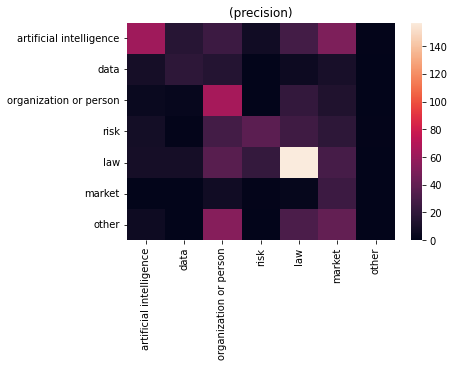

size of predicted terms: 900
Accuracy : 0.40555555555555556
Precision : 0.43993133787682037
Recall : 0.40555555555555556
f1 : 0.39292177618929586
                            Term              Prediction  \
0            administrative task  organization or person   
1             particular account  organization or person   
2        common procedure (other                     law   
3                     safe space                  market   
4  council of the european union  organization or person   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


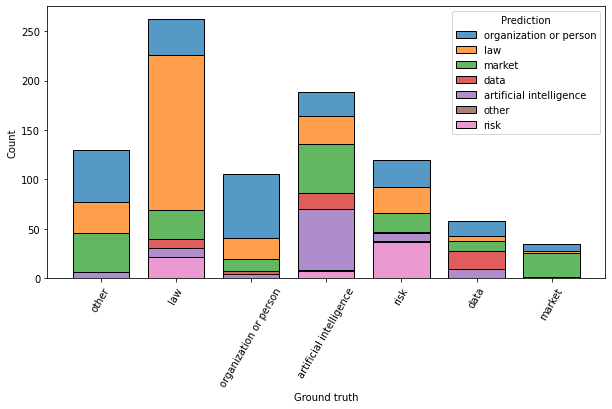

In [8]:
_ = run_and_store_results(classifier="ann",clusterer=None,reducer="none")  

## 4. PCA + CDBSCAN

1 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
0.05062245


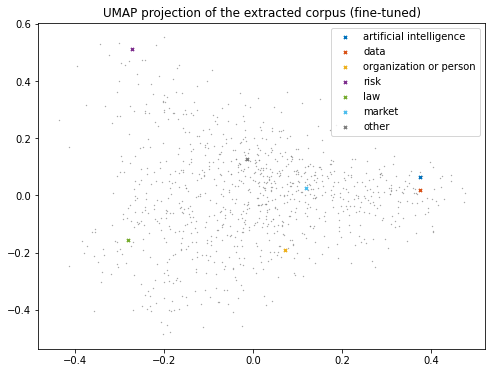

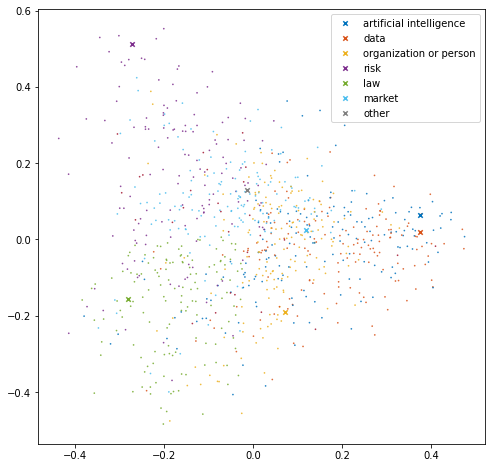

cluster size :
|-artificial intelligence : 167
|-data : 153
|-organization or person : 162
|-risk : 138
|-law : 137
|-market : 150
|-other : 29
  |-unlabeled terms within 'other': 0


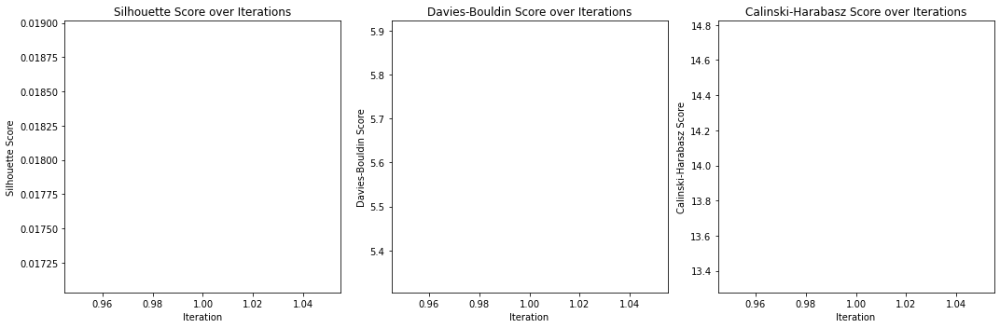

Silhouette : 0.018024268
Davies Bouldin : 5.613532433074396
Calinski Harabasz : 14.050195109879741


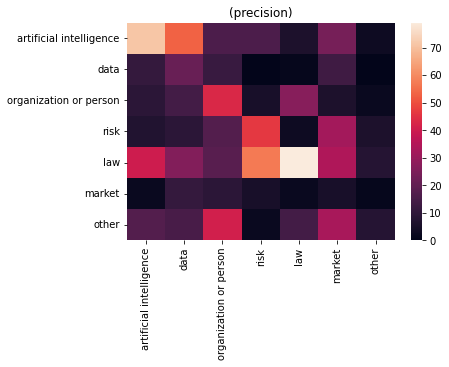

size of predicted terms: 900
Accuracy : 0.30333333333333334
Precision : 0.40015283462042023
Recall : 0.30333333333333334
f1 : 0.3202957450423079
                            Term               Prediction  \
0            administrative task  artificial intelligence   
1             particular account   organization or person   
2        common procedure (other  artificial intelligence   
3                     safe space                     risk   
4  council of the european union   organization or person   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


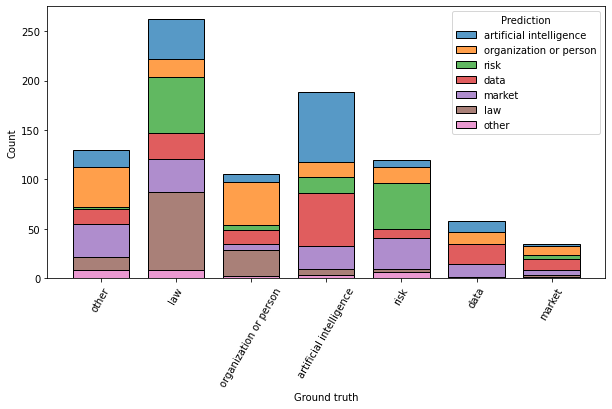

2 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
0.005894018


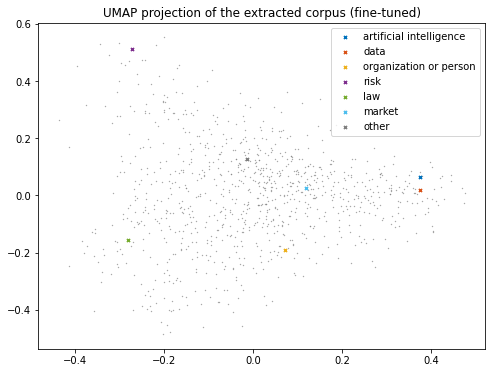

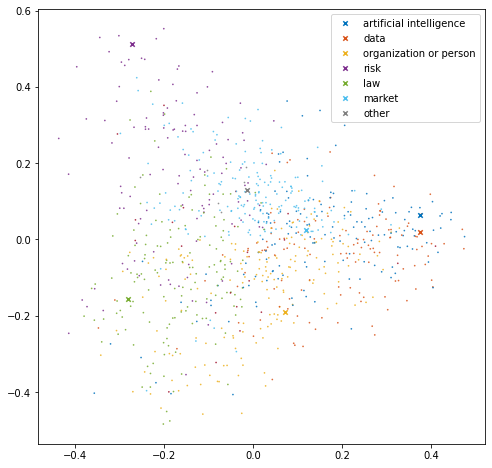

cluster size :
|-artificial intelligence : 149
|-data : 128
|-organization or person : 179
|-risk : 119
|-law : 150
|-market : 182
|-other : 29
  |-unlabeled terms within 'other': 6
0.06368887


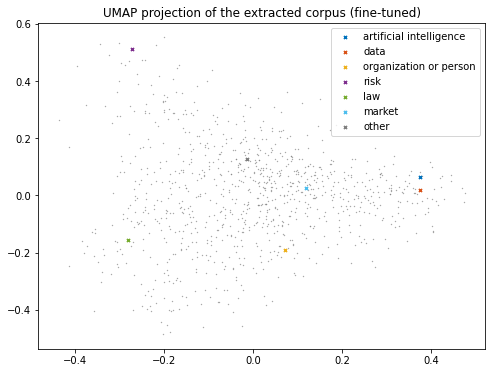

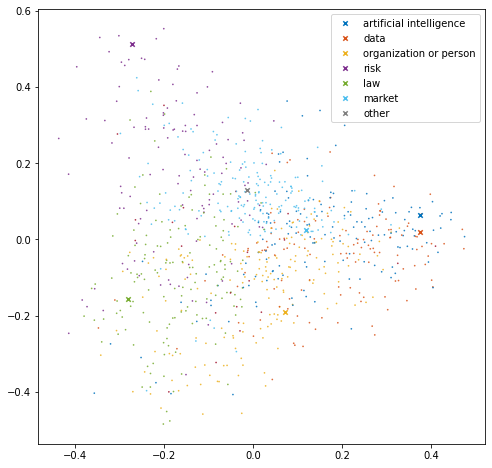

cluster size :
|-artificial intelligence : 149
|-data : 128
|-organization or person : 179
|-risk : 119
|-law : 150
|-market : 188
|-other : 23
  |-unlabeled terms within 'other': 0


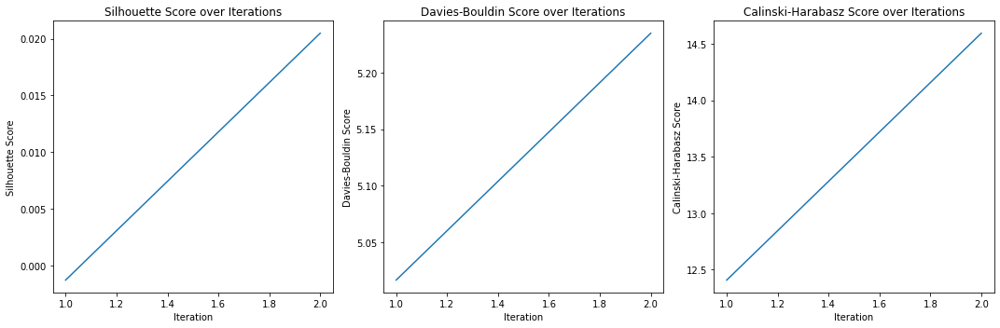

Silhouette : 0.020496173
Davies Bouldin : 5.234667886251684
Calinski Harabasz : 14.594985271113657


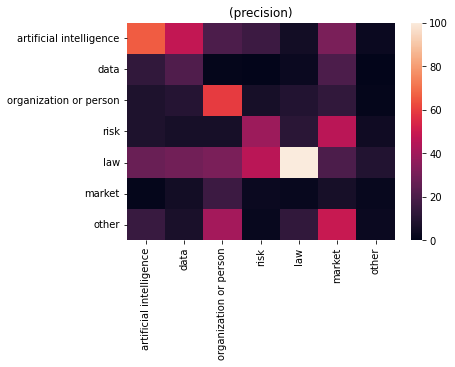

size of predicted terms: 900
Accuracy : 0.32666666666666666
Precision : 0.4220726723500337
Recall : 0.32666666666666666
f1 : 0.3455248338665684
                            Term              Prediction  \
0            administrative task  organization or person   
1             particular account                    data   
2        common procedure (other                    data   
3                     safe space                    risk   
4  council of the european union  organization or person   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


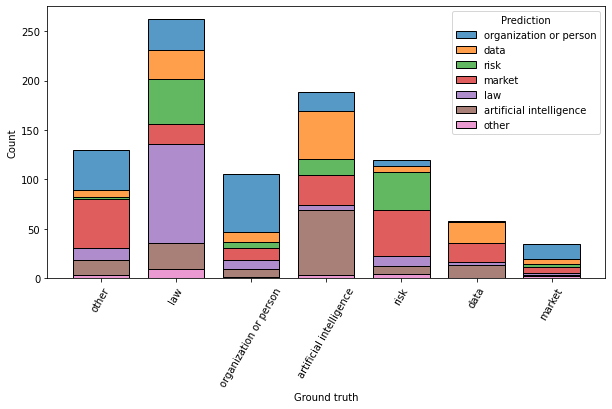

5 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.041064505


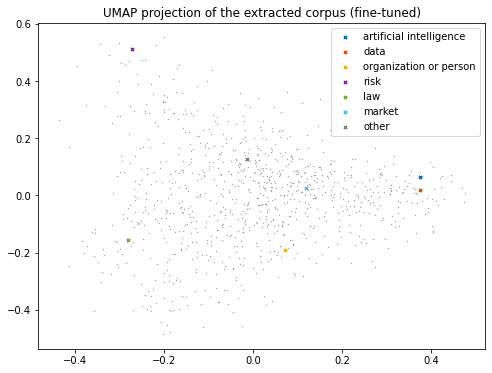

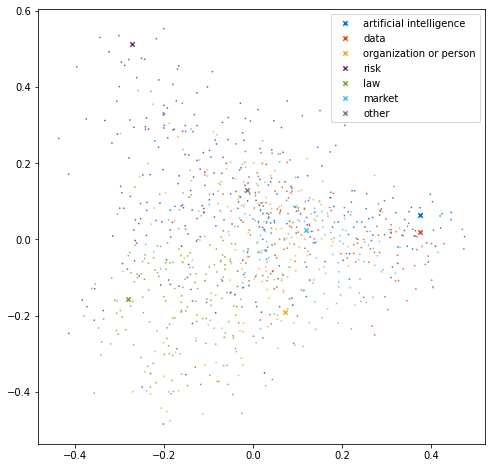

cluster size :
|-artificial intelligence : 160
|-data : 165
|-organization or person : 161
|-risk : 128
|-law : 145
|-market : 153
|-other : 24
  |-unlabeled terms within 'other': 7
-0.07921975


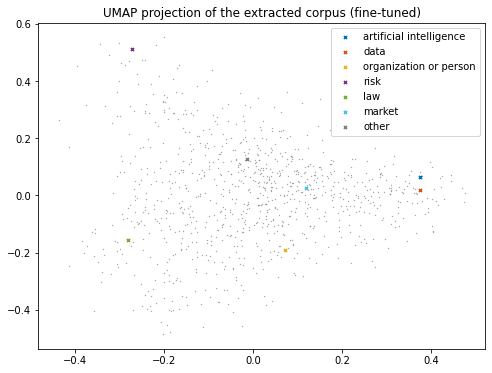

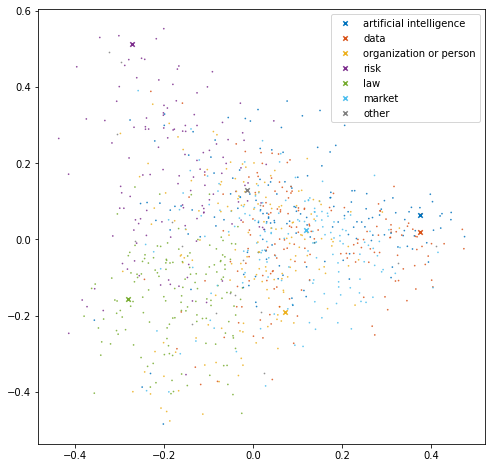

cluster size :
|-artificial intelligence : 160
|-data : 165
|-organization or person : 161
|-risk : 128
|-law : 145
|-market : 160
|-other : 17
  |-unlabeled terms within 'other': 16
0.036360487


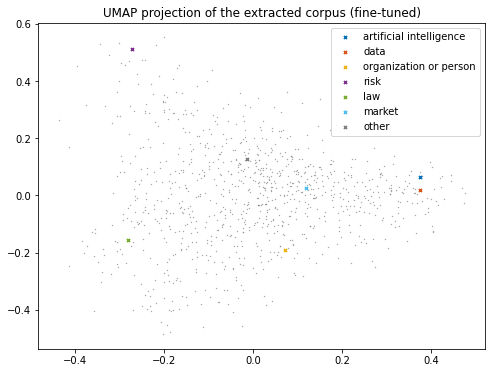

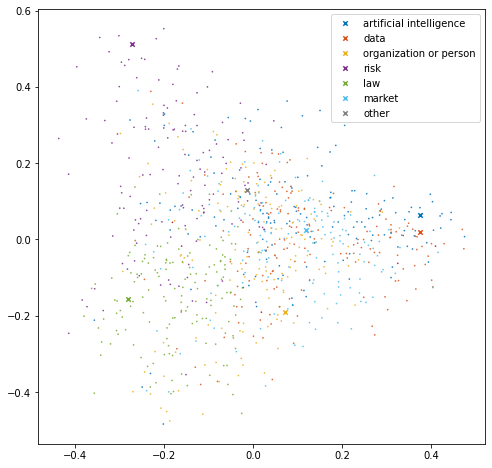

cluster size :
|-artificial intelligence : 160
|-data : 167
|-organization or person : 163
|-risk : 132
|-law : 147
|-market : 161
|-other : 6
  |-unlabeled terms within 'other': 0
-0.082032345


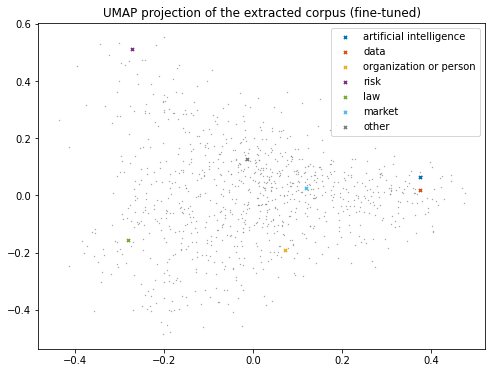

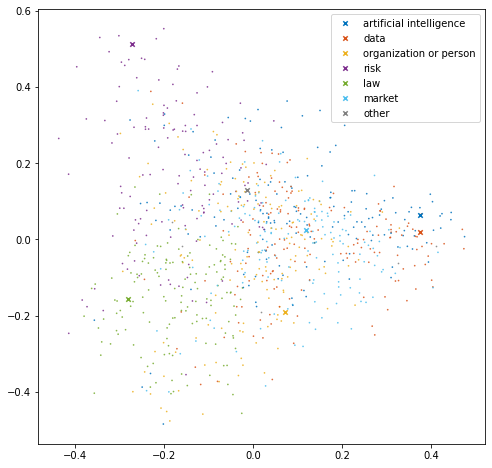

cluster size :
|-artificial intelligence : 160
|-data : 167
|-organization or person : 163
|-risk : 132
|-law : 147
|-market : 161
|-other : 6
  |-unlabeled terms within 'other': 5
0.026502881


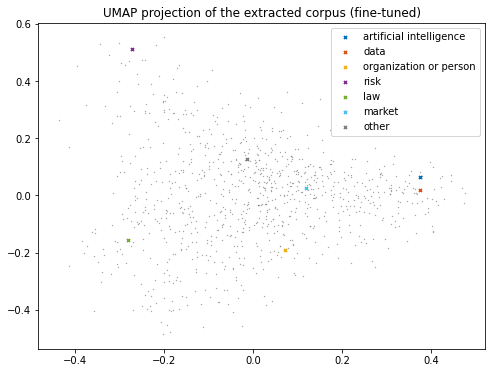

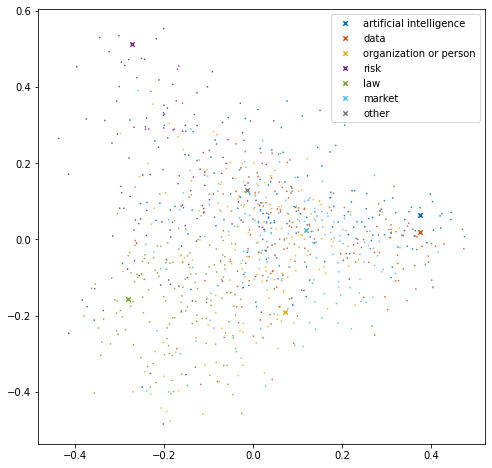

cluster size :
|-artificial intelligence : 161
|-data : 169
|-organization or person : 163
|-risk : 132
|-law : 147
|-market : 161
|-other : 3
  |-unlabeled terms within 'other': 0


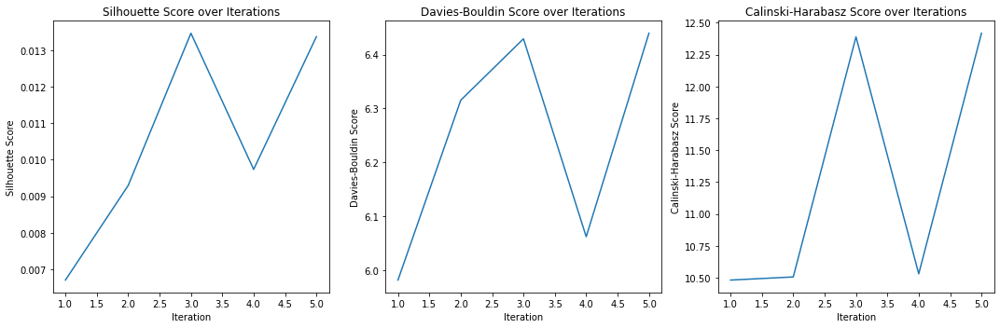

Silhouette : 0.013371004
Davies Bouldin : 6.4396213860594225
Calinski Harabasz : 12.417488725206793


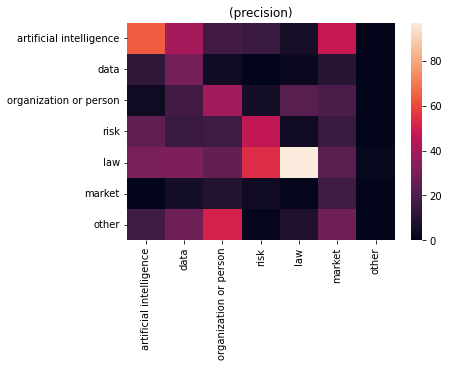

size of predicted terms: 900
Accuracy : 0.3233333333333333
Precision : 0.3828234776968674
Recall : 0.3233333333333333
f1 : 0.32722322716492125
                            Term              Prediction  \
0            administrative task  organization or person   
1             particular account                    data   
2        common procedure (other                  market   
3                     safe space                    risk   
4  council of the european union                    data   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


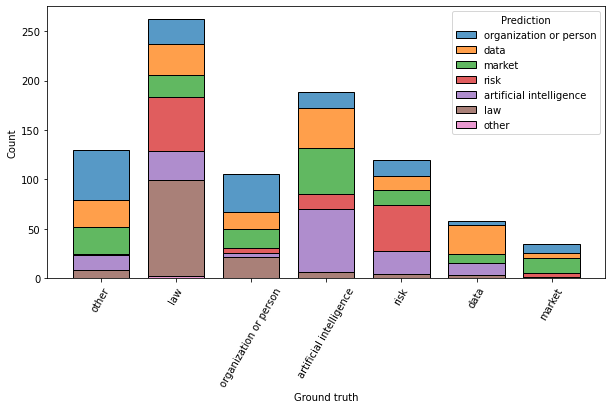

10 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.026036734


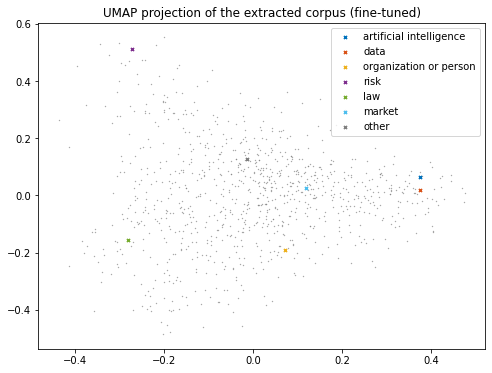

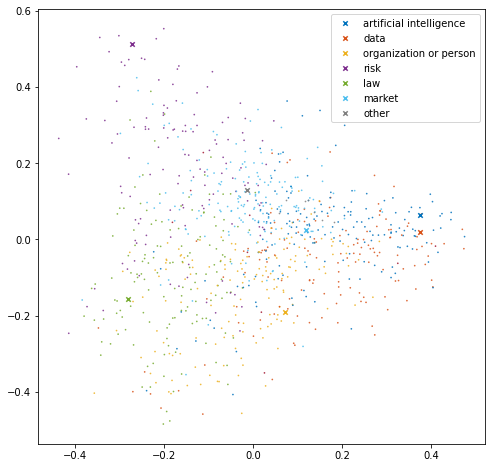

cluster size :
|-artificial intelligence : 168
|-data : 143
|-organization or person : 159
|-risk : 128
|-law : 141
|-market : 180
|-other : 17
  |-unlabeled terms within 'other': 7
-0.063360065


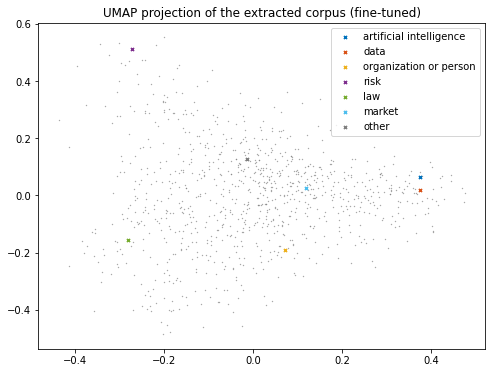

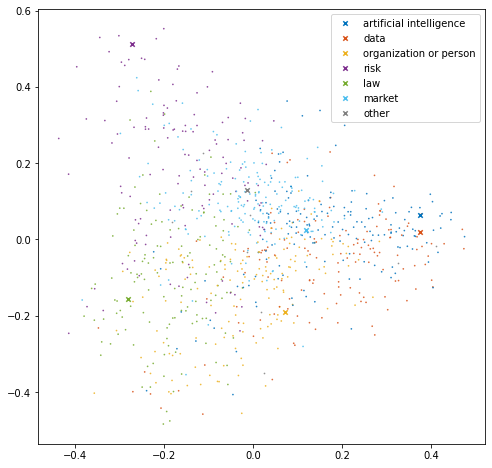

cluster size :
|-artificial intelligence : 168
|-data : 143
|-organization or person : 159
|-risk : 128
|-law : 141
|-market : 187
|-other : 10
  |-unlabeled terms within 'other': 9
0.056101654


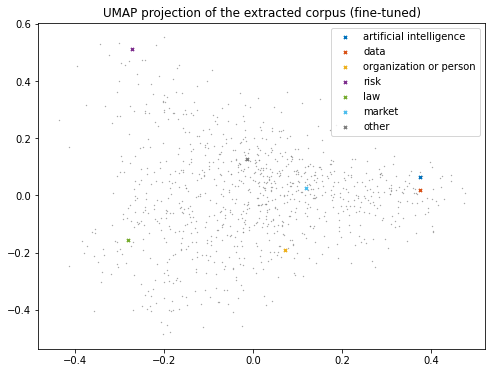

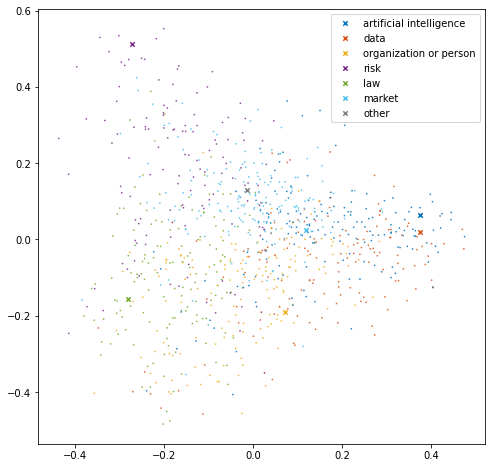

cluster size :
|-artificial intelligence : 170
|-data : 144
|-organization or person : 160
|-risk : 129
|-law : 142
|-market : 187
|-other : 4
  |-unlabeled terms within 'other': 0
-0.066589095


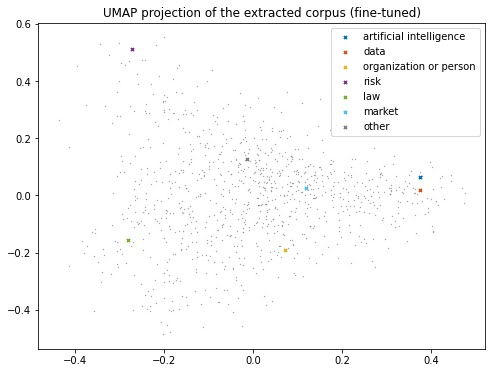

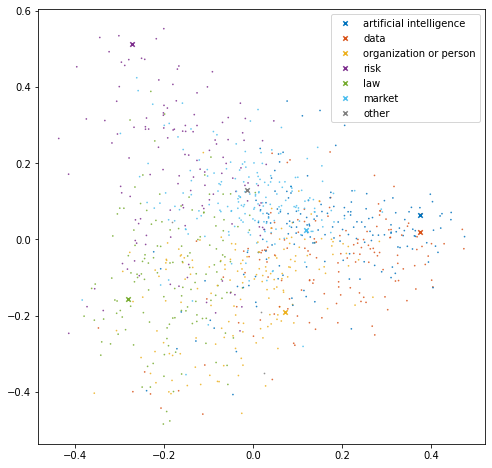

cluster size :
|-artificial intelligence : 170
|-data : 144
|-organization or person : 160
|-risk : 129
|-law : 142
|-market : 187
|-other : 4
  |-unlabeled terms within 'other': 3
0.051958166


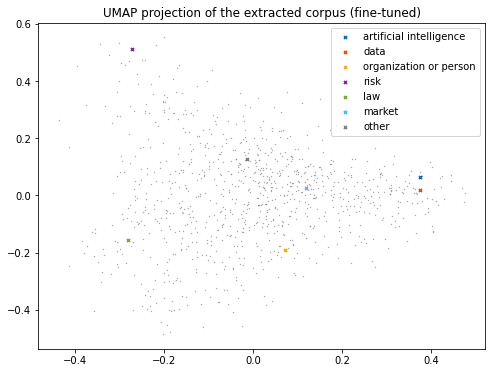

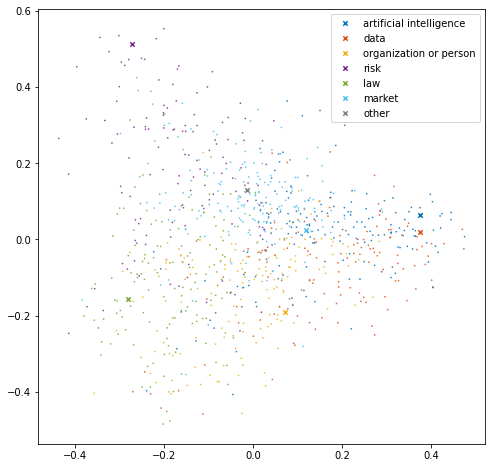

cluster size :
|-artificial intelligence : 170
|-data : 144
|-organization or person : 161
|-risk : 129
|-law : 142
|-market : 187
|-other : 3
  |-unlabeled terms within 'other': 0
-0.07128618


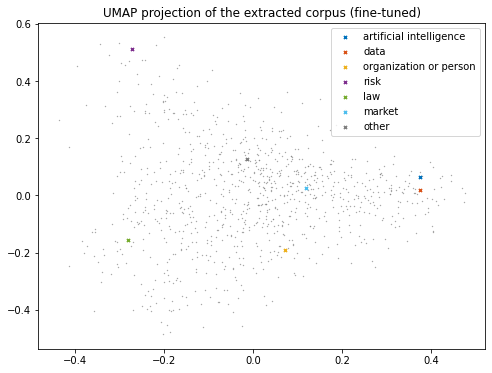

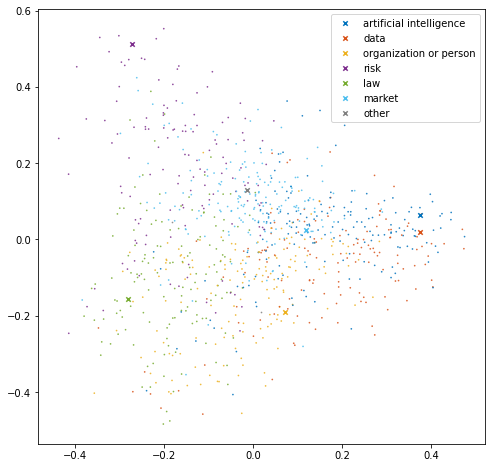

cluster size :
|-artificial intelligence : 170
|-data : 144
|-organization or person : 161
|-risk : 129
|-law : 142
|-market : 187
|-other : 3
  |-unlabeled terms within 'other': 2
0.0520276


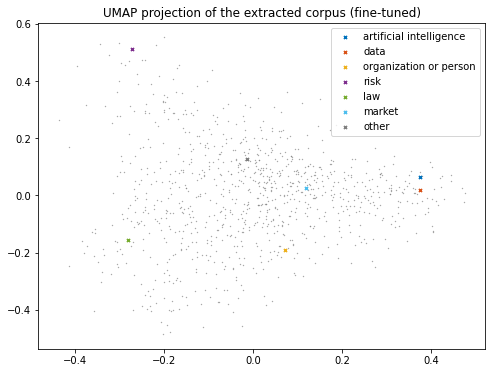

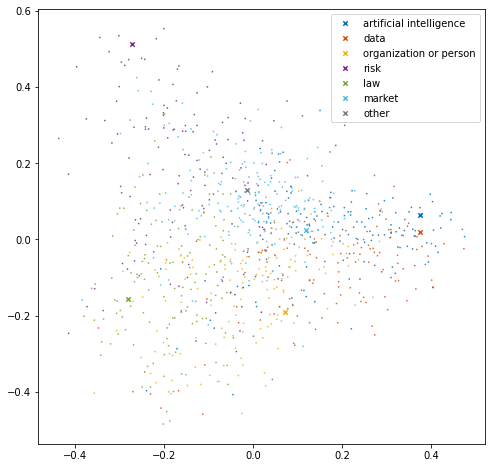

cluster size :
|-artificial intelligence : 170
|-data : 144
|-organization or person : 161
|-risk : 129
|-law : 142
|-market : 187
|-other : 3
  |-unlabeled terms within 'other': 0
-0.07276679


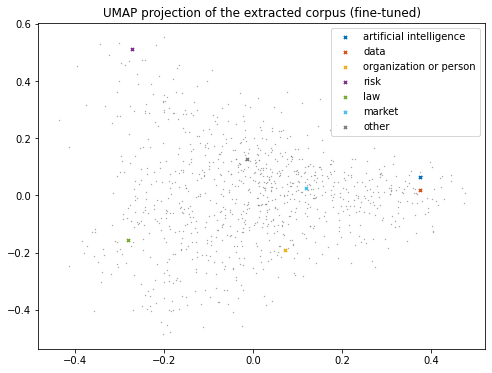

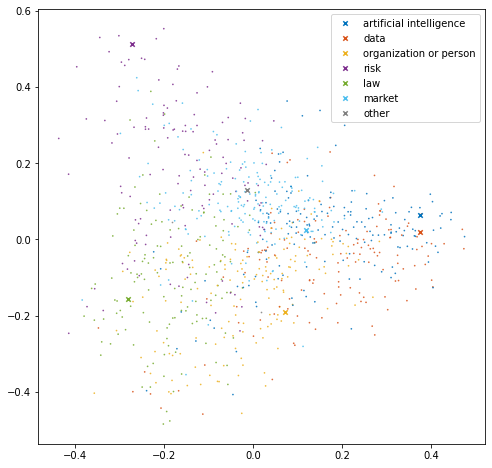

cluster size :
|-artificial intelligence : 170
|-data : 144
|-organization or person : 161
|-risk : 129
|-law : 142
|-market : 187
|-other : 3
  |-unlabeled terms within 'other': 2
0.03975399


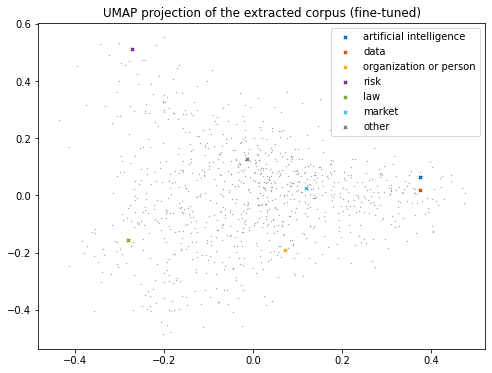

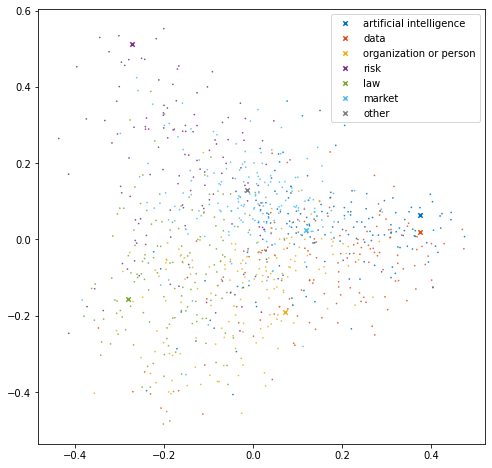

cluster size :
|-artificial intelligence : 170
|-data : 144
|-organization or person : 161
|-risk : 129
|-law : 143
|-market : 187
|-other : 2
  |-unlabeled terms within 'other': 0
0.03872975


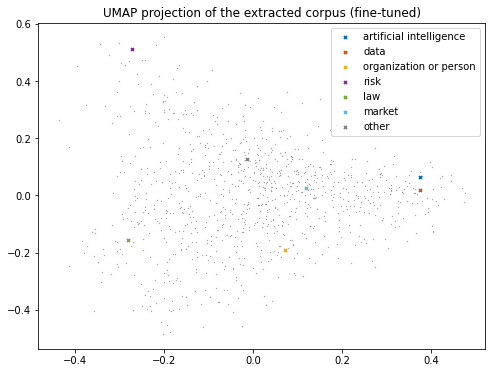

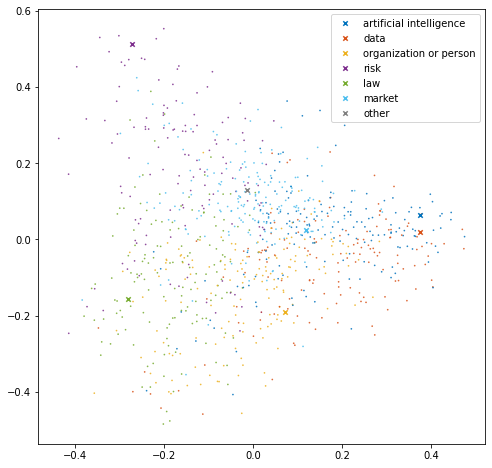

cluster size :
|-artificial intelligence : 170
|-data : 144
|-organization or person : 161
|-risk : 129
|-law : 143
|-market : 187
|-other : 2
  |-unlabeled terms within 'other': 0


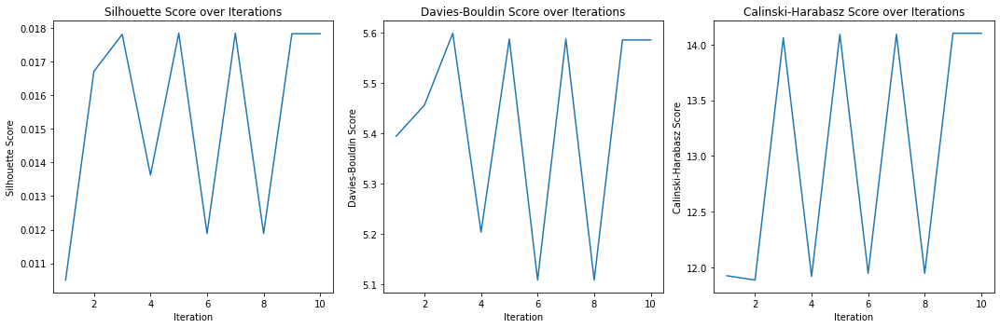

Silhouette : 0.017825656
Davies Bouldin : 5.585720299061035
Calinski Harabasz : 14.100707421491217


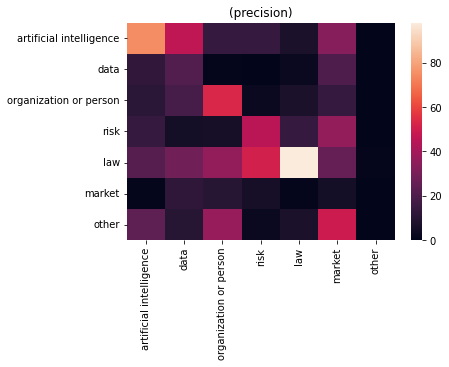

size of predicted terms: 900
Accuracy : 0.33
Precision : 0.40634647457731016
Recall : 0.33
f1 : 0.34576990400036145
                            Term              Prediction  \
0            administrative task  organization or person   
1             particular account  organization or person   
2        common procedure (other                    data   
3                     safe space                    risk   
4  council of the european union  organization or person   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


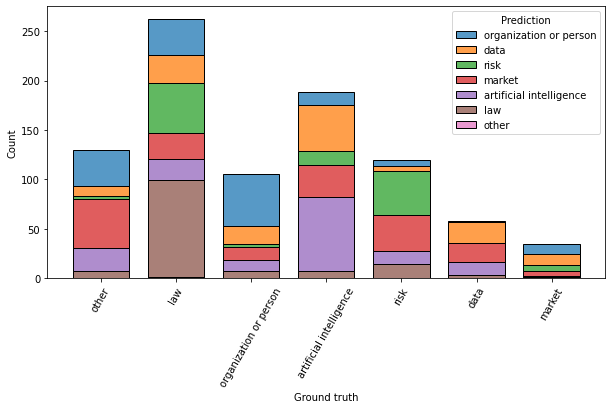

15 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.007577185


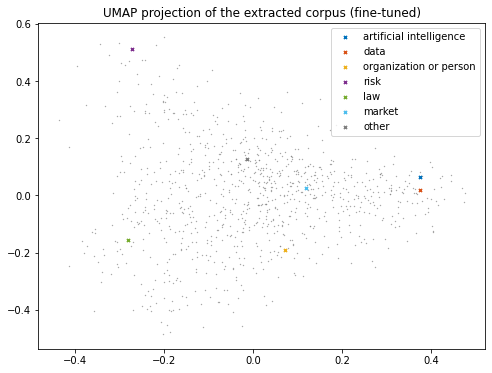

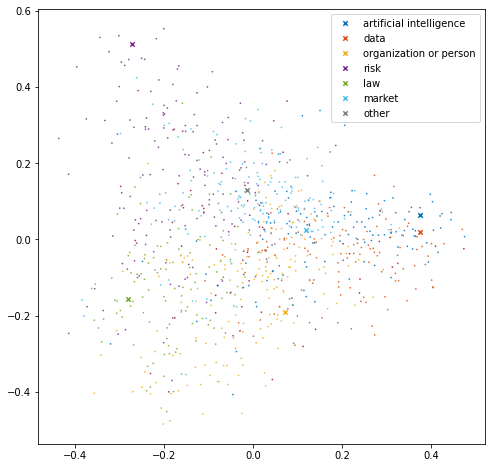

cluster size :
|-artificial intelligence : 140
|-data : 138
|-organization or person : 184
|-risk : 146
|-law : 113
|-market : 157
|-other : 58
  |-unlabeled terms within 'other': 6
-0.073348045


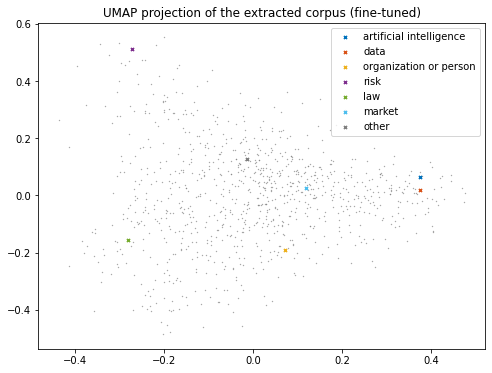

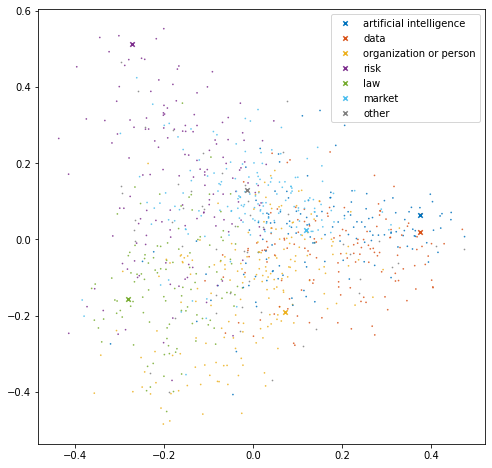

cluster size :
|-artificial intelligence : 141
|-data : 139
|-organization or person : 185
|-risk : 147
|-law : 114
|-market : 158
|-other : 52
  |-unlabeled terms within 'other': 51
0.04766424


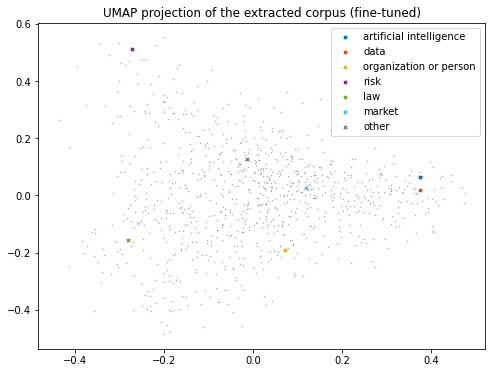

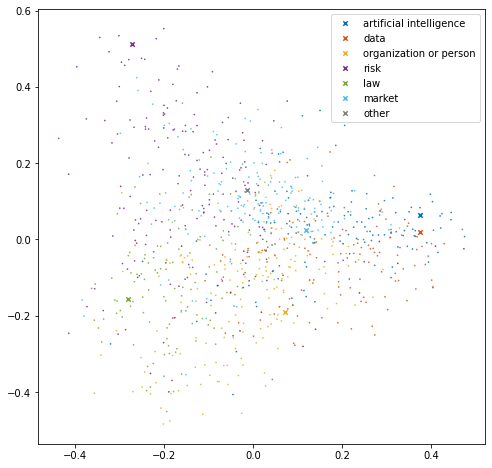

cluster size :
|-artificial intelligence : 145
|-data : 141
|-organization or person : 191
|-risk : 161
|-law : 115
|-market : 159
|-other : 24
  |-unlabeled terms within 'other': 0
-0.07150376


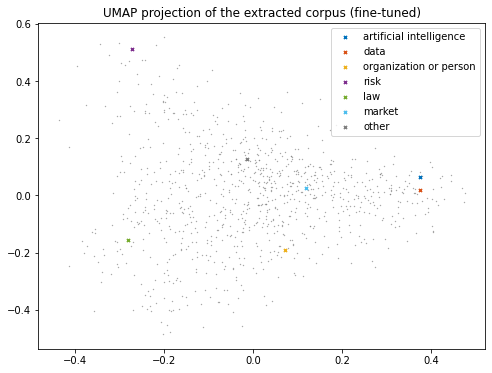

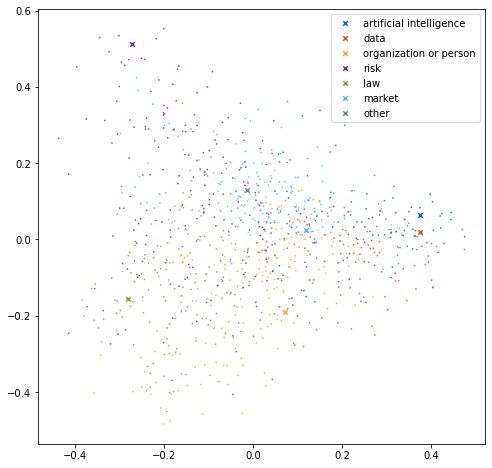

cluster size :
|-artificial intelligence : 145
|-data : 141
|-organization or person : 191
|-risk : 161
|-law : 115
|-market : 159
|-other : 24
  |-unlabeled terms within 'other': 23
0.049469143


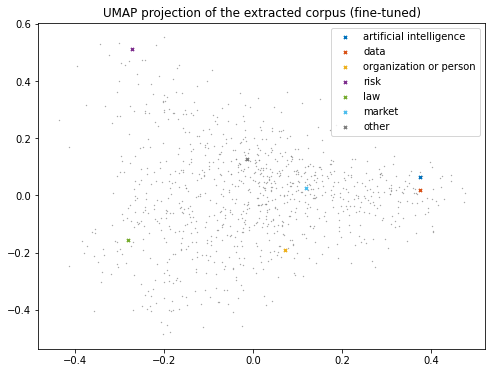

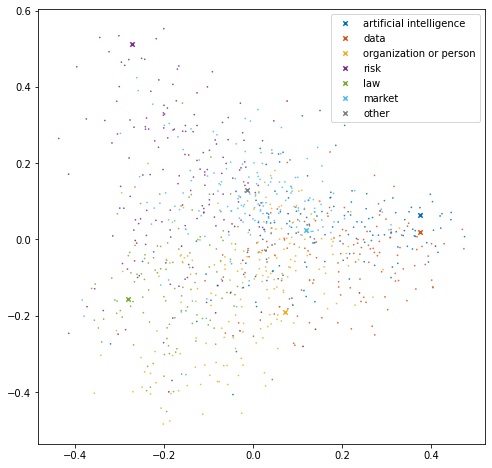

cluster size :
|-artificial intelligence : 146
|-data : 144
|-organization or person : 193
|-risk : 162
|-law : 116
|-market : 160
|-other : 15
  |-unlabeled terms within 'other': 0
-0.0686208


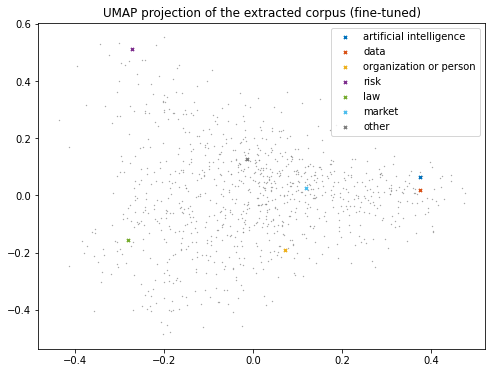

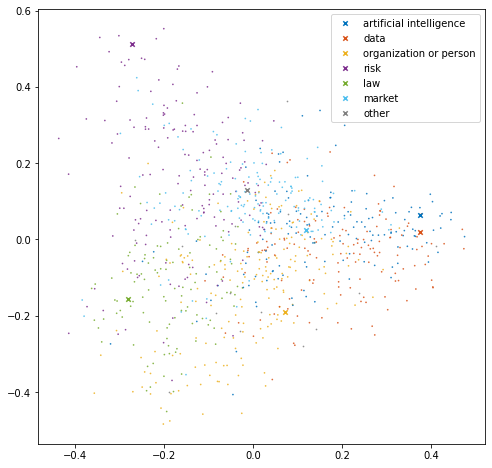

cluster size :
|-artificial intelligence : 146
|-data : 144
|-organization or person : 193
|-risk : 162
|-law : 116
|-market : 160
|-other : 15
  |-unlabeled terms within 'other': 14
0.044813648


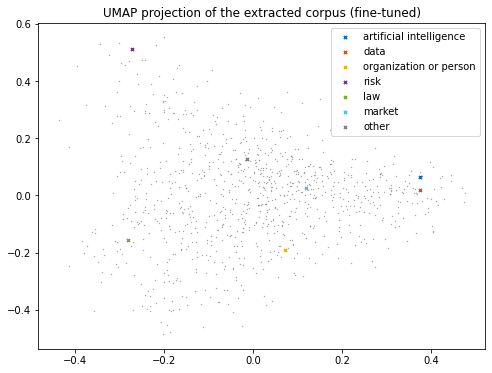

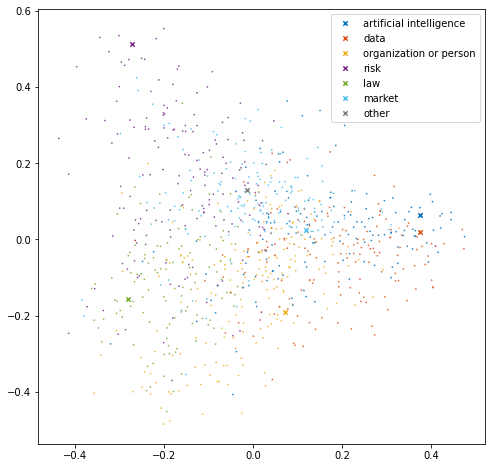

cluster size :
|-artificial intelligence : 148
|-data : 148
|-organization or person : 194
|-risk : 163
|-law : 117
|-market : 161
|-other : 5
  |-unlabeled terms within 'other': 0
-0.07287581


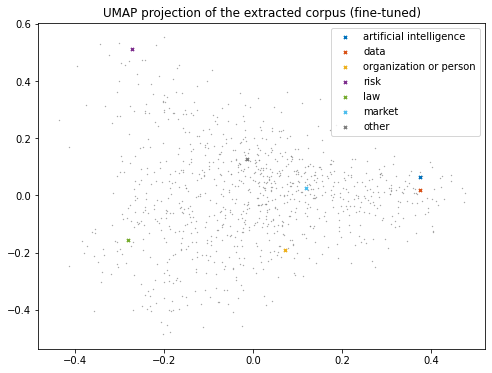

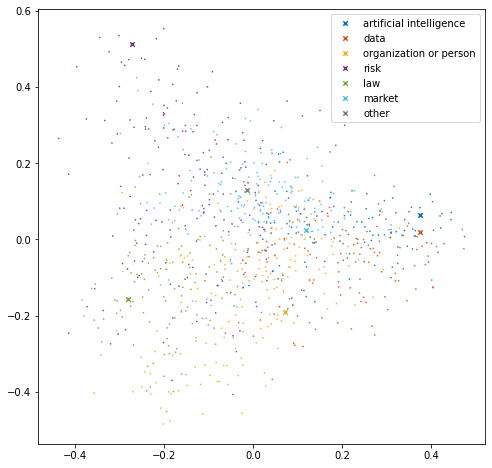

cluster size :
|-artificial intelligence : 148
|-data : 148
|-organization or person : 194
|-risk : 163
|-law : 117
|-market : 161
|-other : 5
  |-unlabeled terms within 'other': 4
0.0337219


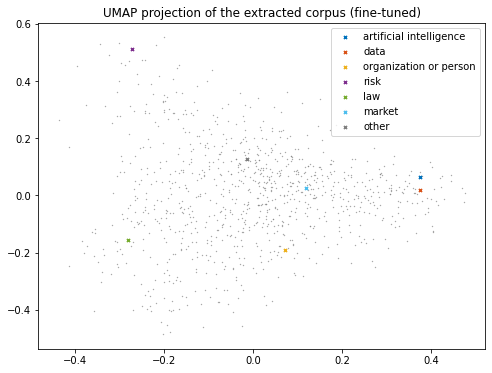

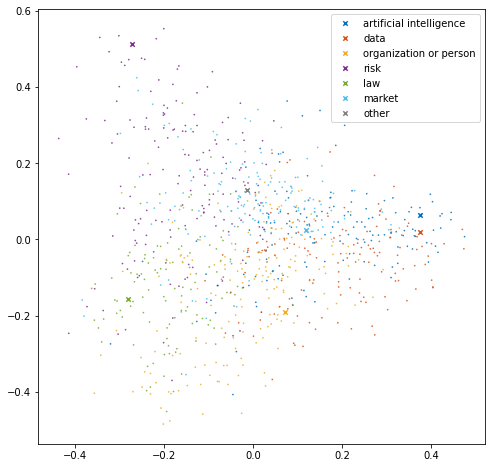

cluster size :
|-artificial intelligence : 149
|-data : 148
|-organization or person : 194
|-risk : 164
|-law : 117
|-market : 161
|-other : 3
  |-unlabeled terms within 'other': 0
-0.07447378


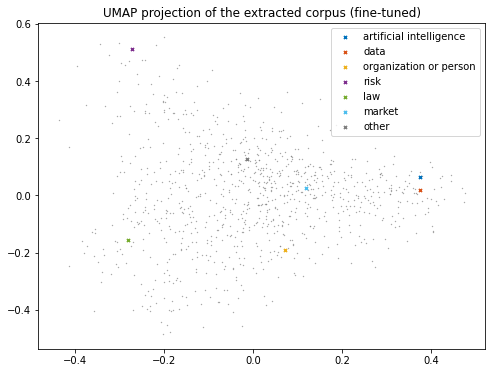

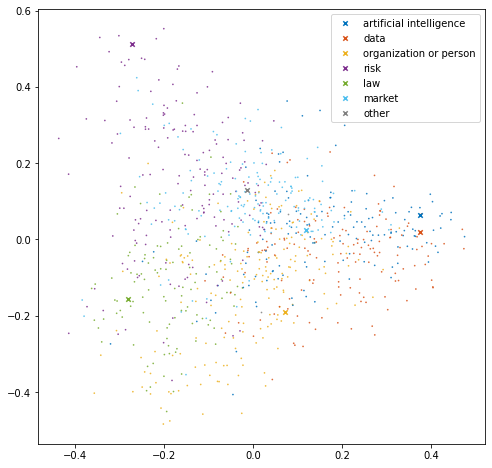

cluster size :
|-artificial intelligence : 149
|-data : 148
|-organization or person : 194
|-risk : 164
|-law : 117
|-market : 161
|-other : 3
  |-unlabeled terms within 'other': 2
0.034731913


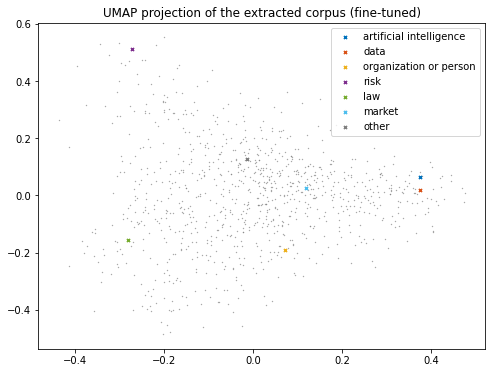

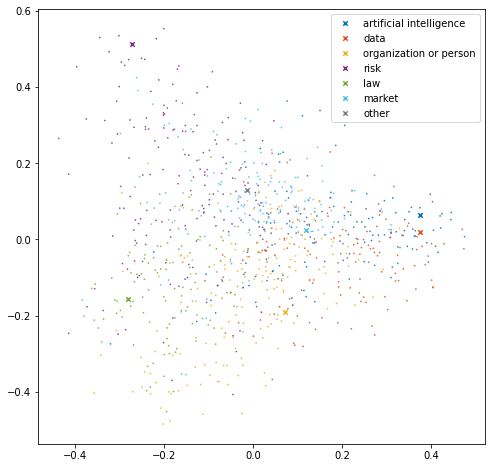

cluster size :
|-artificial intelligence : 149
|-data : 148
|-organization or person : 194
|-risk : 164
|-law : 117
|-market : 161
|-other : 3
  |-unlabeled terms within 'other': 0
-0.07418924


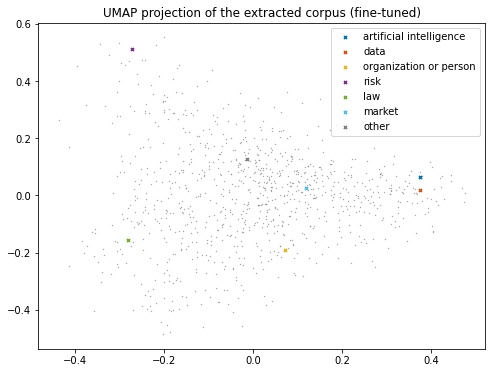

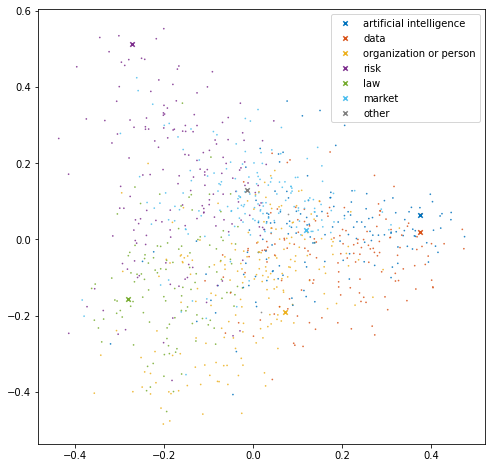

cluster size :
|-artificial intelligence : 149
|-data : 148
|-organization or person : 194
|-risk : 164
|-law : 117
|-market : 161
|-other : 3
  |-unlabeled terms within 'other': 2
0.03335051


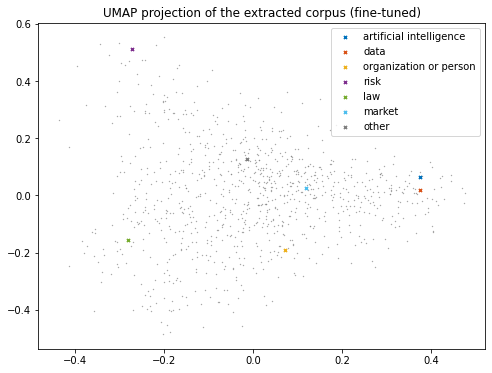

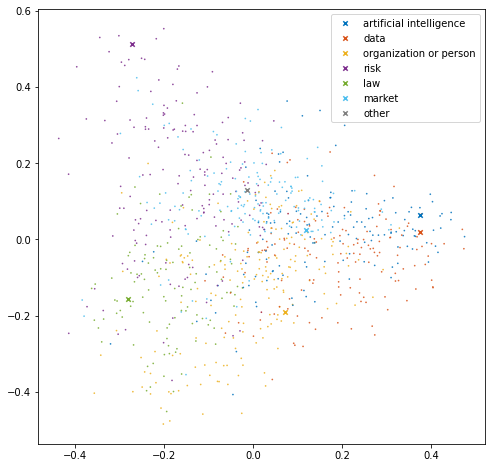

cluster size :
|-artificial intelligence : 149
|-data : 148
|-organization or person : 194
|-risk : 164
|-law : 117
|-market : 161
|-other : 3
  |-unlabeled terms within 'other': 0
-0.07130715


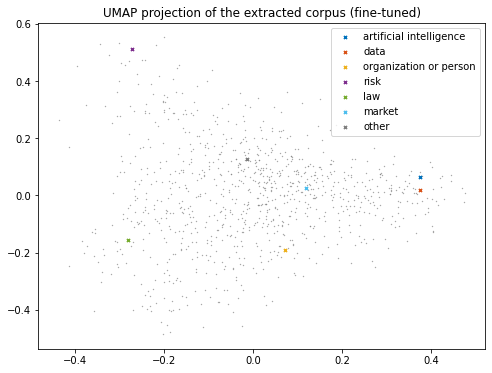

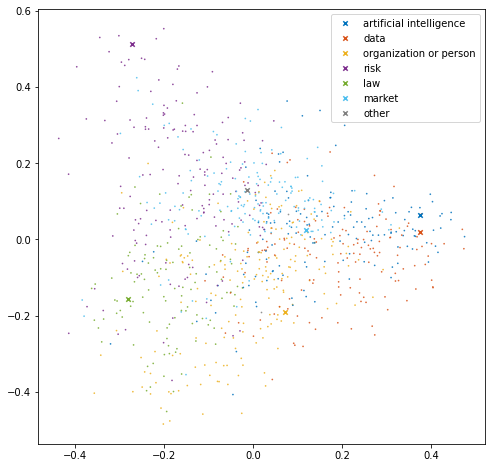

cluster size :
|-artificial intelligence : 149
|-data : 148
|-organization or person : 194
|-risk : 164
|-law : 117
|-market : 161
|-other : 3
  |-unlabeled terms within 'other': 2
0.032606866


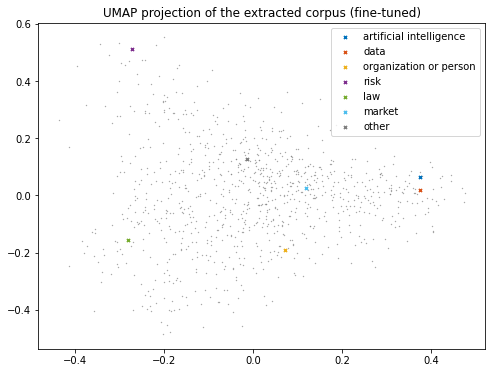

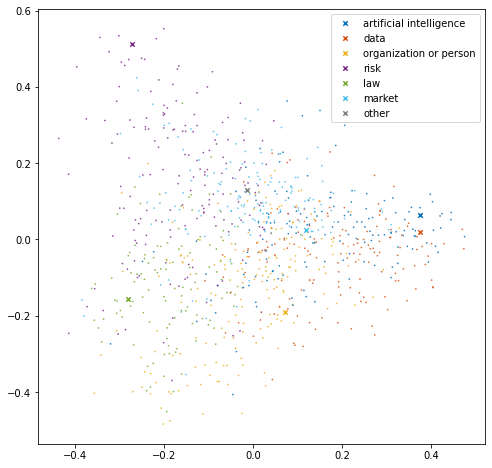

cluster size :
|-artificial intelligence : 149
|-data : 148
|-organization or person : 194
|-risk : 164
|-law : 117
|-market : 161
|-other : 3
  |-unlabeled terms within 'other': 0


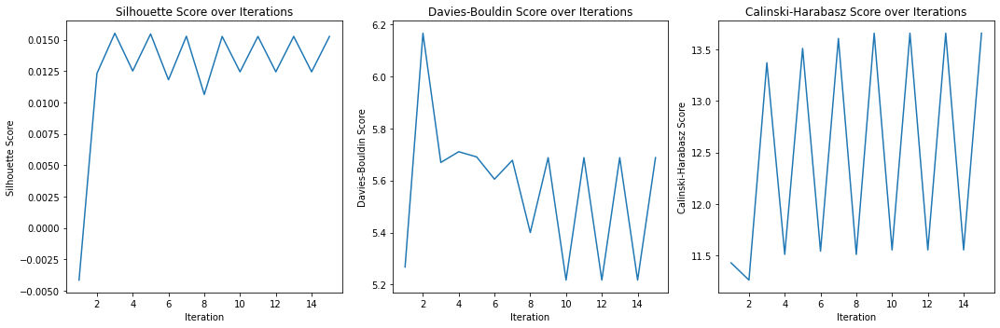

Silhouette : 0.01526455
Davies Bouldin : 5.687682138059859
Calinski Harabasz : 13.65810895475336


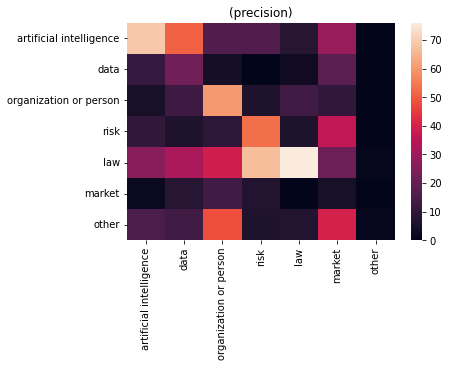

size of predicted terms: 900
Accuracy : 0.31777777777777777
Precision : 0.46706353459752165
Recall : 0.31777777777777777
f1 : 0.32415497199217497
                            Term              Prediction  \
0            administrative task  organization or person   
1             particular account  organization or person   
2        common procedure (other                    data   
3                     safe space                    risk   
4  council of the european union  organization or person   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


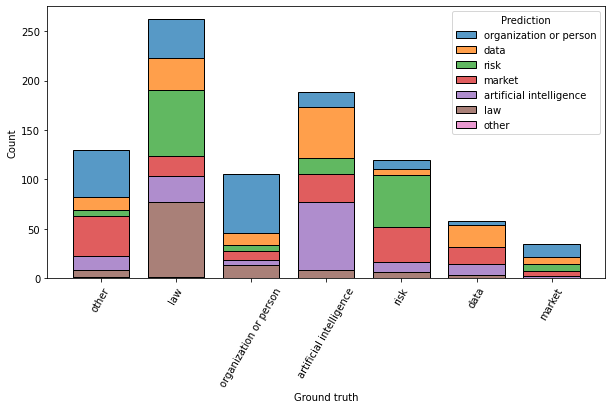


Summary:
    Accuracy  Precision    Recall        F1  Silhouette  Davies Bouldin  \
1   0.303333   0.400153  0.303333  0.320296    0.018024        5.613532   
2   0.326667   0.422073  0.326667  0.345525    0.020496        5.234668   
5   0.323333   0.382823  0.323333  0.327223    0.013371        6.439621   
10  0.330000   0.406346  0.330000  0.345770    0.017826        5.585720   
15  0.317778   0.467064  0.317778  0.324155    0.015265        5.687682   

    Calinski Harabasz  
1           14.050195  
2           14.594985  
5           12.417489  
10          14.100707  
15          13.658109  


In [9]:
_ =run_and_store_results(reducer="pca")

## 5. none reduction + CDBSCAN

1 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.008006533


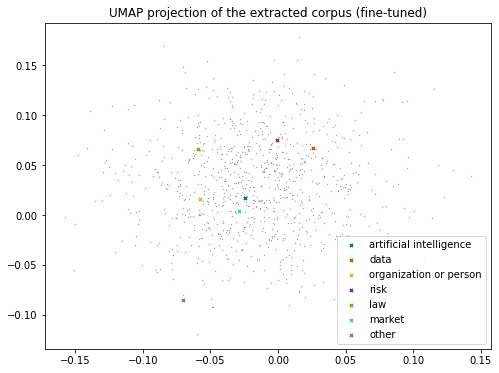

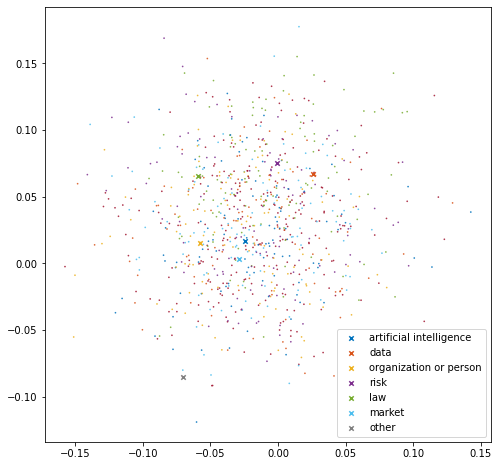

cluster size :
|-artificial intelligence : 105
|-data : 102
|-organization or person : 124
|-risk : 114
|-law : 118
|-market : 113
|-other : 260
  |-unlabeled terms within 'other': 0


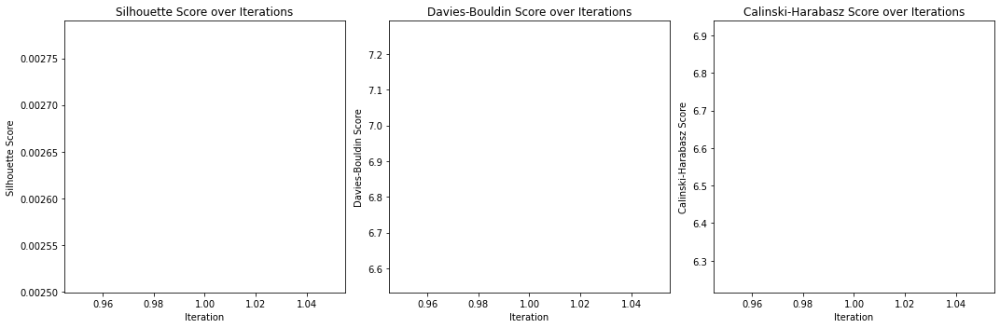

Silhouette : 0.002644647
Davies Bouldin : 6.912755240341227
Calinski Harabasz : 6.577242233460162


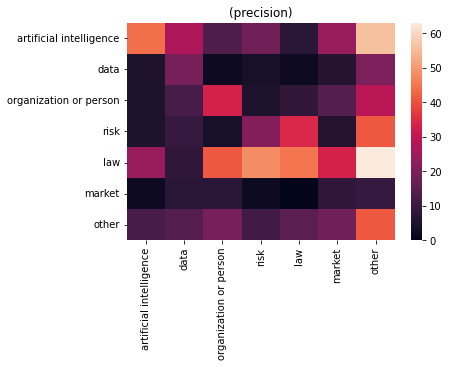

size of predicted terms: 900
Accuracy : 0.23444444444444446
Precision : 0.31009947066956534
Recall : 0.23444444444444446
f1 : 0.24453027495652993
                            Term               Prediction  \
0            administrative task   organization or person   
1             particular account                    other   
2        common procedure (other  artificial intelligence   
3                     safe space                     risk   
4  council of the european union   organization or person   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


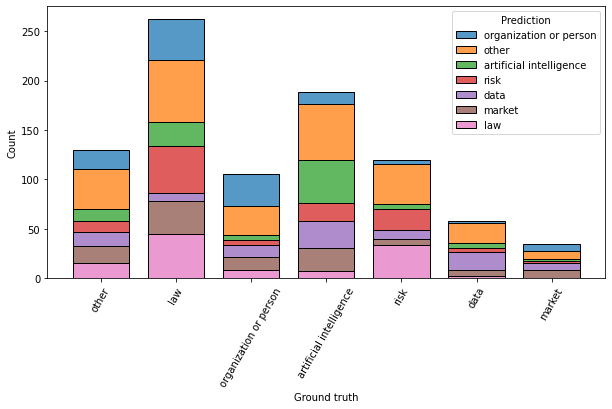

2 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.01360747


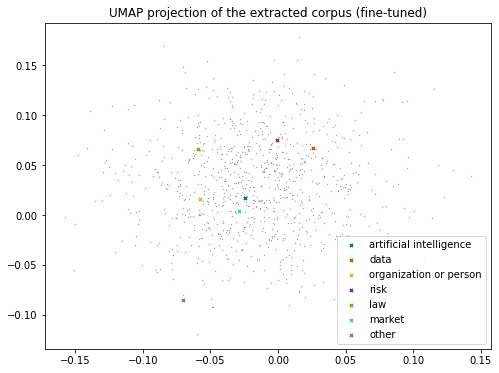

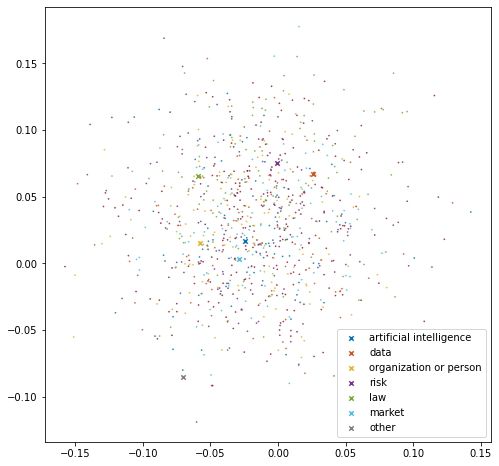

cluster size :
|-artificial intelligence : 109
|-data : 102
|-organization or person : 124
|-risk : 110
|-law : 118
|-market : 109
|-other : 264
  |-unlabeled terms within 'other': 4
-0.007971225


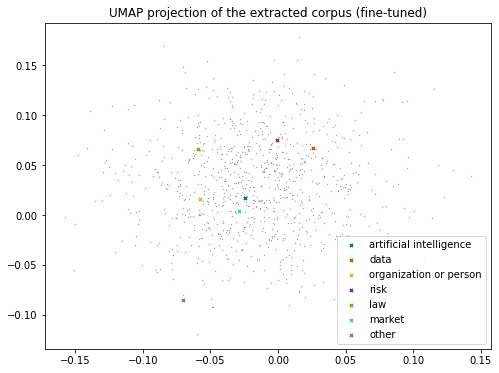

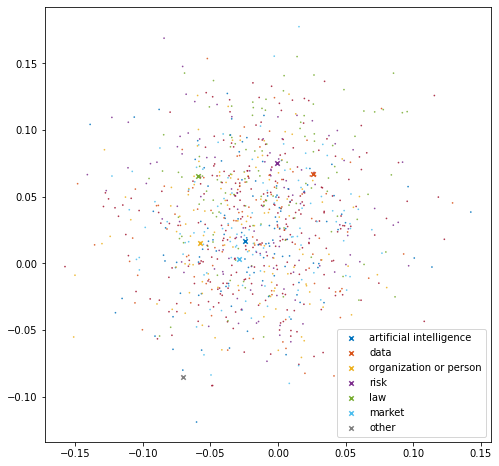

cluster size :
|-artificial intelligence : 113
|-data : 102
|-organization or person : 124
|-risk : 110
|-law : 118
|-market : 109
|-other : 260
  |-unlabeled terms within 'other': 0


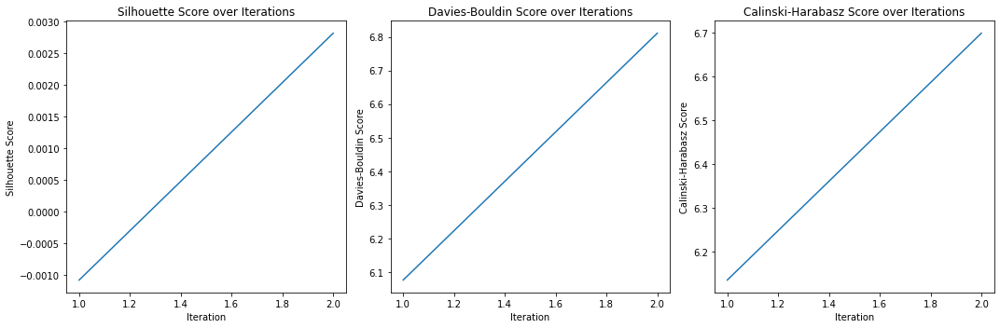

Silhouette : 0.0028205358
Davies Bouldin : 6.810813952799276
Calinski Harabasz : 6.698882889781111


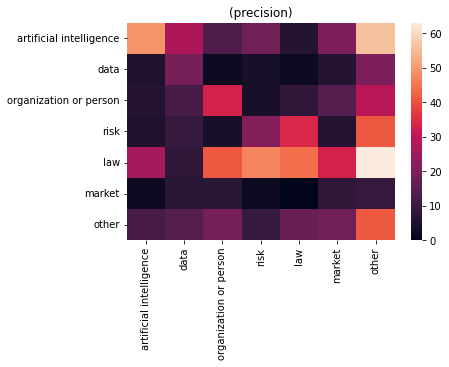

size of predicted terms: 900
Accuracy : 0.2388888888888889
Precision : 0.3113064419461478
Recall : 0.2388888888888889
f1 : 0.24891217006269148
                            Term               Prediction  \
0            administrative task   organization or person   
1             particular account                    other   
2        common procedure (other  artificial intelligence   
3                     safe space                     risk   
4  council of the european union   organization or person   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


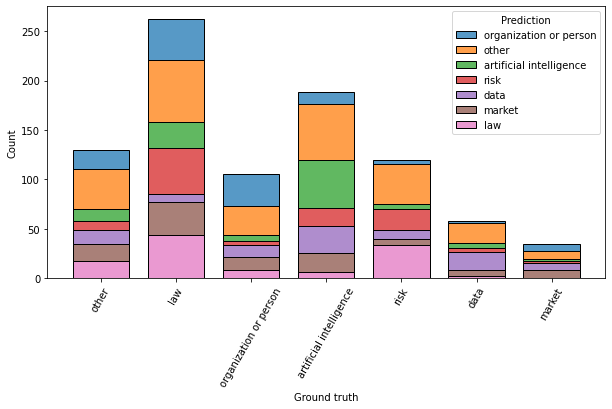

5 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.01360747


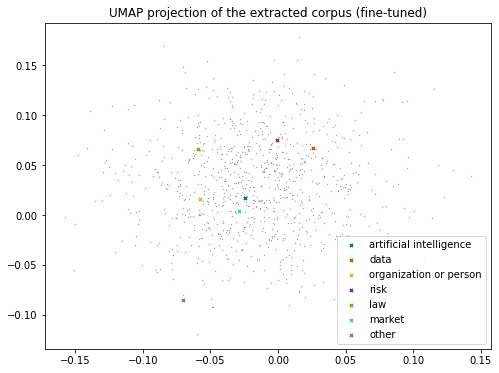

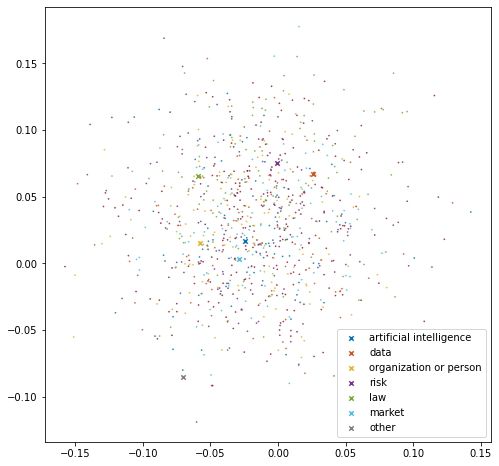

cluster size :
|-artificial intelligence : 109
|-data : 102
|-organization or person : 124
|-risk : 110
|-law : 118
|-market : 109
|-other : 264
  |-unlabeled terms within 'other': 4
-0.00788359


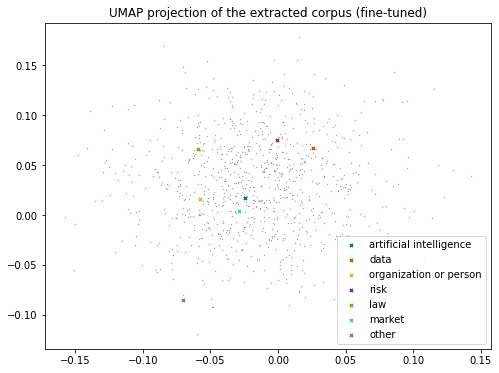

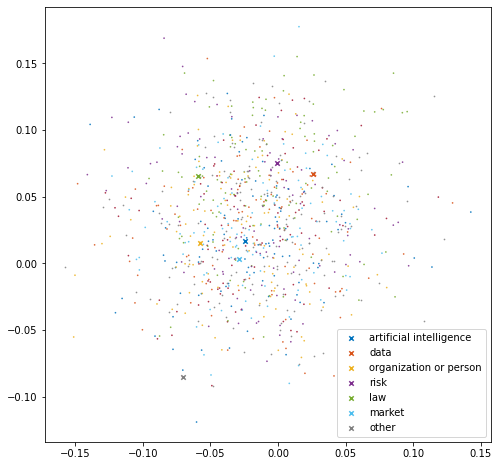

cluster size :
|-artificial intelligence : 109
|-data : 106
|-organization or person : 124
|-risk : 110
|-law : 118
|-market : 109
|-other : 260
  |-unlabeled terms within 'other': 164
-0.008194961


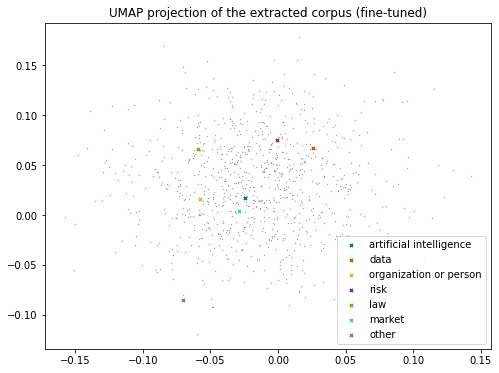

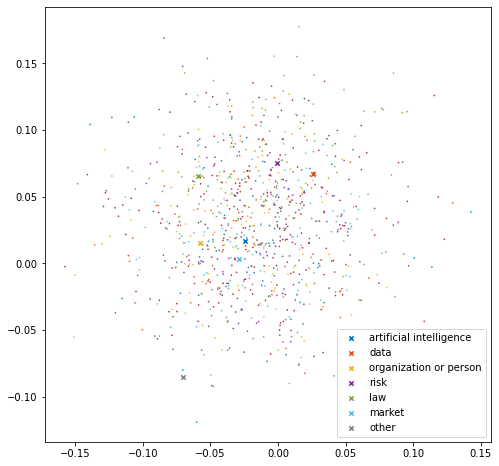

cluster size :
|-artificial intelligence : 109
|-data : 106
|-organization or person : 124
|-risk : 110
|-law : 118
|-market : 109
|-other : 260
  |-unlabeled terms within 'other': 18
-0.0078302


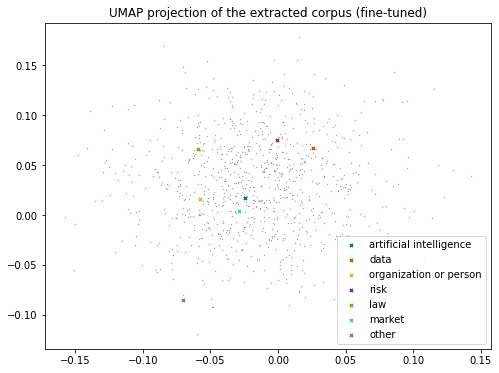

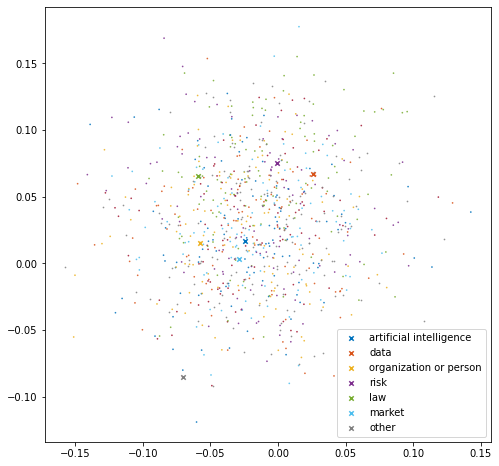

cluster size :
|-artificial intelligence : 109
|-data : 107
|-organization or person : 124
|-risk : 111
|-law : 118
|-market : 109
|-other : 258
  |-unlabeled terms within 'other': 162
-0.0075078234


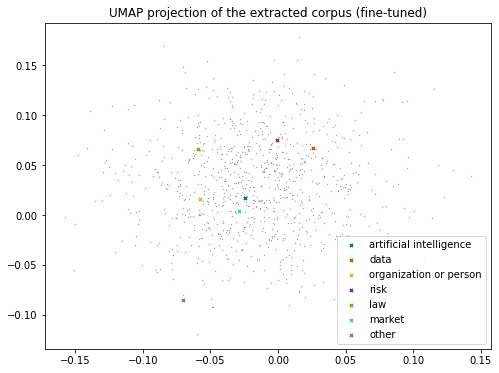

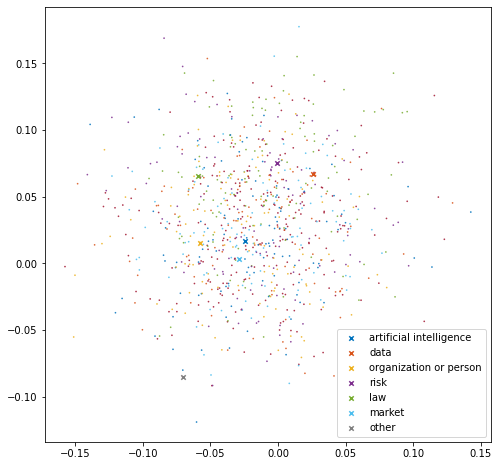

cluster size :
|-artificial intelligence : 111
|-data : 109
|-organization or person : 126
|-risk : 113
|-law : 120
|-market : 111
|-other : 246
  |-unlabeled terms within 'other': 0


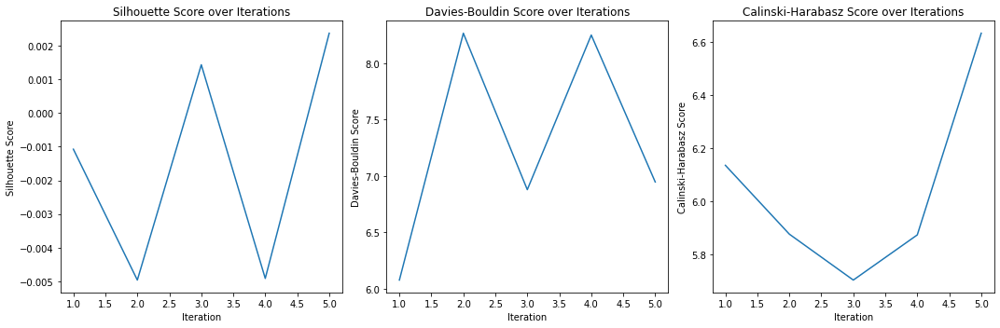

Silhouette : 0.0023722334
Davies Bouldin : 6.946330073519896
Calinski Harabasz : 6.632325208502593


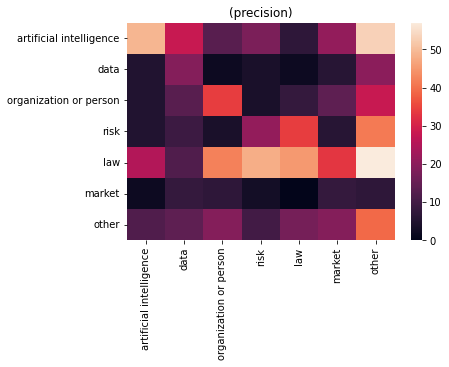

size of predicted terms: 900
Accuracy : 0.2388888888888889
Precision : 0.3126412121694223
Recall : 0.2388888888888889
f1 : 0.24982575215287475
                            Term               Prediction  \
0            administrative task   organization or person   
1             particular account                    other   
2        common procedure (other  artificial intelligence   
3                     safe space                     risk   
4  council of the european union   organization or person   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


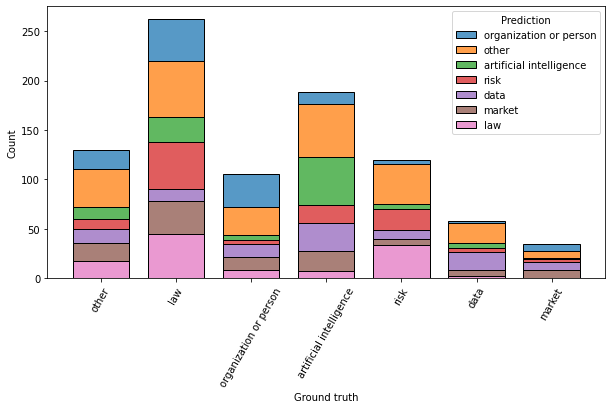

10 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.01360747


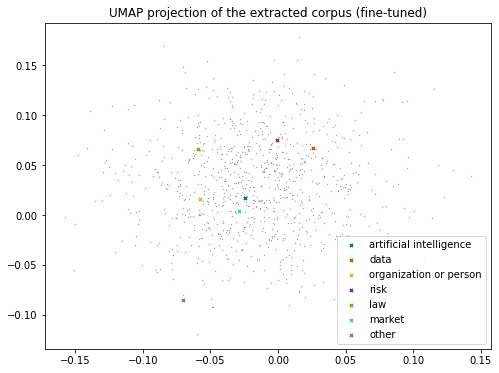

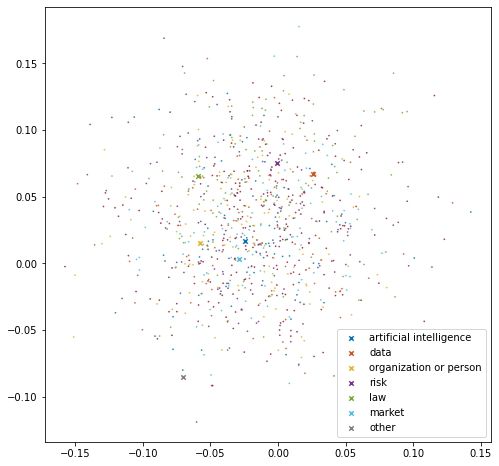

cluster size :
|-artificial intelligence : 109
|-data : 102
|-organization or person : 124
|-risk : 110
|-law : 118
|-market : 109
|-other : 264
  |-unlabeled terms within 'other': 4
-0.00788359


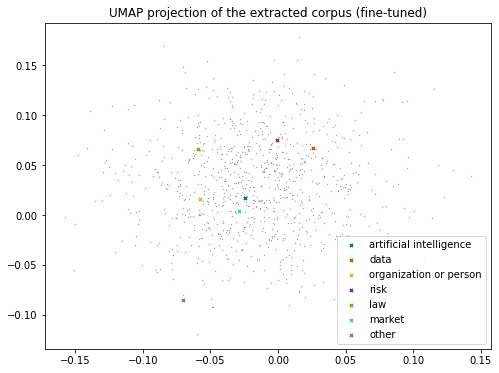

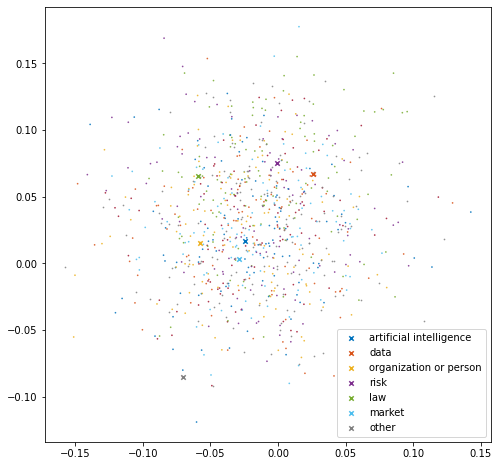

cluster size :
|-artificial intelligence : 109
|-data : 106
|-organization or person : 124
|-risk : 110
|-law : 118
|-market : 109
|-other : 260
  |-unlabeled terms within 'other': 164
-0.008194961


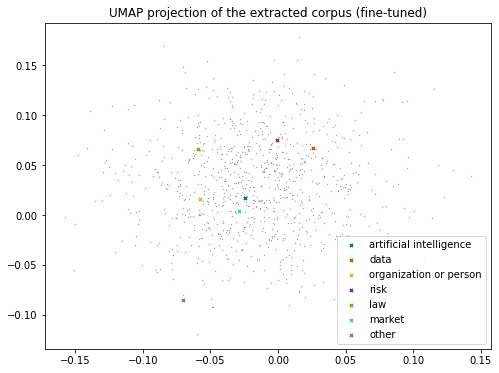

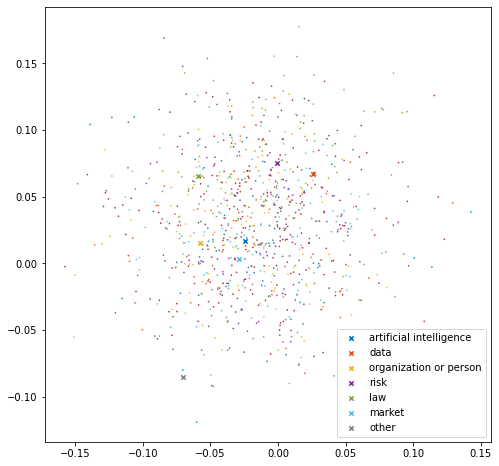

cluster size :
|-artificial intelligence : 109
|-data : 106
|-organization or person : 124
|-risk : 110
|-law : 118
|-market : 109
|-other : 260
  |-unlabeled terms within 'other': 18
-0.0078302


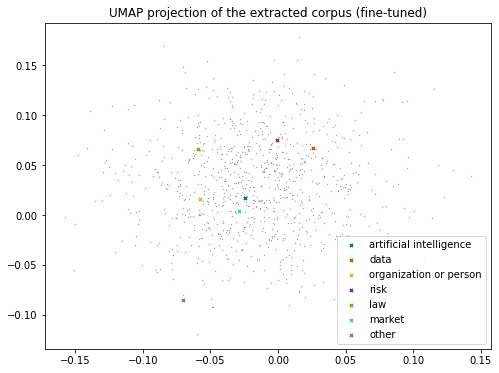

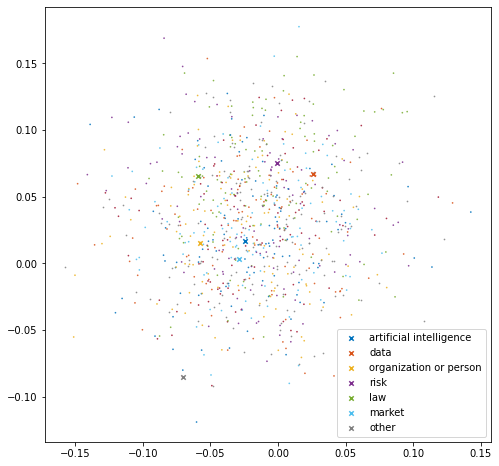

cluster size :
|-artificial intelligence : 109
|-data : 107
|-organization or person : 124
|-risk : 111
|-law : 118
|-market : 109
|-other : 258
  |-unlabeled terms within 'other': 162
-0.008195625


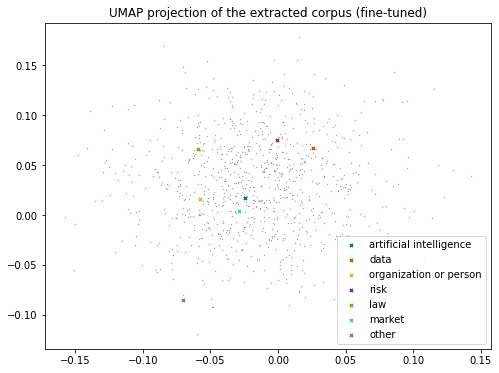

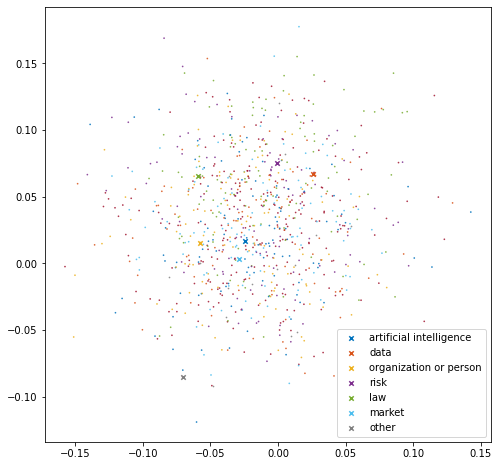

cluster size :
|-artificial intelligence : 109
|-data : 107
|-organization or person : 124
|-risk : 111
|-law : 118
|-market : 109
|-other : 258
  |-unlabeled terms within 'other': 16
-0.0078005125


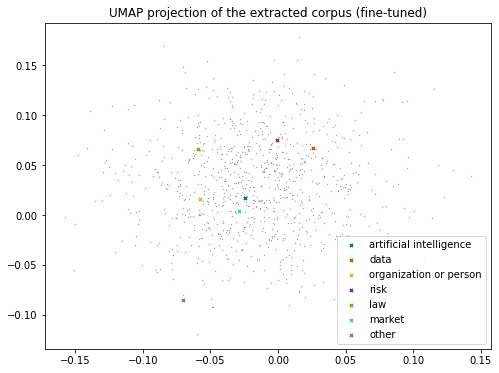

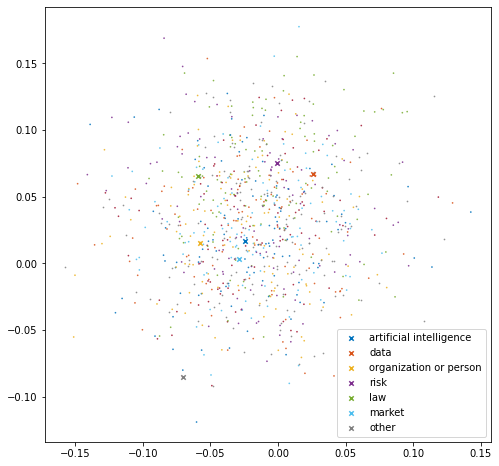

cluster size :
|-artificial intelligence : 109
|-data : 108
|-organization or person : 124
|-risk : 112
|-law : 118
|-market : 109
|-other : 256
  |-unlabeled terms within 'other': 160
-0.008245795


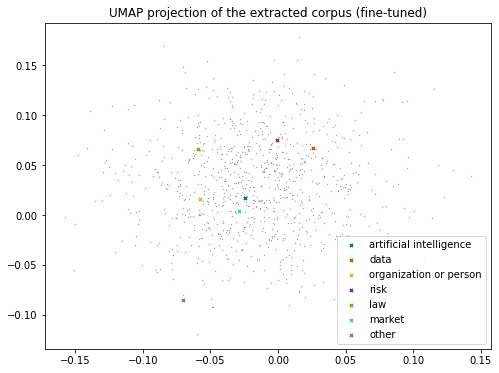

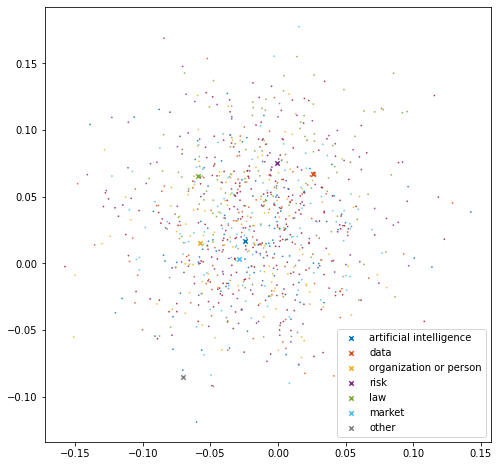

cluster size :
|-artificial intelligence : 109
|-data : 108
|-organization or person : 124
|-risk : 112
|-law : 118
|-market : 109
|-other : 256
  |-unlabeled terms within 'other': 14
-0.0078122583


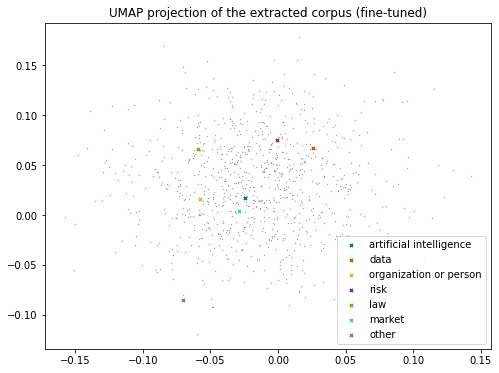

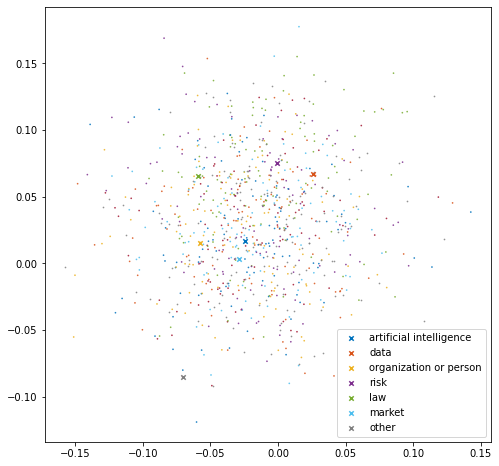

cluster size :
|-artificial intelligence : 109
|-data : 109
|-organization or person : 124
|-risk : 113
|-law : 118
|-market : 109
|-other : 254
  |-unlabeled terms within 'other': 158
-0.0084479945


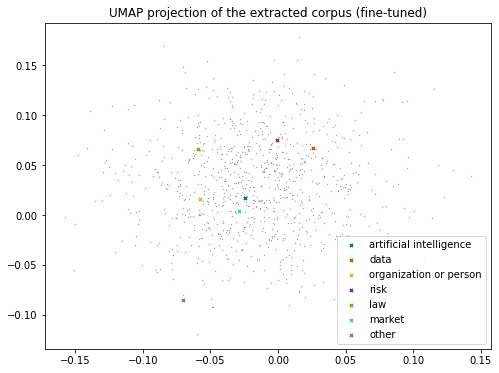

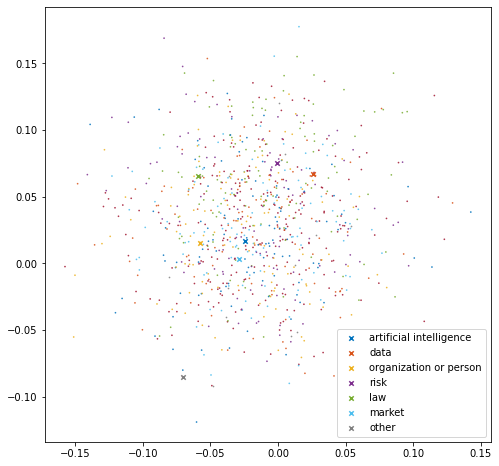

cluster size :
|-artificial intelligence : 109
|-data : 109
|-organization or person : 124
|-risk : 113
|-law : 118
|-market : 109
|-other : 254
  |-unlabeled terms within 'other': 12
-0.007595049


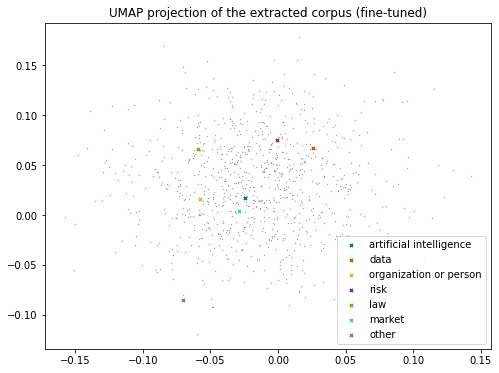

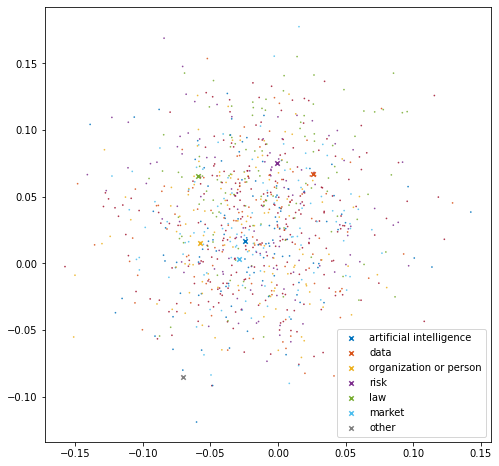

cluster size :
|-artificial intelligence : 111
|-data : 111
|-organization or person : 125
|-risk : 114
|-law : 119
|-market : 110
|-other : 246
  |-unlabeled terms within 'other': 0


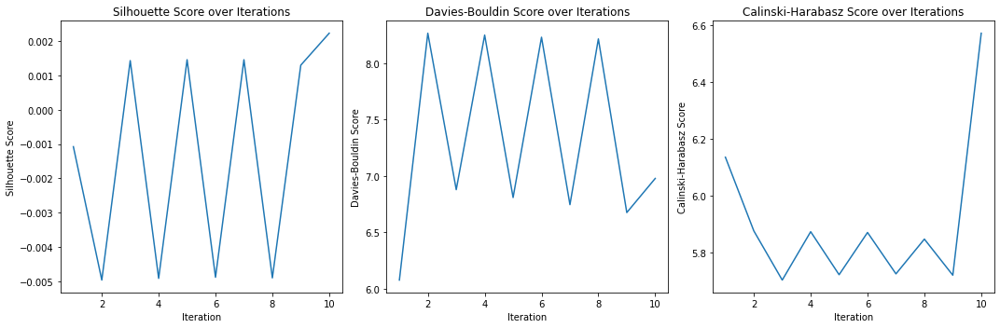

Silhouette : 0.0022340158
Davies Bouldin : 6.977590676960723
Calinski Harabasz : 6.570926180490892


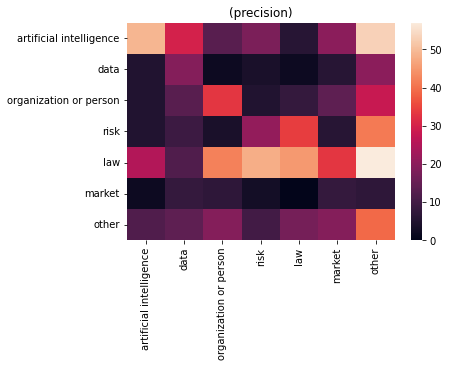

size of predicted terms: 900
Accuracy : 0.23777777777777778
Precision : 0.3125337440414968
Recall : 0.23777777777777778
f1 : 0.24886358291857374
                            Term               Prediction  \
0            administrative task   organization or person   
1             particular account                    other   
2        common procedure (other  artificial intelligence   
3                     safe space                     risk   
4  council of the european union   organization or person   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


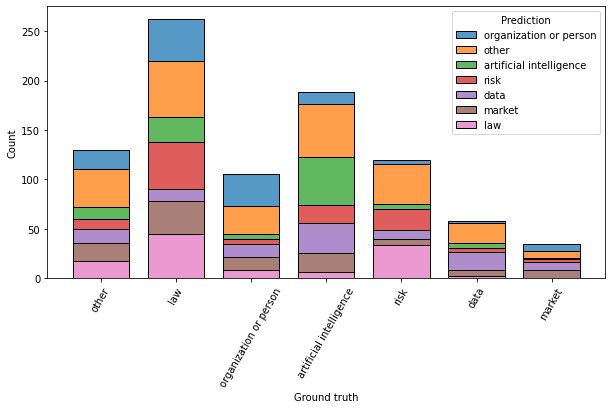

15 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.01360747


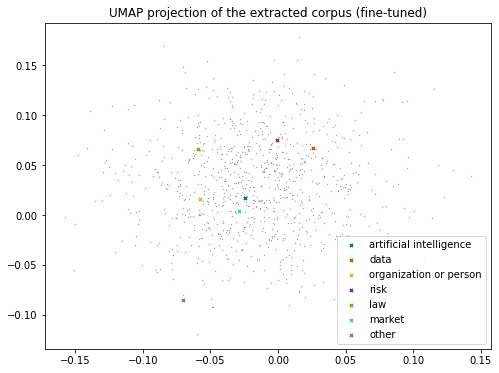

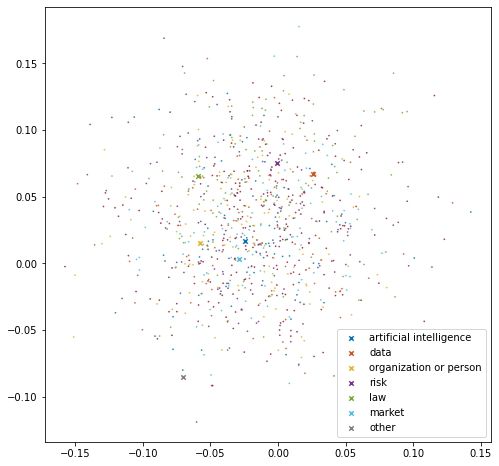

cluster size :
|-artificial intelligence : 109
|-data : 102
|-organization or person : 124
|-risk : 110
|-law : 118
|-market : 109
|-other : 264
  |-unlabeled terms within 'other': 4
-0.00788359


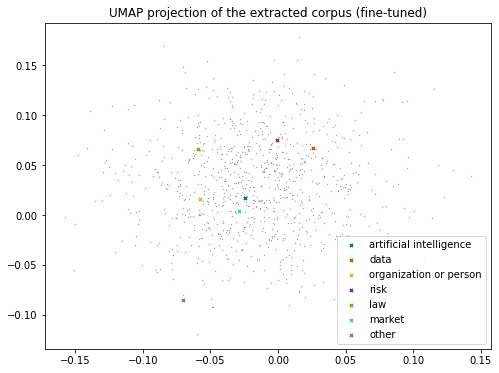

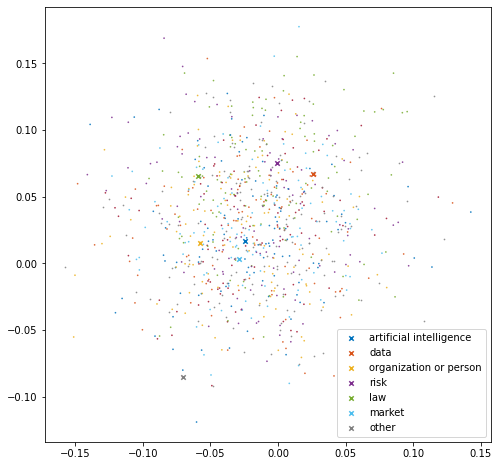

cluster size :
|-artificial intelligence : 109
|-data : 106
|-organization or person : 124
|-risk : 110
|-law : 118
|-market : 109
|-other : 260
  |-unlabeled terms within 'other': 164
-0.008194961


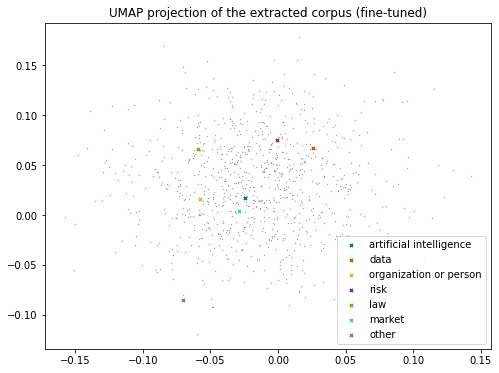

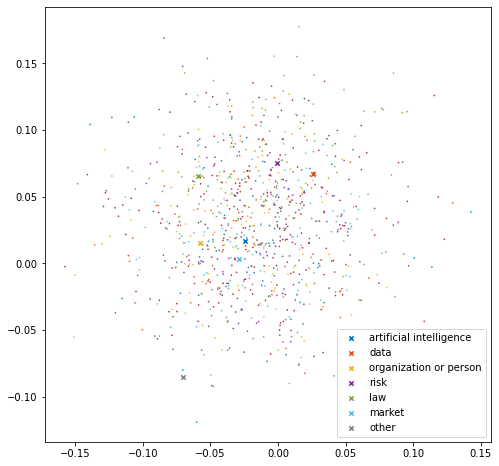

cluster size :
|-artificial intelligence : 109
|-data : 106
|-organization or person : 124
|-risk : 110
|-law : 118
|-market : 109
|-other : 260
  |-unlabeled terms within 'other': 18
-0.0078302


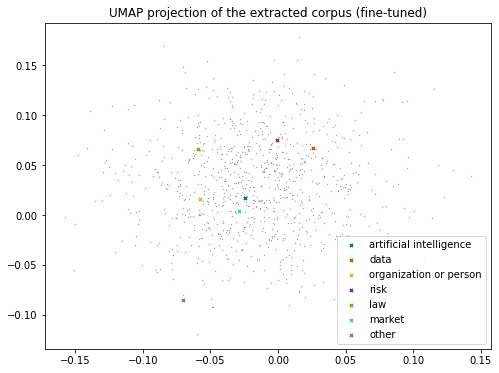

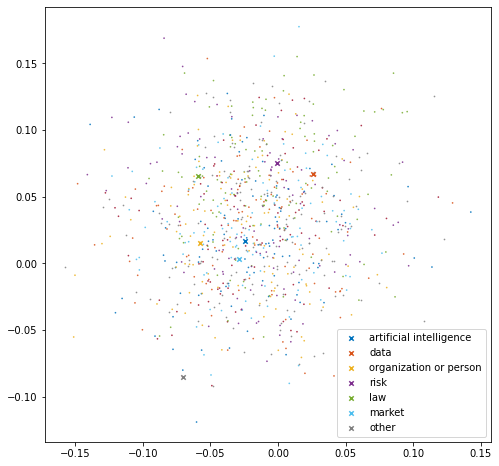

cluster size :
|-artificial intelligence : 109
|-data : 107
|-organization or person : 124
|-risk : 111
|-law : 118
|-market : 109
|-other : 258
  |-unlabeled terms within 'other': 162
-0.008195625


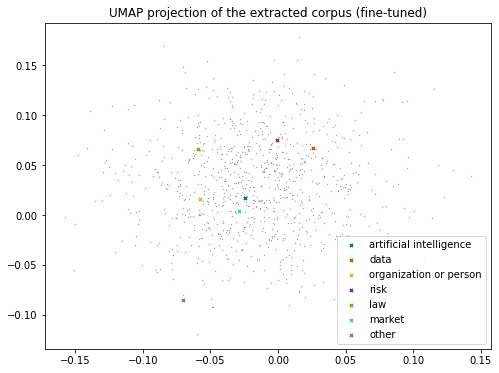

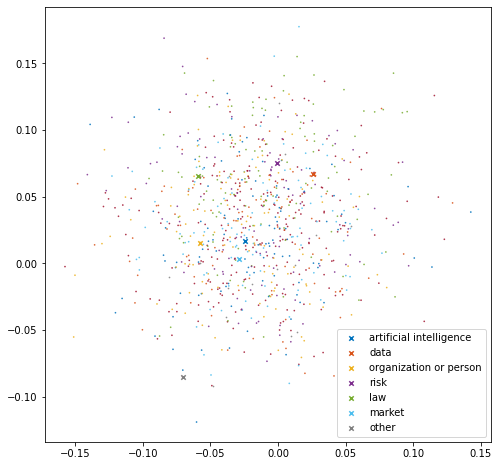

cluster size :
|-artificial intelligence : 109
|-data : 107
|-organization or person : 124
|-risk : 111
|-law : 118
|-market : 109
|-other : 258
  |-unlabeled terms within 'other': 16
-0.0078005125


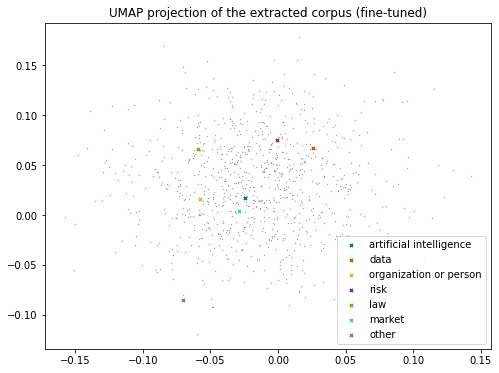

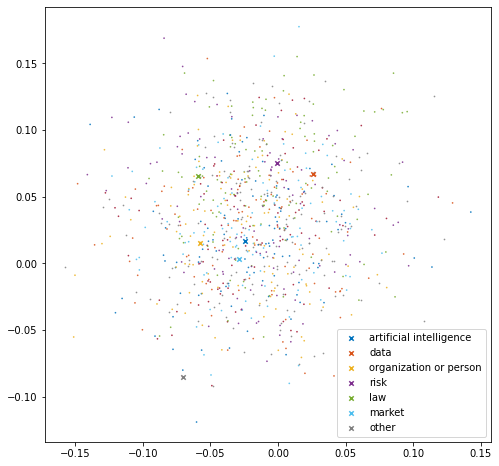

cluster size :
|-artificial intelligence : 109
|-data : 108
|-organization or person : 124
|-risk : 112
|-law : 118
|-market : 109
|-other : 256
  |-unlabeled terms within 'other': 160
-0.008245795


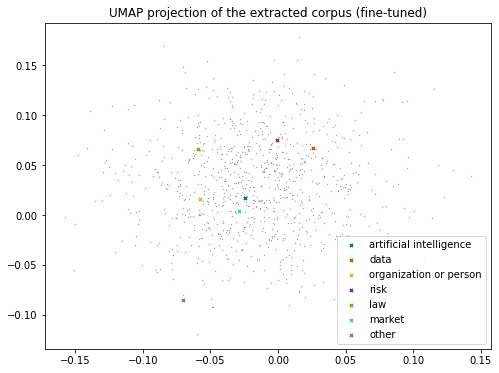

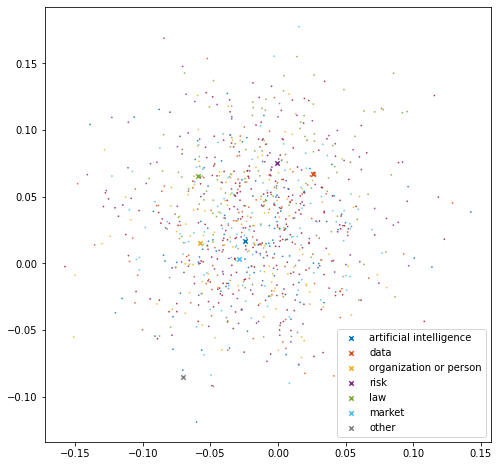

cluster size :
|-artificial intelligence : 109
|-data : 108
|-organization or person : 124
|-risk : 112
|-law : 118
|-market : 109
|-other : 256
  |-unlabeled terms within 'other': 14
-0.0078122583


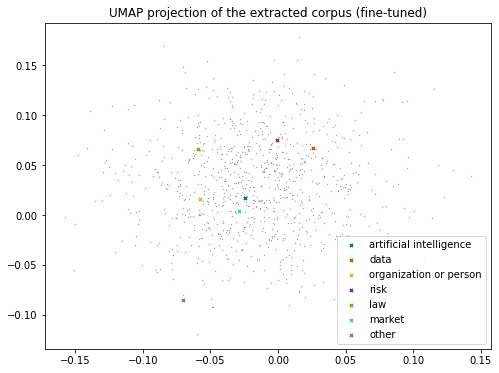

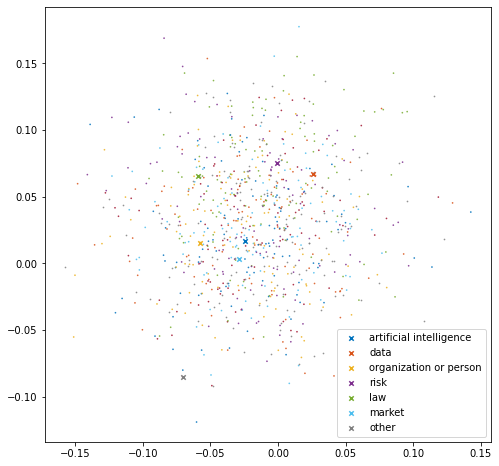

cluster size :
|-artificial intelligence : 109
|-data : 109
|-organization or person : 124
|-risk : 113
|-law : 118
|-market : 109
|-other : 254
  |-unlabeled terms within 'other': 158
-0.0084479945


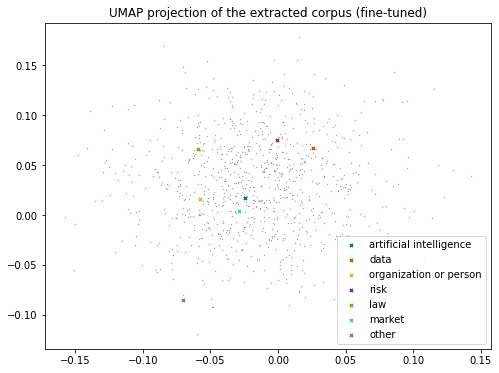

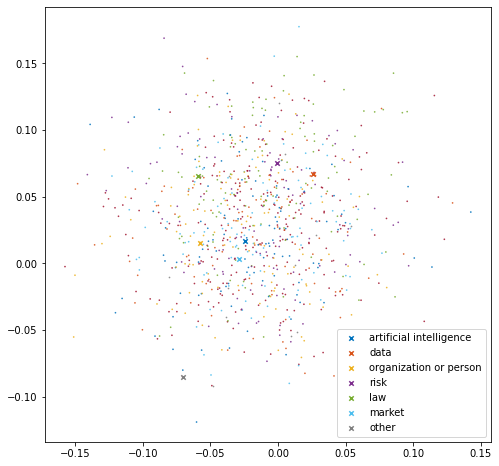

cluster size :
|-artificial intelligence : 109
|-data : 109
|-organization or person : 124
|-risk : 113
|-law : 118
|-market : 109
|-other : 254
  |-unlabeled terms within 'other': 12
-0.0077569596


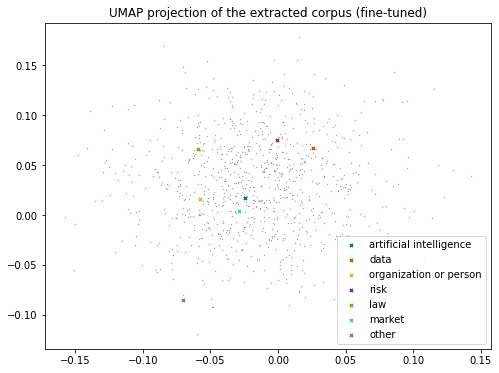

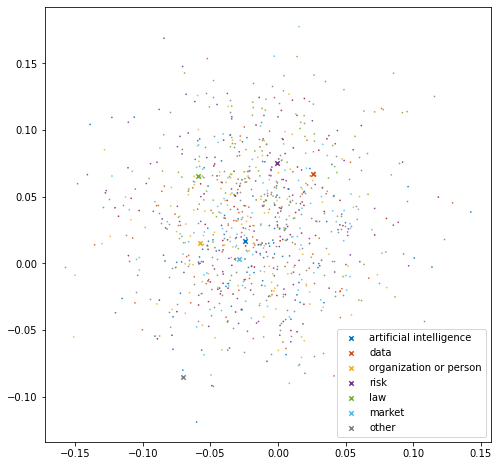

cluster size :
|-artificial intelligence : 109
|-data : 110
|-organization or person : 124
|-risk : 114
|-law : 118
|-market : 109
|-other : 252
  |-unlabeled terms within 'other': 156
-0.008735542


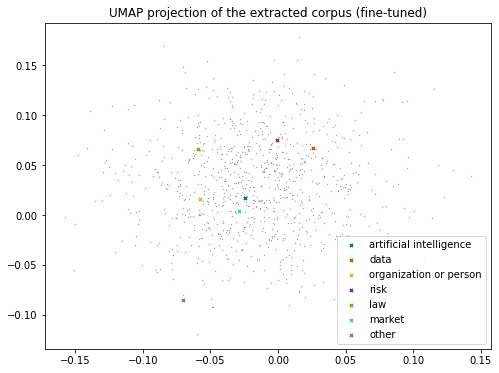

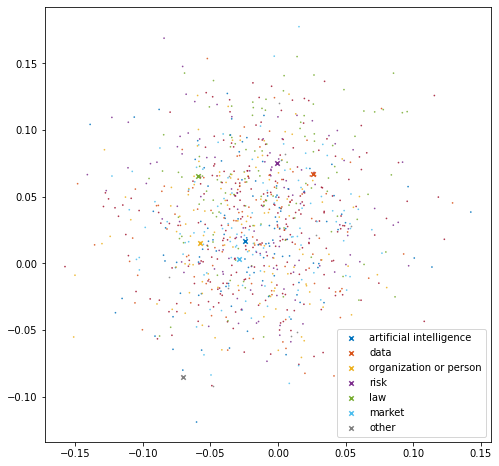

cluster size :
|-artificial intelligence : 109
|-data : 110
|-organization or person : 124
|-risk : 114
|-law : 118
|-market : 109
|-other : 252
  |-unlabeled terms within 'other': 10
-0.007756024


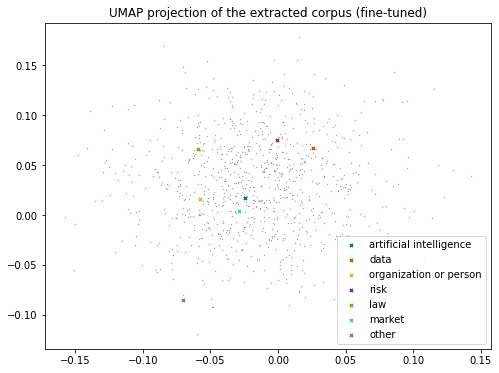

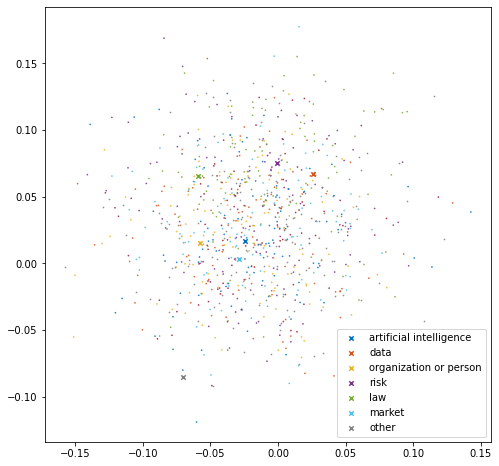

cluster size :
|-artificial intelligence : 109
|-data : 111
|-organization or person : 124
|-risk : 115
|-law : 118
|-market : 109
|-other : 250
  |-unlabeled terms within 'other': 154
-0.00890007


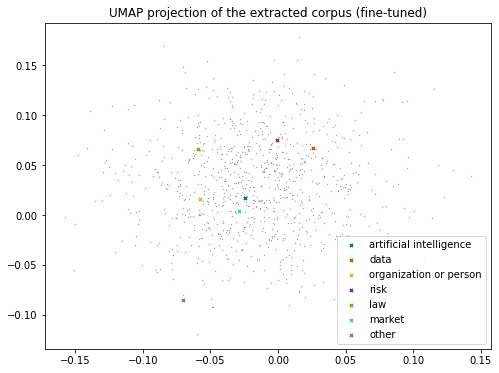

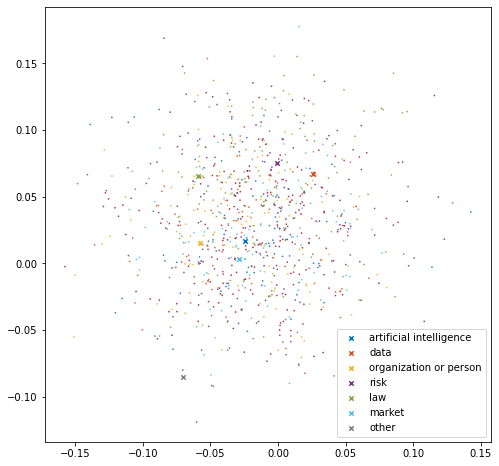

cluster size :
|-artificial intelligence : 109
|-data : 111
|-organization or person : 124
|-risk : 115
|-law : 118
|-market : 109
|-other : 250
  |-unlabeled terms within 'other': 8
-0.0076850066


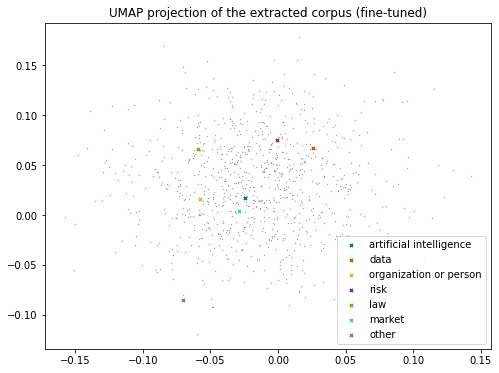

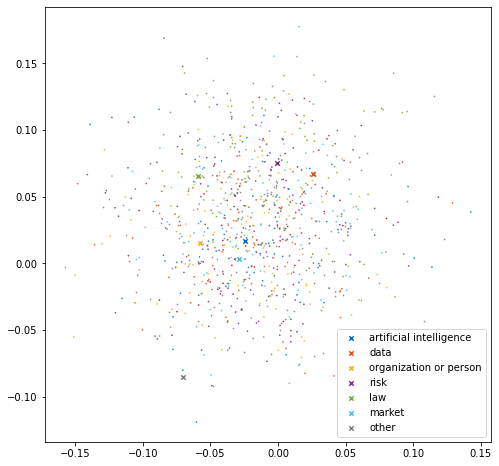

cluster size :
|-artificial intelligence : 109
|-data : 112
|-organization or person : 124
|-risk : 116
|-law : 118
|-market : 109
|-other : 248
  |-unlabeled terms within 'other': 152
-0.0077978177


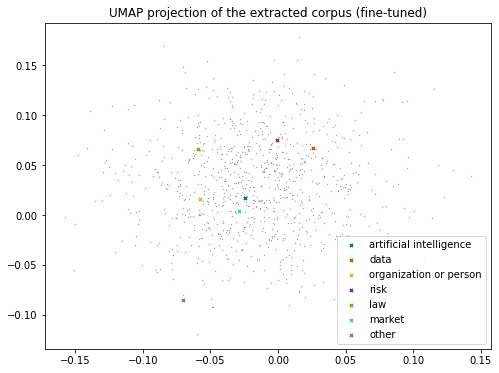

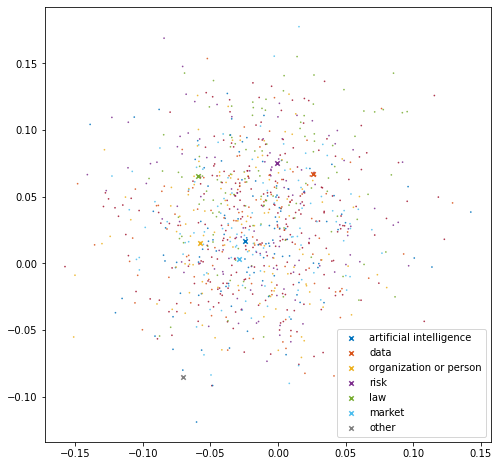

cluster size :
|-artificial intelligence : 110
|-data : 113
|-organization or person : 124
|-risk : 116
|-law : 118
|-market : 109
|-other : 246
  |-unlabeled terms within 'other': 0


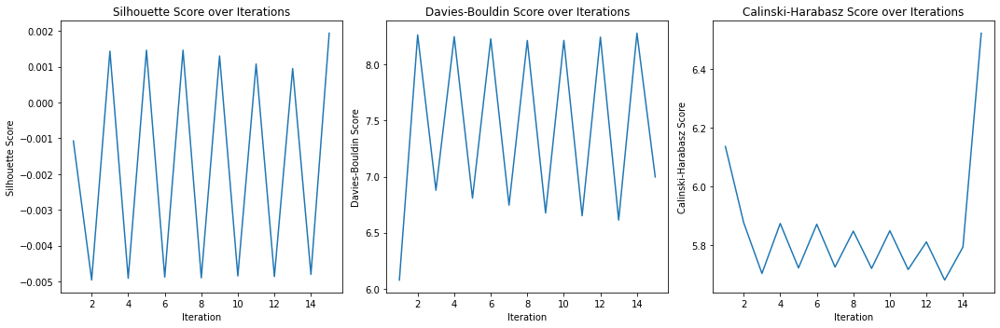

Silhouette : 0.0019373809
Davies Bouldin : 6.996883550710582
Calinski Harabasz : 6.5206033062402895


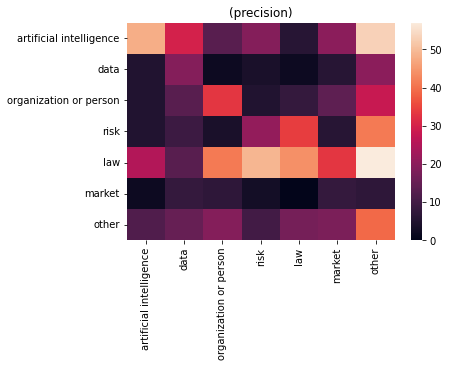

size of predicted terms: 900
Accuracy : 0.23555555555555555
Precision : 0.3095047807228755
Recall : 0.23555555555555555
f1 : 0.24607993201409636
                            Term               Prediction  \
0            administrative task   organization or person   
1             particular account                    other   
2        common procedure (other  artificial intelligence   
3                     safe space                     risk   
4  council of the european union   organization or person   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


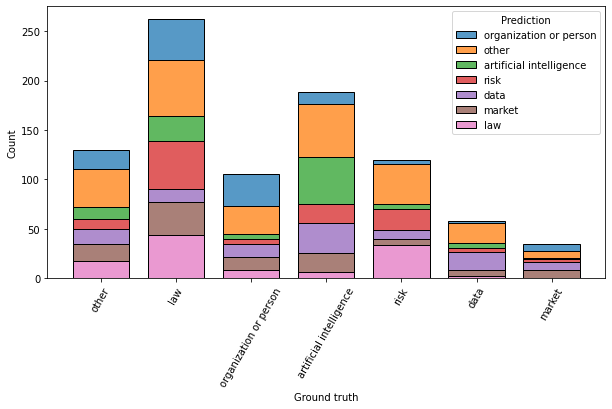


Summary:
    Accuracy  Precision    Recall        F1  Silhouette  Davies Bouldin  \
1   0.234444   0.310099  0.234444  0.244530    0.002645        6.912755   
2   0.238889   0.311306  0.238889  0.248912    0.002821        6.810814   
5   0.238889   0.312641  0.238889  0.249826    0.002372        6.946330   
10  0.237778   0.312534  0.237778  0.248864    0.002234        6.977591   
15  0.235556   0.309505  0.235556  0.246080    0.001937        6.996884   

    Calinski Harabasz  
1            6.577242  
2            6.698883  
5            6.632325  
10           6.570926  
15           6.520603  


In [10]:
_=run_and_store_results(reducer="none")

## 6. UMAP+DBSCAN 
meaningless, because the number of dbscan cluster is uncontrolllable and not refers to a core concept

1 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'other', 'organization or person', 'risk', 'law', 'data', 'market']
unique terms:  900
cannot links:21
must links:30


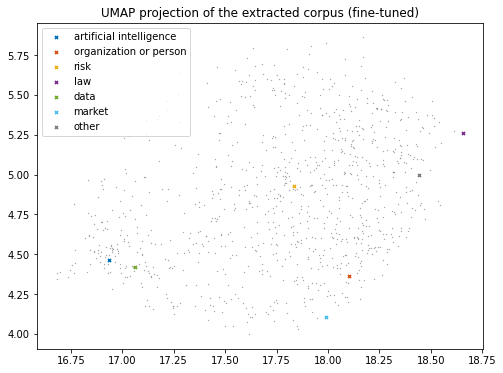

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


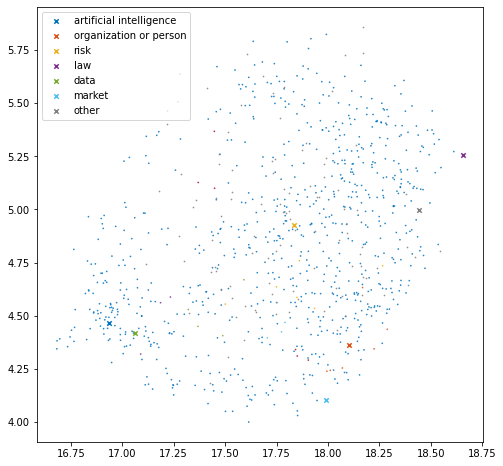

cluster size :
|-artificial intelligence : 805
|-organization or person : 6
|-risk : 3
|-law : 4
|-data : 4
|-market : 3
|-other : 108
  |-unlabeled terms within 'other': 102


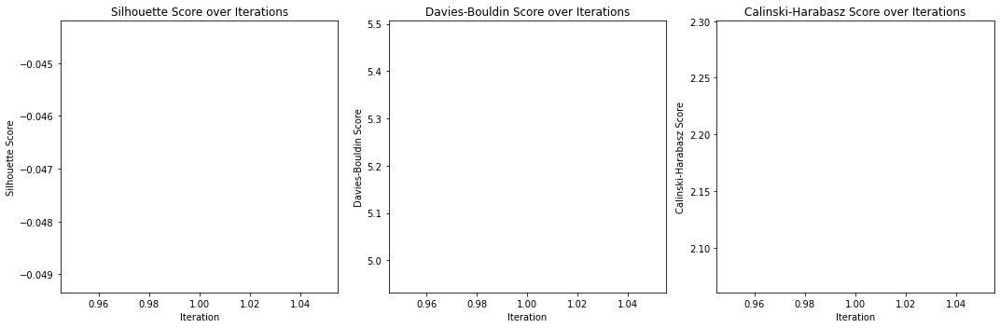

Silhouette : -0.046770837
Davies Bouldin : 5.219075033544556
Calinski Harabasz : 2.1803376088942983


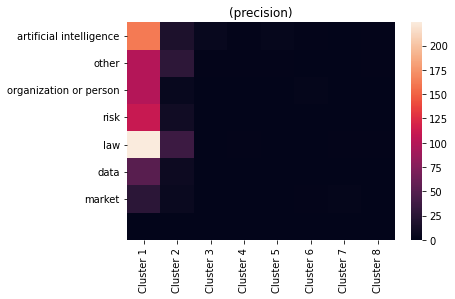

size of predicted terms: 900
Accuracy : 0.30333333333333334
Precision : 0.30203719540521135
Recall : 0.30333333333333334
f1 : 0.16125713768675126
                         Term Prediction             Ground truth
0                     vehicle        law                    other
1             social activity        law  artificial intelligence
2  lawful evaluation practice        law                      law
3              ethical aspect        law                      law
4    biometric identification        law  artificial intelligence


C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


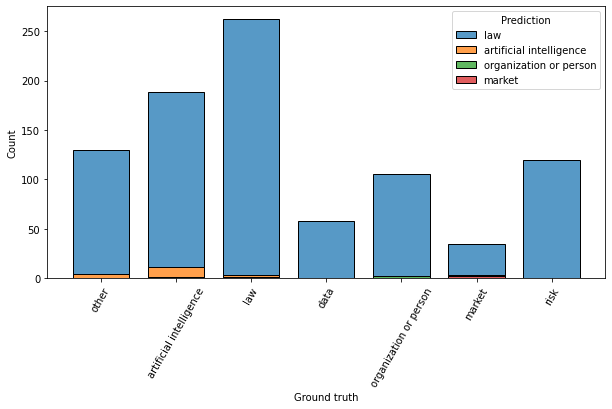


Summary:
   Accuracy  Precision    Recall        F1  Silhouette  Davies Bouldin  \
1  0.303333   0.302037  0.303333  0.161257   -0.046771        5.219075   

   Calinski Harabasz  
1           2.180338  


In [21]:
_ = run_and_store_results(clusterer="dbscan",reducer="umap")  

## 7. UMAP+SVM(with or without bagging)

1 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30


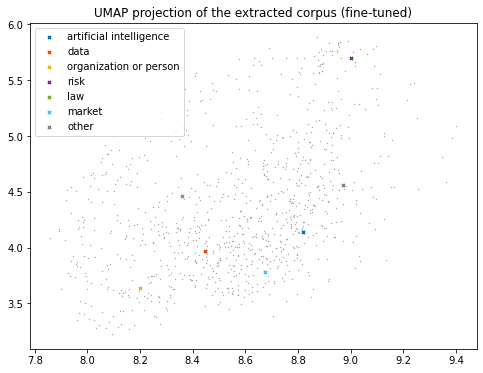

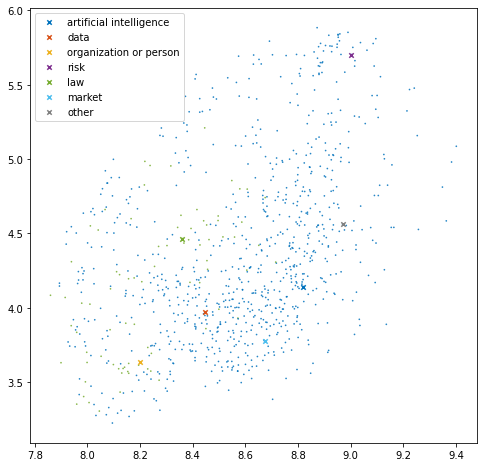

cluster size :
|-artificial intelligence : 854
|-data : 0
|-organization or person : 0
|-risk : 0
|-law : 82
|-market : 0
|-other : 0
  |-unlabeled terms within 'other': 0


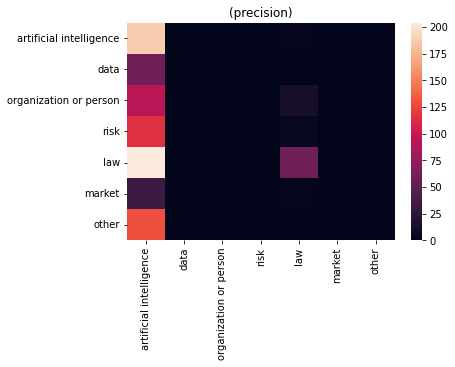

size of predicted terms: 900
Accuracy : 0.2722222222222222
Precision : 0.261559057168456
Recall : 0.2722222222222222
f1 : 0.17679137591178473
                            Term               Prediction  \
0            administrative task  artificial intelligence   
1             particular account  artificial intelligence   
2        common procedure (other  artificial intelligence   
3                     safe space  artificial intelligence   
4  council of the european union                      law   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


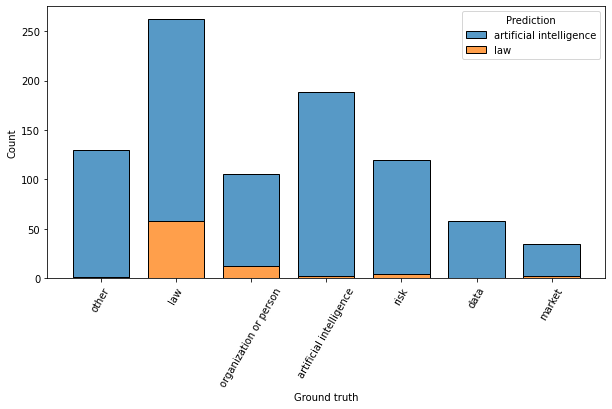

1 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30


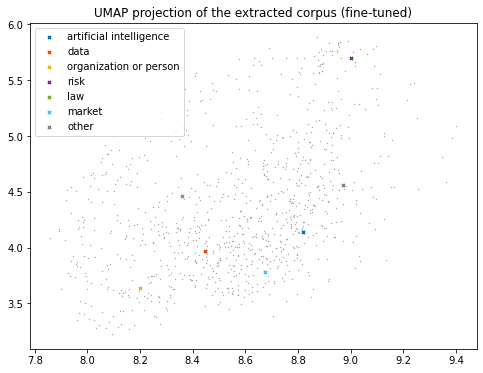

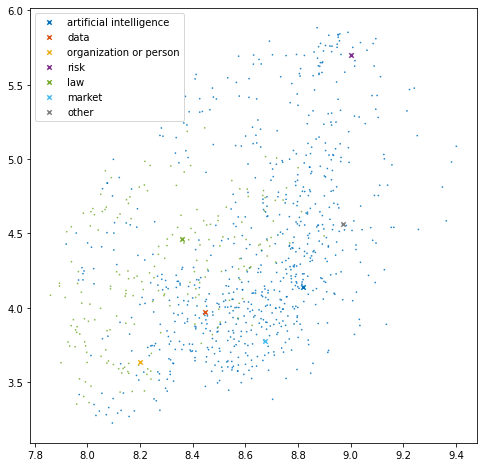

cluster size :
|-artificial intelligence : 739
|-data : 0
|-organization or person : 0
|-risk : 0
|-law : 197
|-market : 0
|-other : 0
  |-unlabeled terms within 'other': 0


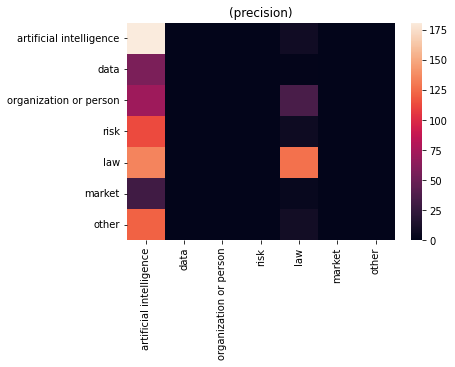

size of predicted terms: 900
Accuracy : 0.3422222222222222
Precision : 0.24717674608273416
Recall : 0.3422222222222222
f1 : 0.24788265204392285
                            Term               Prediction  \
0            administrative task  artificial intelligence   
1             particular account  artificial intelligence   
2        common procedure (other  artificial intelligence   
3                     safe space  artificial intelligence   
4  council of the european union                      law   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


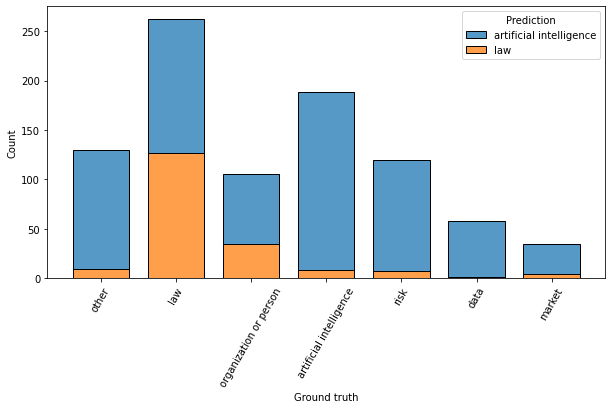

In [12]:
_=run_and_store_results(clusterer=None,classifier="svm")
_=run_and_store_results(clusterer=None,classifier="bsvm")

## 8. UMAP+ANN

1 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30


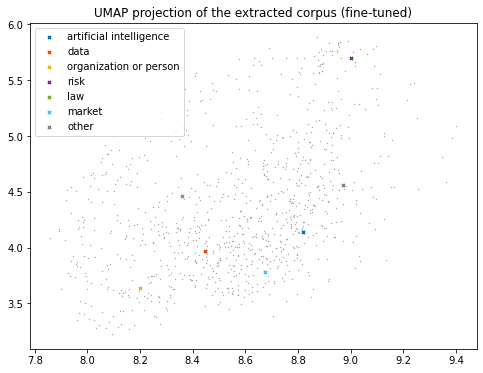

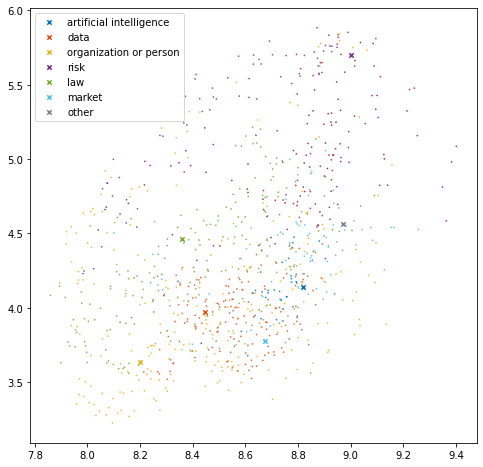

cluster size :
|-artificial intelligence : 34
|-data : 167
|-organization or person : 259
|-risk : 73
|-law : 197
|-market : 77
|-other : 129
  |-unlabeled terms within 'other': 0


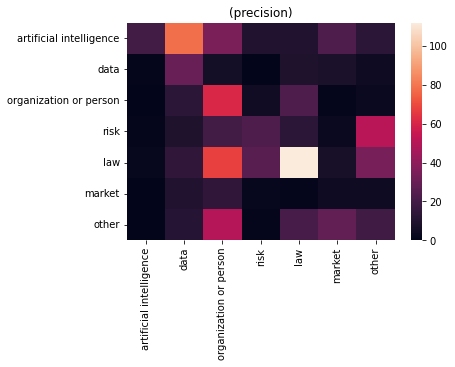

size of predicted terms: 900
Accuracy : 0.29888888888888887
Precision : 0.4569386920003515
Recall : 0.29888888888888887
f1 : 0.29831559653096534
                            Term              Prediction  \
0            administrative task  organization or person   
1             particular account  organization or person   
2        common procedure (other  organization or person   
3                     safe space                    risk   
4  council of the european union  organization or person   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


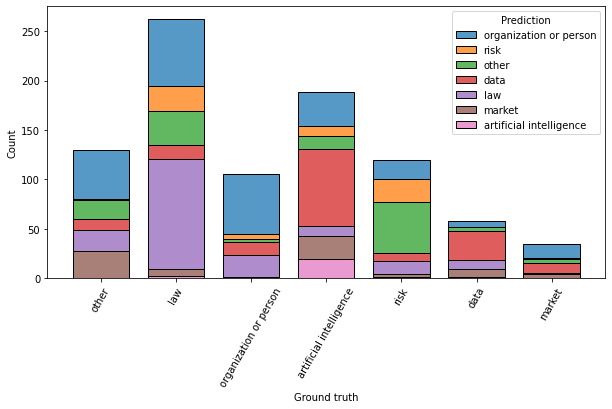

In [13]:
_=run_and_store_results(clusterer=None,classifier="ann")

## 9. SMBM

1 iterations:
['artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'data', 'personal data', 'anonymous data', 'organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'market', 'product', 'service', 'other']
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
unique terms:  900
cannot links:21
must links:30
['artificial intelligence', 'data', 'organization or person', 'risk', 'law', 'market', 'other']
[0 0 0 3 0 0 0 0 0 0 1 1 1 2 5 2 2 4 4 3 1 3 3 3 3 4 4 6 4 1 4 4 4 5 5 5 6
 0 3 1 6 1 0 0 0 0 0 1 1 0 4 5 5 1 0 3 0 4 3 4 1 3 5 0 3 4 5 3 5 0 2 0 0 0
 

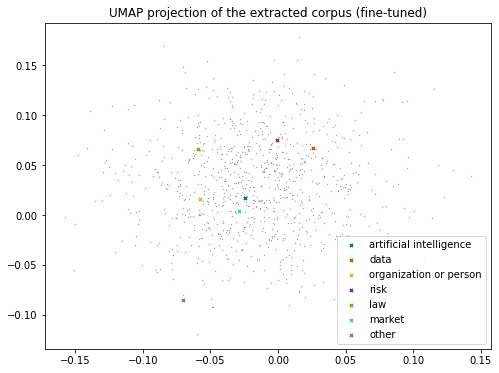

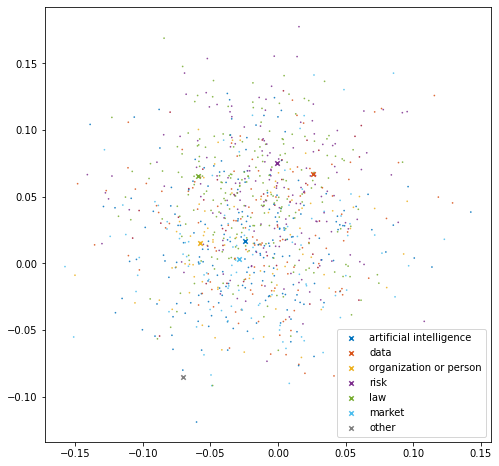

cluster size :
|-artificial intelligence : 197
|-data : 125
|-organization or person : 82
|-risk : 167
|-law : 223
|-market : 104
|-other : 38
  |-unlabeled terms within 'other': 0


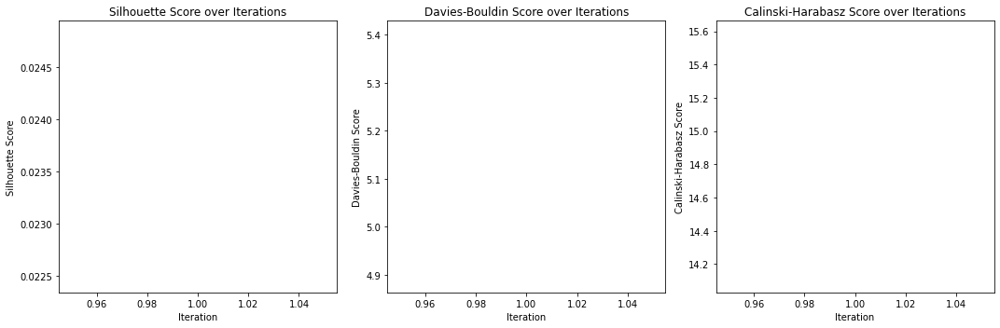

Silhouette : 0.02364317
Davies Bouldin : 5.146195929094568
Calinski Harabasz : 14.846389634853377


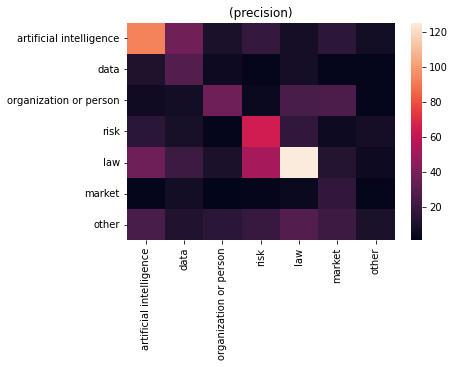

size of predicted terms: 900
Accuracy : 0.41444444444444445
Precision : 0.4414539130924681
Recall : 0.41444444444444445
f1 : 0.41011326530123116
                            Term              Prediction  \
0            administrative task  organization or person   
1             particular account                  market   
2        common procedure (other                   other   
3                     safe space                    risk   
4  council of the european union  organization or person   

             Ground truth  
0                   other  
1                   other  
2                     law  
3                     law  
4  organization or person  


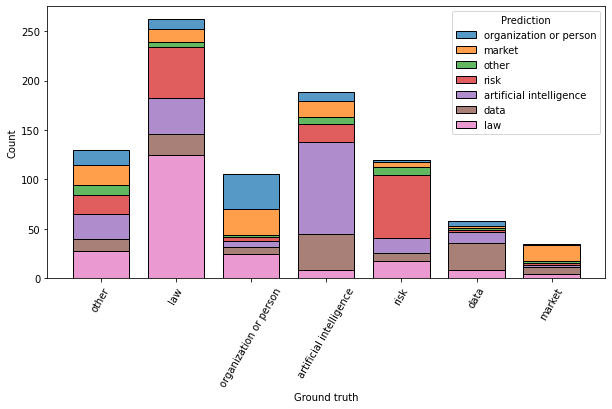


Summary:
   Accuracy  Precision    Recall        F1  Silhouette  Davies Bouldin  \
1  0.414444   0.441454  0.414444  0.410113    0.023643        5.146196   

   Calinski Harabasz  
1           14.84639  


In [15]:
_ = run_and_store_results(min_points=4,dimensions=10,clusterer="cosine",reducer="none")  

## 10. Anything{CC}

1 iterations:
['anythingartificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anythingdata', 'personal data', 'anonymous data', 'anythingorganization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anythingrisk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anythinglaw', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anythingmarket', 'product', 'service', 'other']
['anythingartificial intelligence', 'anythingdata', 'anythingorganization or person', 'anythingrisk', 'anythinglaw', 'anythingmarket', 'other']
unique terms:  900
cannot links:21
must links:30
0.05280185


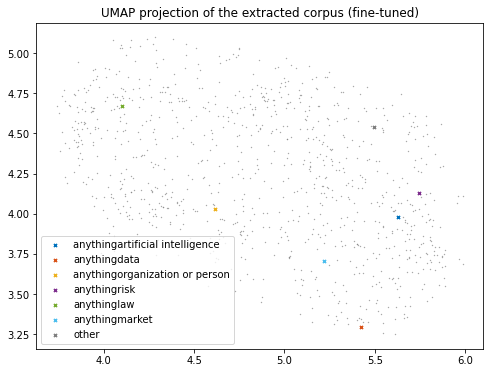

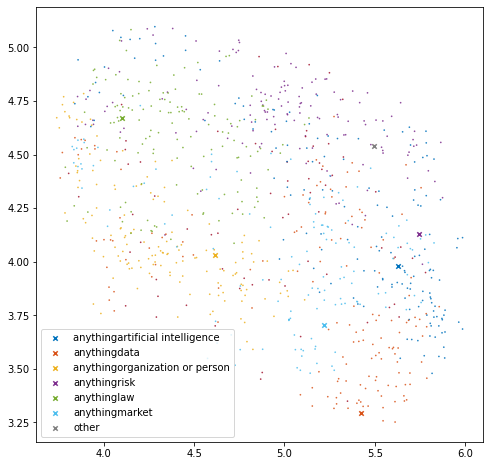

cluster size :
|-anythingartificial intelligence : 160
|-anythingdata : 156
|-anythingorganization or person : 144
|-anythingrisk : 138
|-anythinglaw : 138
|-anythingmarket : 129
|-other : 71
  |-unlabeled terms within 'other': 0


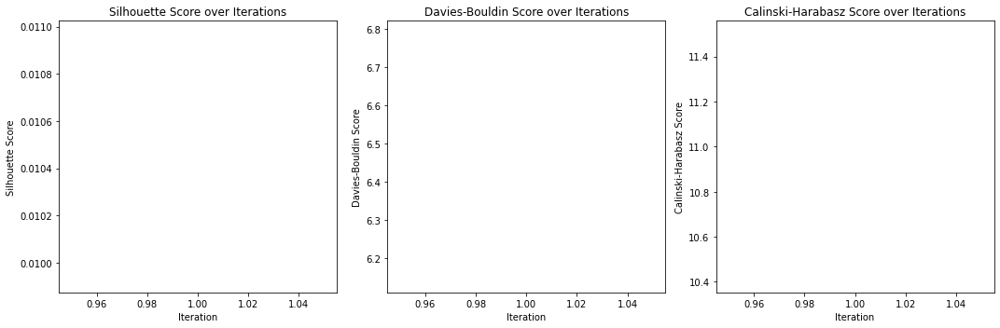

Silhouette : 0.010449609
Davies Bouldin : 6.466019880691085
Calinski Harabasz : 10.955692886391871


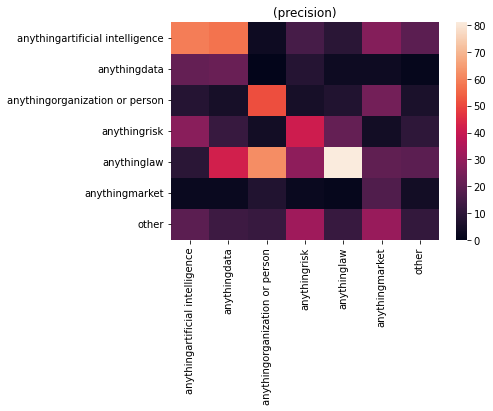

size of predicted terms: 900
Accuracy : 0.31333333333333335
Precision : 0.38267258132514137
Recall : 0.31333333333333335
f1 : 0.32302141653375255
                Term                      Prediction  \
0            europol  anythingorganization or person   
1  uniform condition                     anythinglaw   
2    legislative act  anythingorganization or person   
3        distributor                  anythingmarket   
4    aviation safety  anythingorganization or person   

                      Ground truth  
0   anythingorganization or person  
1                      anythinglaw  
2                      anythinglaw  
3   anythingorganization or person  
4  anythingartificial intelligence  


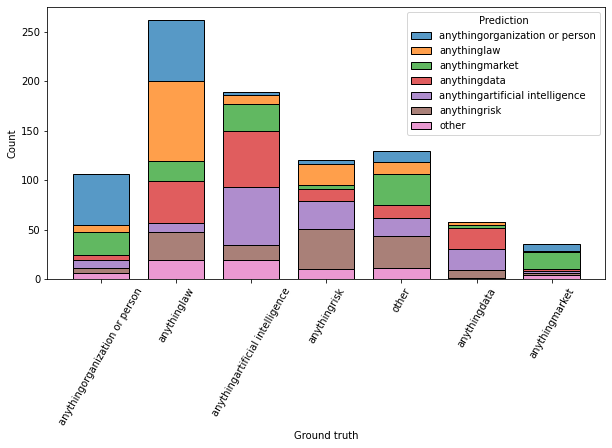

2 iterations:
['anythingartificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anythingdata', 'personal data', 'anonymous data', 'anythingorganization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anythingrisk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anythinglaw', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anythingmarket', 'product', 'service', 'other']
['anythingartificial intelligence', 'anythingdata', 'anythingorganization or person', 'anythingrisk', 'anythinglaw', 'anythingmarket', 'other']
unique terms:  900
cannot links:21
must links:30
-0.04358558


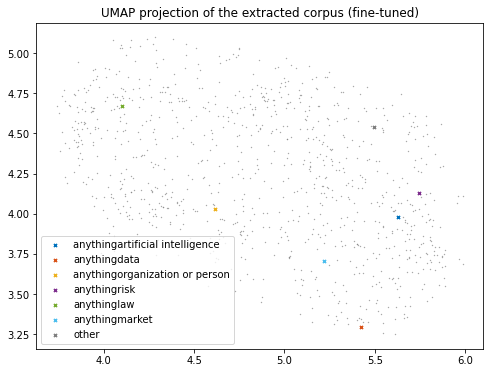

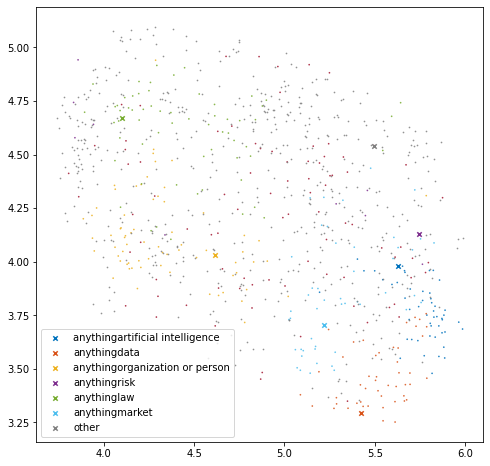

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 70
|-anythingrisk : 10
|-anythinglaw : 63
|-anythingmarket : 49
|-other : 644
  |-unlabeled terms within 'other': 557
0.104904756


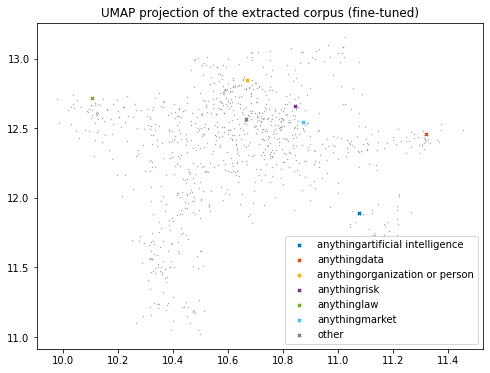

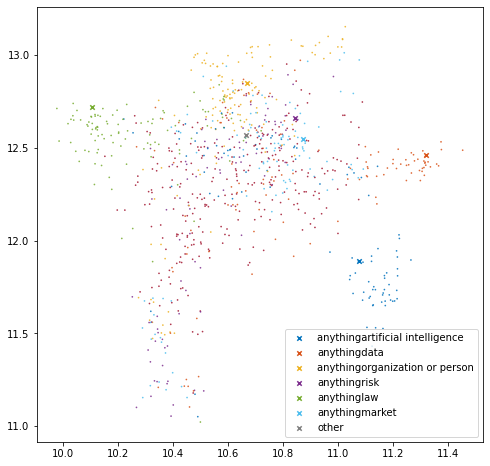

cluster size :
|-anythingartificial intelligence : 101
|-anythingdata : 117
|-anythingorganization or person : 140
|-anythingrisk : 90
|-anythinglaw : 106
|-anythingmarket : 103
|-other : 279
  |-unlabeled terms within 'other': 0


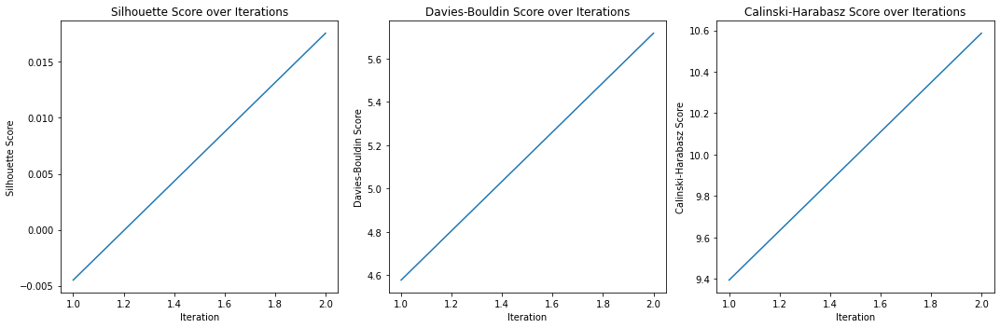

Silhouette : 0.017553583
Davies Bouldin : 5.717556618696161
Calinski Harabasz : 10.585946070045175


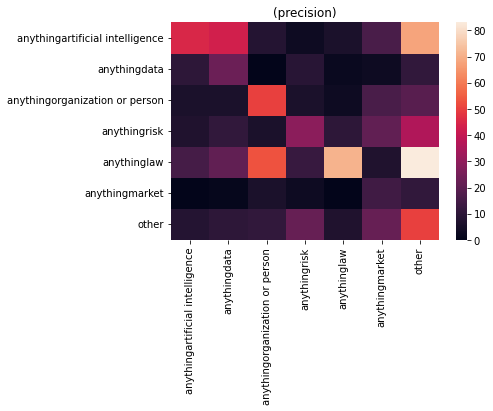

size of predicted terms: 900
Accuracy : 0.31333333333333335
Precision : 0.4469690316762152
Recall : 0.31333333333333335
f1 : 0.3296562541360241
                Term                      Prediction  \
0            europol  anythingorganization or person   
1  uniform condition                     anythinglaw   
2    legislative act  anythingorganization or person   
3        distributor                  anythingmarket   
4    aviation safety  anythingorganization or person   

                      Ground truth  
0   anythingorganization or person  
1                      anythinglaw  
2                      anythinglaw  
3   anythingorganization or person  
4  anythingartificial intelligence  


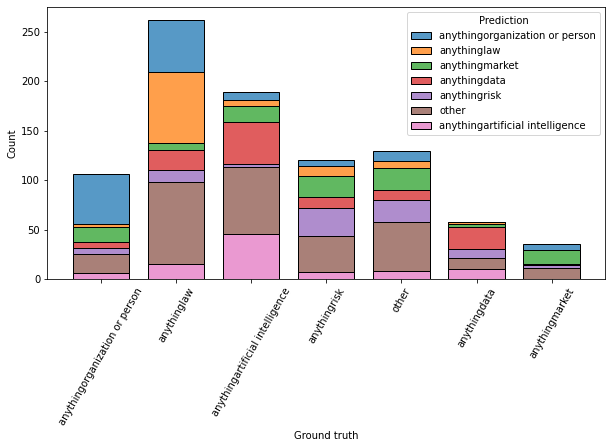

5 iterations:
['anythingartificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anythingdata', 'personal data', 'anonymous data', 'anythingorganization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anythingrisk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anythinglaw', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anythingmarket', 'product', 'service', 'other']
['anythingartificial intelligence', 'anythingdata', 'anythingorganization or person', 'anythingrisk', 'anythinglaw', 'anythingmarket', 'other']
unique terms:  900
cannot links:21
must links:30
-0.04358558


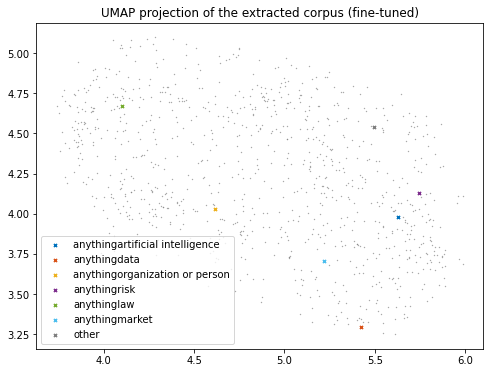

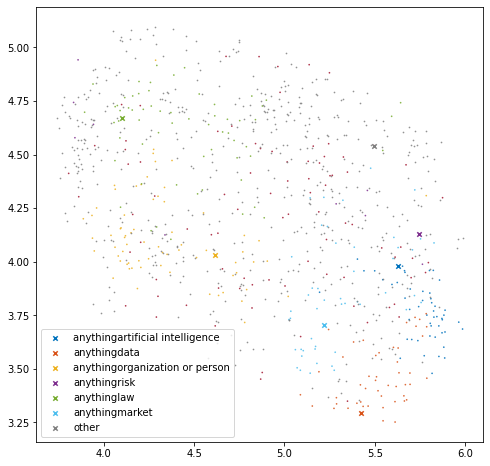

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 70
|-anythingrisk : 10
|-anythinglaw : 63
|-anythingmarket : 49
|-other : 644
  |-unlabeled terms within 'other': 557
0.1107848


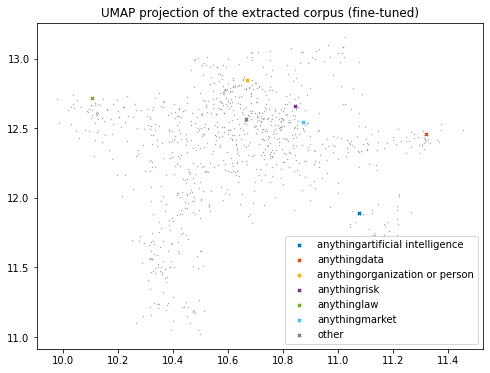

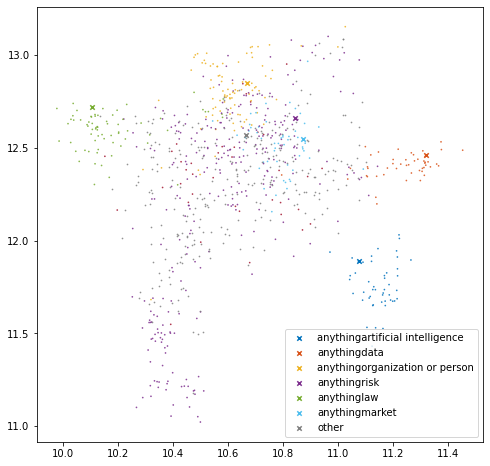

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 290
|-anythinglaw : 70
|-anythingmarket : 54
|-other : 329
  |-unlabeled terms within 'other': 291
0.16523863


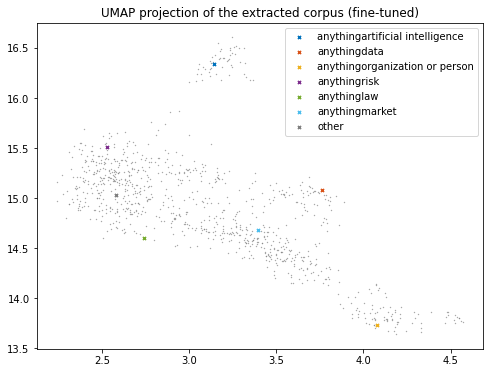

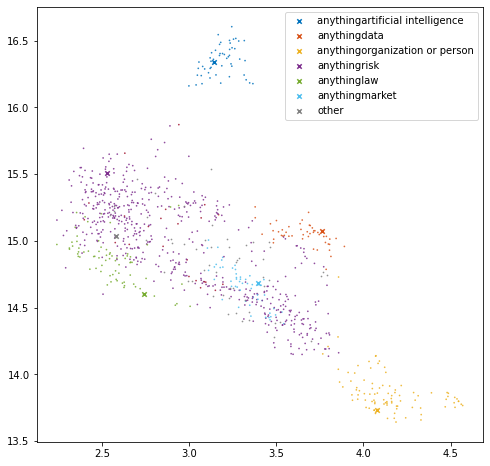

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 539
|-anythinglaw : 74
|-anythingmarket : 54
|-other : 76
  |-unlabeled terms within 'other': 53
0.37444425


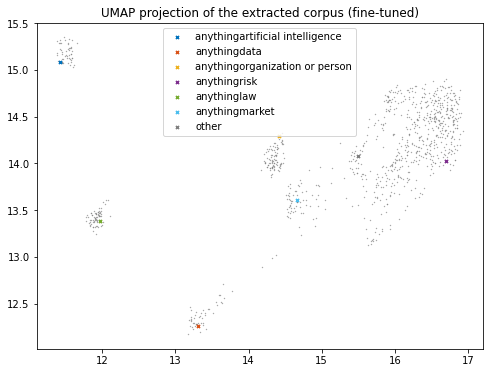

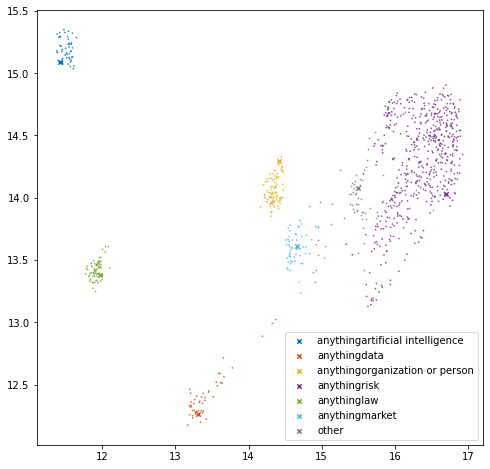

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 539
|-anythinglaw : 74
|-anythingmarket : 57
|-other : 73
  |-unlabeled terms within 'other': 70
0.32099575


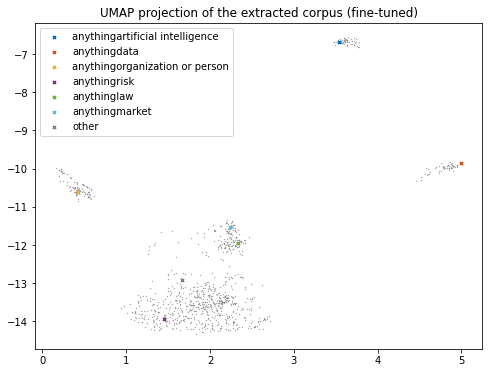

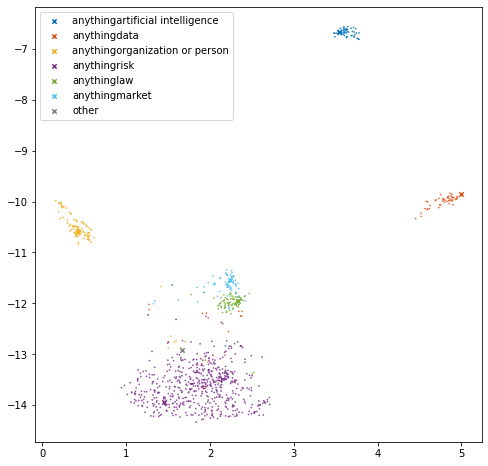

cluster size :
|-anythingartificial intelligence : 54
|-anythingdata : 60
|-anythingorganization or person : 101
|-anythingrisk : 565
|-anythinglaw : 80
|-anythingmarket : 63
|-other : 13
  |-unlabeled terms within 'other': 0


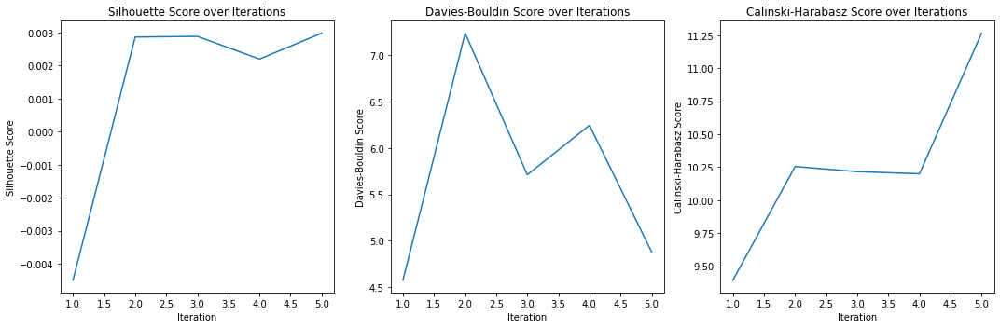

Silhouette : 0.00297753
Davies Bouldin : 4.881022565862822
Calinski Harabasz : 11.26501145971623


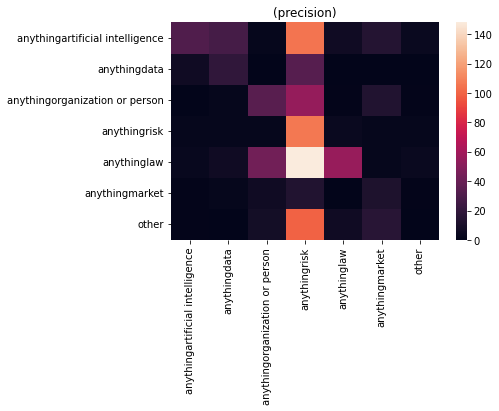

size of predicted terms: 900
Accuracy : 0.2866666666666667
Precision : 0.46772866439013244
Recall : 0.2866666666666667
f1 : 0.26572178345373415
                Term                      Prediction  \
0            europol                    anythingrisk   
1  uniform condition                     anythinglaw   
2    legislative act  anythingorganization or person   
3        distributor                  anythingmarket   
4    aviation safety                    anythingrisk   

                      Ground truth  
0   anythingorganization or person  
1                      anythinglaw  
2                      anythinglaw  
3   anythingorganization or person  
4  anythingartificial intelligence  


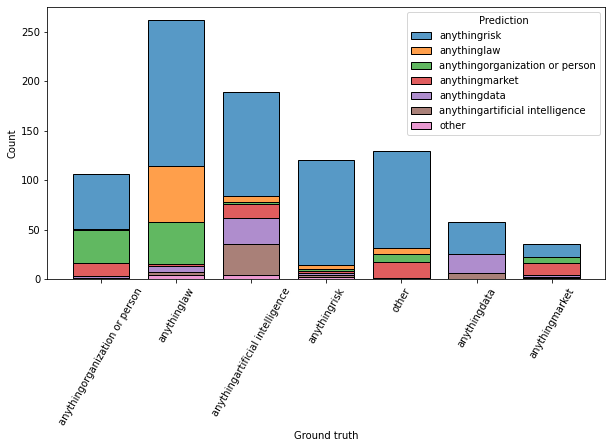

10 iterations:
['anythingartificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anythingdata', 'personal data', 'anonymous data', 'anythingorganization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anythingrisk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anythinglaw', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anythingmarket', 'product', 'service', 'other']
['anythingartificial intelligence', 'anythingdata', 'anythingorganization or person', 'anythingrisk', 'anythinglaw', 'anythingmarket', 'other']
unique terms:  900
cannot links:21
must links:30
-0.04358558


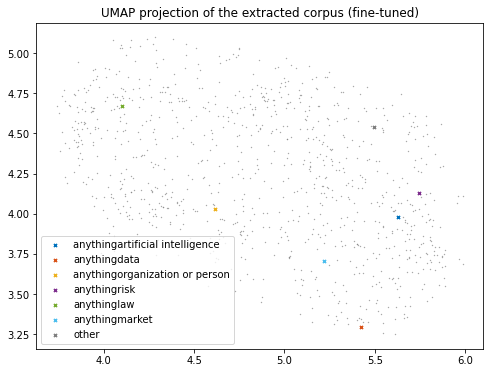

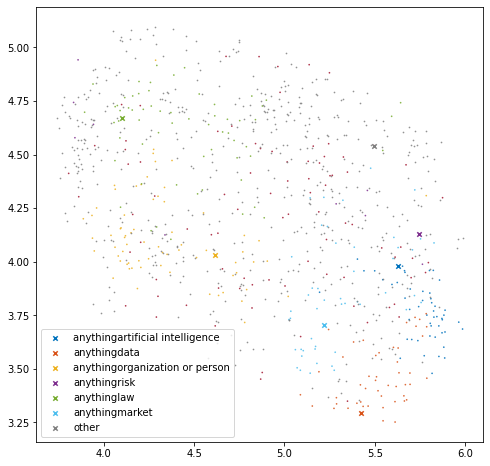

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 70
|-anythingrisk : 10
|-anythinglaw : 63
|-anythingmarket : 49
|-other : 644
  |-unlabeled terms within 'other': 557
0.1107848


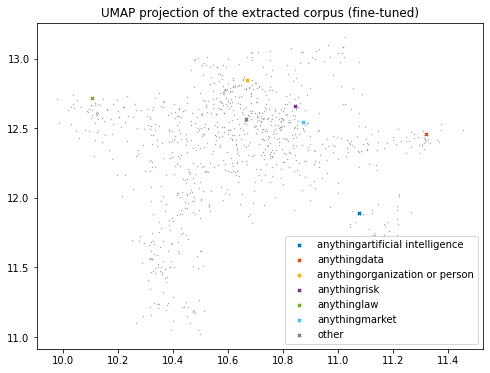

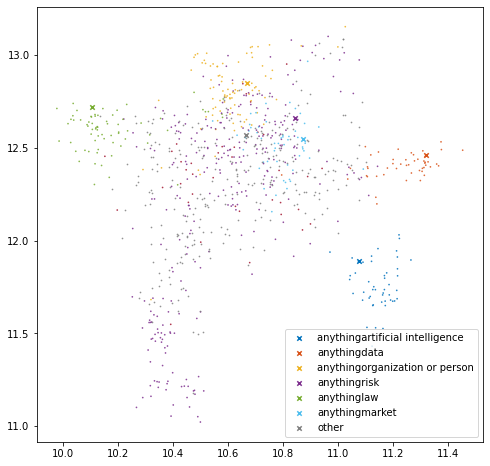

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 290
|-anythinglaw : 70
|-anythingmarket : 54
|-other : 329
  |-unlabeled terms within 'other': 291
0.16523863


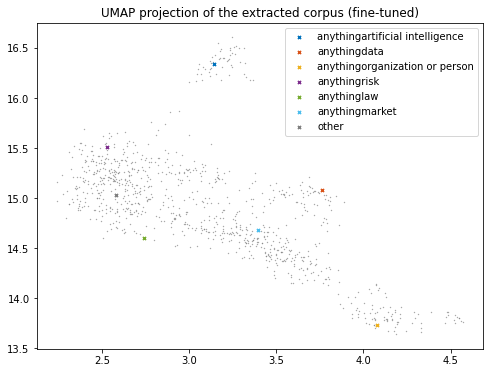

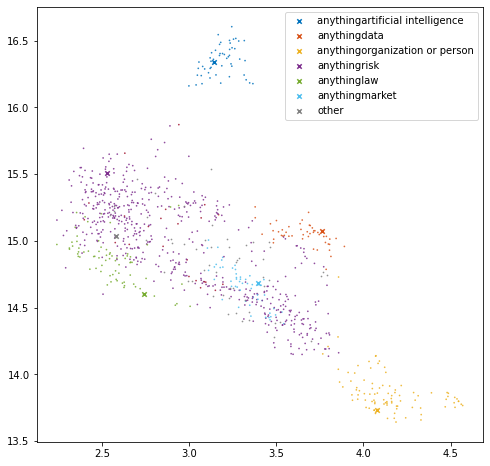

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 539
|-anythinglaw : 74
|-anythingmarket : 54
|-other : 76
  |-unlabeled terms within 'other': 53
0.37444425


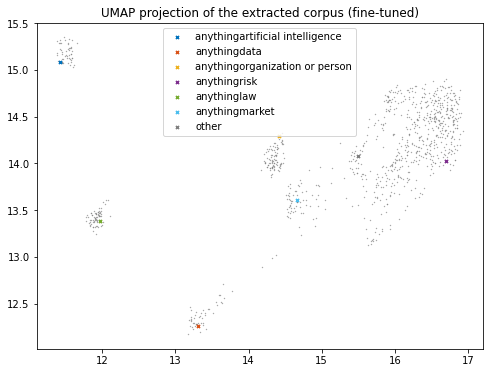

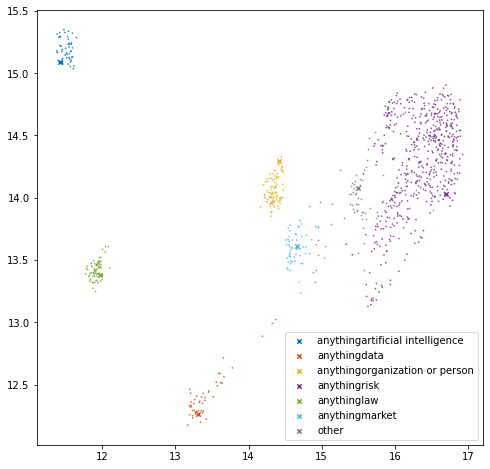

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 539
|-anythinglaw : 74
|-anythingmarket : 57
|-other : 73
  |-unlabeled terms within 'other': 70
0.35779682


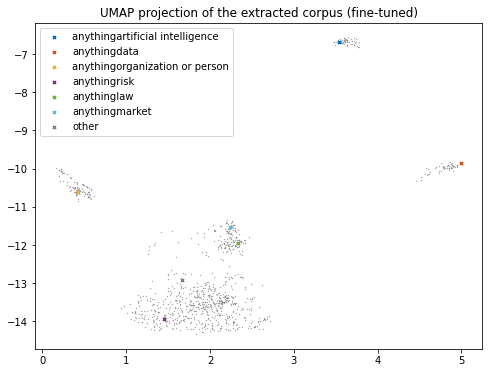

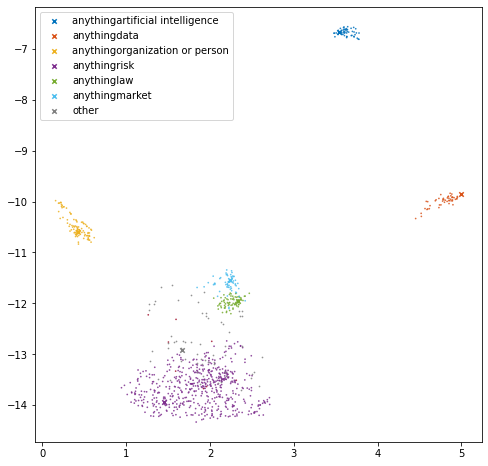

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 539
|-anythinglaw : 74
|-anythingmarket : 59
|-other : 71
  |-unlabeled terms within 'other': 62
0.38730595


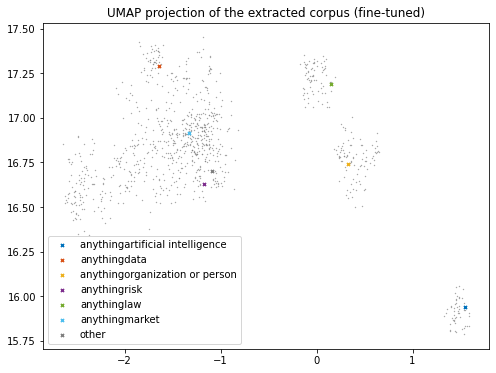

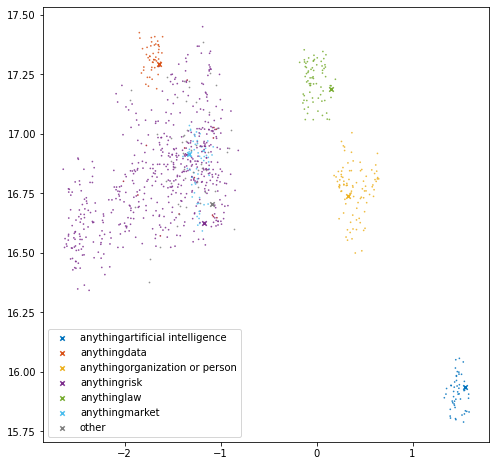

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 539
|-anythinglaw : 74
|-anythingmarket : 61
|-other : 69
  |-unlabeled terms within 'other': 54
0.3620297


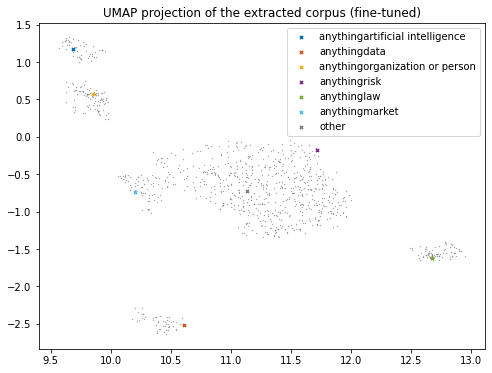

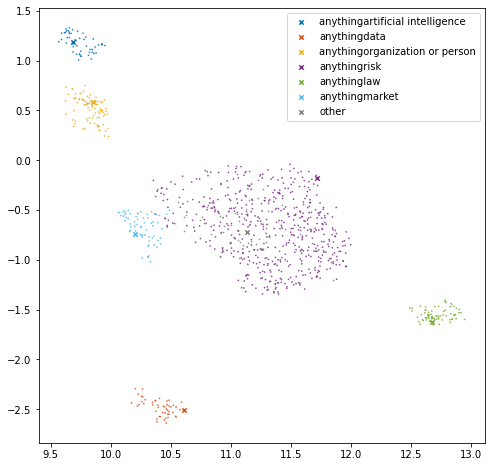

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 542
|-anythinglaw : 74
|-anythingmarket : 65
|-other : 62
  |-unlabeled terms within 'other': 59
0.39145473


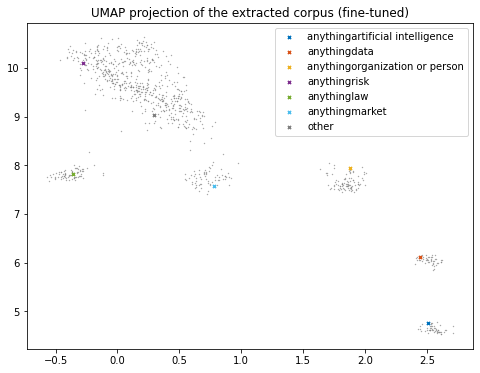

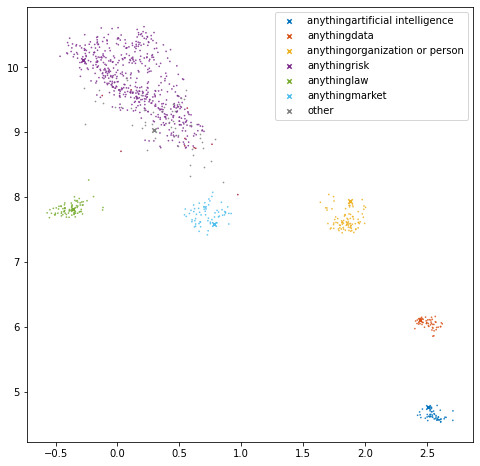

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 542
|-anythinglaw : 75
|-anythingmarket : 65
|-other : 61
  |-unlabeled terms within 'other': 50
0.37294373


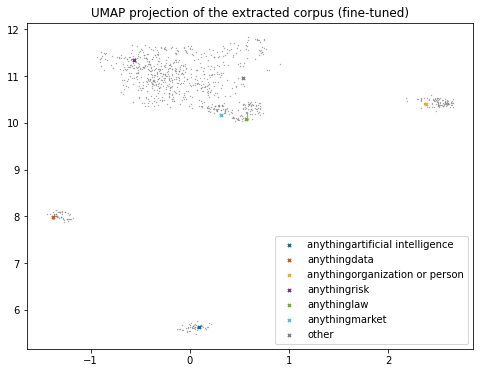

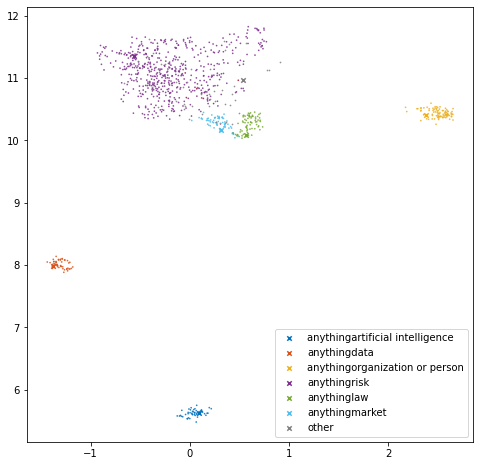

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 542
|-anythinglaw : 75
|-anythingmarket : 65
|-other : 61
  |-unlabeled terms within 'other': 51
0.4290757


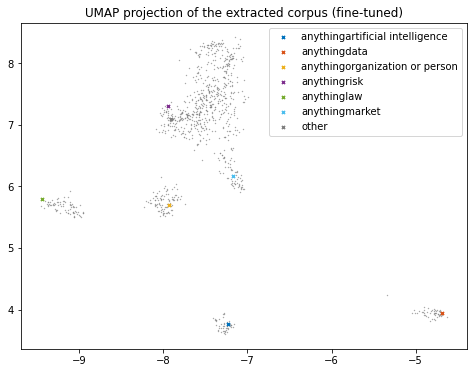

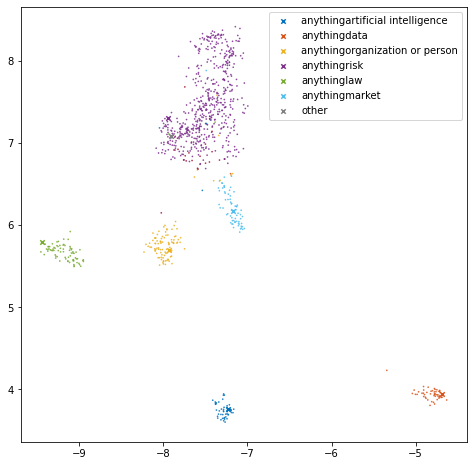

cluster size :
|-anythingartificial intelligence : 54
|-anythingdata : 52
|-anythingorganization or person : 101
|-anythingrisk : 559
|-anythinglaw : 78
|-anythingmarket : 68
|-other : 24
  |-unlabeled terms within 'other': 0


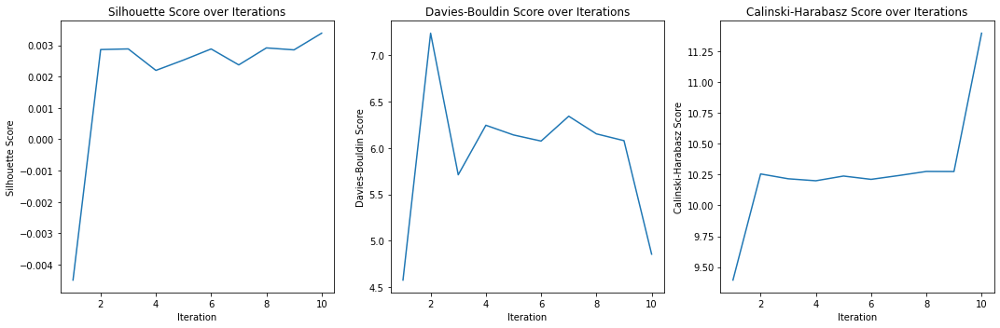

Silhouette : 0.0033826292
Davies Bouldin : 4.856541195410251
Calinski Harabasz : 11.396312049570039


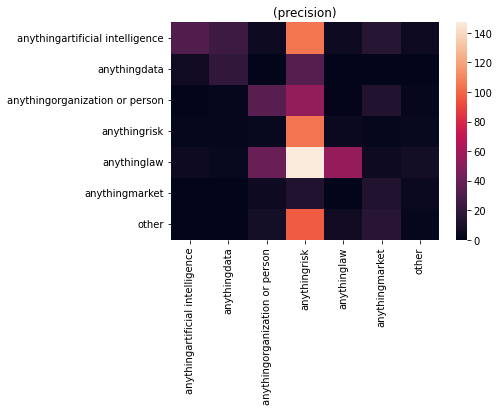

size of predicted terms: 900
Accuracy : 0.2866666666666667
Precision : 0.48563912694912753
Recall : 0.2866666666666667
f1 : 0.2697608612547413
                Term                      Prediction  \
0            europol                    anythingrisk   
1  uniform condition                     anythinglaw   
2    legislative act  anythingorganization or person   
3        distributor                  anythingmarket   
4    aviation safety                    anythingrisk   

                      Ground truth  
0   anythingorganization or person  
1                      anythinglaw  
2                      anythinglaw  
3   anythingorganization or person  
4  anythingartificial intelligence  


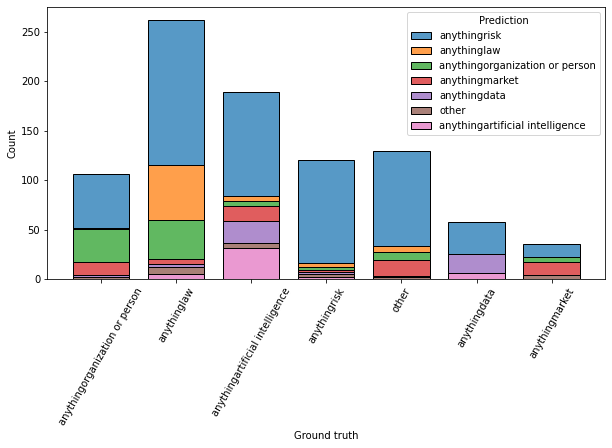

15 iterations:
['anythingartificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anythingdata', 'personal data', 'anonymous data', 'anythingorganization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anythingrisk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anythinglaw', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anythingmarket', 'product', 'service', 'other']
['anythingartificial intelligence', 'anythingdata', 'anythingorganization or person', 'anythingrisk', 'anythinglaw', 'anythingmarket', 'other']
unique terms:  900
cannot links:21
must links:30
-0.04358558


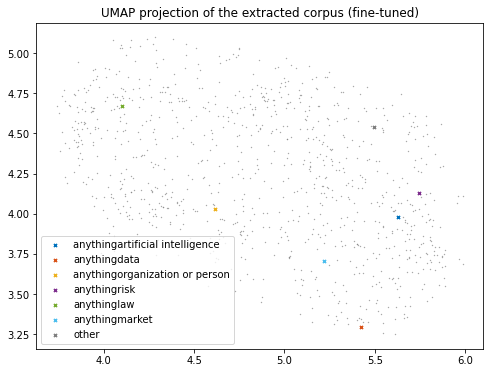

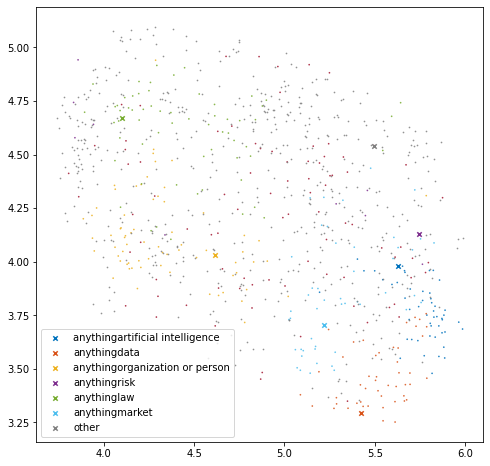

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 70
|-anythingrisk : 10
|-anythinglaw : 63
|-anythingmarket : 49
|-other : 644
  |-unlabeled terms within 'other': 557
0.1107848


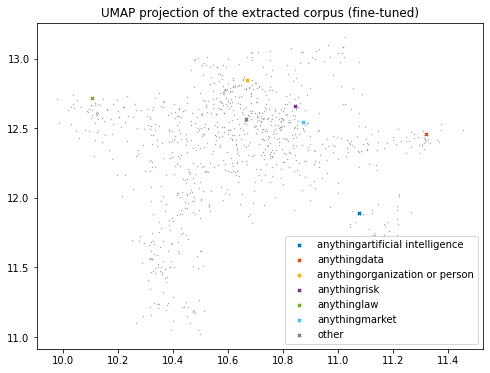

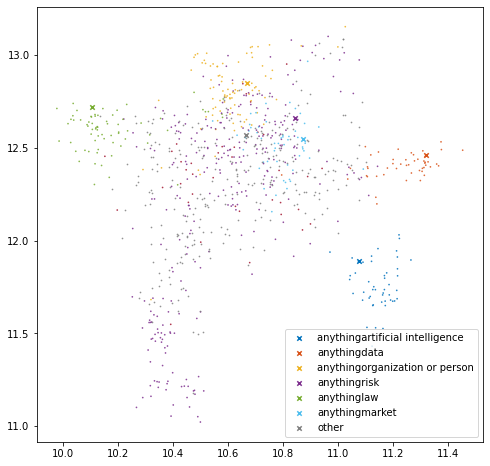

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 290
|-anythinglaw : 70
|-anythingmarket : 54
|-other : 329
  |-unlabeled terms within 'other': 291
0.16523863


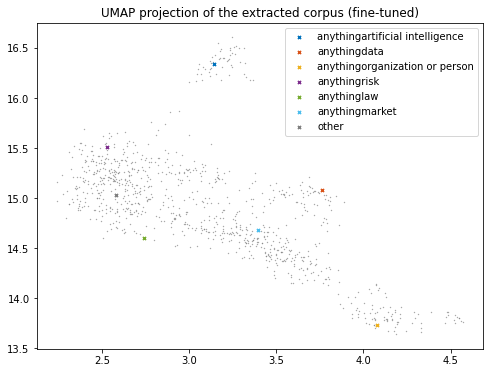

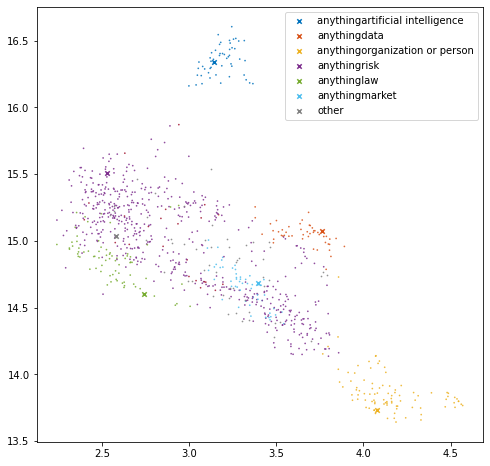

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 539
|-anythinglaw : 74
|-anythingmarket : 54
|-other : 76
  |-unlabeled terms within 'other': 53
0.37444425


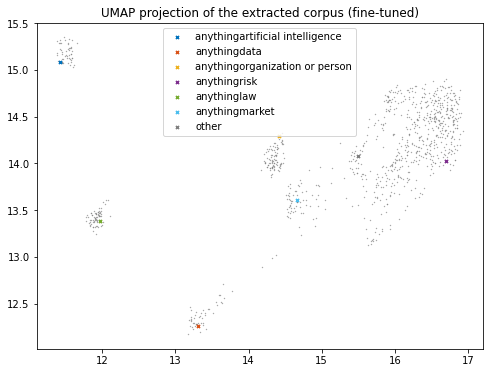

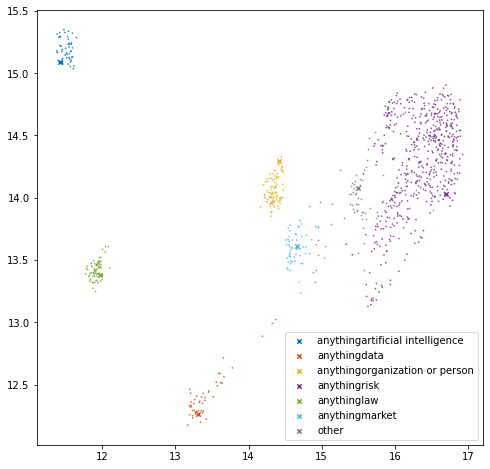

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 539
|-anythinglaw : 74
|-anythingmarket : 57
|-other : 73
  |-unlabeled terms within 'other': 70
0.35779682


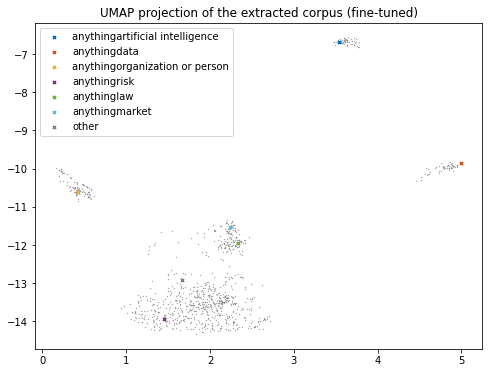

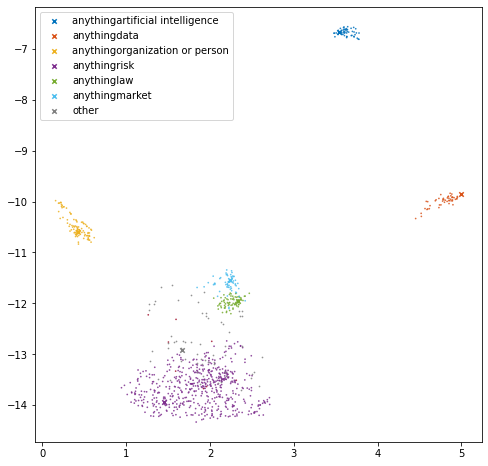

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 539
|-anythinglaw : 74
|-anythingmarket : 59
|-other : 71
  |-unlabeled terms within 'other': 62
0.38730595


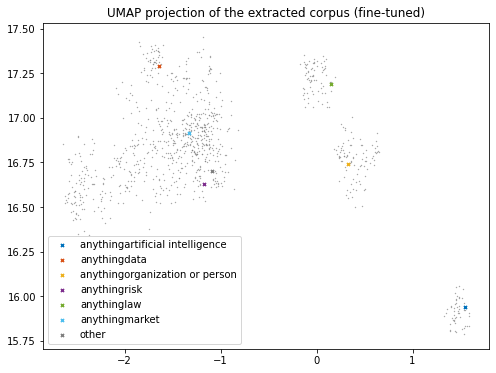

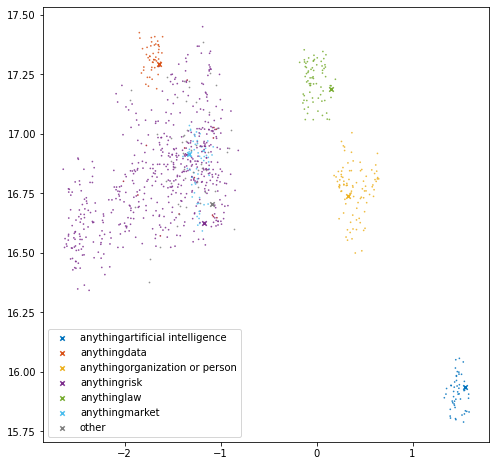

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 539
|-anythinglaw : 74
|-anythingmarket : 61
|-other : 69
  |-unlabeled terms within 'other': 54
0.3620297


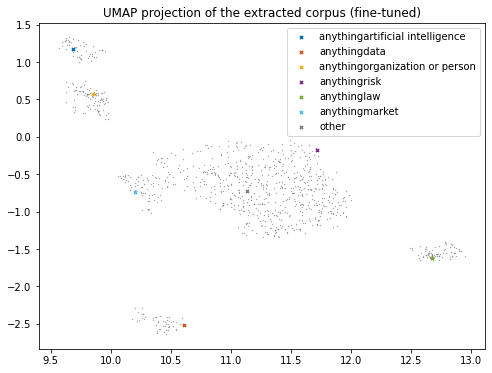

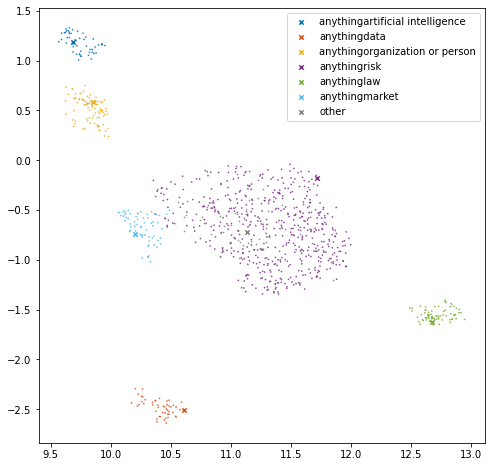

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 542
|-anythinglaw : 74
|-anythingmarket : 65
|-other : 62
  |-unlabeled terms within 'other': 59
0.39145473


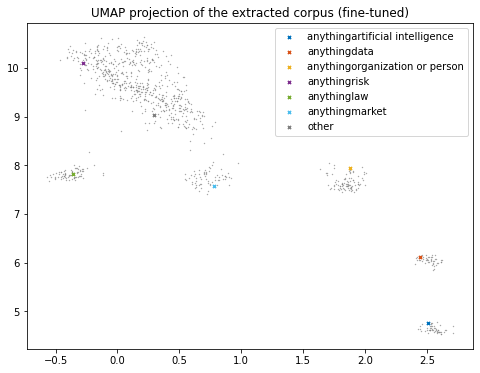

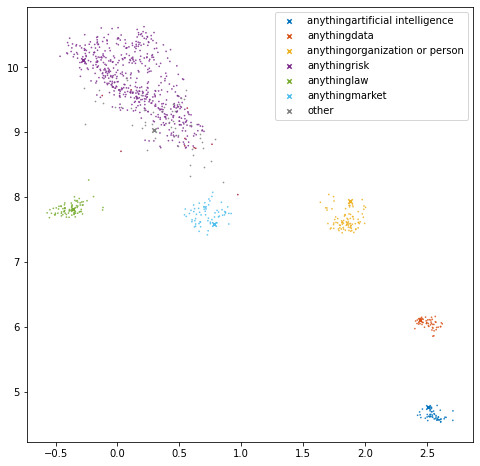

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 542
|-anythinglaw : 75
|-anythingmarket : 65
|-other : 61
  |-unlabeled terms within 'other': 50
0.37294373


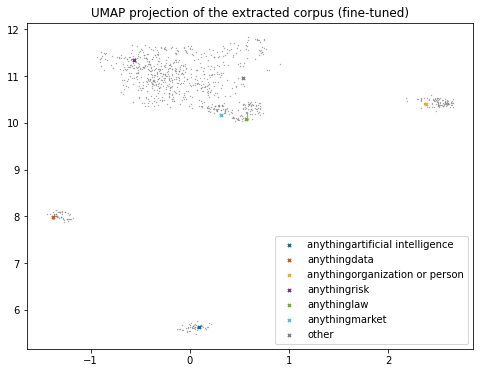

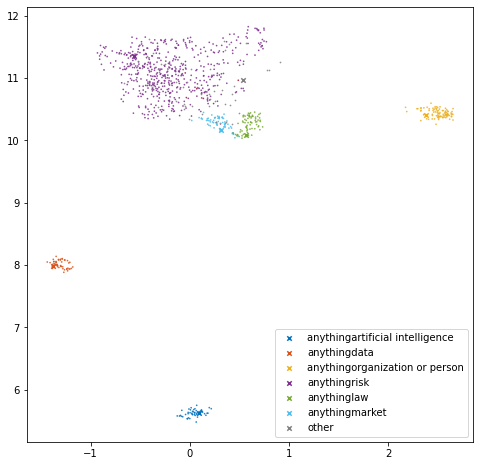

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 49
|-anythingorganization or person : 93
|-anythingrisk : 542
|-anythinglaw : 75
|-anythingmarket : 65
|-other : 61
  |-unlabeled terms within 'other': 51
0.43156597


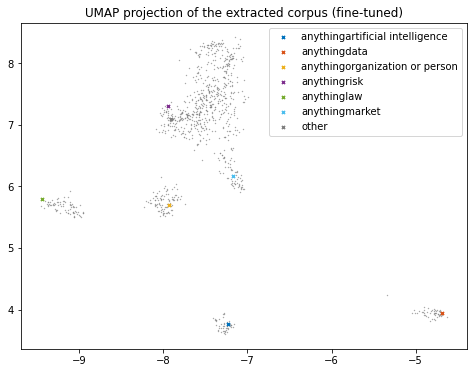

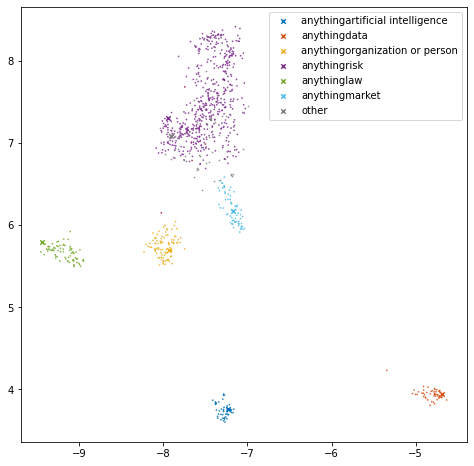

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 50
|-anythingorganization or person : 93
|-anythingrisk : 544
|-anythinglaw : 75
|-anythingmarket : 65
|-other : 58
  |-unlabeled terms within 'other': 52
0.39630705


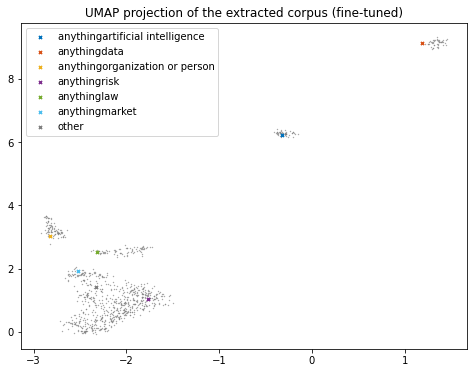

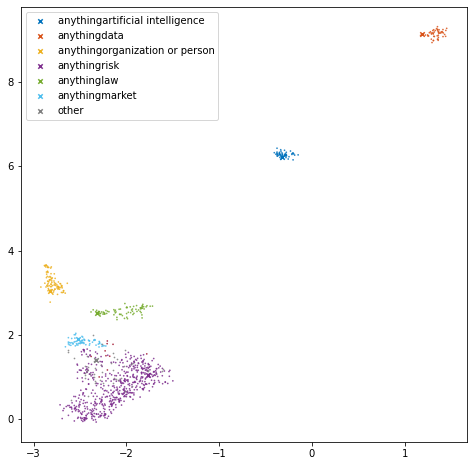

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 50
|-anythingorganization or person : 93
|-anythingrisk : 544
|-anythinglaw : 75
|-anythingmarket : 65
|-other : 58
  |-unlabeled terms within 'other': 47
0.4207806


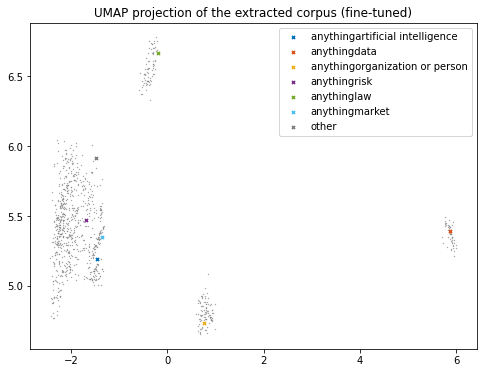

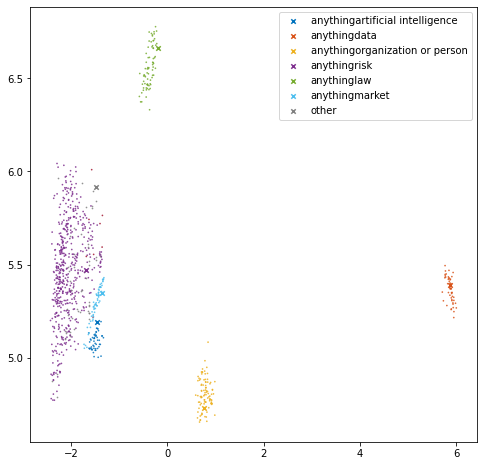

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 50
|-anythingorganization or person : 93
|-anythingrisk : 544
|-anythinglaw : 75
|-anythingmarket : 65
|-other : 58
  |-unlabeled terms within 'other': 49
0.3950389


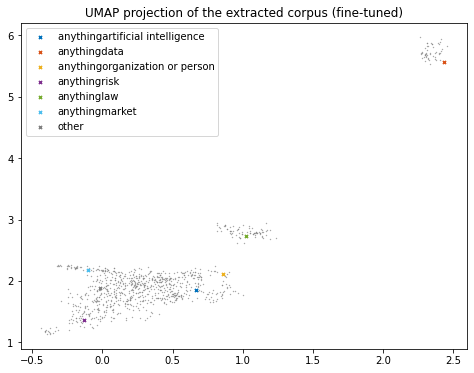

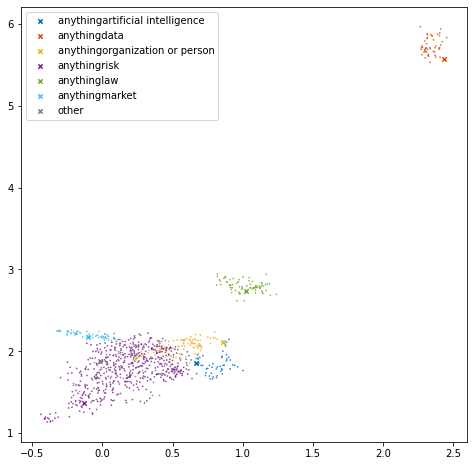

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 50
|-anythingorganization or person : 93
|-anythingrisk : 544
|-anythinglaw : 75
|-anythingmarket : 65
|-other : 58
  |-unlabeled terms within 'other': 51
0.39999056


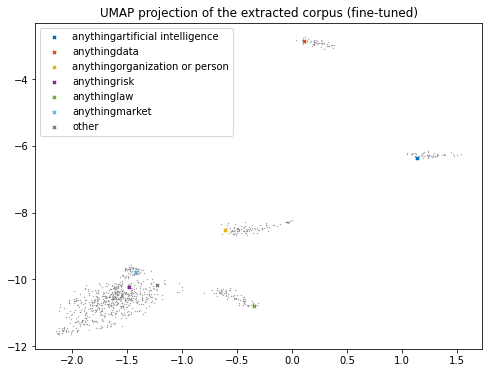

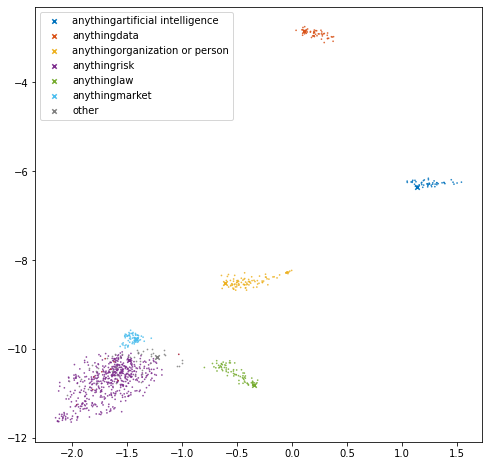

cluster size :
|-anythingartificial intelligence : 51
|-anythingdata : 50
|-anythingorganization or person : 93
|-anythingrisk : 544
|-anythinglaw : 75
|-anythingmarket : 66
|-other : 57
  |-unlabeled terms within 'other': 47
0.36901224


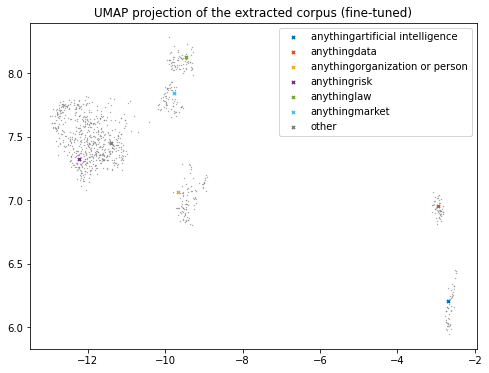

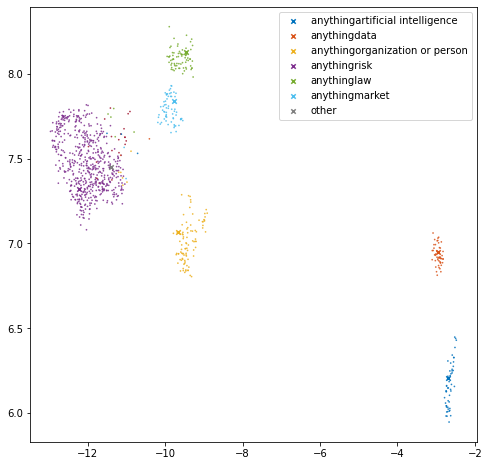

cluster size :
|-anythingartificial intelligence : 54
|-anythingdata : 52
|-anythingorganization or person : 99
|-anythingrisk : 563
|-anythinglaw : 80
|-anythingmarket : 68
|-other : 20
  |-unlabeled terms within 'other': 0


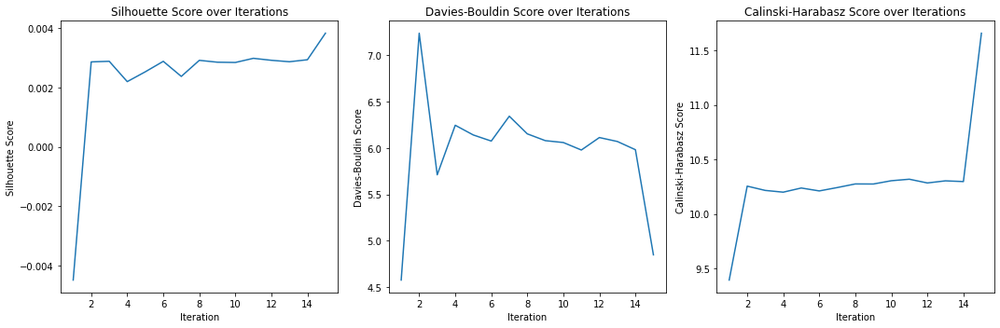

Silhouette : 0.0038279446
Davies Bouldin : 4.8491024927668605
Calinski Harabasz : 11.65629065372377


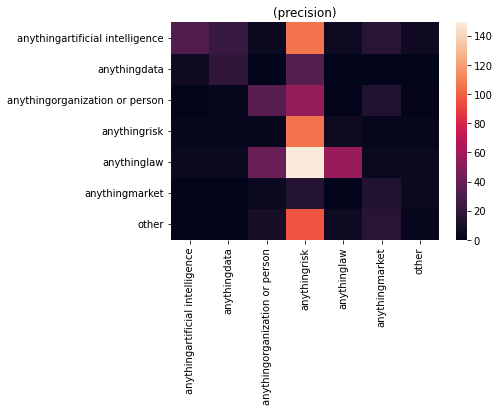

size of predicted terms: 900
Accuracy : 0.29
Precision : 0.4910465466582369
Recall : 0.29
f1 : 0.27331495810855366
                Term                      Prediction  \
0            europol                    anythingrisk   
1  uniform condition                     anythinglaw   
2    legislative act  anythingorganization or person   
3        distributor                  anythingmarket   
4    aviation safety                    anythingrisk   

                      Ground truth  
0   anythingorganization or person  
1                      anythinglaw  
2                      anythinglaw  
3   anythingorganization or person  
4  anythingartificial intelligence  


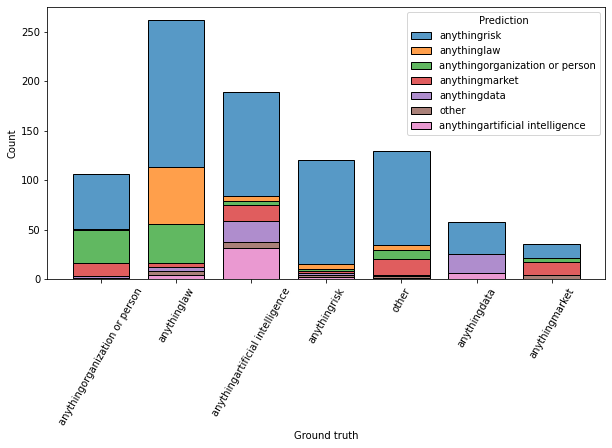


Summary:
    Accuracy  Precision    Recall        F1  Silhouette  Davies Bouldin  \
1   0.313333   0.382673  0.313333  0.323021    0.010450        6.466020   
2   0.313333   0.446969  0.313333  0.329656    0.017554        5.717557   
5   0.286667   0.467729  0.286667  0.265722    0.002978        4.881023   
10  0.286667   0.485639  0.286667  0.269761    0.003383        4.856541   
15  0.290000   0.491047  0.290000  0.273315    0.003828        4.849102   

    Calinski Harabasz  
1           10.955693  
2           10.585946  
5           11.265011  
10          11.396312  
15          11.656291  


In [16]:
_ = run_and_store_results(min_points=4,dimensions=10,prefix="Anything")  

## 11. Anything {CC}

1 iterations:
['anything artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anything data', 'personal data', 'anonymous data', 'anything organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anything risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anything law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anything market', 'product', 'service', 'other']
['anything artificial intelligence', 'anything data', 'anything organization or person', 'anything risk', 'anything law', 'anything market', 'other']
unique terms:  900
cannot links:21
must links:30
0.09671726


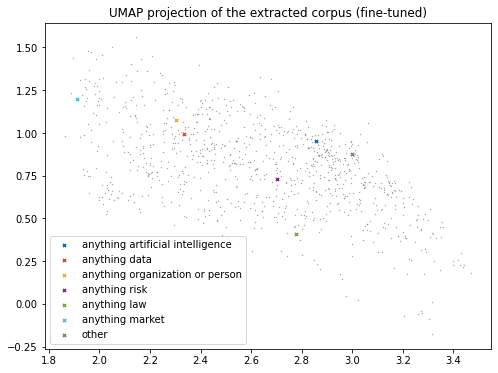

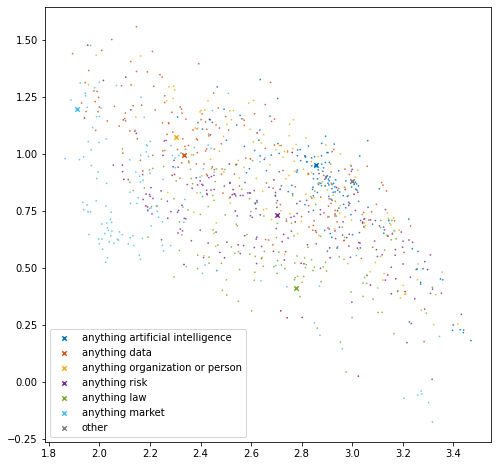

cluster size :
|-anything artificial intelligence : 151
|-anything data : 161
|-anything organization or person : 128
|-anything risk : 173
|-anything law : 141
|-anything market : 136
|-other : 46
  |-unlabeled terms within 'other': 0


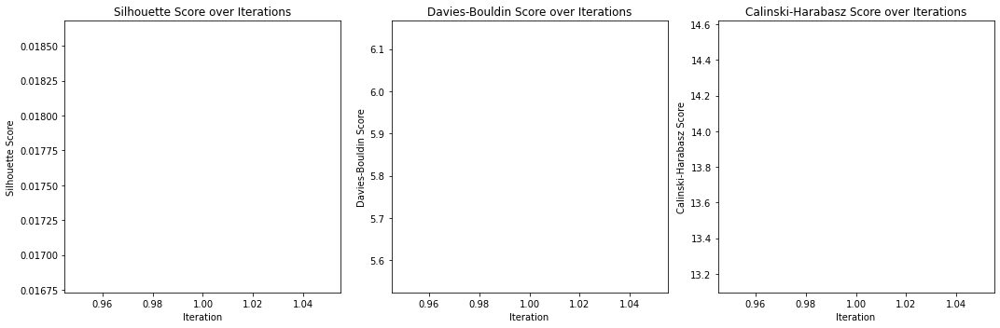

Silhouette : 0.017705018
Davies Bouldin : 5.845234913646422
Calinski Harabasz : 13.857337964969066


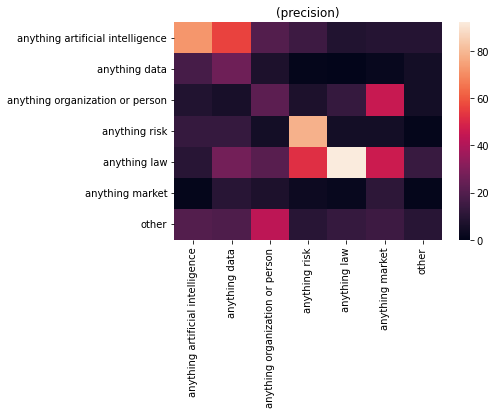

size of predicted terms: 900
Accuracy : 0.34555555555555556
Precision : 0.43797109382856597
Recall : 0.34555555555555556
f1 : 0.3595907796724694
                Term       Prediction                      Ground truth
0            europol  anything market   anything organization or person
1  uniform condition    anything risk                      anything law
2    legislative act     anything law                      anything law
3        distributor  anything market   anything organization or person
4    aviation safety    anything risk  anything artificial intelligence


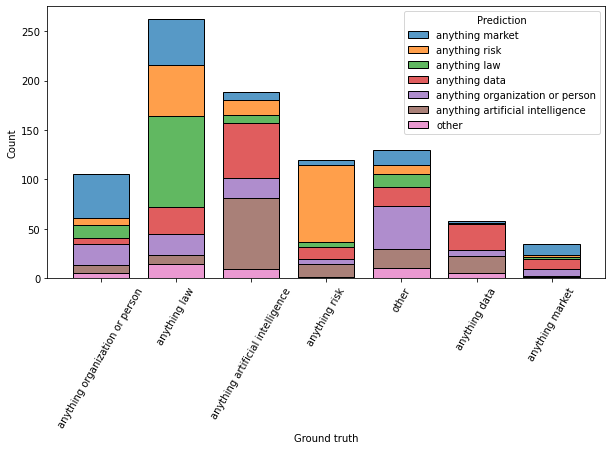

2 iterations:
['anything artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anything data', 'personal data', 'anonymous data', 'anything organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anything risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anything law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anything market', 'product', 'service', 'other']
['anything artificial intelligence', 'anything data', 'anything organization or person', 'anything risk', 'anything law', 'anything market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.004827087


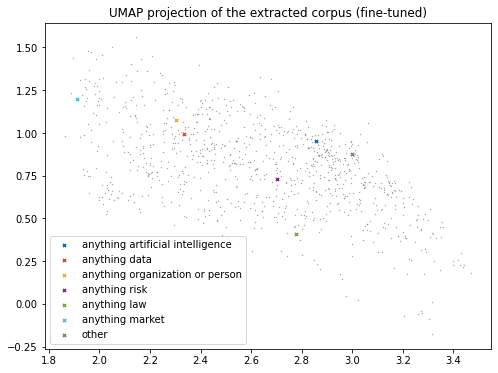

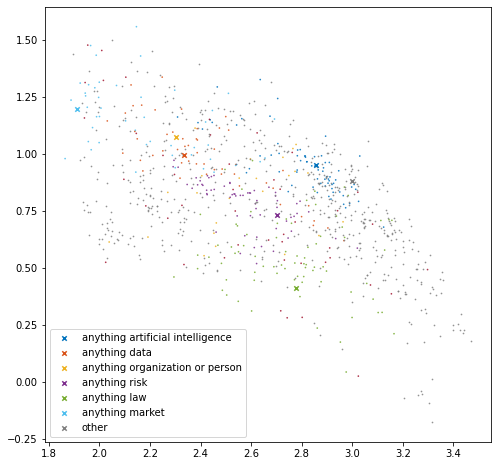

cluster size :
|-anything artificial intelligence : 73
|-anything data : 52
|-anything organization or person : 25
|-anything risk : 65
|-anything law : 78
|-anything market : 48
|-other : 595
  |-unlabeled terms within 'other': 549
0.14382172


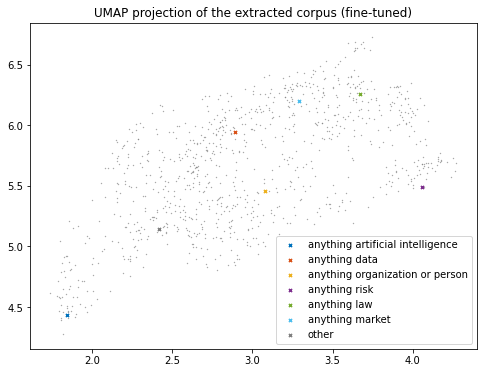

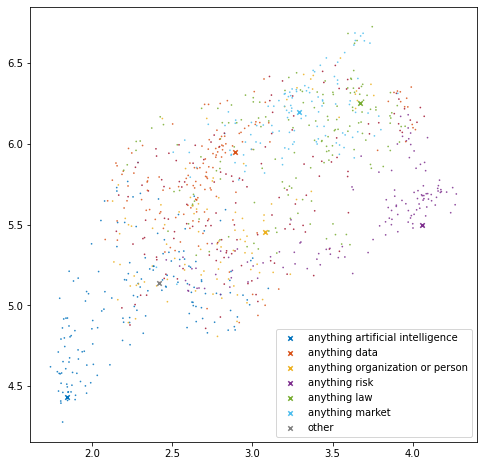

cluster size :
|-anything artificial intelligence : 164
|-anything data : 139
|-anything organization or person : 97
|-anything risk : 127
|-anything law : 153
|-anything market : 115
|-other : 141
  |-unlabeled terms within 'other': 0


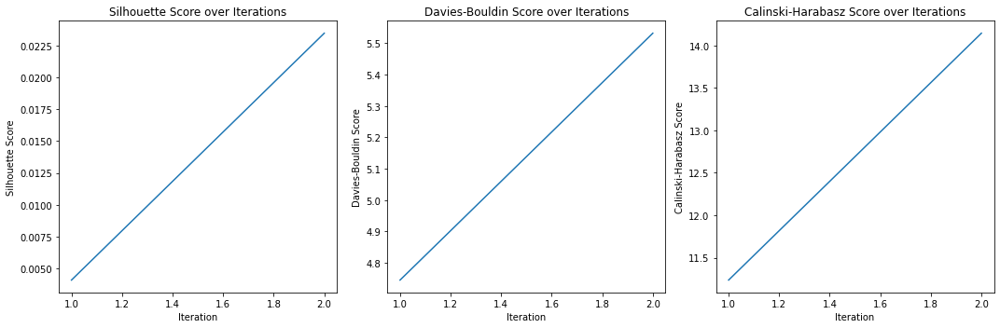

Silhouette : 0.0234719
Davies Bouldin : 5.531989505548918
Calinski Harabasz : 14.145230206416942


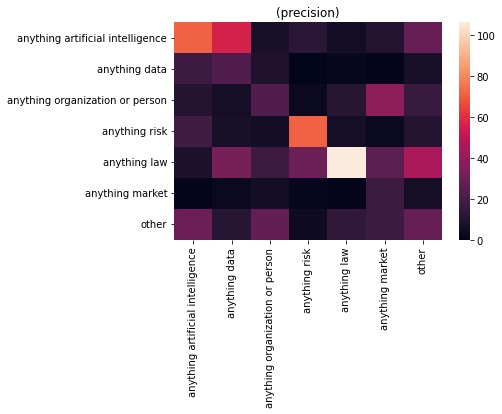

size of predicted terms: 900
Accuracy : 0.37444444444444447
Precision : 0.461225195911193
Recall : 0.37444444444444447
f1 : 0.396864910621116
                Term                       Prediction  \
0            europol  anything organization or person   
1  uniform condition                     anything law   
2    legislative act                     anything law   
3        distributor                  anything market   
4    aviation safety                    anything risk   

                       Ground truth  
0   anything organization or person  
1                      anything law  
2                      anything law  
3   anything organization or person  
4  anything artificial intelligence  


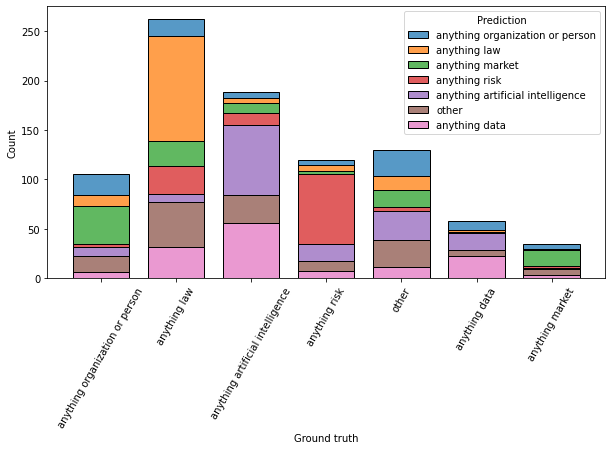

5 iterations:
['anything artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anything data', 'personal data', 'anonymous data', 'anything organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anything risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anything law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anything market', 'product', 'service', 'other']
['anything artificial intelligence', 'anything data', 'anything organization or person', 'anything risk', 'anything law', 'anything market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.004827087


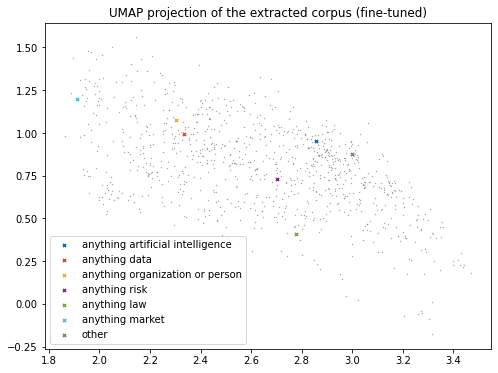

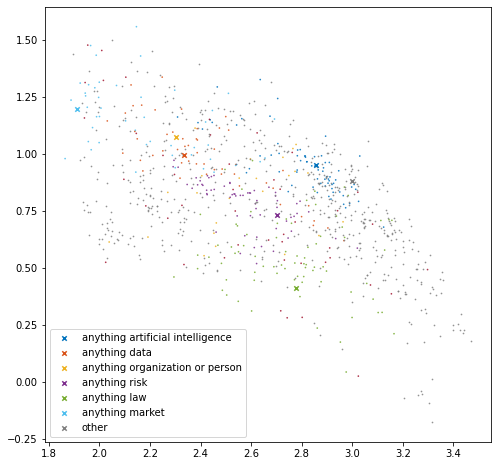

cluster size :
|-anything artificial intelligence : 73
|-anything data : 52
|-anything organization or person : 25
|-anything risk : 65
|-anything law : 78
|-anything market : 48
|-other : 595
  |-unlabeled terms within 'other': 549
0.11801757


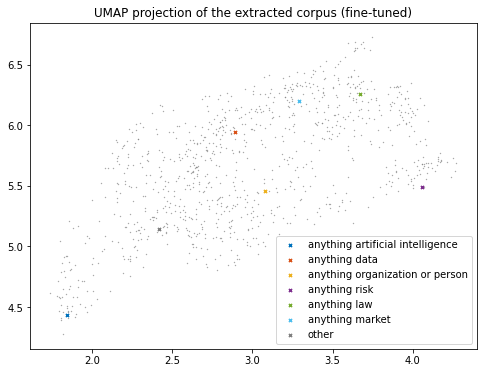

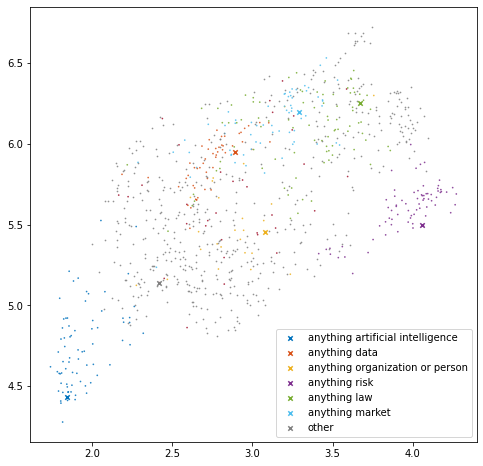

cluster size :
|-anything artificial intelligence : 75
|-anything data : 52
|-anything organization or person : 25
|-anything risk : 74
|-anything law : 90
|-anything market : 66
|-other : 554
  |-unlabeled terms within 'other': 520
0.14807943


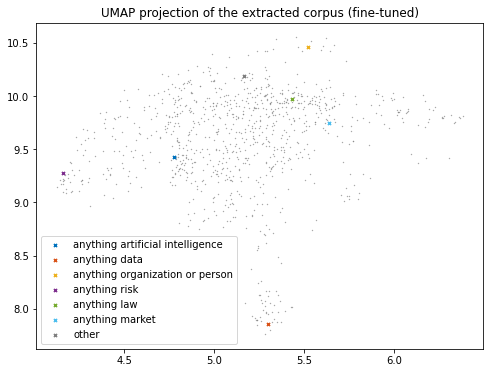

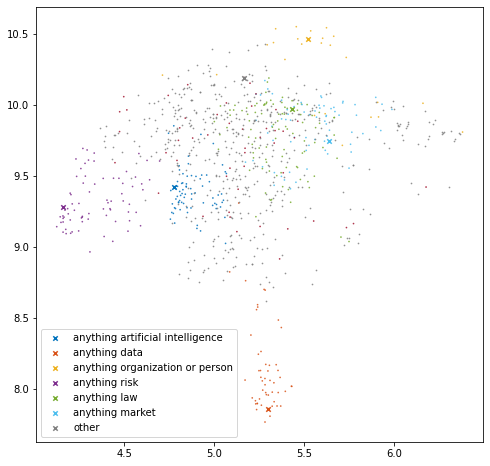

cluster size :
|-anything artificial intelligence : 75
|-anything data : 52
|-anything organization or person : 25
|-anything risk : 74
|-anything law : 96
|-anything market : 72
|-other : 542
  |-unlabeled terms within 'other': 493
0.16026616


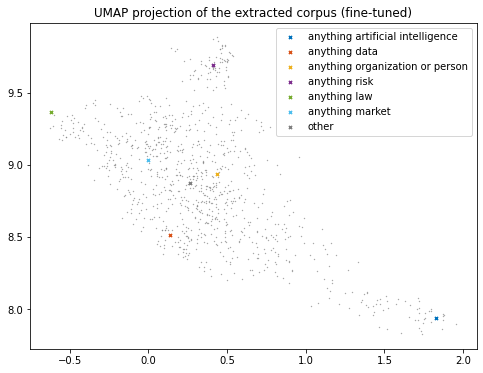

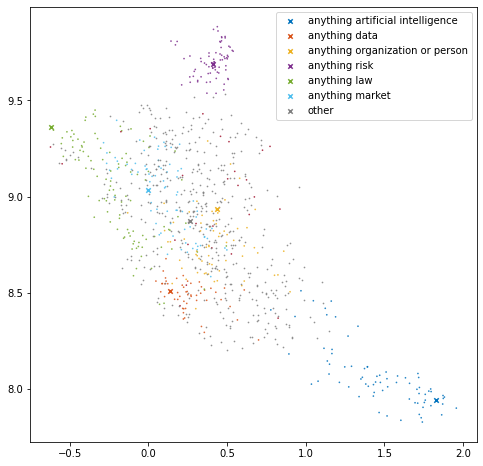

cluster size :
|-anything artificial intelligence : 75
|-anything data : 52
|-anything organization or person : 66
|-anything risk : 74
|-anything law : 105
|-anything market : 79
|-other : 485
  |-unlabeled terms within 'other': 458
0.21176042


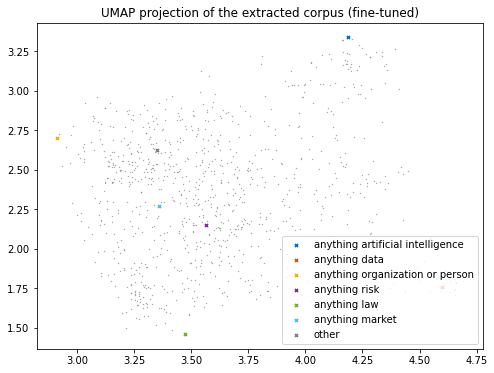

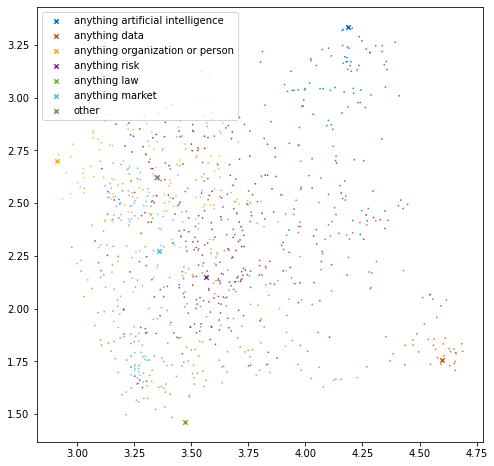

cluster size :
|-anything artificial intelligence : 132
|-anything data : 94
|-anything organization or person : 136
|-anything risk : 155
|-anything law : 176
|-anything market : 131
|-other : 112
  |-unlabeled terms within 'other': 0


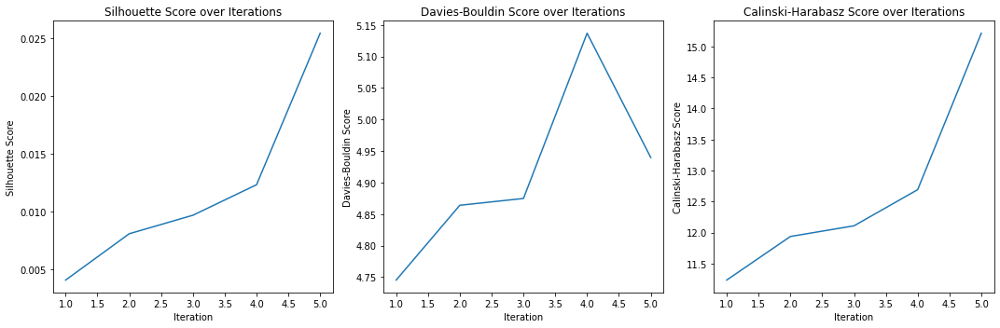

Silhouette : 0.025446443
Davies Bouldin : 4.939826050345066
Calinski Harabasz : 15.212784075050998


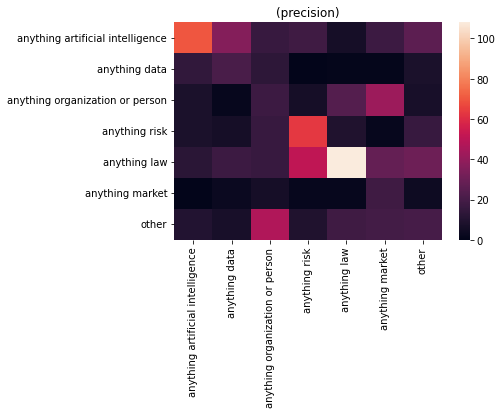

size of predicted terms: 900
Accuracy : 0.3522222222222222
Precision : 0.4255426204258375
Recall : 0.3522222222222222
f1 : 0.3707768432604893
                Term       Prediction                      Ground truth
0            europol  anything market   anything organization or person
1  uniform condition     anything law                      anything law
2    legislative act     anything law                      anything law
3        distributor  anything market   anything organization or person
4    aviation safety    anything risk  anything artificial intelligence


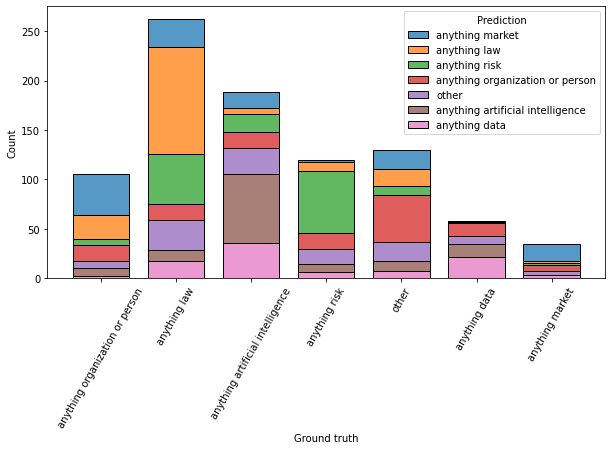

10 iterations:
['anything artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anything data', 'personal data', 'anonymous data', 'anything organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anything risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anything law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anything market', 'product', 'service', 'other']
['anything artificial intelligence', 'anything data', 'anything organization or person', 'anything risk', 'anything law', 'anything market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.004827087


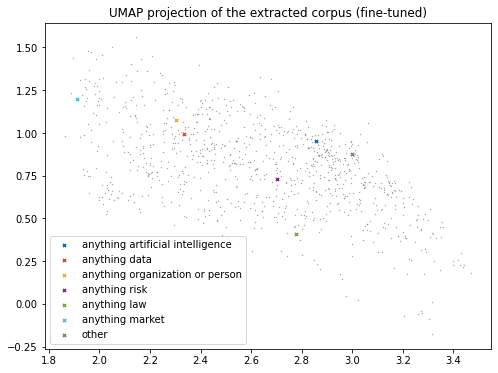

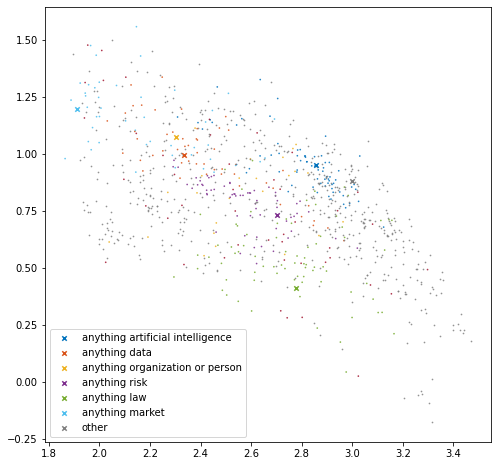

cluster size :
|-anything artificial intelligence : 73
|-anything data : 52
|-anything organization or person : 25
|-anything risk : 65
|-anything law : 78
|-anything market : 48
|-other : 595
  |-unlabeled terms within 'other': 549
0.11801757


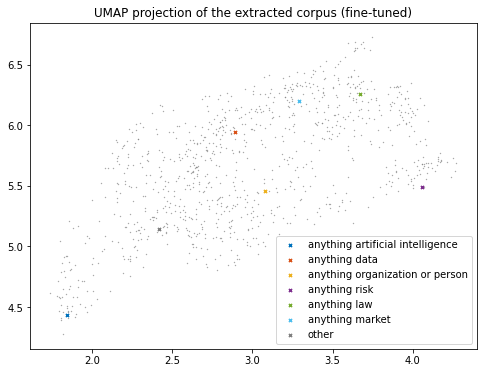

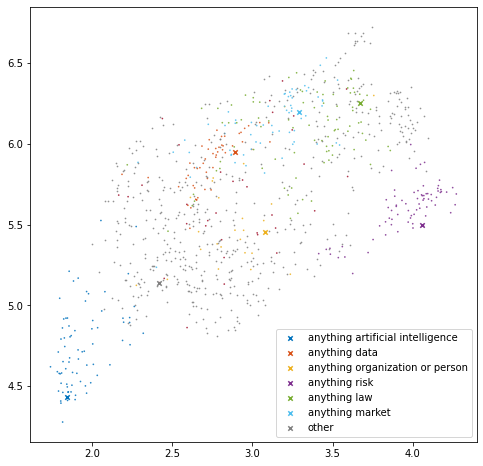

cluster size :
|-anything artificial intelligence : 75
|-anything data : 52
|-anything organization or person : 25
|-anything risk : 74
|-anything law : 90
|-anything market : 66
|-other : 554
  |-unlabeled terms within 'other': 520
0.14807943


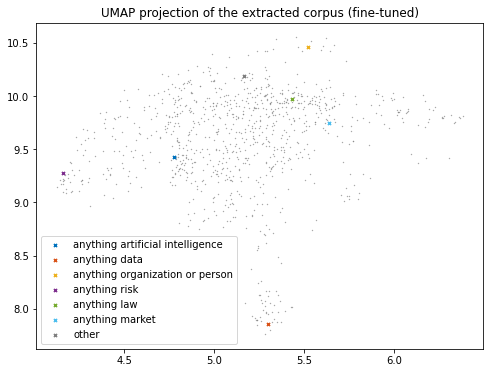

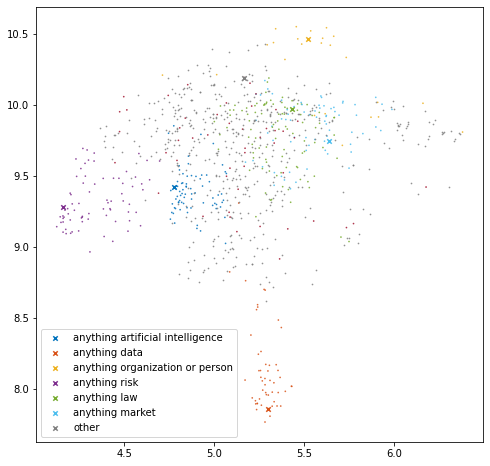

cluster size :
|-anything artificial intelligence : 75
|-anything data : 52
|-anything organization or person : 25
|-anything risk : 74
|-anything law : 96
|-anything market : 72
|-other : 542
  |-unlabeled terms within 'other': 493
0.16026616


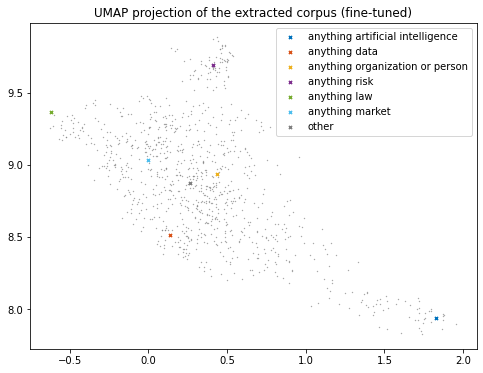

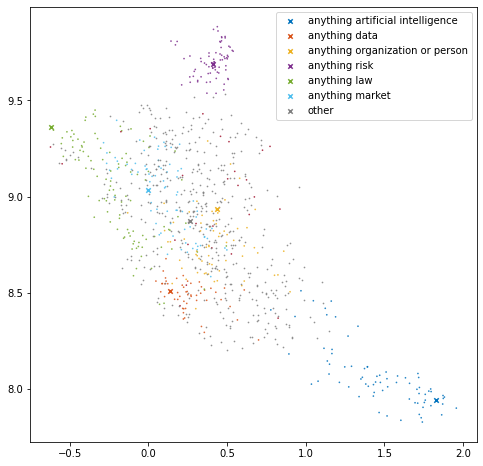

cluster size :
|-anything artificial intelligence : 75
|-anything data : 52
|-anything organization or person : 66
|-anything risk : 74
|-anything law : 105
|-anything market : 79
|-other : 485
  |-unlabeled terms within 'other': 458
0.19768222


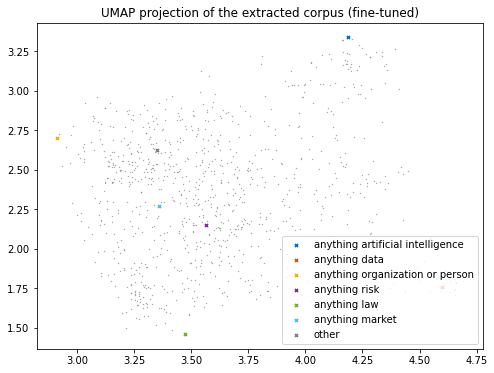

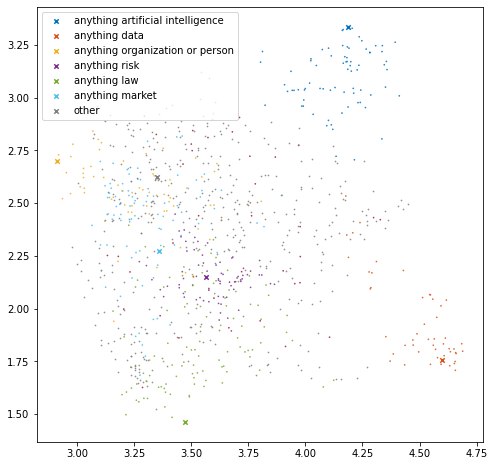

cluster size :
|-anything artificial intelligence : 75
|-anything data : 52
|-anything organization or person : 69
|-anything risk : 74
|-anything law : 110
|-anything market : 91
|-other : 465
  |-unlabeled terms within 'other': 425
0.2198858


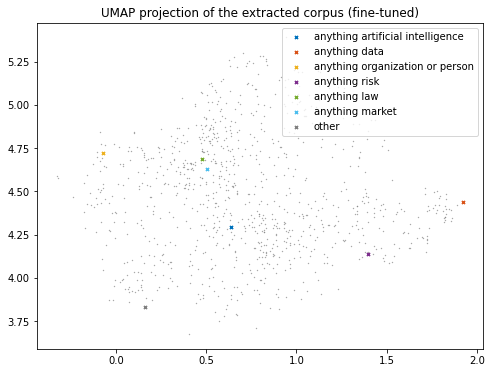

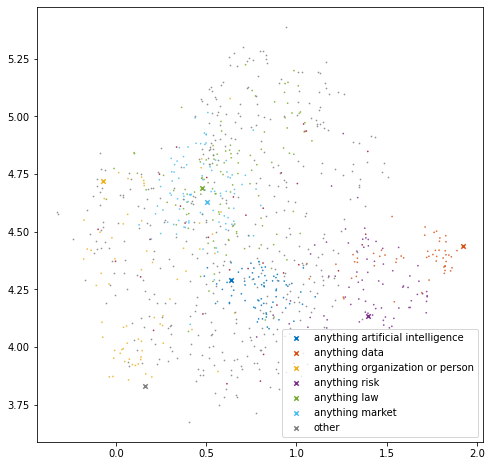

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 69
|-anything risk : 78
|-anything law : 114
|-anything market : 93
|-other : 452
  |-unlabeled terms within 'other': 417
0.2290011


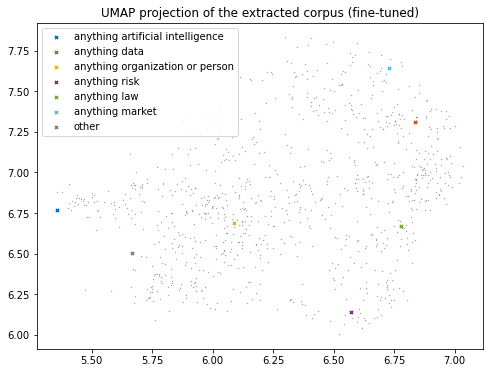

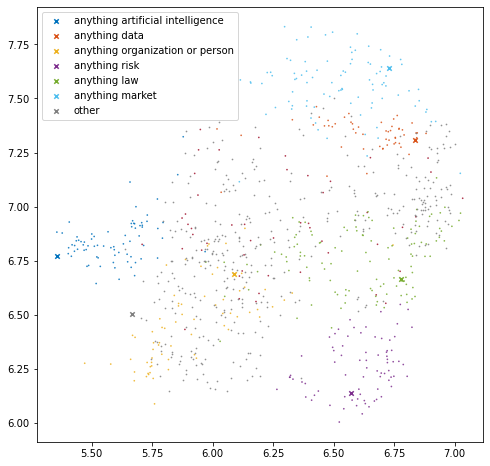

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 69
|-anything risk : 78
|-anything law : 119
|-anything market : 93
|-other : 447
  |-unlabeled terms within 'other': 397
0.23500893


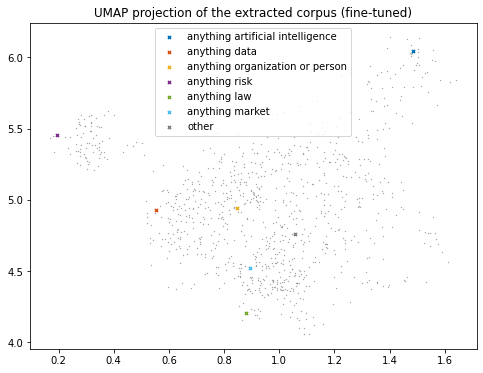

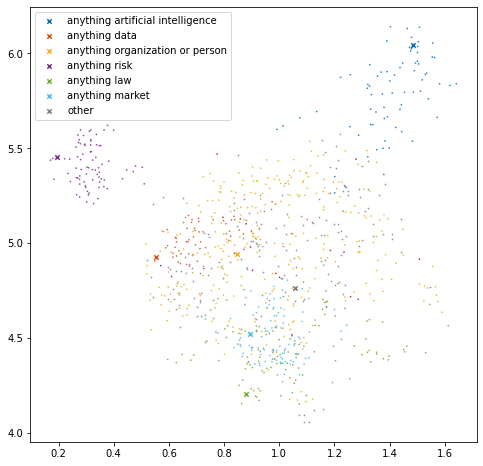

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 313
|-anything risk : 78
|-anything law : 125
|-anything market : 93
|-other : 197
  |-unlabeled terms within 'other': 180
0.38581166


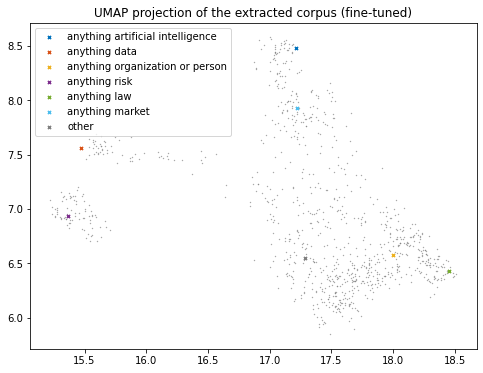

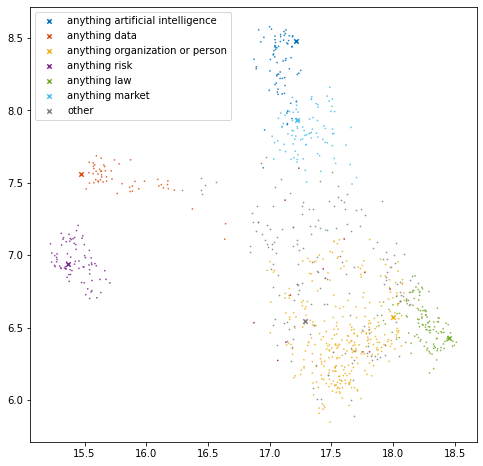

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 327
|-anything risk : 78
|-anything law : 125
|-anything market : 93
|-other : 183
  |-unlabeled terms within 'other': 169
0.37596354


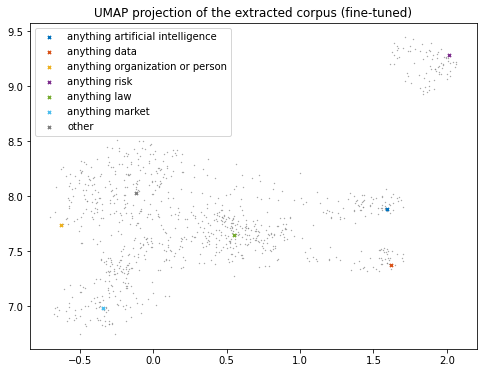

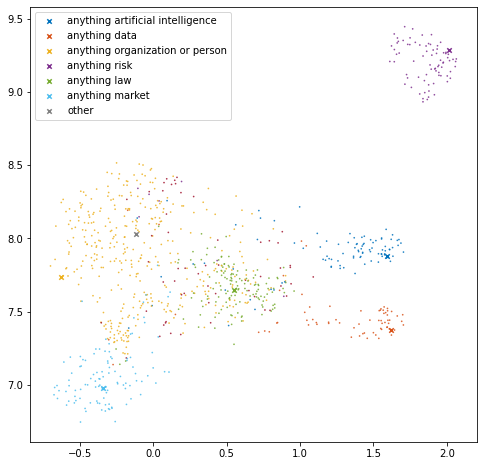

cluster size :
|-anything artificial intelligence : 96
|-anything data : 70
|-anything organization or person : 378
|-anything risk : 85
|-anything law : 140
|-anything market : 111
|-other : 56
  |-unlabeled terms within 'other': 0


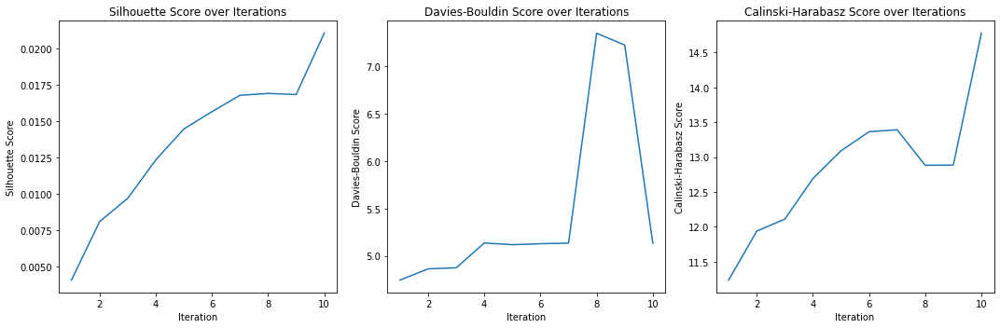

Silhouette : 0.021038271
Davies Bouldin : 5.134672269560309
Calinski Harabasz : 14.778375711884726


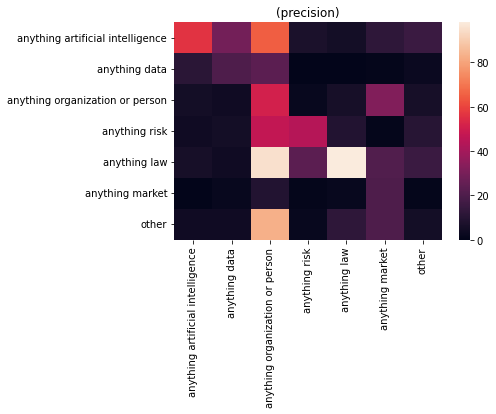

size of predicted terms: 900
Accuracy : 0.32666666666666666
Precision : 0.48259191222719783
Recall : 0.32666666666666666
f1 : 0.35360644765546323
                Term                       Prediction  \
0            europol  anything organization or person   
1  uniform condition                     anything law   
2    legislative act                     anything law   
3        distributor                  anything market   
4    aviation safety                    anything risk   

                       Ground truth  
0   anything organization or person  
1                      anything law  
2                      anything law  
3   anything organization or person  
4  anything artificial intelligence  


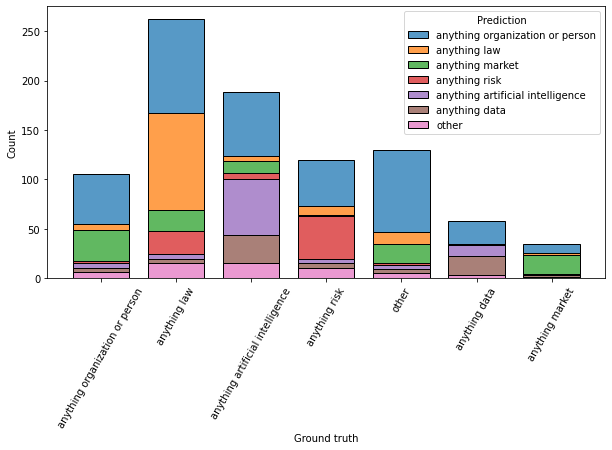

15 iterations:
['anything artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anything data', 'personal data', 'anonymous data', 'anything organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anything risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anything law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anything market', 'product', 'service', 'other']
['anything artificial intelligence', 'anything data', 'anything organization or person', 'anything risk', 'anything law', 'anything market', 'other']
unique terms:  900
cannot links:21
must links:30
-0.004827087


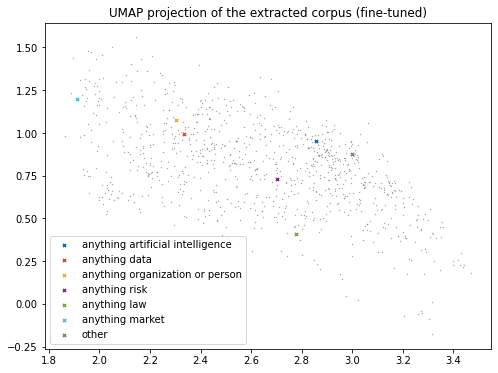

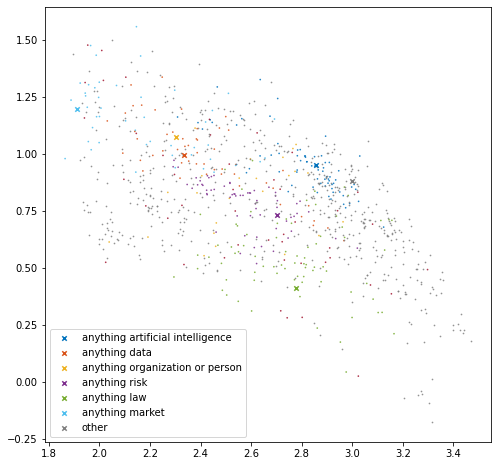

cluster size :
|-anything artificial intelligence : 73
|-anything data : 52
|-anything organization or person : 25
|-anything risk : 65
|-anything law : 78
|-anything market : 48
|-other : 595
  |-unlabeled terms within 'other': 549
0.11801757


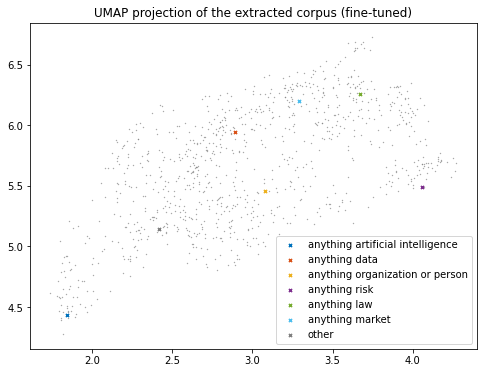

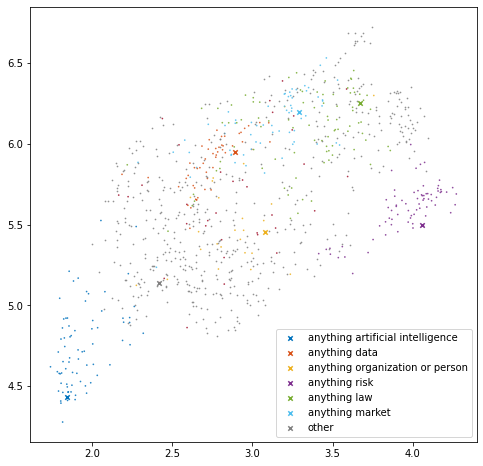

cluster size :
|-anything artificial intelligence : 75
|-anything data : 52
|-anything organization or person : 25
|-anything risk : 74
|-anything law : 90
|-anything market : 66
|-other : 554
  |-unlabeled terms within 'other': 520
0.14807943


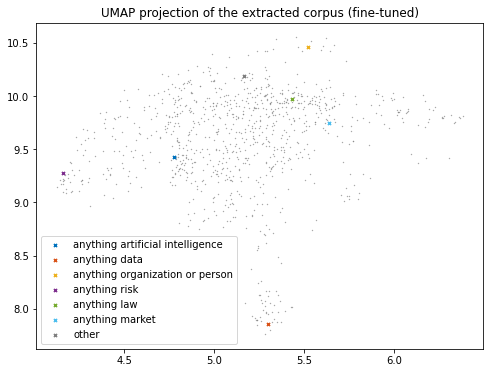

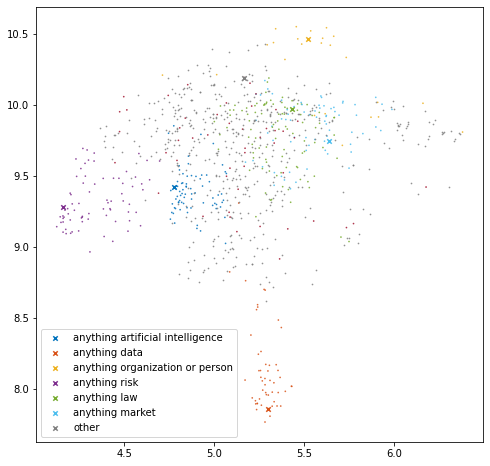

cluster size :
|-anything artificial intelligence : 75
|-anything data : 52
|-anything organization or person : 25
|-anything risk : 74
|-anything law : 96
|-anything market : 72
|-other : 542
  |-unlabeled terms within 'other': 493
0.16026616


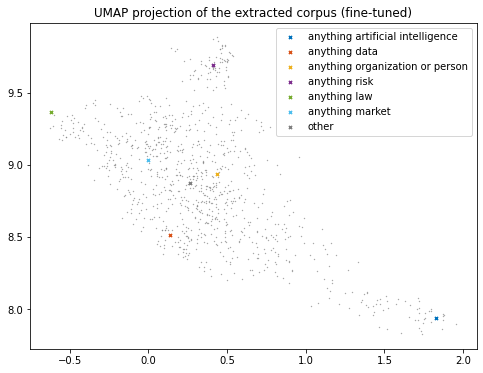

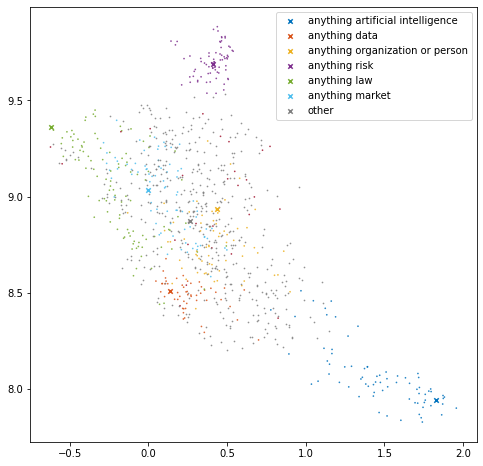

cluster size :
|-anything artificial intelligence : 75
|-anything data : 52
|-anything organization or person : 66
|-anything risk : 74
|-anything law : 105
|-anything market : 79
|-other : 485
  |-unlabeled terms within 'other': 458
0.19768222


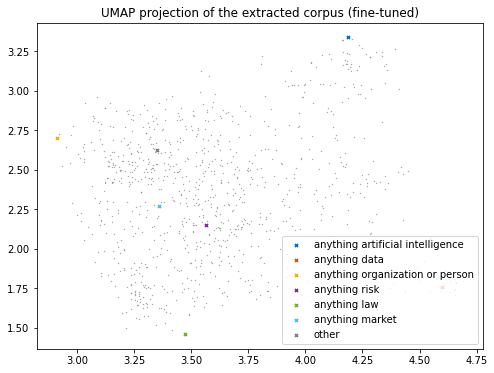

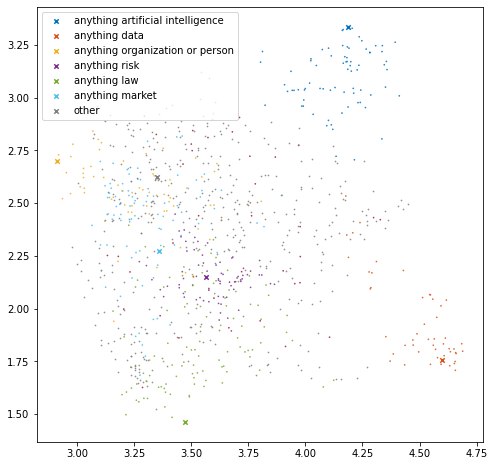

cluster size :
|-anything artificial intelligence : 75
|-anything data : 52
|-anything organization or person : 69
|-anything risk : 74
|-anything law : 110
|-anything market : 91
|-other : 465
  |-unlabeled terms within 'other': 425
0.2198858


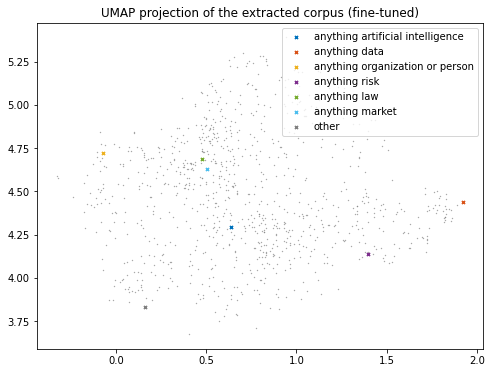

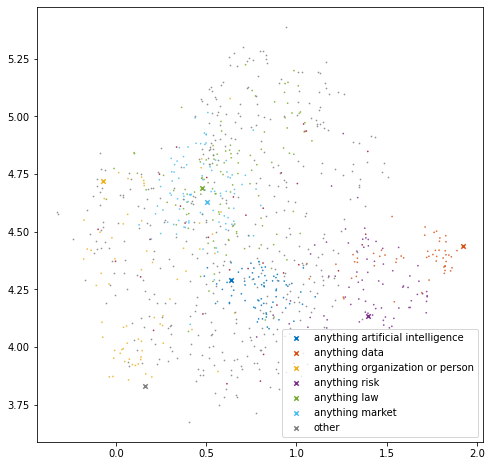

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 69
|-anything risk : 78
|-anything law : 114
|-anything market : 93
|-other : 452
  |-unlabeled terms within 'other': 417
0.2290011


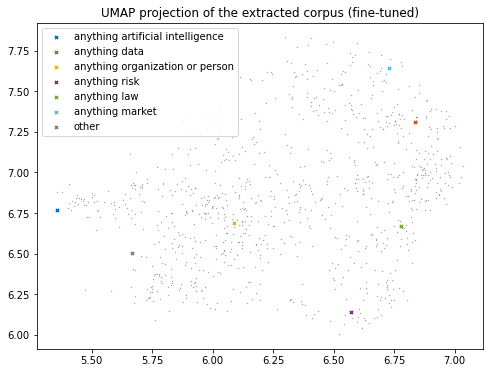

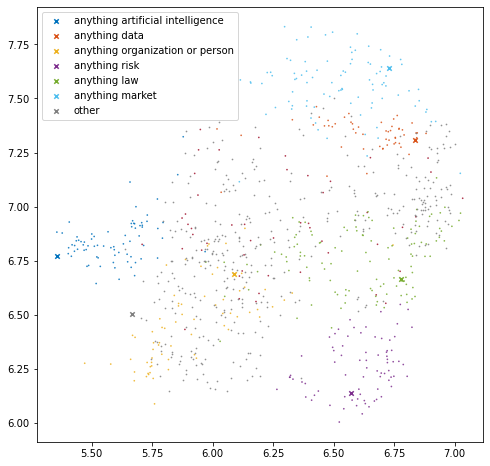

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 69
|-anything risk : 78
|-anything law : 119
|-anything market : 93
|-other : 447
  |-unlabeled terms within 'other': 397
0.23500893


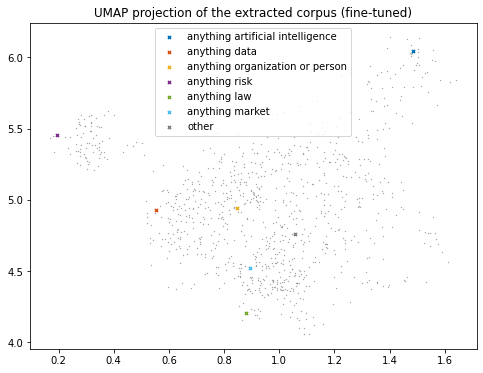

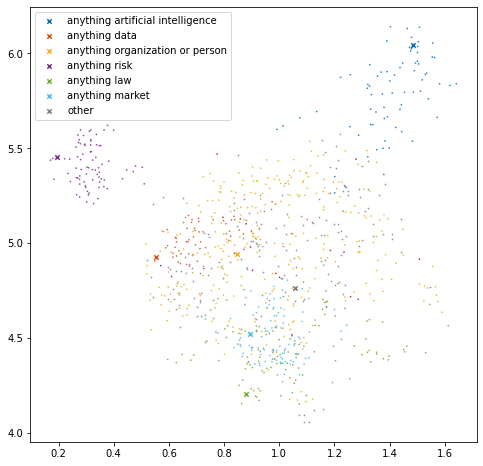

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 313
|-anything risk : 78
|-anything law : 125
|-anything market : 93
|-other : 197
  |-unlabeled terms within 'other': 180
0.38581166


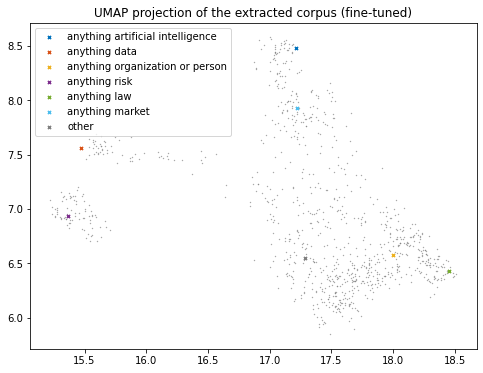

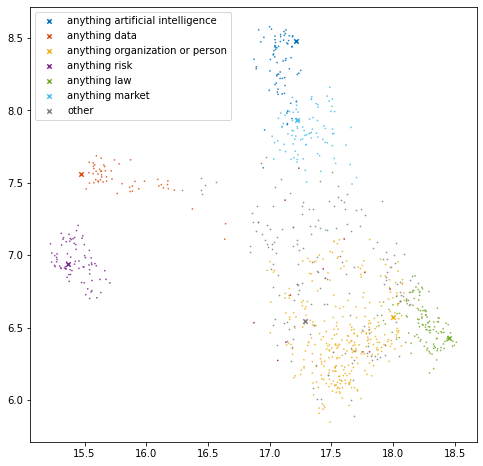

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 327
|-anything risk : 78
|-anything law : 125
|-anything market : 93
|-other : 183
  |-unlabeled terms within 'other': 169
0.4014044


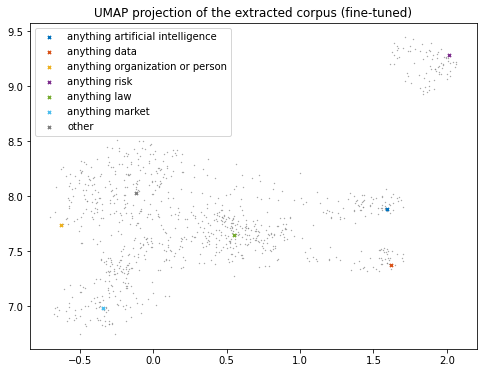

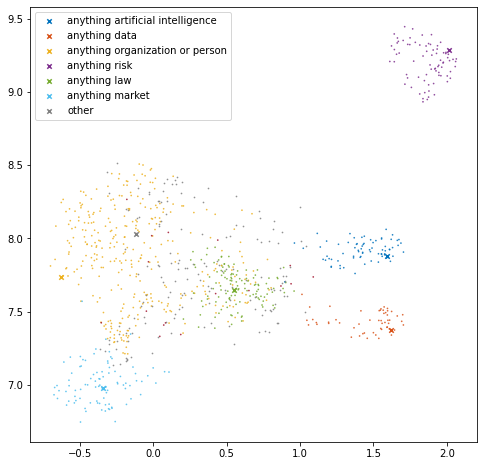

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 338
|-anything risk : 78
|-anything law : 125
|-anything market : 94
|-other : 171
  |-unlabeled terms within 'other': 153
0.40730706


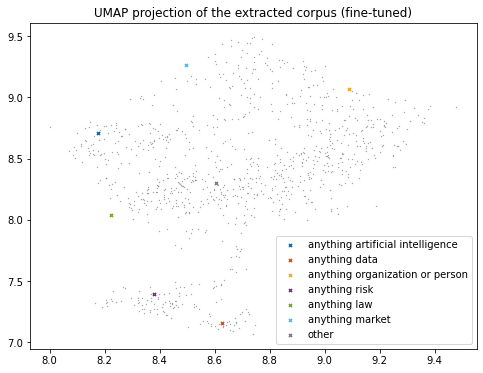

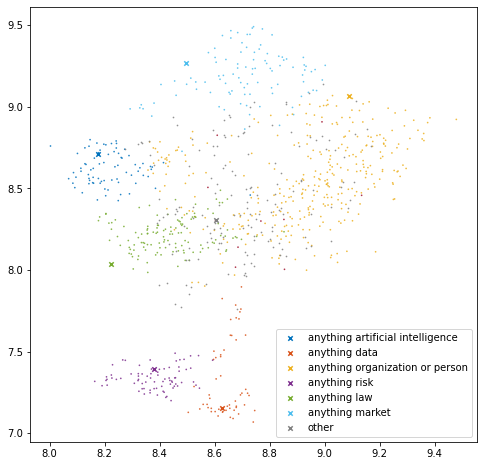

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 338
|-anything risk : 78
|-anything law : 125
|-anything market : 98
|-other : 167
  |-unlabeled terms within 'other': 157
0.4048863


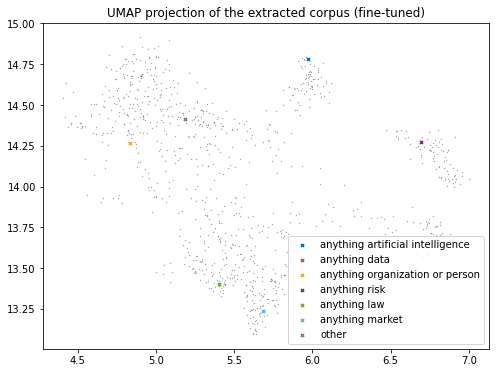

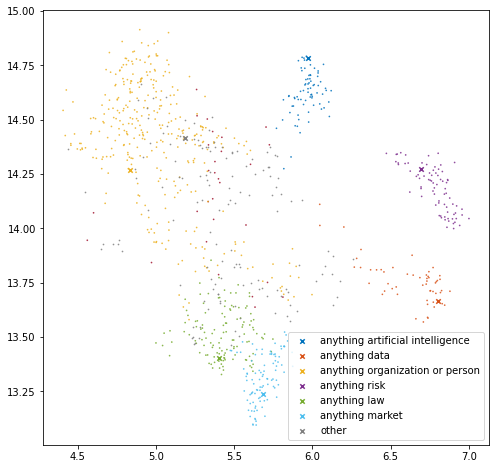

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 338
|-anything risk : 78
|-anything law : 125
|-anything market : 98
|-other : 167
  |-unlabeled terms within 'other': 137
0.42732358


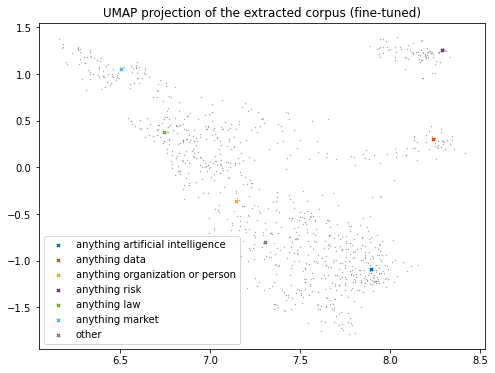

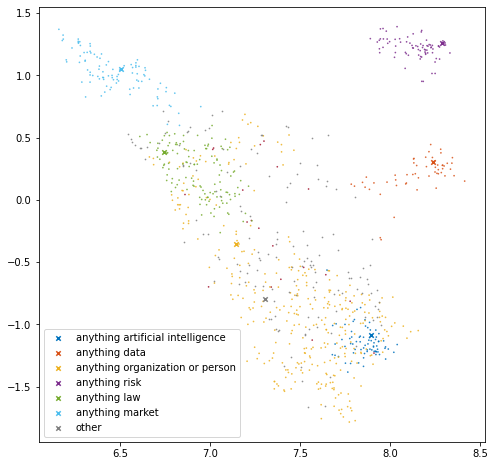

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 338
|-anything risk : 78
|-anything law : 125
|-anything market : 98
|-other : 167
  |-unlabeled terms within 'other': 146
0.40263358


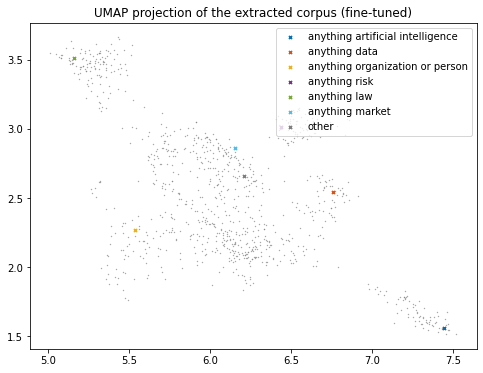

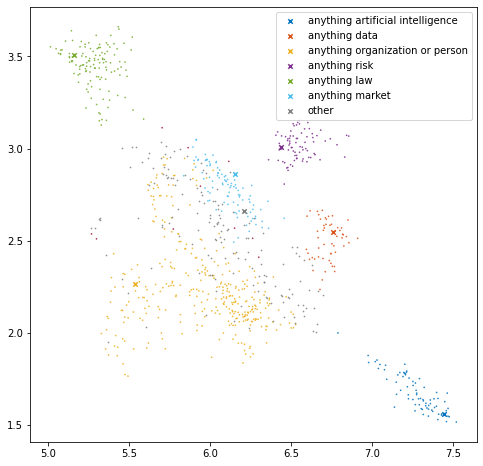

cluster size :
|-anything artificial intelligence : 75
|-anything data : 55
|-anything organization or person : 338
|-anything risk : 78
|-anything law : 125
|-anything market : 98
|-other : 167
  |-unlabeled terms within 'other': 156
0.3741209


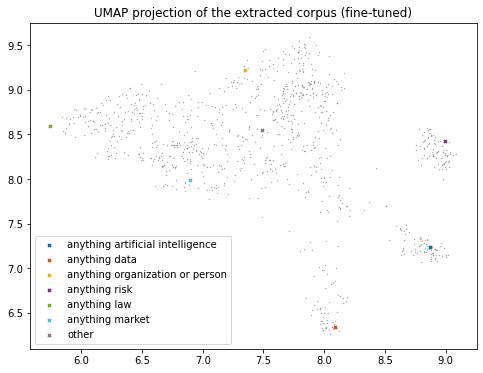

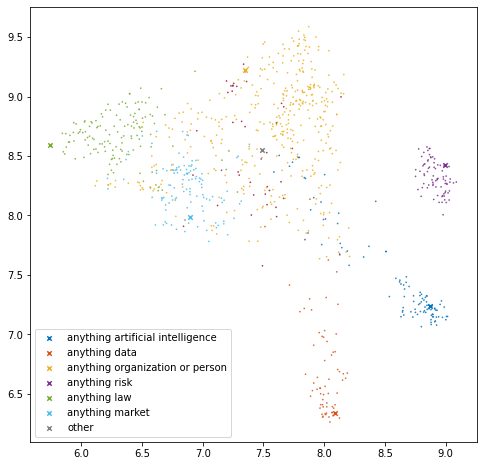

cluster size :
|-anything artificial intelligence : 98
|-anything data : 66
|-anything organization or person : 400
|-anything risk : 84
|-anything law : 135
|-anything market : 115
|-other : 38
  |-unlabeled terms within 'other': 0


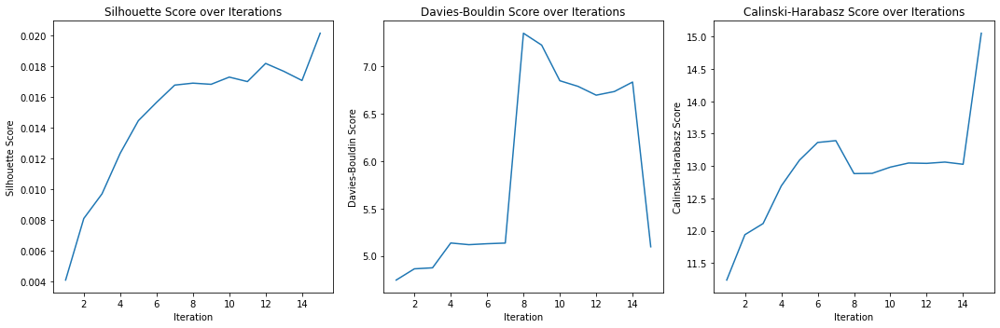

Silhouette : 0.020153034
Davies Bouldin : 5.097124095691452
Calinski Harabasz : 15.054519395757563


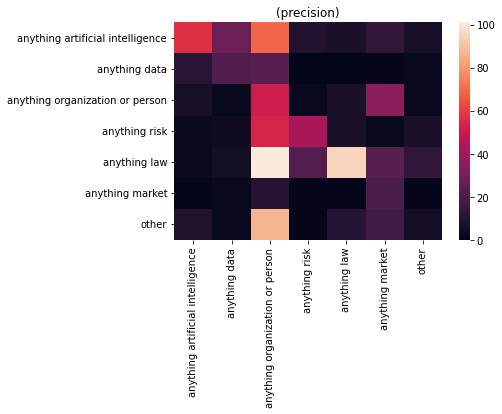

size of predicted terms: 900
Accuracy : 0.3244444444444444
Precision : 0.4901663916567173
Recall : 0.3244444444444444
f1 : 0.3519947566285452
                Term                       Prediction  \
0            europol  anything organization or person   
1  uniform condition                     anything law   
2    legislative act                     anything law   
3        distributor                  anything market   
4    aviation safety                    anything risk   

                       Ground truth  
0   anything organization or person  
1                      anything law  
2                      anything law  
3   anything organization or person  
4  anything artificial intelligence  


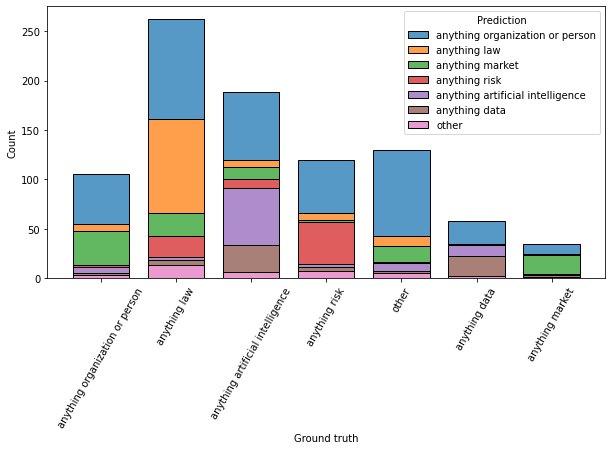


Summary:
    Accuracy  Precision    Recall        F1  Silhouette  Davies Bouldin  \
1   0.345556   0.437971  0.345556  0.359591    0.017705        5.845235   
2   0.374444   0.461225  0.374444  0.396865    0.023472        5.531990   
5   0.352222   0.425543  0.352222  0.370777    0.025446        4.939826   
10  0.326667   0.482592  0.326667  0.353606    0.021038        5.134672   
15  0.324444   0.490166  0.324444  0.351995    0.020153        5.097124   

    Calinski Harabasz  
1           13.857338  
2           14.145230  
5           15.212784  
10          14.778376  
15          15.054519  


In [17]:
_ = run_and_store_results(min_points=4,dimensions=10,prefix="Anything ")  

## 12. Any{CC}

1 iterations:
['anyartificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anydata', 'personal data', 'anonymous data', 'anyorganization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anyrisk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anylaw', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anymarket', 'product', 'service', 'other']
['anyartificial intelligence', 'anydata', 'anyorganization or person', 'anyrisk', 'anylaw', 'anymarket', 'other']
unique terms:  900
cannot links:21
must links:30
0.043753717


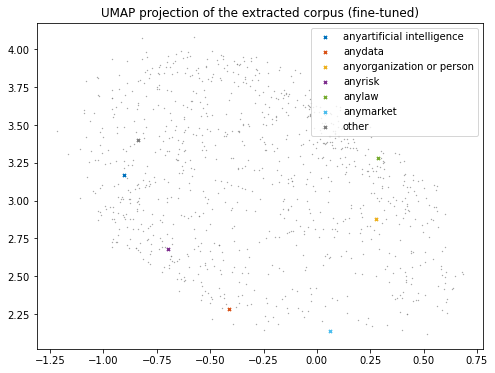

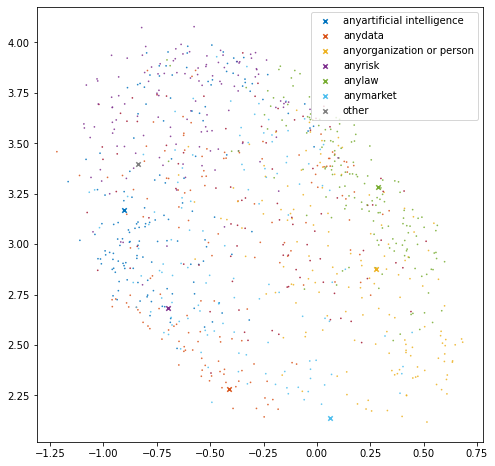

cluster size :
|-anyartificial intelligence : 151
|-anydata : 149
|-anyorganization or person : 149
|-anyrisk : 124
|-anylaw : 149
|-anymarket : 121
|-other : 93
  |-unlabeled terms within 'other': 0


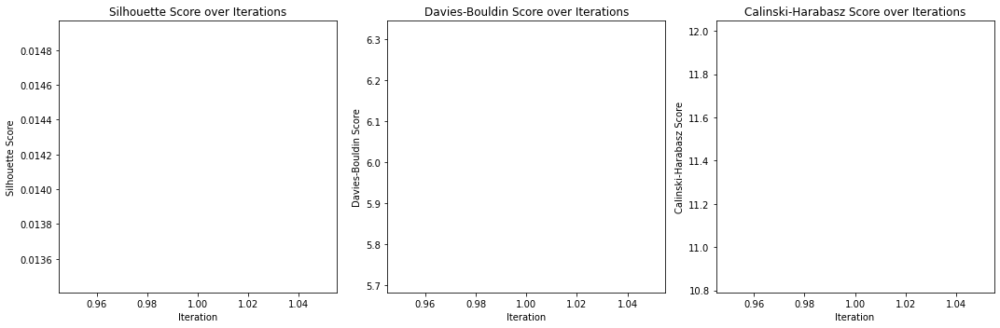

Silhouette : 0.014187407
Davies Bouldin : 6.01407835123877
Calinski Harabasz : 11.418614181341475


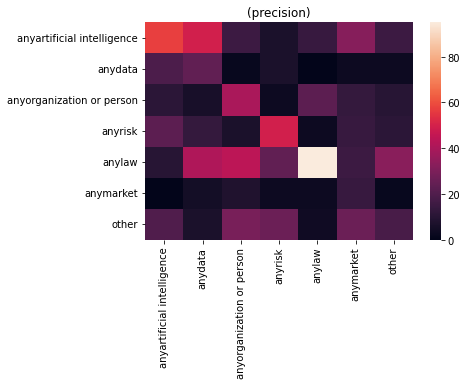

size of predicted terms: 900
Accuracy : 0.33
Precision : 0.4112307232820022
Recall : 0.33
f1 : 0.3477108890877737
                Term                 Prediction                Ground truth
0            europol  anyorganization or person   anyorganization or person
1  uniform condition                    anyrisk                      anylaw
2    legislative act                     anylaw                      anylaw
3        distributor                  anymarket   anyorganization or person
4    aviation safety  anyorganization or person  anyartificial intelligence


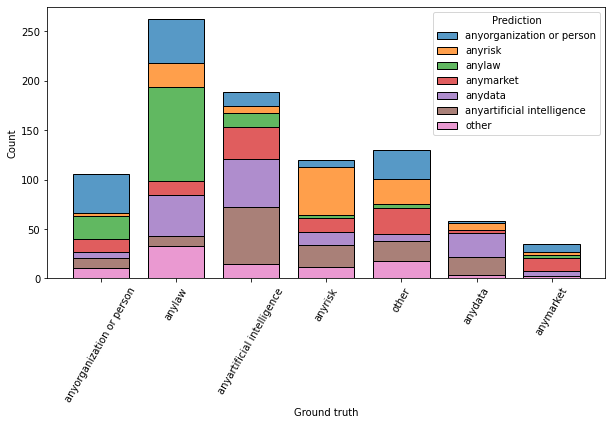

2 iterations:
['anyartificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anydata', 'personal data', 'anonymous data', 'anyorganization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anyrisk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anylaw', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anymarket', 'product', 'service', 'other']
['anyartificial intelligence', 'anydata', 'anyorganization or person', 'anyrisk', 'anylaw', 'anymarket', 'other']
unique terms:  900
cannot links:21
must links:30
-0.06510931


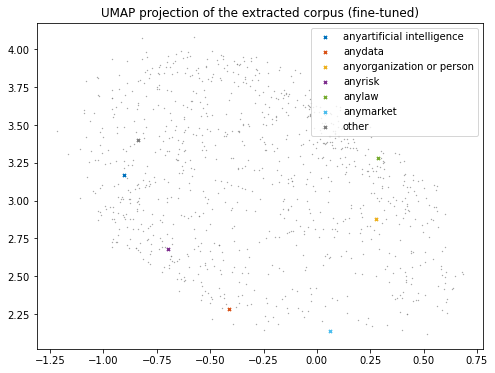

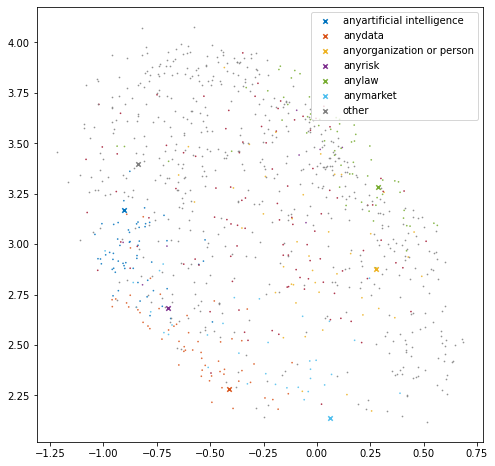

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 44
|-anyrisk : 9
|-anylaw : 62
|-anymarket : 35
|-other : 668
  |-unlabeled terms within 'other': 566
0.080470726


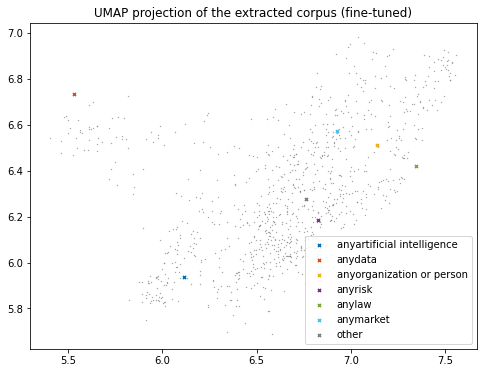

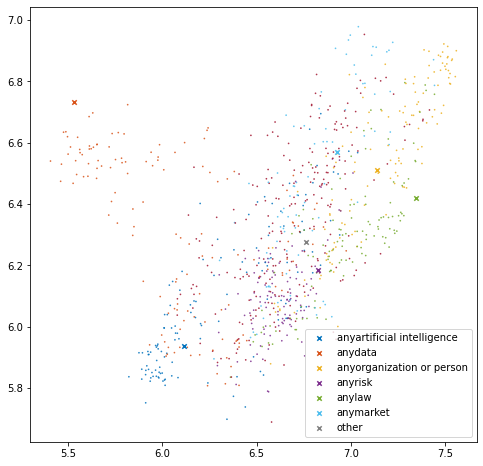

cluster size :
|-anyartificial intelligence : 130
|-anydata : 139
|-anyorganization or person : 129
|-anyrisk : 113
|-anylaw : 115
|-anymarket : 84
|-other : 226
  |-unlabeled terms within 'other': 0


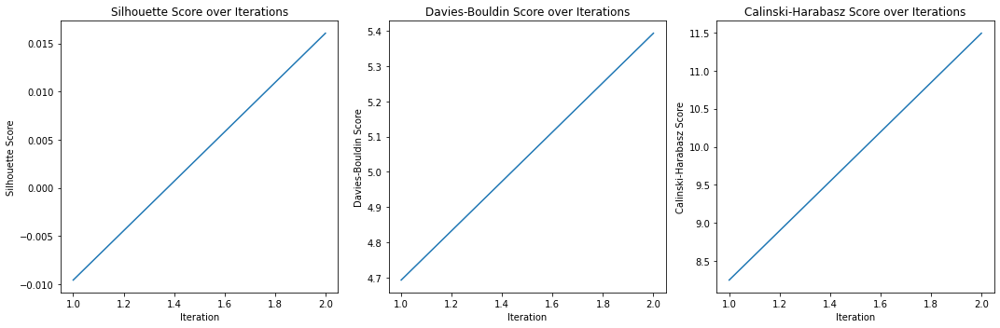

Silhouette : 0.016059205
Davies Bouldin : 5.393586696158853
Calinski Harabasz : 11.490847330096589


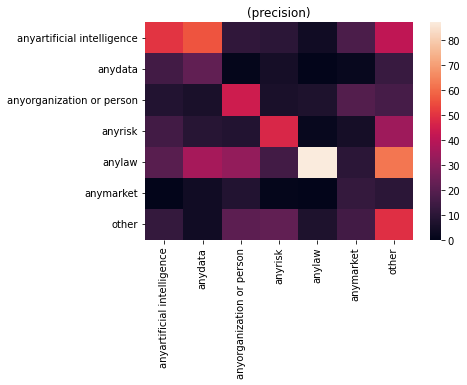

size of predicted terms: 900
Accuracy : 0.34555555555555556
Precision : 0.47241396030804306
Recall : 0.34555555555555556
f1 : 0.3680900800594481
                Term                 Prediction                Ground truth
0            europol  anyorganization or person   anyorganization or person
1  uniform condition                      other                      anylaw
2    legislative act                     anylaw                      anylaw
3        distributor                  anymarket   anyorganization or person
4    aviation safety                     anylaw  anyartificial intelligence


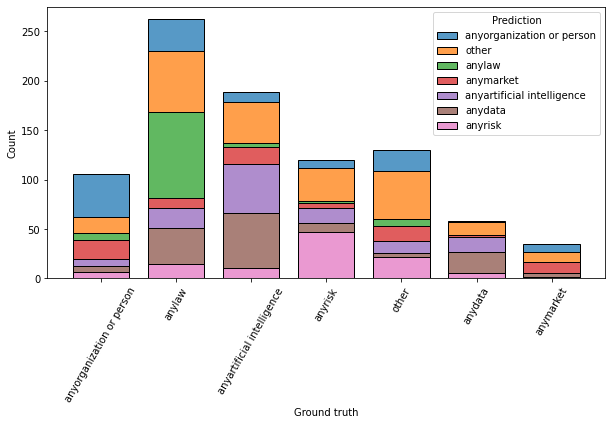

5 iterations:
['anyartificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anydata', 'personal data', 'anonymous data', 'anyorganization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anyrisk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anylaw', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anymarket', 'product', 'service', 'other']
['anyartificial intelligence', 'anydata', 'anyorganization or person', 'anyrisk', 'anylaw', 'anymarket', 'other']
unique terms:  900
cannot links:21
must links:30
-0.06510931


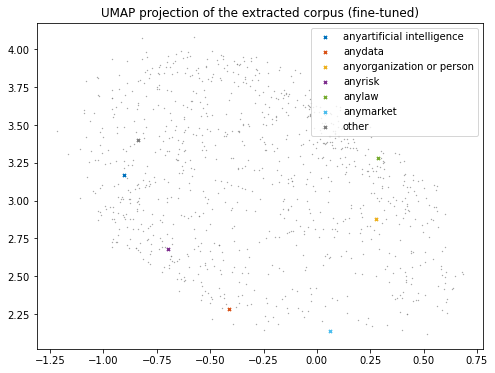

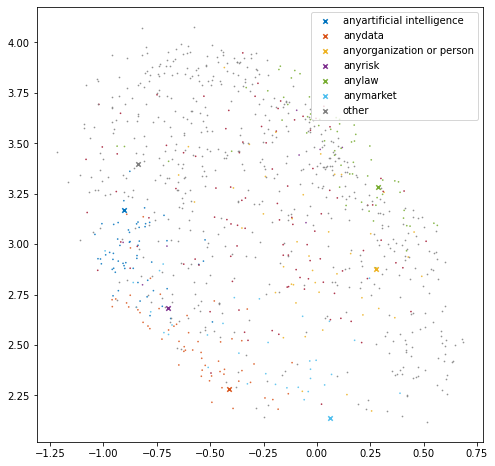

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 44
|-anyrisk : 9
|-anylaw : 62
|-anymarket : 35
|-other : 668
  |-unlabeled terms within 'other': 566
0.08240353


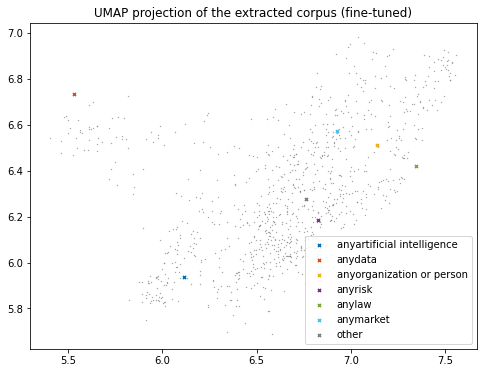

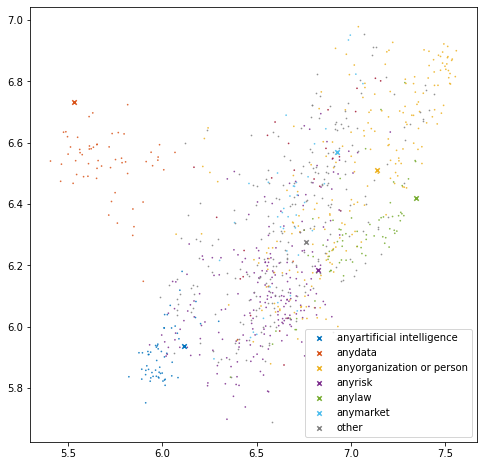

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 213
|-anyrisk : 226
|-anylaw : 72
|-anymarket : 41
|-other : 266
  |-unlabeled terms within 'other': 241
0.29560906


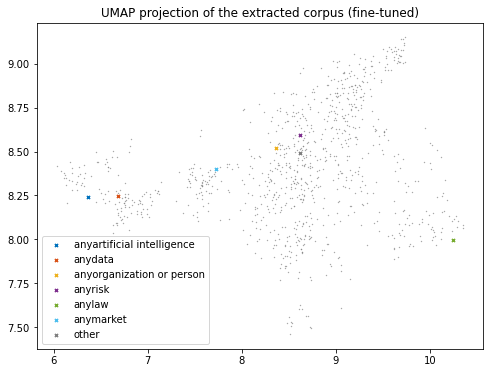

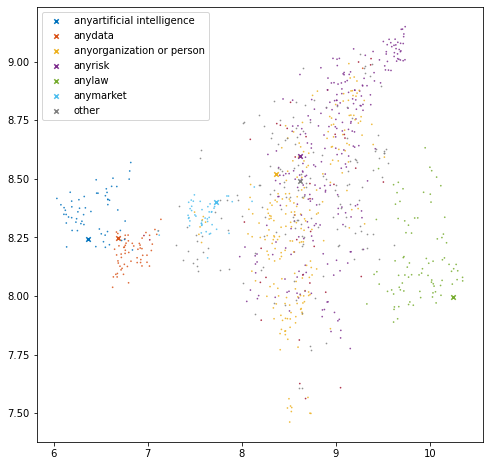

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 223
|-anyrisk : 258
|-anylaw : 88
|-anymarket : 48
|-other : 201
  |-unlabeled terms within 'other': 163
0.34619686


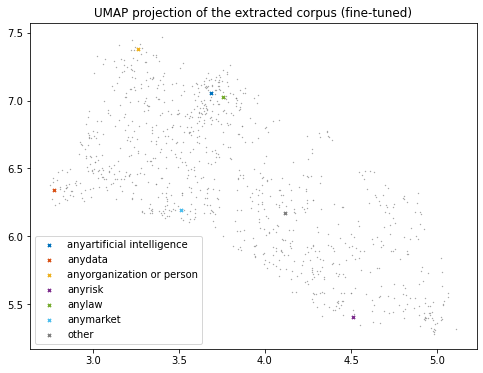

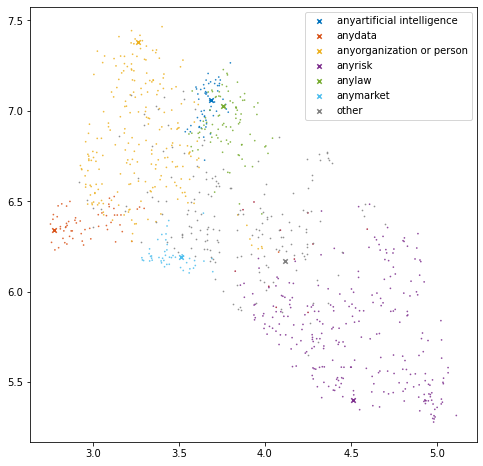

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 223
|-anyrisk : 265
|-anylaw : 89
|-anymarket : 48
|-other : 193
  |-unlabeled terms within 'other': 181
0.32906938


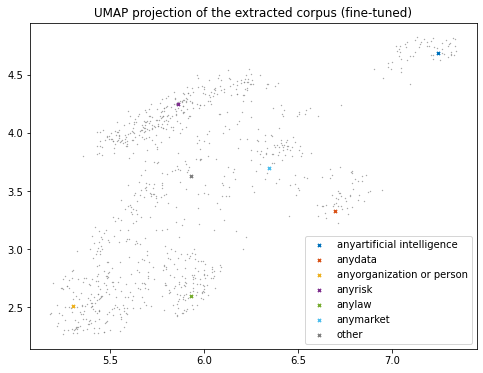

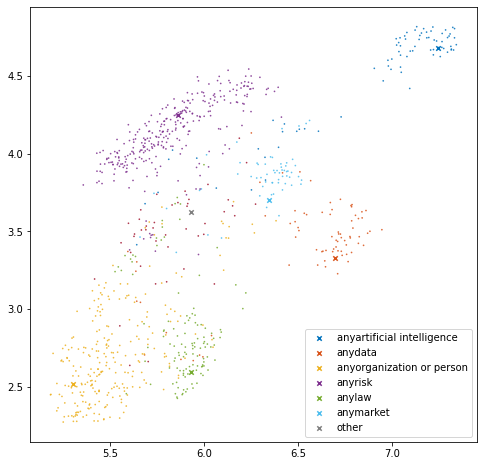

cluster size :
|-anyartificial intelligence : 78
|-anydata : 77
|-anyorganization or person : 259
|-anyrisk : 297
|-anylaw : 120
|-anymarket : 61
|-other : 44
  |-unlabeled terms within 'other': 0


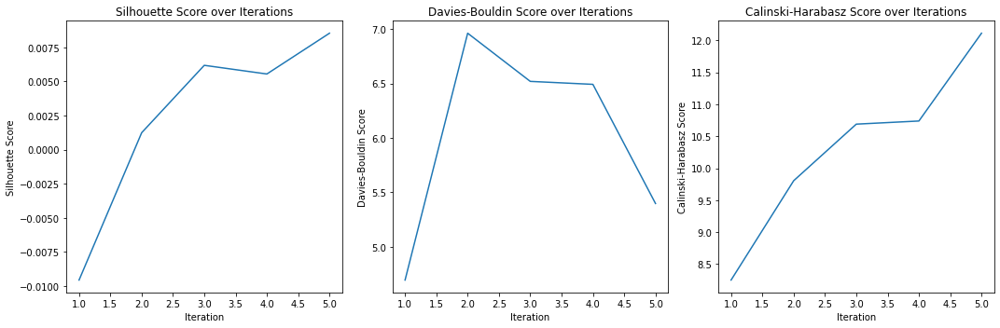

Silhouette : 0.00854039
Davies Bouldin : 5.396696826236046
Calinski Harabasz : 12.111443355433526


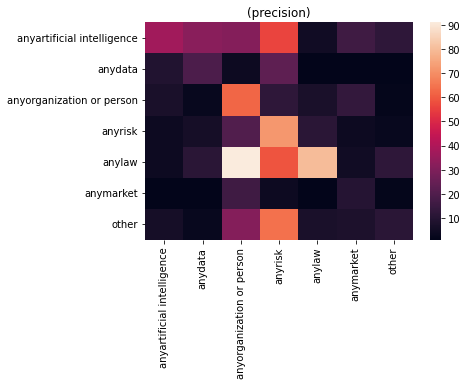

size of predicted terms: 900
Accuracy : 0.3233333333333333
Precision : 0.44404027007652574
Recall : 0.3233333333333333
f1 : 0.31752669428229097
                Term                 Prediction                Ground truth
0            europol  anyorganization or person   anyorganization or person
1  uniform condition                     anylaw                      anylaw
2    legislative act                     anylaw                      anylaw
3        distributor                  anymarket   anyorganization or person
4    aviation safety  anyorganization or person  anyartificial intelligence


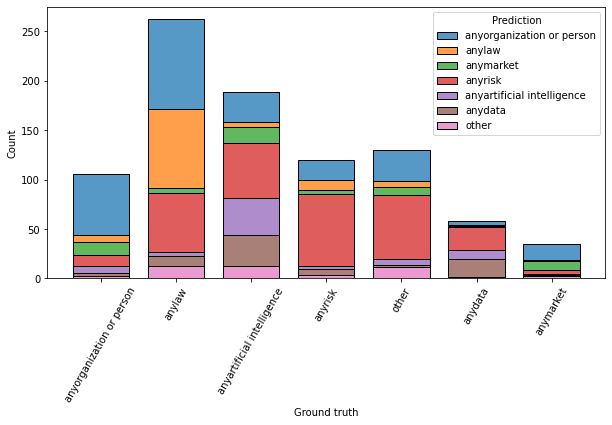

10 iterations:
['anyartificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anydata', 'personal data', 'anonymous data', 'anyorganization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anyrisk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anylaw', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anymarket', 'product', 'service', 'other']
['anyartificial intelligence', 'anydata', 'anyorganization or person', 'anyrisk', 'anylaw', 'anymarket', 'other']
unique terms:  900
cannot links:21
must links:30
-0.06510931


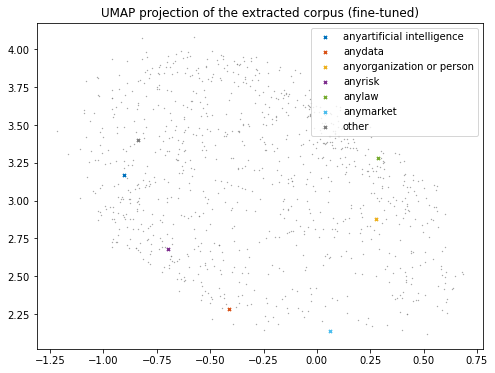

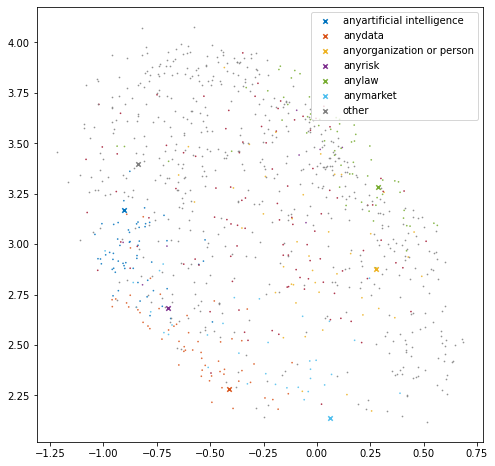

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 44
|-anyrisk : 9
|-anylaw : 62
|-anymarket : 35
|-other : 668
  |-unlabeled terms within 'other': 566
0.08240353


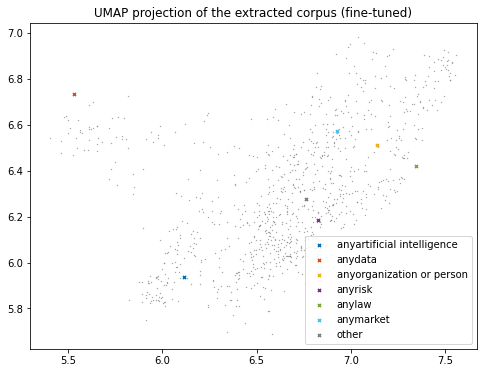

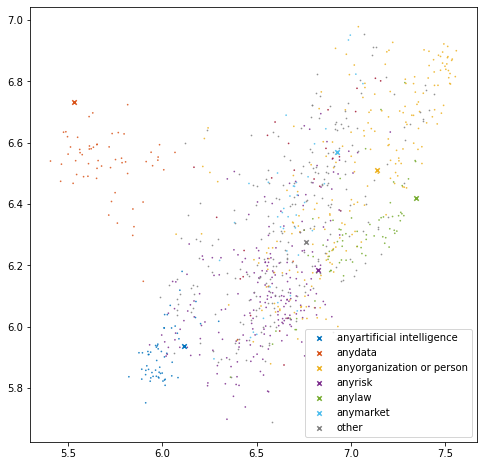

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 213
|-anyrisk : 226
|-anylaw : 72
|-anymarket : 41
|-other : 266
  |-unlabeled terms within 'other': 241
0.29560906


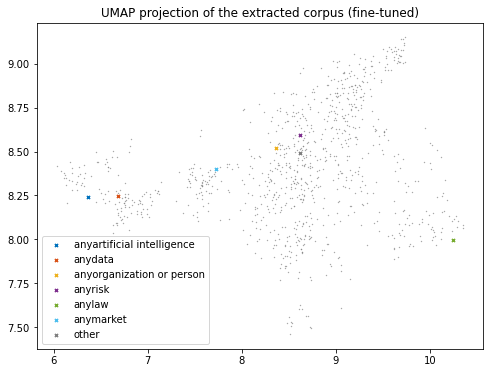

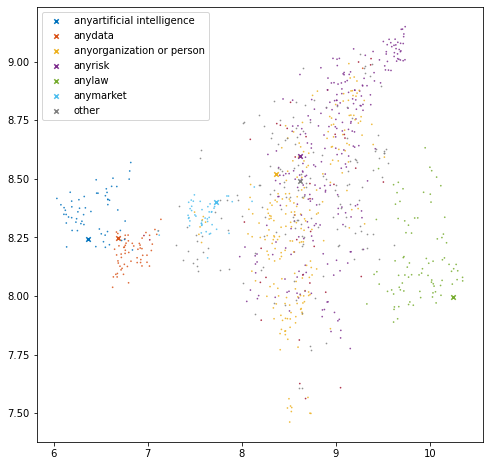

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 223
|-anyrisk : 258
|-anylaw : 88
|-anymarket : 48
|-other : 201
  |-unlabeled terms within 'other': 163
0.34619686


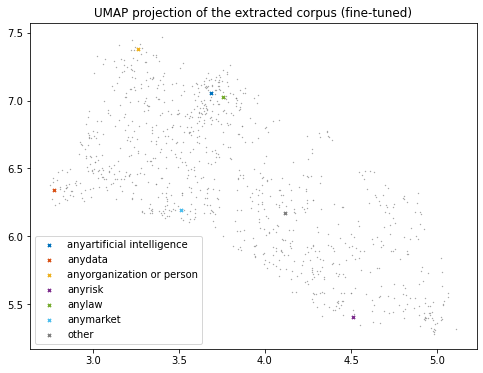

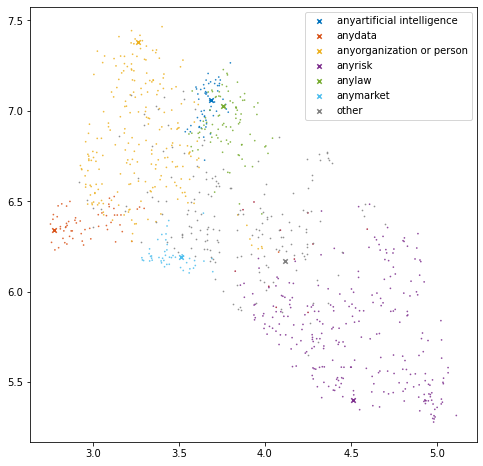

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 223
|-anyrisk : 265
|-anylaw : 89
|-anymarket : 48
|-other : 193
  |-unlabeled terms within 'other': 181
0.36470032


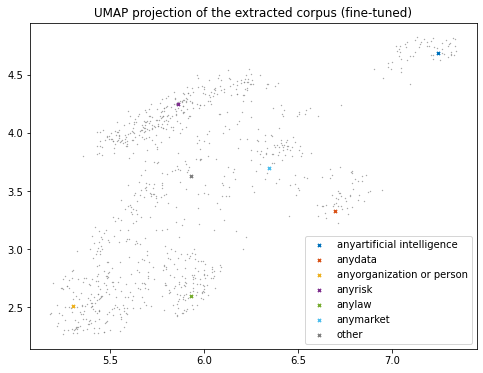

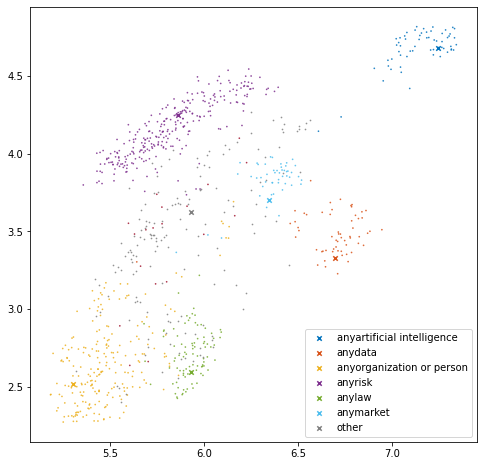

cluster size :
|-anyartificial intelligence : 60
|-anydata : 60
|-anyorganization or person : 223
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 50
|-other : 179
  |-unlabeled terms within 'other': 159
0.41660172


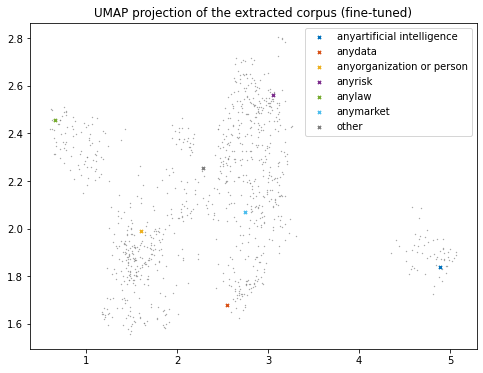

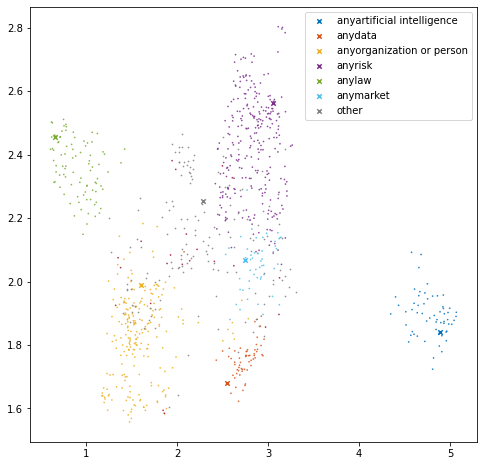

cluster size :
|-anyartificial intelligence : 60
|-anydata : 60
|-anyorganization or person : 223
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 54
|-other : 175
  |-unlabeled terms within 'other': 151
0.38769865


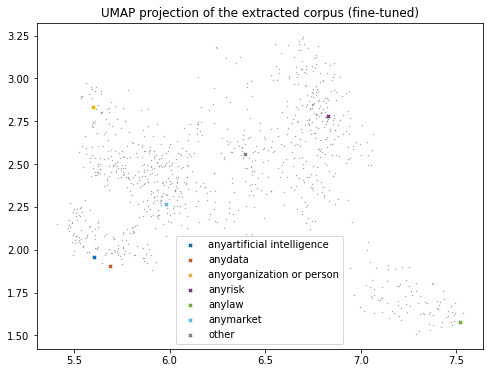

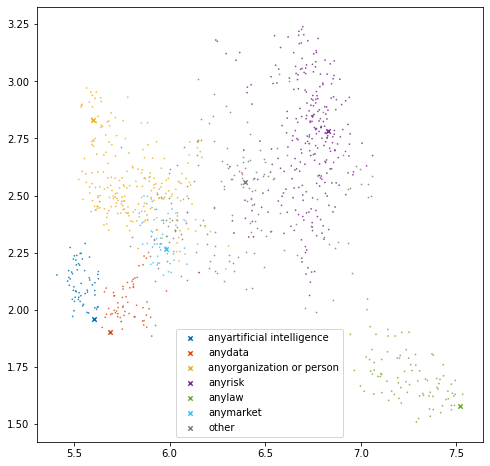

cluster size :
|-anyartificial intelligence : 60
|-anydata : 60
|-anyorganization or person : 229
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 57
|-other : 166
  |-unlabeled terms within 'other': 160
0.399031


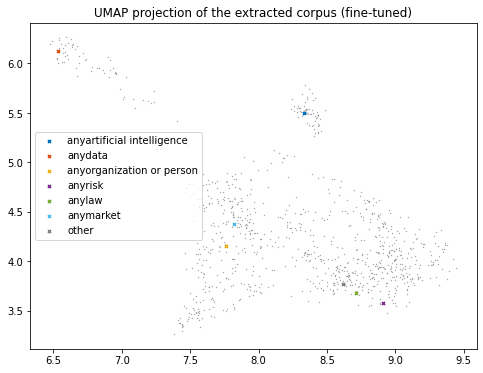

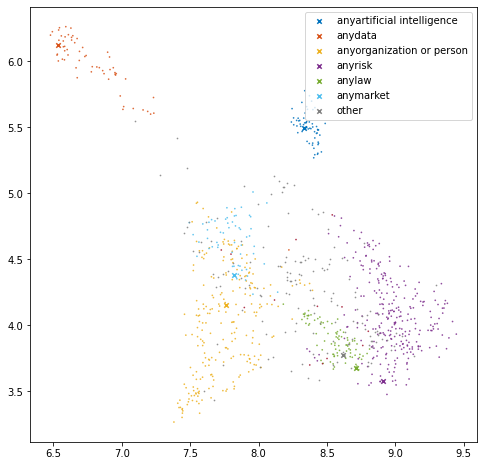

cluster size :
|-anyartificial intelligence : 60
|-anydata : 60
|-anyorganization or person : 229
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 57
|-other : 166
  |-unlabeled terms within 'other': 152
0.43377653


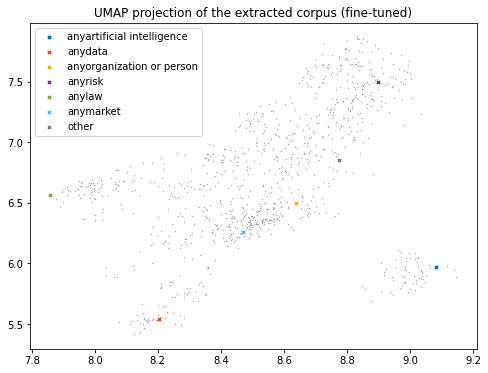

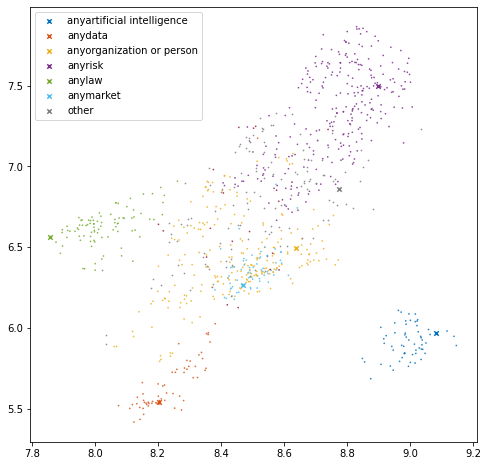

cluster size :
|-anyartificial intelligence : 60
|-anydata : 62
|-anyorganization or person : 229
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 68
|-other : 153
  |-unlabeled terms within 'other': 132
0.4140486


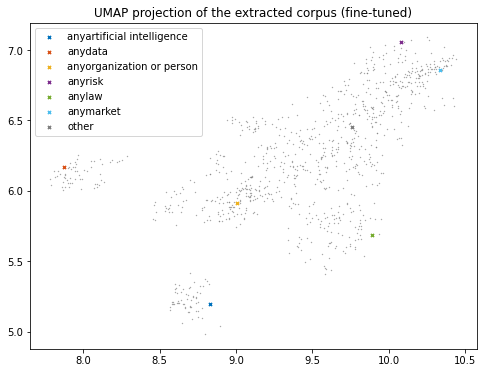

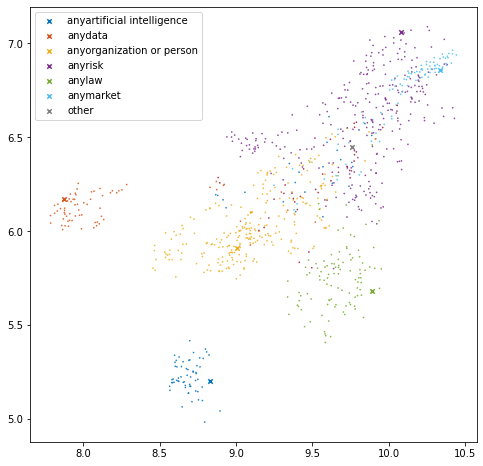

cluster size :
|-anyartificial intelligence : 83
|-anydata : 71
|-anyorganization or person : 256
|-anyrisk : 289
|-anylaw : 106
|-anymarket : 92
|-other : 39
  |-unlabeled terms within 'other': 0


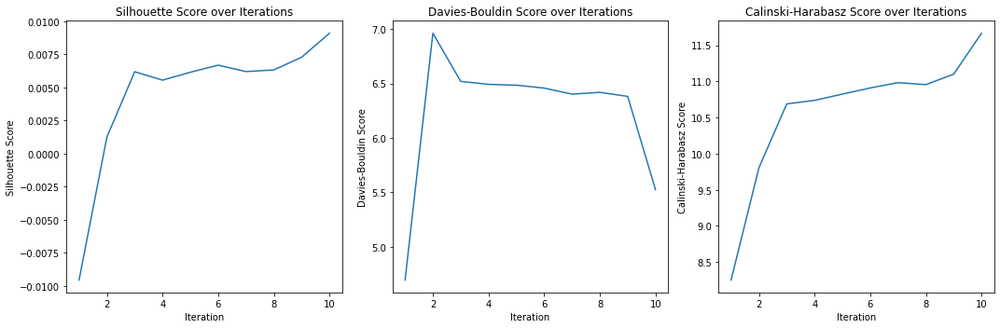

Silhouette : 0.009097752
Davies Bouldin : 5.523915466443342
Calinski Harabasz : 11.668149518427992


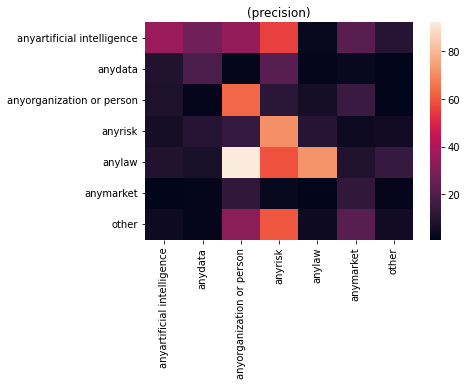

size of predicted terms: 900
Accuracy : 0.31
Precision : 0.42294974835996874
Recall : 0.31
f1 : 0.29880561499947933
                Term                 Prediction                Ground truth
0            europol  anyorganization or person   anyorganization or person
1  uniform condition                     anylaw                      anylaw
2    legislative act                     anylaw                      anylaw
3        distributor                  anymarket   anyorganization or person
4    aviation safety  anyorganization or person  anyartificial intelligence


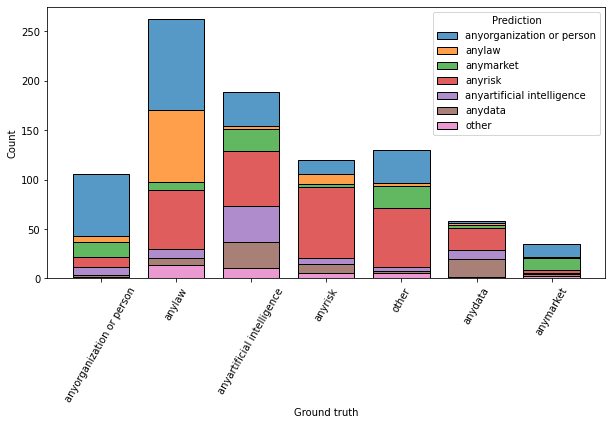

15 iterations:
['anyartificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'anydata', 'personal data', 'anonymous data', 'anyorganization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'anyrisk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'anylaw', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'anymarket', 'product', 'service', 'other']
['anyartificial intelligence', 'anydata', 'anyorganization or person', 'anyrisk', 'anylaw', 'anymarket', 'other']
unique terms:  900
cannot links:21
must links:30
-0.06510931


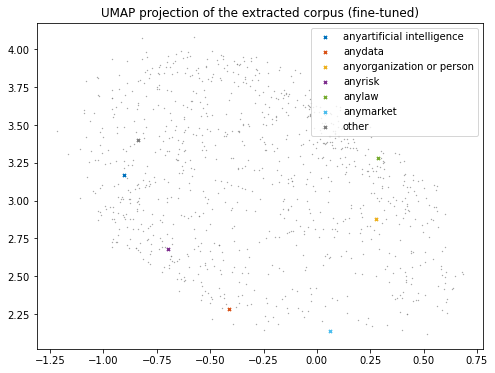

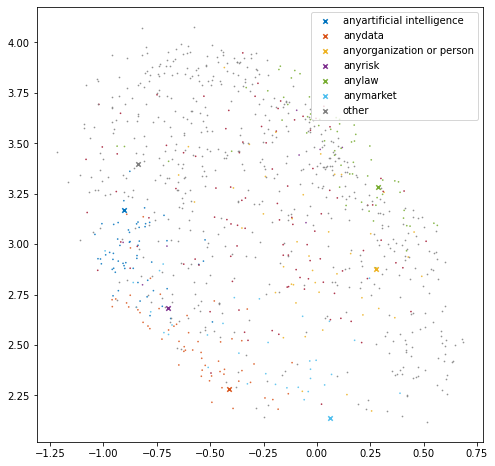

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 44
|-anyrisk : 9
|-anylaw : 62
|-anymarket : 35
|-other : 668
  |-unlabeled terms within 'other': 566
0.08240353


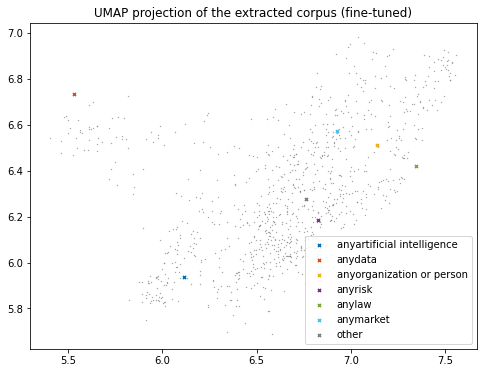

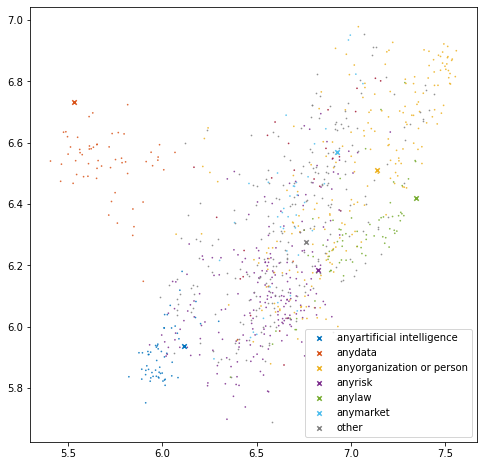

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 213
|-anyrisk : 226
|-anylaw : 72
|-anymarket : 41
|-other : 266
  |-unlabeled terms within 'other': 241
0.29560906


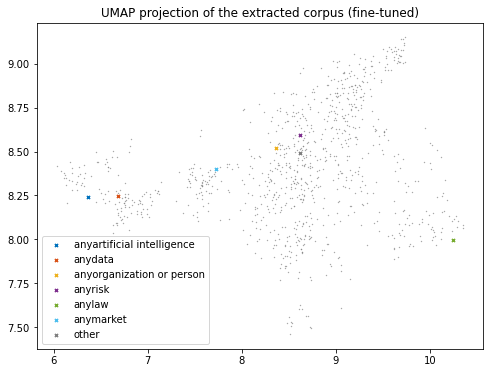

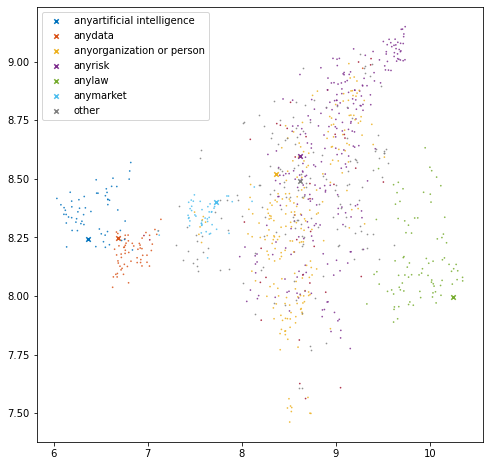

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 223
|-anyrisk : 258
|-anylaw : 88
|-anymarket : 48
|-other : 201
  |-unlabeled terms within 'other': 163
0.34619686


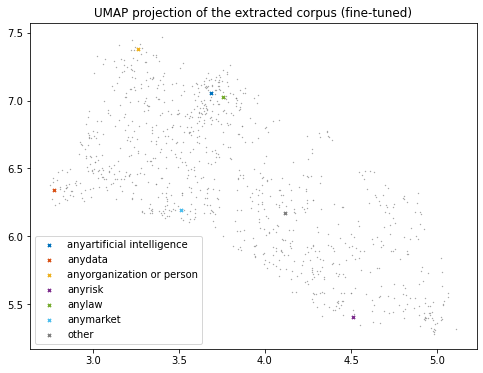

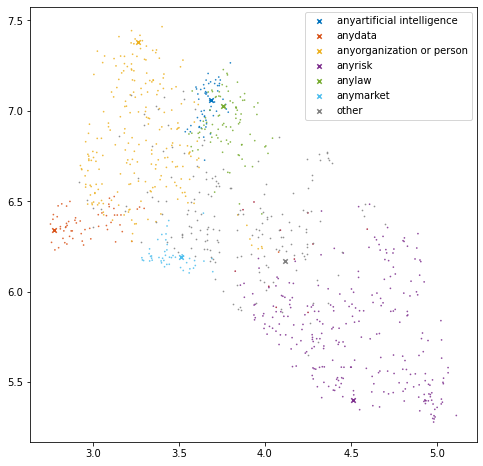

cluster size :
|-anyartificial intelligence : 58
|-anydata : 60
|-anyorganization or person : 223
|-anyrisk : 265
|-anylaw : 89
|-anymarket : 48
|-other : 193
  |-unlabeled terms within 'other': 181
0.36470032


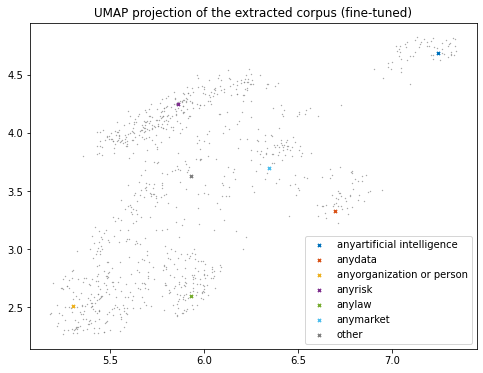

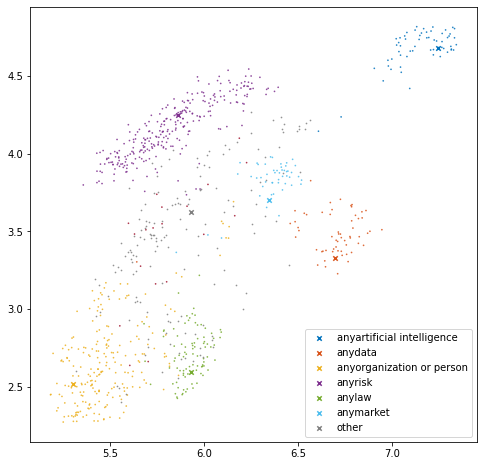

cluster size :
|-anyartificial intelligence : 60
|-anydata : 60
|-anyorganization or person : 223
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 50
|-other : 179
  |-unlabeled terms within 'other': 159
0.41660172


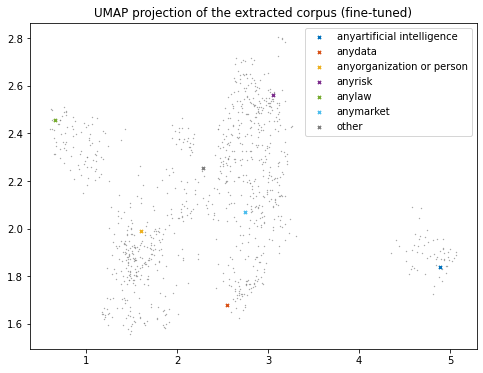

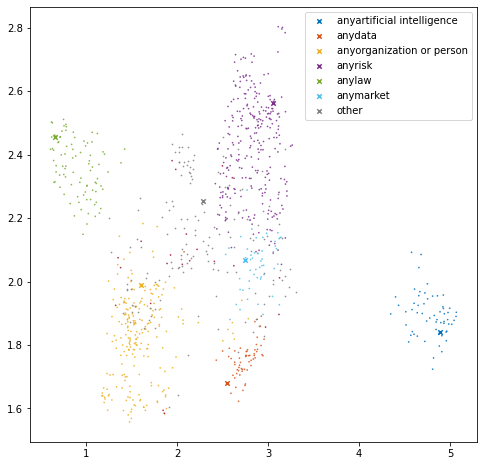

cluster size :
|-anyartificial intelligence : 60
|-anydata : 60
|-anyorganization or person : 223
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 54
|-other : 175
  |-unlabeled terms within 'other': 151
0.38769865


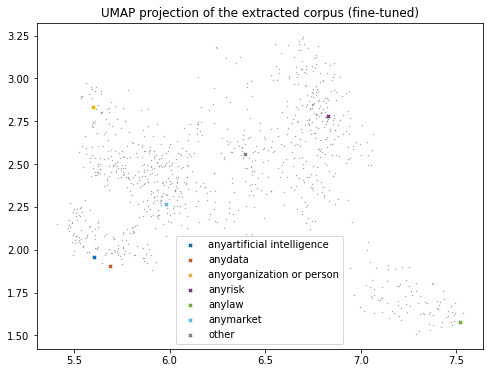

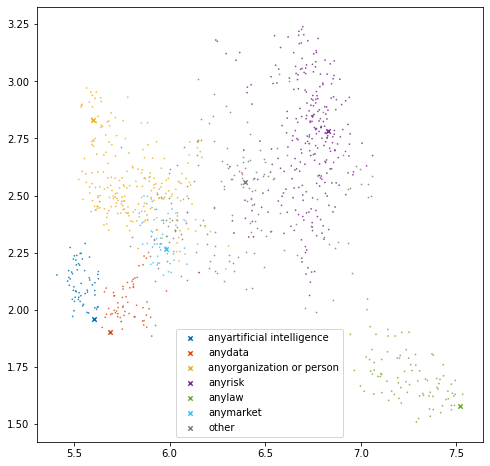

cluster size :
|-anyartificial intelligence : 60
|-anydata : 60
|-anyorganization or person : 229
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 57
|-other : 166
  |-unlabeled terms within 'other': 160
0.399031


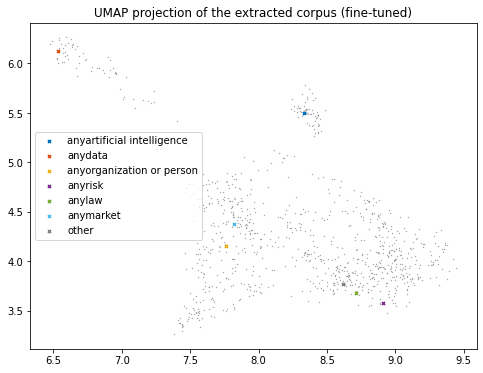

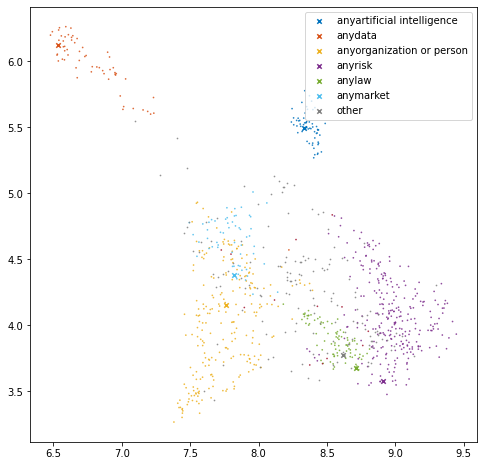

cluster size :
|-anyartificial intelligence : 60
|-anydata : 60
|-anyorganization or person : 229
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 57
|-other : 166
  |-unlabeled terms within 'other': 152
0.43377653


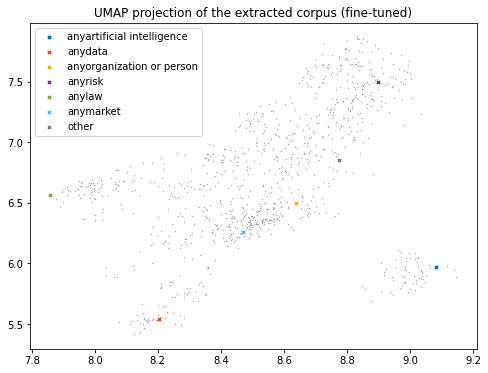

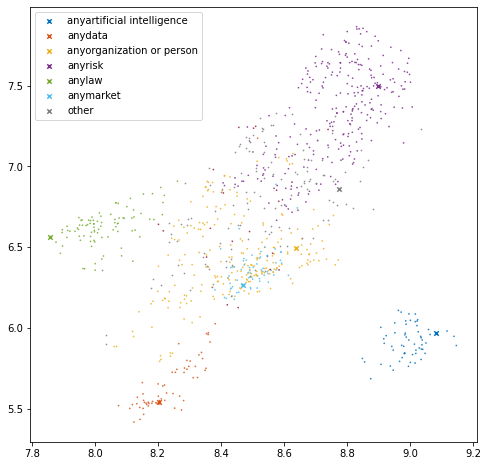

cluster size :
|-anyartificial intelligence : 60
|-anydata : 62
|-anyorganization or person : 229
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 68
|-other : 153
  |-unlabeled terms within 'other': 132
0.44232336


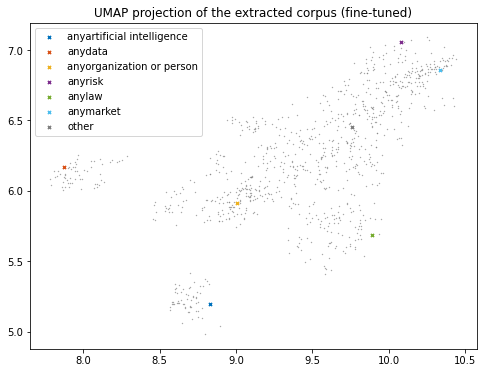

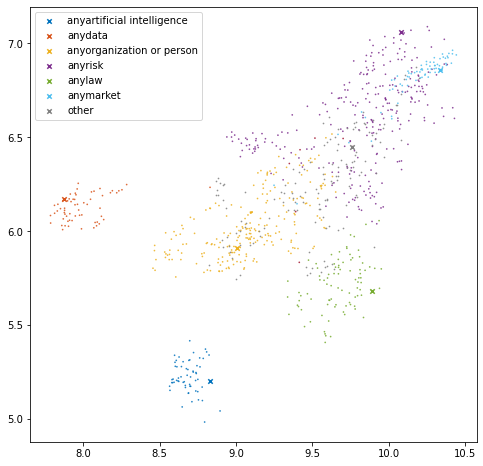

cluster size :
|-anyartificial intelligence : 60
|-anydata : 62
|-anyorganization or person : 229
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 73
|-other : 148
  |-unlabeled terms within 'other': 141
0.4715155


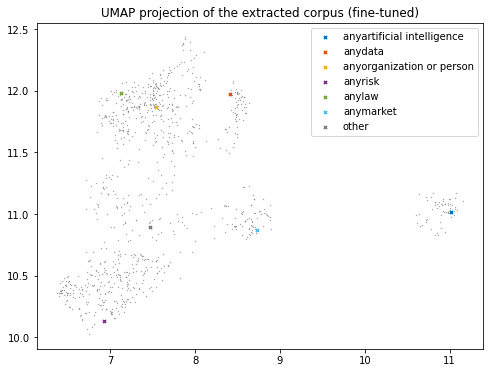

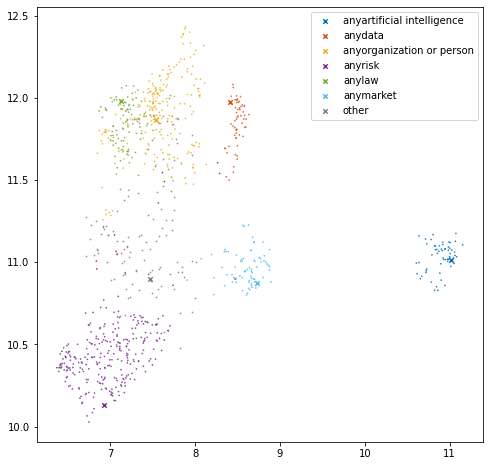

cluster size :
|-anyartificial intelligence : 60
|-anydata : 62
|-anyorganization or person : 237
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 77
|-other : 136
  |-unlabeled terms within 'other': 122
0.48891702


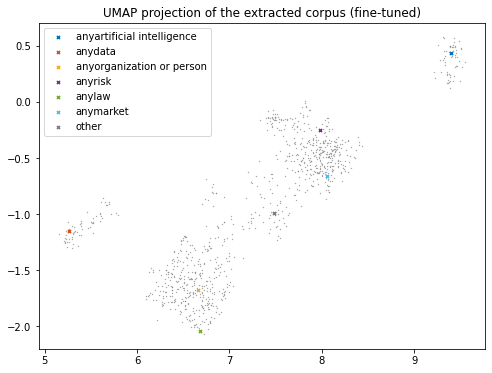

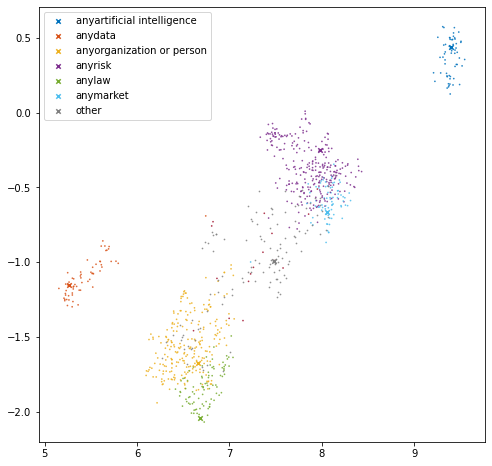

cluster size :
|-anyartificial intelligence : 60
|-anydata : 62
|-anyorganization or person : 237
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 77
|-other : 136
  |-unlabeled terms within 'other': 120
0.48983014


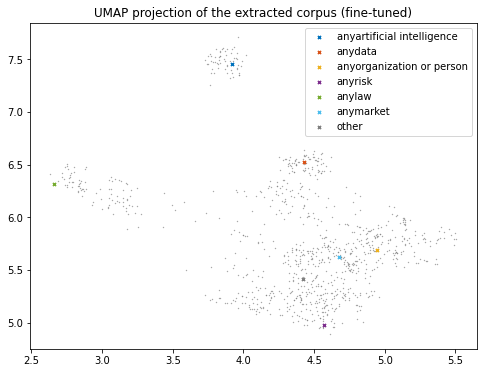

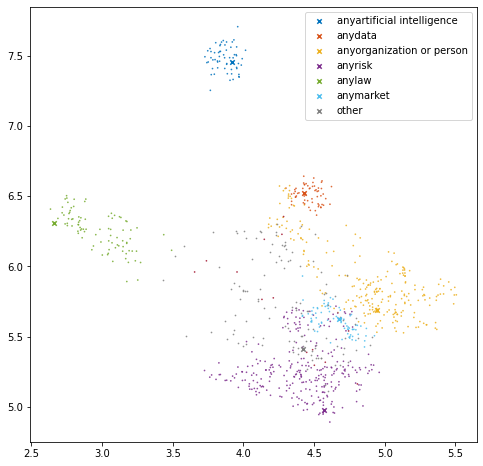

cluster size :
|-anyartificial intelligence : 60
|-anydata : 62
|-anyorganization or person : 237
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 78
|-other : 135
  |-unlabeled terms within 'other': 120
0.48761404


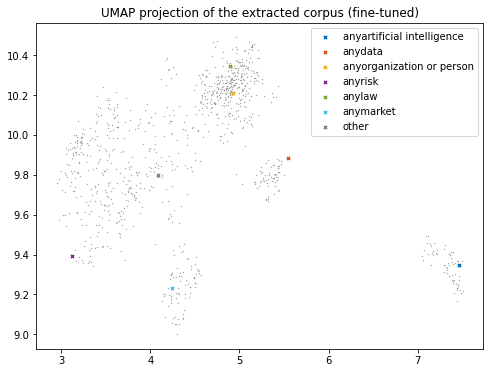

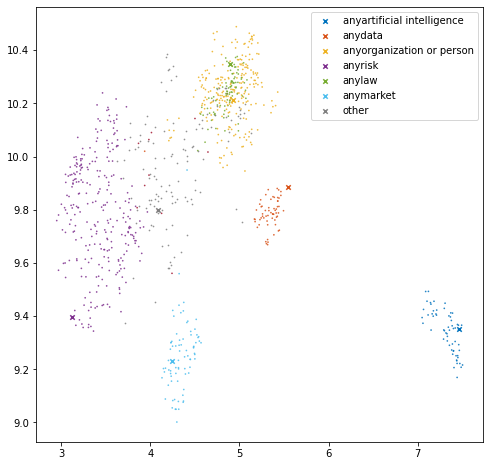

cluster size :
|-anyartificial intelligence : 60
|-anydata : 62
|-anyorganization or person : 237
|-anyrisk : 275
|-anylaw : 89
|-anymarket : 78
|-other : 135
  |-unlabeled terms within 'other': 123
0.42209083


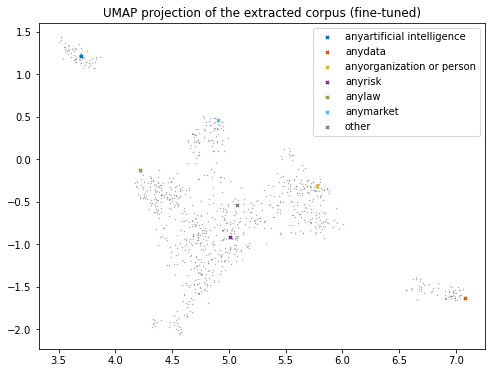

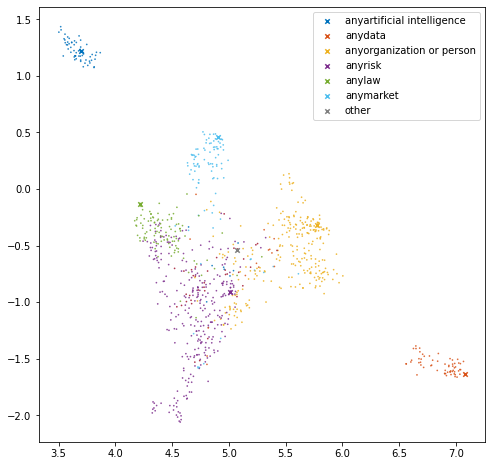

cluster size :
|-anyartificial intelligence : 68
|-anydata : 75
|-anyorganization or person : 260
|-anyrisk : 296
|-anylaw : 103
|-anymarket : 97
|-other : 37
  |-unlabeled terms within 'other': 0


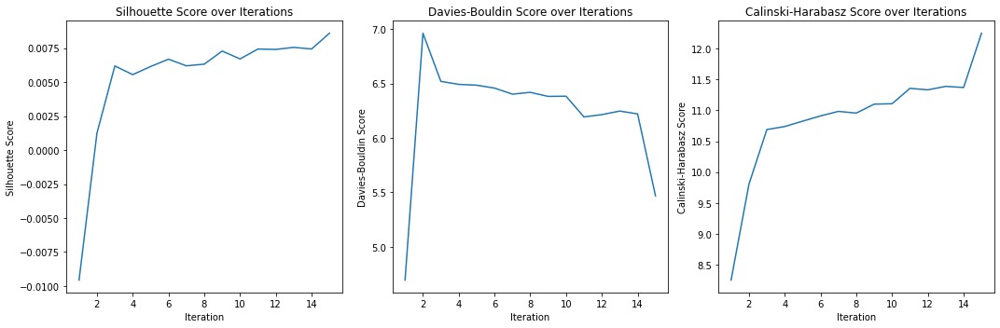

Silhouette : 0.008596484
Davies Bouldin : 5.46702253747008
Calinski Harabasz : 12.250266176191106


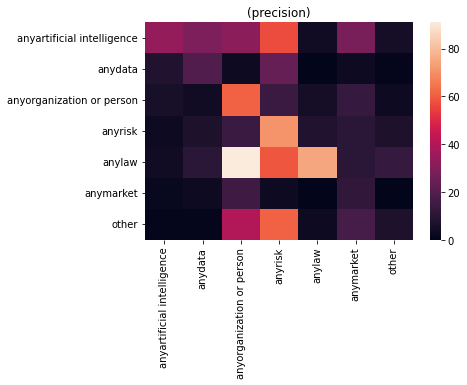

size of predicted terms: 900
Accuracy : 0.31
Precision : 0.4636264303228444
Recall : 0.31
f1 : 0.30428172641459406
                Term                 Prediction                Ground truth
0            europol  anyorganization or person   anyorganization or person
1  uniform condition                     anylaw                      anylaw
2    legislative act                     anylaw                      anylaw
3        distributor                  anymarket   anyorganization or person
4    aviation safety  anyorganization or person  anyartificial intelligence


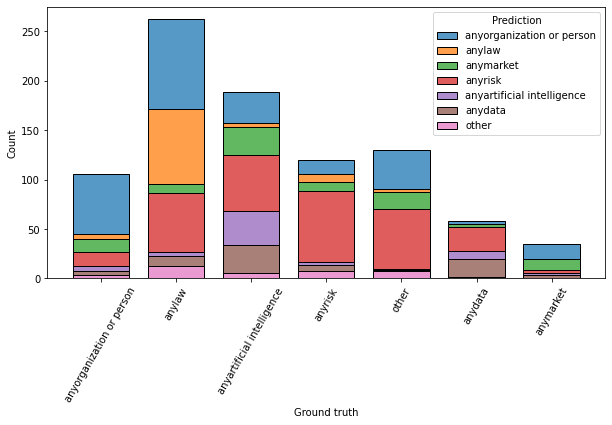


Summary:
    Accuracy  Precision    Recall        F1  Silhouette  Davies Bouldin  \
1   0.330000   0.411231  0.330000  0.347711    0.014187        6.014078   
2   0.345556   0.472414  0.345556  0.368090    0.016059        5.393587   
5   0.323333   0.444040  0.323333  0.317527    0.008540        5.396697   
10  0.310000   0.422950  0.310000  0.298806    0.009098        5.523915   
15  0.310000   0.463626  0.310000  0.304282    0.008596        5.467023   

    Calinski Harabasz  
1           11.418614  
2           11.490847  
5           12.111443  
10          11.668150  
15          12.250266  


In [18]:
_ = run_and_store_results(min_points=4,dimensions=10,prefix="Any")  

## 13. Any {CC}

1 iterations:
['any artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'any data', 'personal data', 'anonymous data', 'any organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'any risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'any law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'any market', 'product', 'service', 'other']
['any artificial intelligence', 'any data', 'any organization or person', 'any risk', 'any law', 'any market', 'other']
unique terms:  900
cannot links:21
must links:30
0.0945857


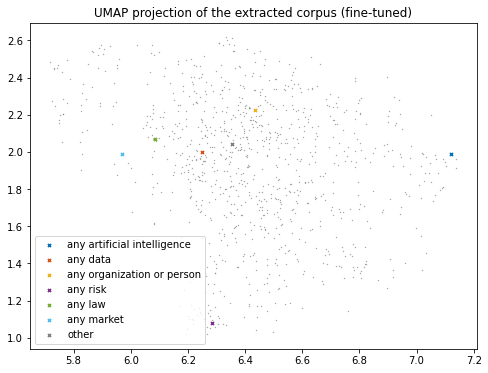

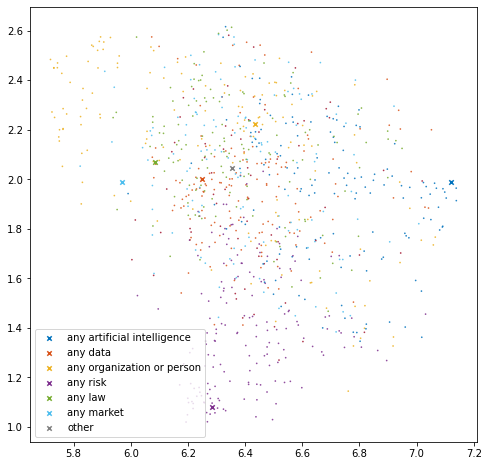

cluster size :
|-any artificial intelligence : 142
|-any data : 158
|-any organization or person : 145
|-any risk : 165
|-any law : 134
|-any market : 125
|-other : 67
  |-unlabeled terms within 'other': 0


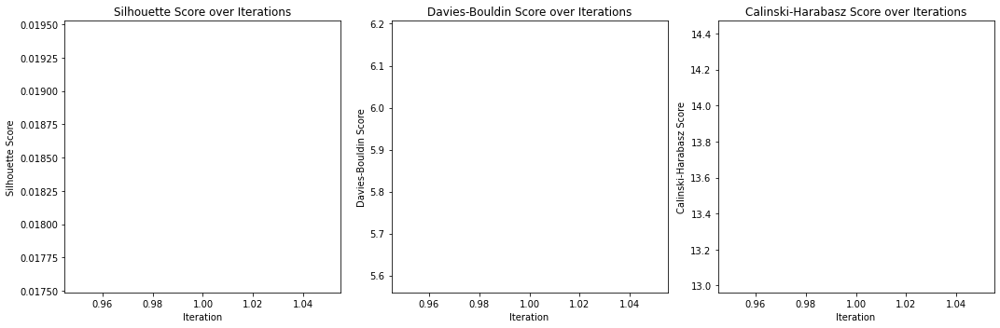

Silhouette : 0.018506853
Davies Bouldin : 5.8832586639560995
Calinski Harabasz : 13.716189558968168


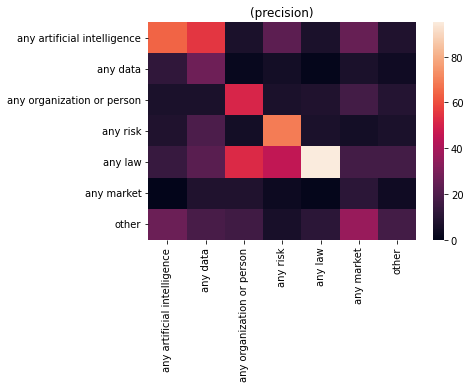

size of predicted terms: 900
Accuracy : 0.3711111111111111
Precision : 0.46814325226100534
Recall : 0.3711111111111111
f1 : 0.38683403862194665
                Term                  Prediction                 Ground truth
0            europol  any organization or person   any organization or person
1  uniform condition                     any law                      any law
2    legislative act                     any law                      any law
3        distributor                  any market   any organization or person
4    aviation safety                    any risk  any artificial intelligence


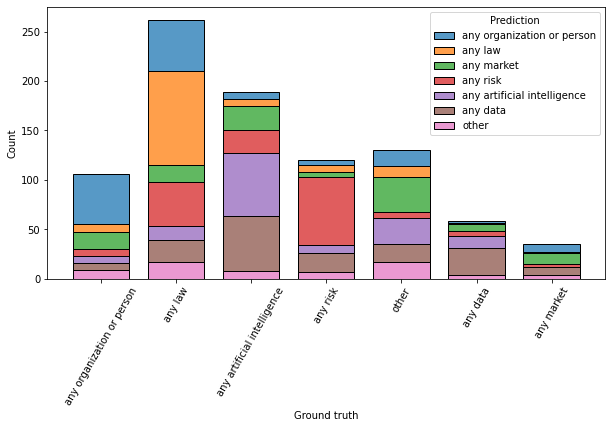

2 iterations:
['any artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'any data', 'personal data', 'anonymous data', 'any organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'any risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'any law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'any market', 'product', 'service', 'other']
['any artificial intelligence', 'any data', 'any organization or person', 'any risk', 'any law', 'any market', 'other']
unique terms:  900
cannot links:21
must links:30
0.032776542


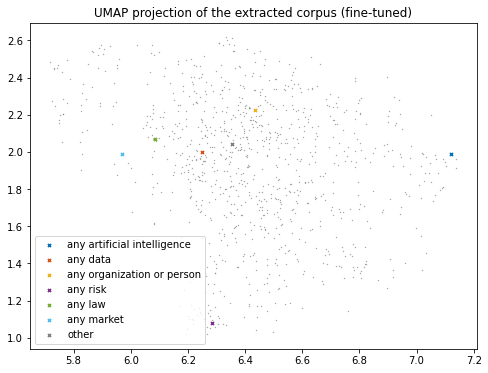

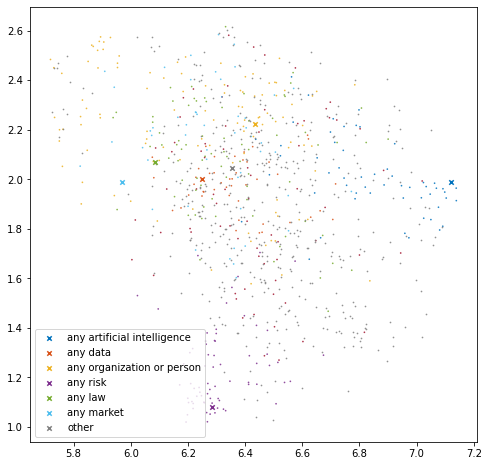

cluster size :
|-any artificial intelligence : 56
|-any data : 46
|-any organization or person : 110
|-any risk : 71
|-any law : 77
|-any market : 52
|-other : 524
  |-unlabeled terms within 'other': 452
0.18770084


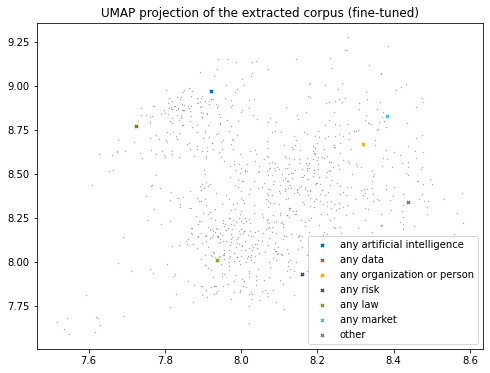

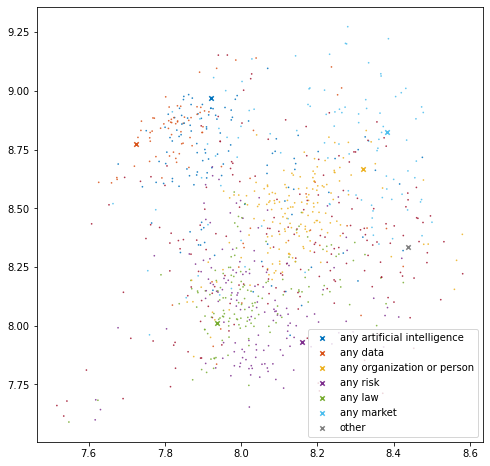

cluster size :
|-any artificial intelligence : 116
|-any data : 88
|-any organization or person : 163
|-any risk : 143
|-any law : 138
|-any market : 103
|-other : 185
  |-unlabeled terms within 'other': 0


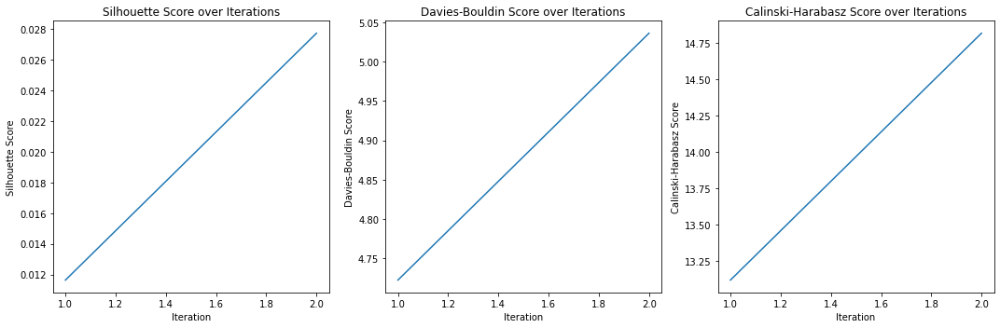

Silhouette : 0.027740164
Davies Bouldin : 5.036277410311723
Calinski Harabasz : 14.818322589302507


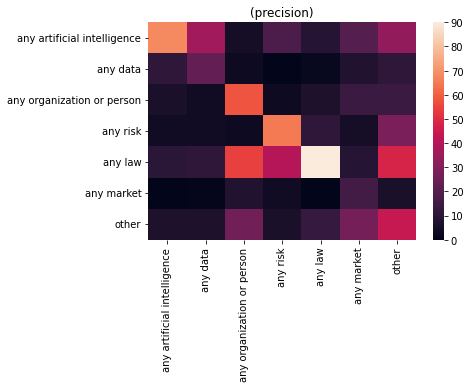

size of predicted terms: 900
Accuracy : 0.40444444444444444
Precision : 0.4984988595397483
Recall : 0.40444444444444444
f1 : 0.4198189936944981
                Term                  Prediction                 Ground truth
0            europol  any organization or person   any organization or person
1  uniform condition                     any law                      any law
2    legislative act                     any law                      any law
3        distributor                  any market   any organization or person
4    aviation safety                    any risk  any artificial intelligence


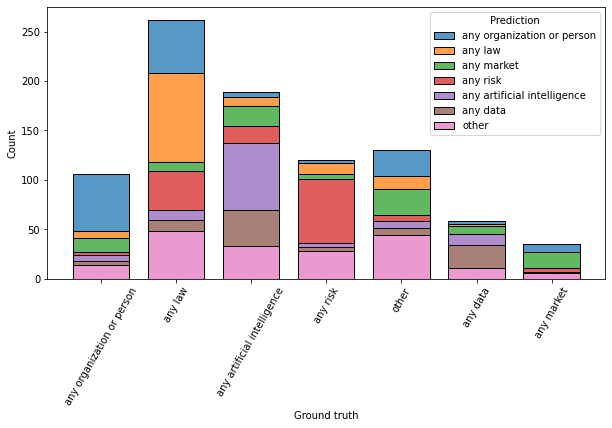

5 iterations:
['any artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'any data', 'personal data', 'anonymous data', 'any organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'any risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'any law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'any market', 'product', 'service', 'other']
['any artificial intelligence', 'any data', 'any organization or person', 'any risk', 'any law', 'any market', 'other']
unique terms:  900
cannot links:21
must links:30
0.032776542


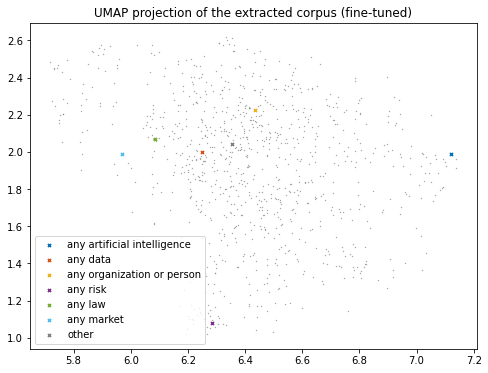

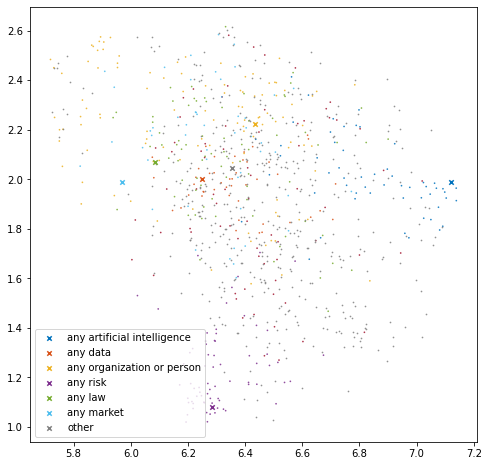

cluster size :
|-any artificial intelligence : 56
|-any data : 46
|-any organization or person : 110
|-any risk : 71
|-any law : 77
|-any market : 52
|-other : 524
  |-unlabeled terms within 'other': 452
0.1968318


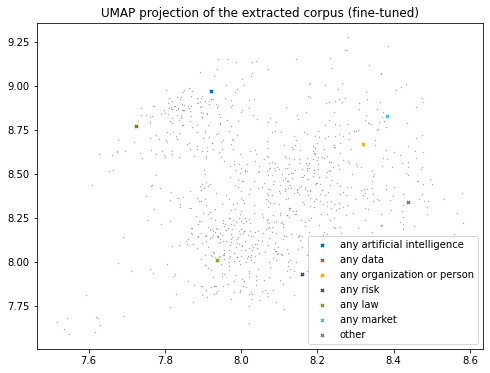

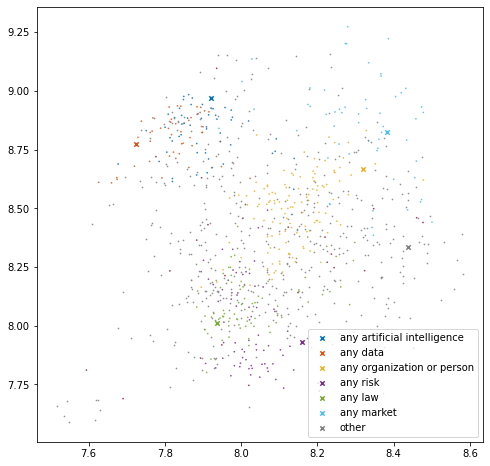

cluster size :
|-any artificial intelligence : 56
|-any data : 46
|-any organization or person : 127
|-any risk : 71
|-any law : 77
|-any market : 56
|-other : 503
  |-unlabeled terms within 'other': 476
0.20346357


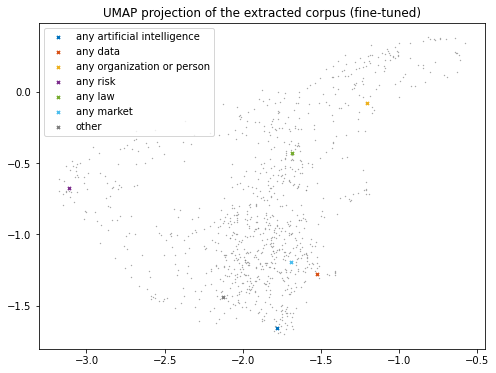

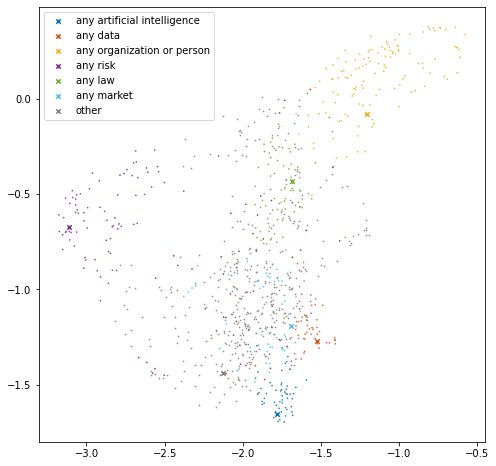

cluster size :
|-any artificial intelligence : 56
|-any data : 49
|-any organization or person : 130
|-any risk : 76
|-any law : 77
|-any market : 63
|-other : 485
  |-unlabeled terms within 'other': 434
0.25220636


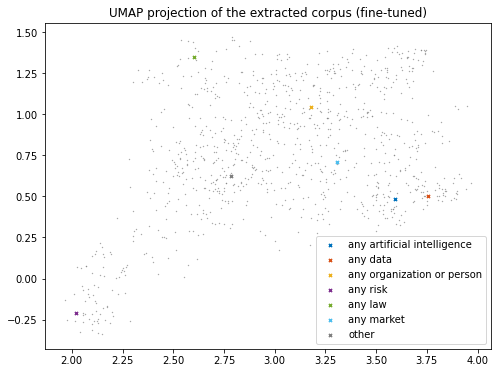

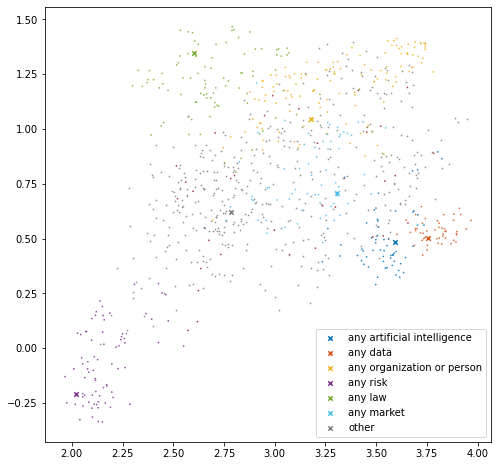

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 133
|-any risk : 76
|-any law : 91
|-any market : 68
|-other : 459
  |-unlabeled terms within 'other': 425
0.23297566


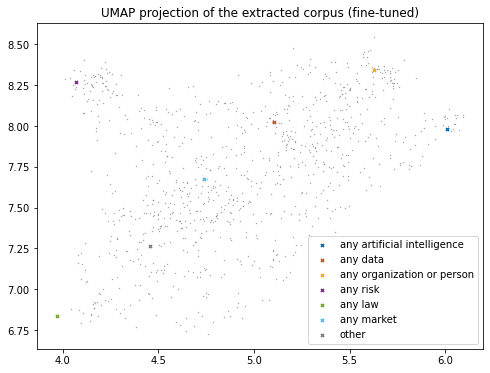

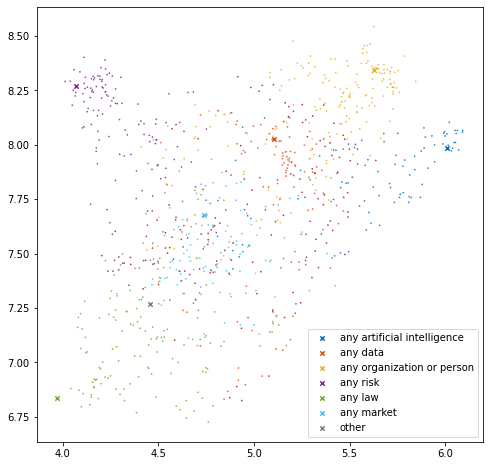

cluster size :
|-any artificial intelligence : 105
|-any data : 113
|-any organization or person : 189
|-any risk : 127
|-any law : 149
|-any market : 113
|-other : 140
  |-unlabeled terms within 'other': 0


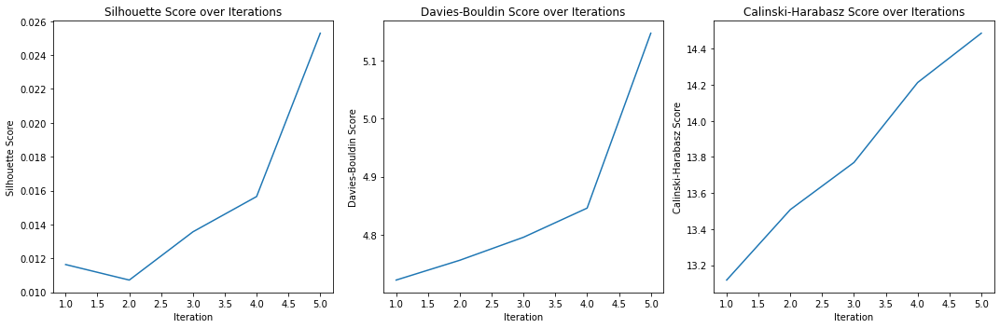

Silhouette : 0.025292609
Davies Bouldin : 5.146559457149322
Calinski Harabasz : 14.486670971793025


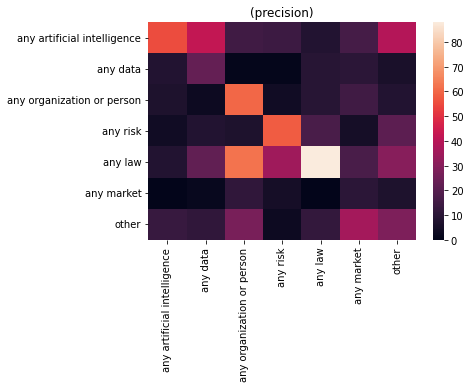

size of predicted terms: 900
Accuracy : 0.35777777777777775
Precision : 0.44980221975005114
Recall : 0.35777777777777775
f1 : 0.37420682965741486
                Term                  Prediction                 Ground truth
0            europol  any organization or person   any organization or person
1  uniform condition                     any law                      any law
2    legislative act                     any law                      any law
3        distributor                  any market   any organization or person
4    aviation safety                    any risk  any artificial intelligence


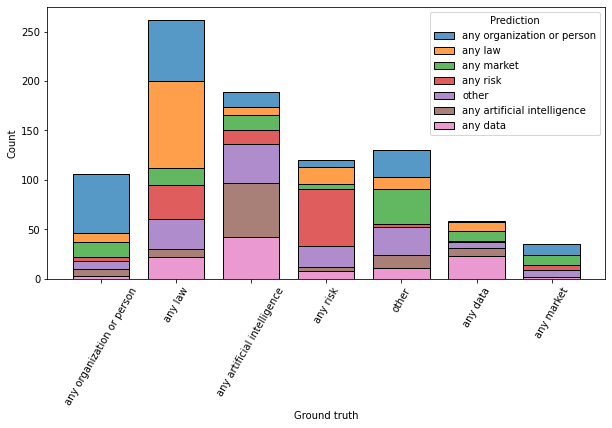

10 iterations:
['any artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'any data', 'personal data', 'anonymous data', 'any organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'any risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'any law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'any market', 'product', 'service', 'other']
['any artificial intelligence', 'any data', 'any organization or person', 'any risk', 'any law', 'any market', 'other']
unique terms:  900
cannot links:21
must links:30
0.032776542


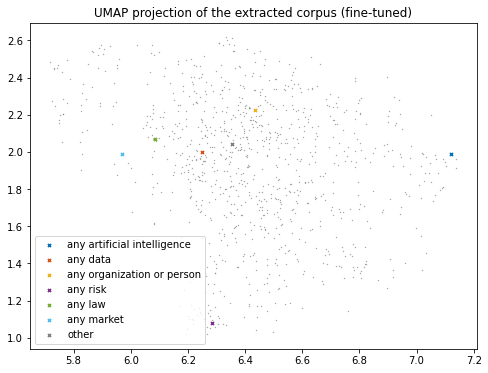

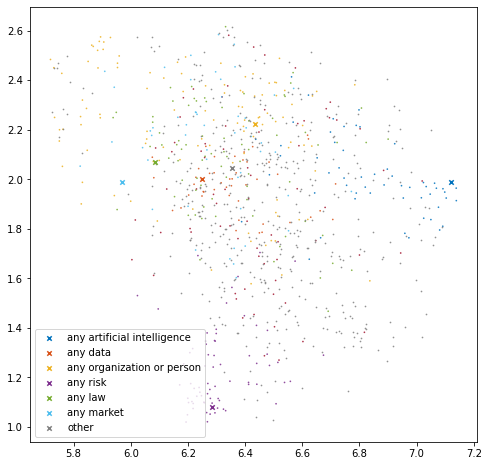

cluster size :
|-any artificial intelligence : 56
|-any data : 46
|-any organization or person : 110
|-any risk : 71
|-any law : 77
|-any market : 52
|-other : 524
  |-unlabeled terms within 'other': 452
0.1968318


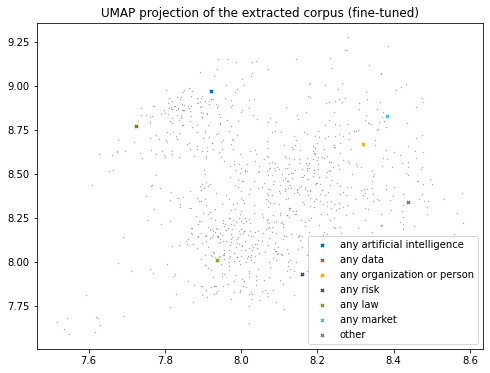

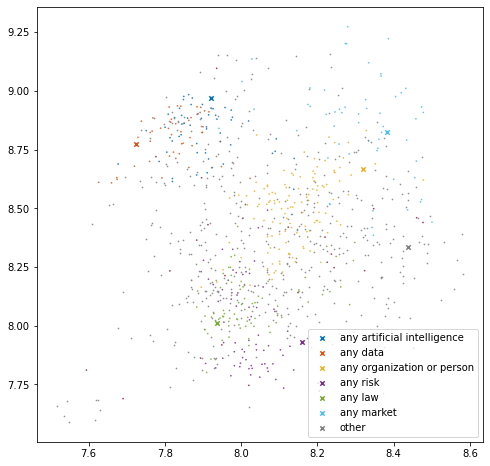

cluster size :
|-any artificial intelligence : 56
|-any data : 46
|-any organization or person : 127
|-any risk : 71
|-any law : 77
|-any market : 56
|-other : 503
  |-unlabeled terms within 'other': 476
0.20346357


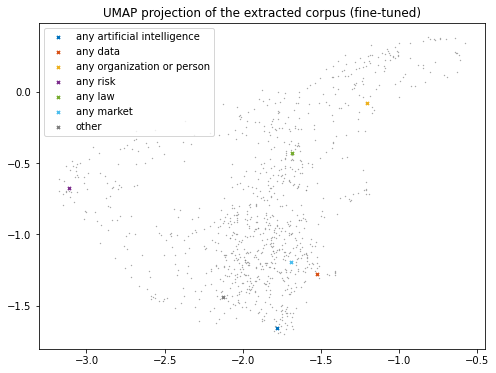

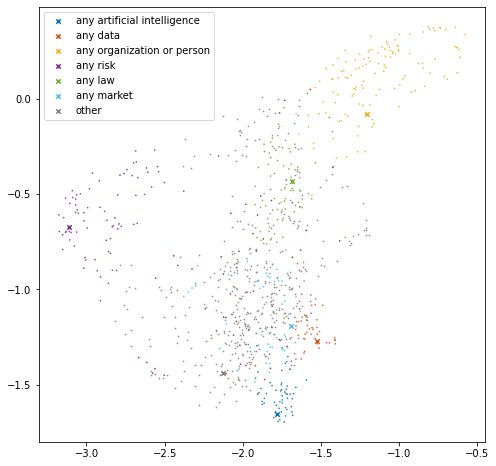

cluster size :
|-any artificial intelligence : 56
|-any data : 49
|-any organization or person : 130
|-any risk : 76
|-any law : 77
|-any market : 63
|-other : 485
  |-unlabeled terms within 'other': 434
0.25220636


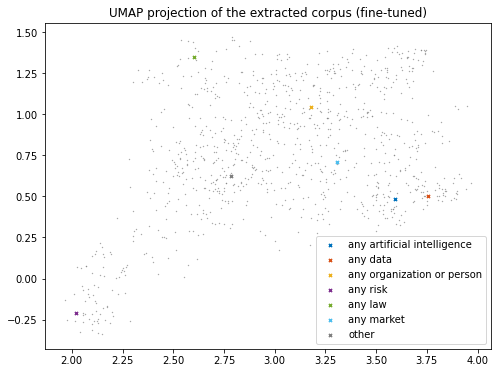

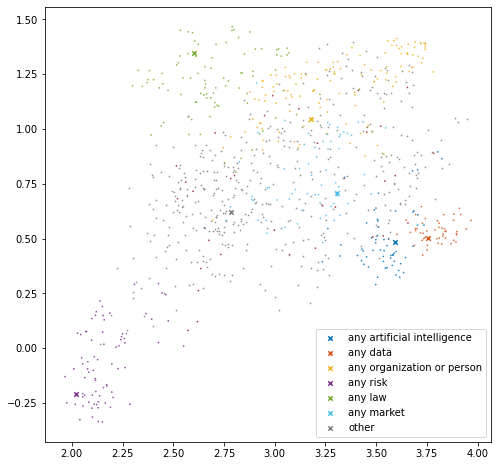

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 133
|-any risk : 76
|-any law : 91
|-any market : 68
|-other : 459
  |-unlabeled terms within 'other': 425
0.25858444


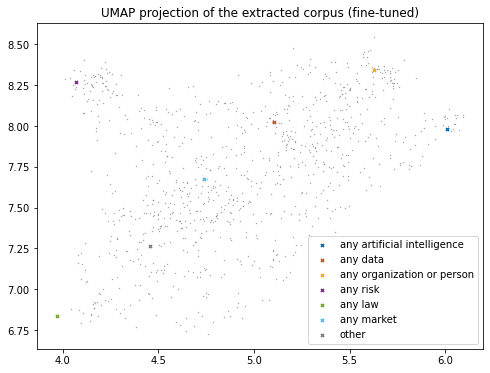

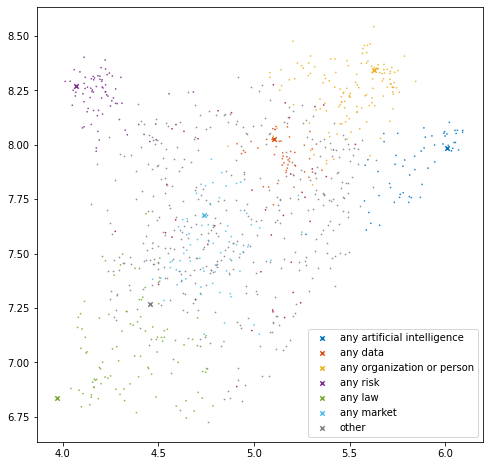

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 137
|-any risk : 76
|-any law : 97
|-any market : 77
|-other : 440
  |-unlabeled terms within 'other': 398
0.2725486


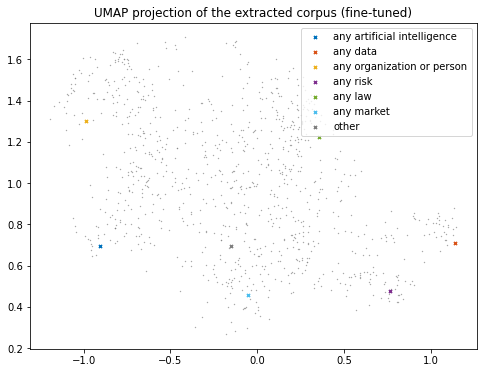

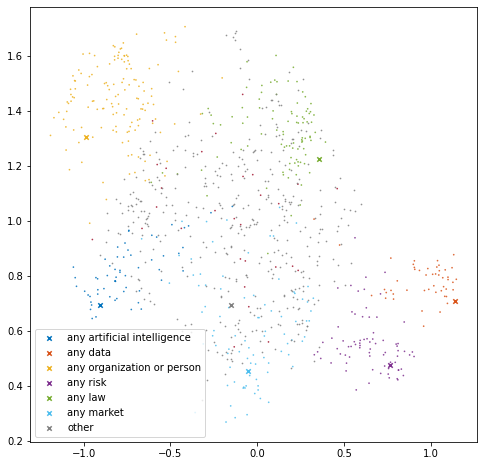

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 139
|-any risk : 76
|-any law : 97
|-any market : 88
|-other : 427
  |-unlabeled terms within 'other': 397
0.2967357


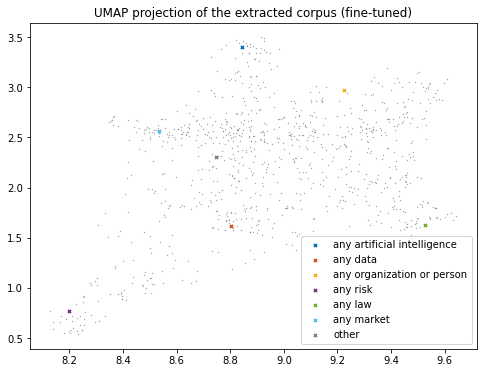

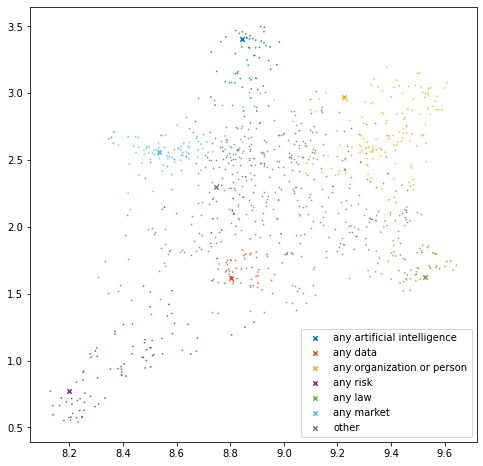

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 139
|-any risk : 83
|-any law : 97
|-any market : 88
|-other : 420
  |-unlabeled terms within 'other': 398
0.2889281


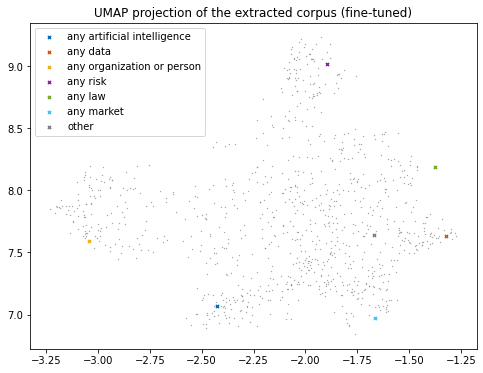

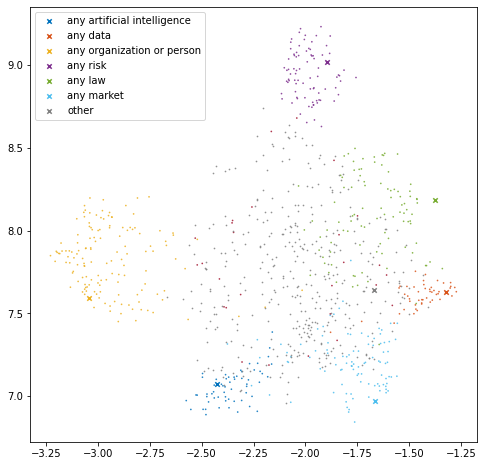

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 142
|-any risk : 83
|-any law : 97
|-any market : 100
|-other : 405
  |-unlabeled terms within 'other': 377
0.31064704


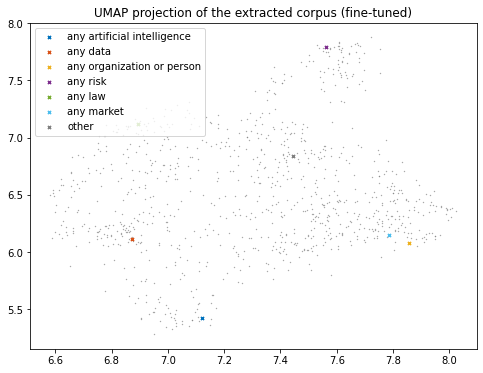

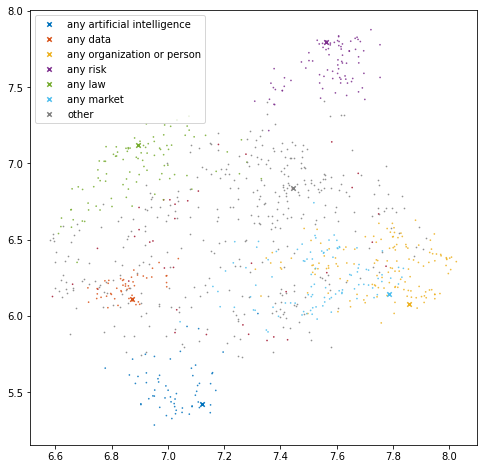

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 143
|-any risk : 83
|-any law : 97
|-any market : 100
|-other : 404
  |-unlabeled terms within 'other': 366
0.27822974


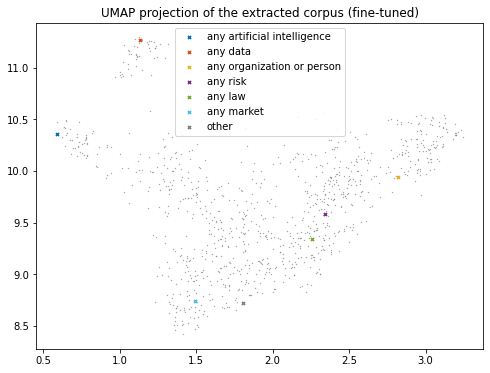

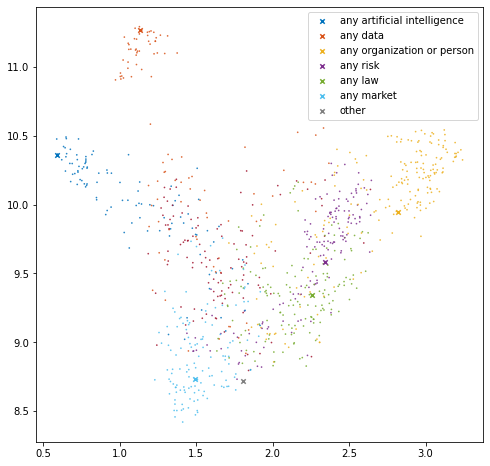

cluster size :
|-any artificial intelligence : 103
|-any data : 104
|-any organization or person : 198
|-any risk : 143
|-any law : 151
|-any market : 127
|-other : 110
  |-unlabeled terms within 'other': 0


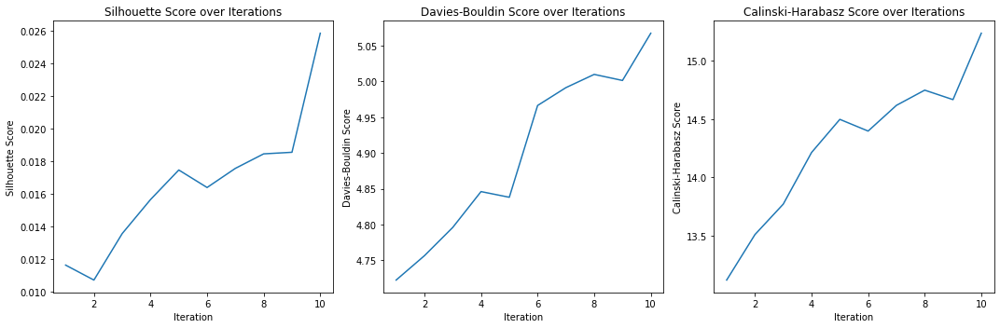

Silhouette : 0.02584122
Davies Bouldin : 5.067339741700807
Calinski Harabasz : 15.238102787265063


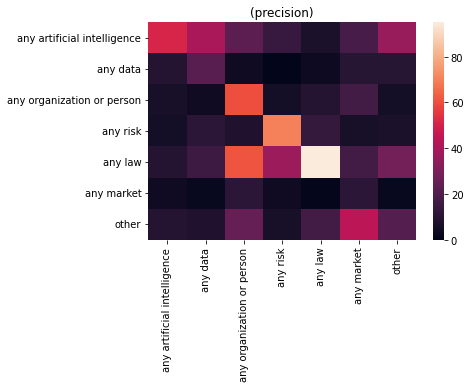

size of predicted terms: 900
Accuracy : 0.36666666666666664
Precision : 0.4565286626316481
Recall : 0.36666666666666664
f1 : 0.38072161577963215
                Term                  Prediction                 Ground truth
0            europol  any organization or person   any organization or person
1  uniform condition                     any law                      any law
2    legislative act                     any law                      any law
3        distributor                  any market   any organization or person
4    aviation safety                    any risk  any artificial intelligence


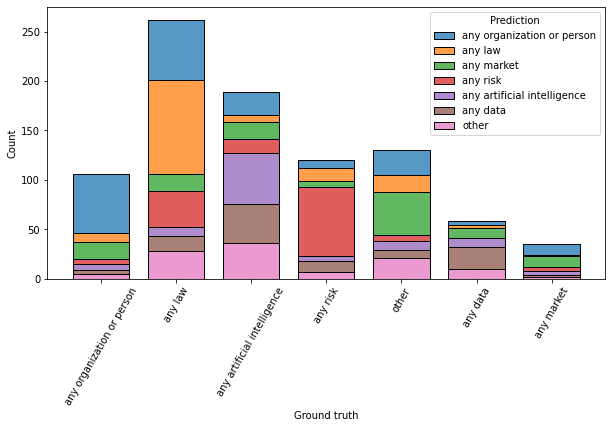

15 iterations:
['any artificial intelligence', 'ai domain', 'ai system', 'no risk ai system', 'high risk ai system', 'low risk ai system', 'ai system properties', 'ai system development process', 'ai system approach', 'ai system quality measure', 'any data', 'personal data', 'anonymous data', 'any organization or person', 'provider', 'user', 'affected entity', 'regulator', 'eu country', 'any risk', 'data risk', 'poisoning risk', 'system risk', 'terrorist attack risk', 'risk management', 'any law', 'regulation', 'right', 'rule', 'requirement', 'obligation', 'law text', 'authority', 'any market', 'product', 'service', 'other']
['any artificial intelligence', 'any data', 'any organization or person', 'any risk', 'any law', 'any market', 'other']
unique terms:  900
cannot links:21
must links:30
0.032776542


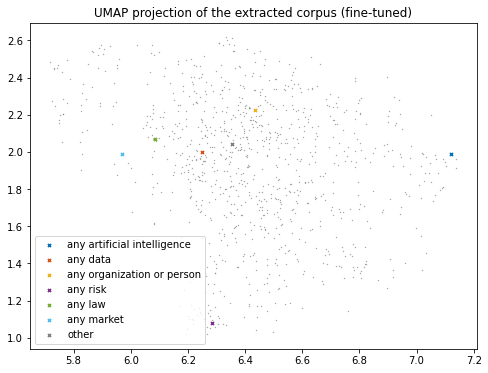

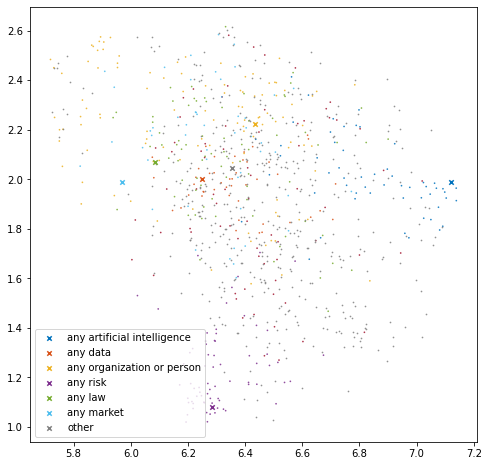

cluster size :
|-any artificial intelligence : 56
|-any data : 46
|-any organization or person : 110
|-any risk : 71
|-any law : 77
|-any market : 52
|-other : 524
  |-unlabeled terms within 'other': 452
0.1968318


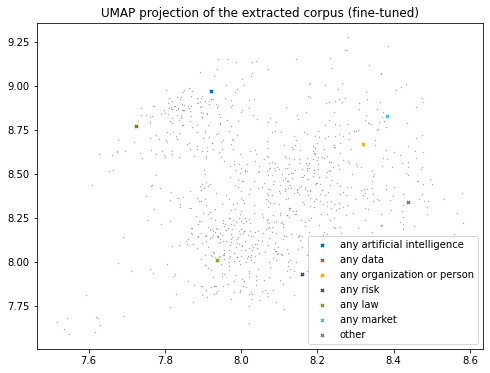

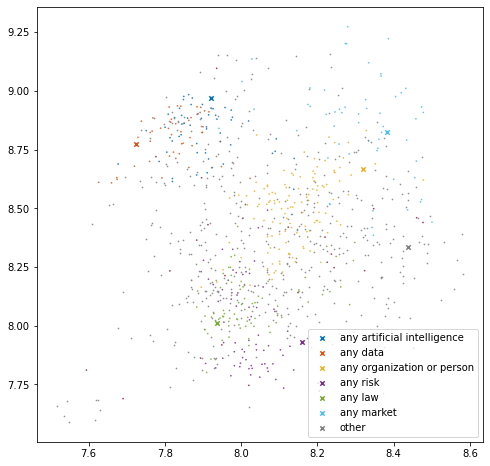

cluster size :
|-any artificial intelligence : 56
|-any data : 46
|-any organization or person : 127
|-any risk : 71
|-any law : 77
|-any market : 56
|-other : 503
  |-unlabeled terms within 'other': 476
0.20346357


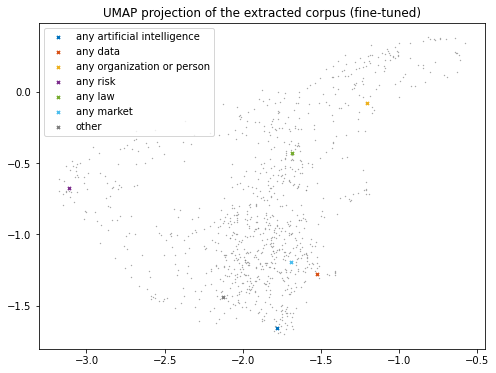

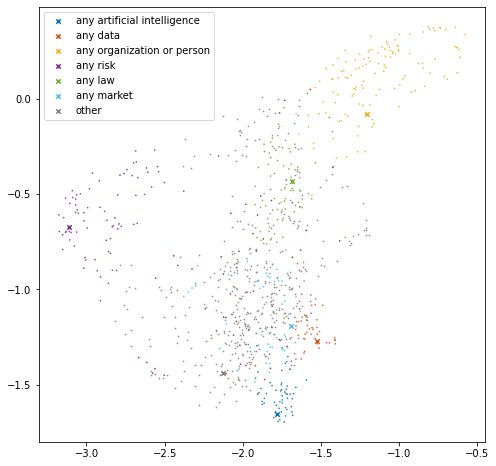

cluster size :
|-any artificial intelligence : 56
|-any data : 49
|-any organization or person : 130
|-any risk : 76
|-any law : 77
|-any market : 63
|-other : 485
  |-unlabeled terms within 'other': 434
0.25220636


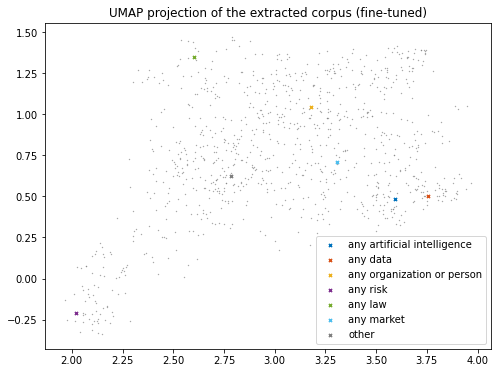

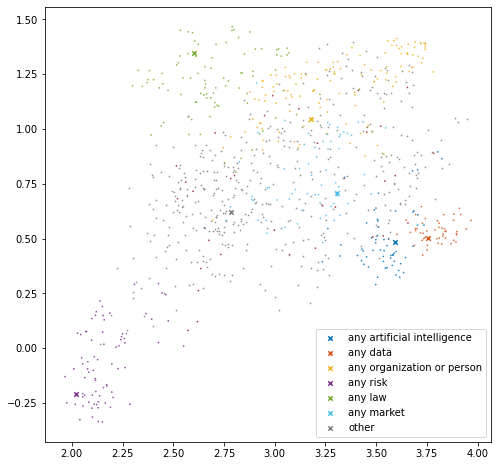

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 133
|-any risk : 76
|-any law : 91
|-any market : 68
|-other : 459
  |-unlabeled terms within 'other': 425
0.25858444


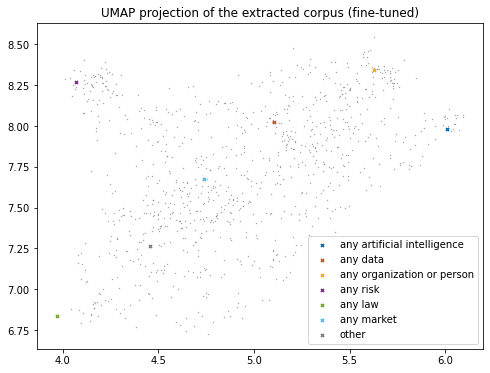

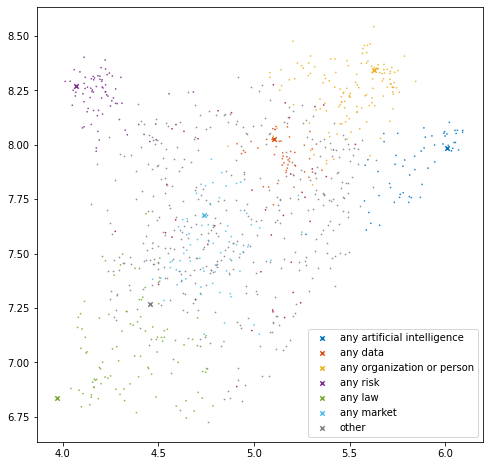

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 137
|-any risk : 76
|-any law : 97
|-any market : 77
|-other : 440
  |-unlabeled terms within 'other': 398
0.2725486


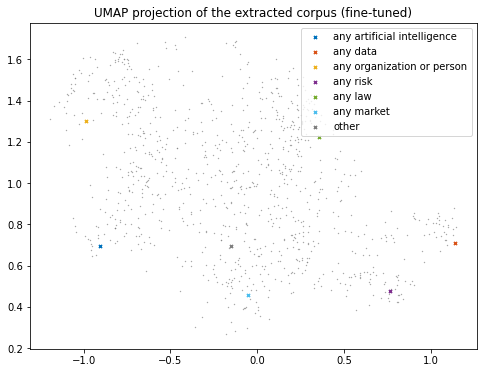

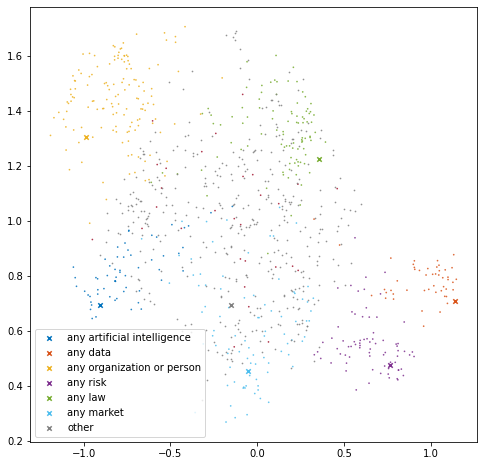

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 139
|-any risk : 76
|-any law : 97
|-any market : 88
|-other : 427
  |-unlabeled terms within 'other': 397
0.2967357


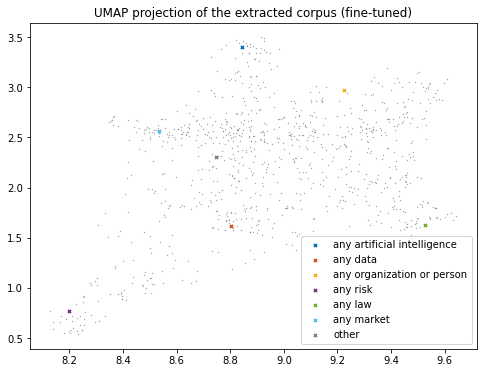

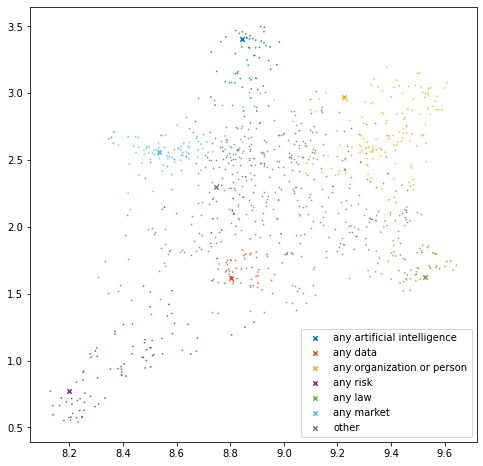

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 139
|-any risk : 83
|-any law : 97
|-any market : 88
|-other : 420
  |-unlabeled terms within 'other': 398
0.2889281


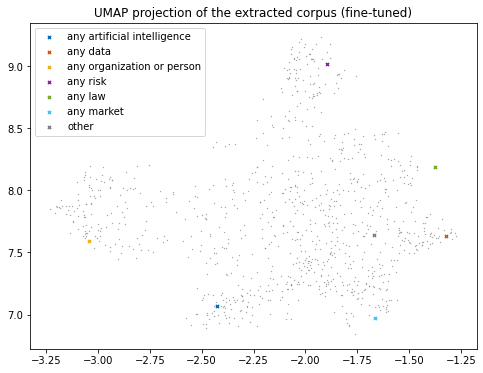

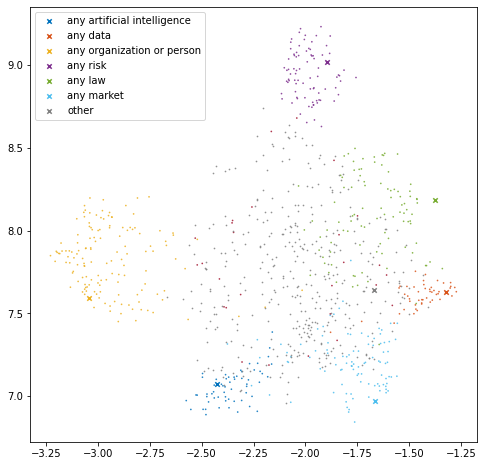

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 142
|-any risk : 83
|-any law : 97
|-any market : 100
|-other : 405
  |-unlabeled terms within 'other': 377
0.31064704


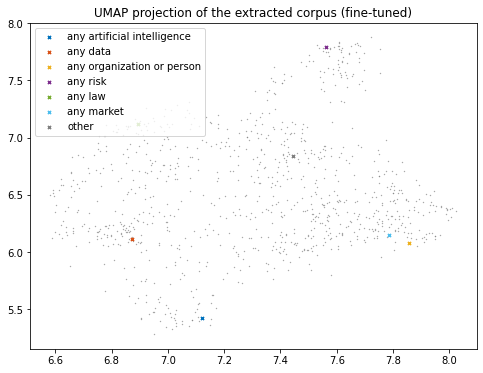

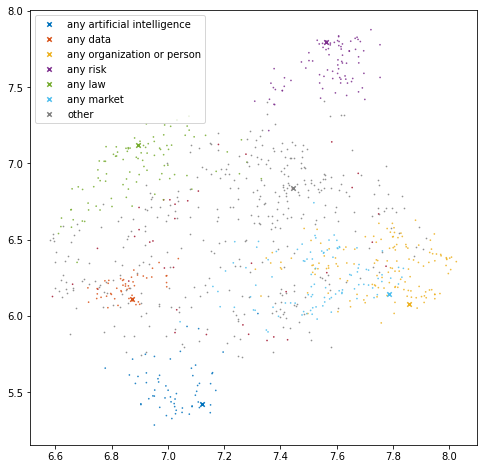

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 143
|-any risk : 83
|-any law : 97
|-any market : 100
|-other : 404
  |-unlabeled terms within 'other': 366
0.30914417


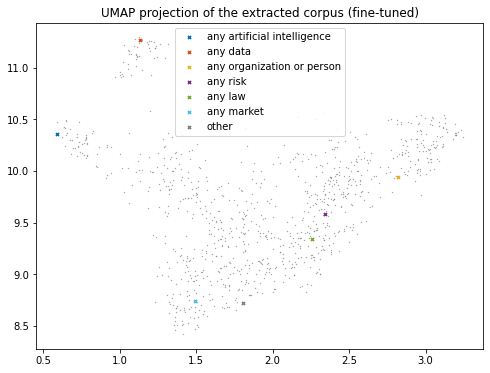

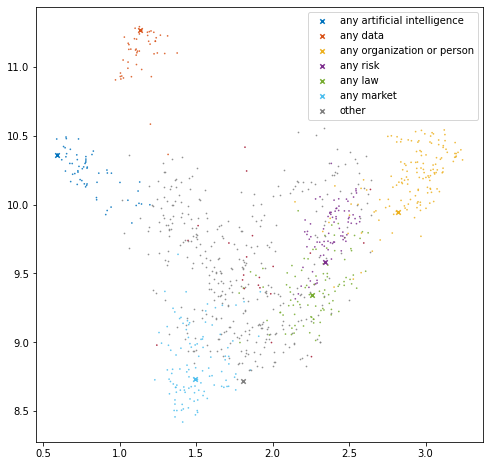

cluster size :
|-any artificial intelligence : 60
|-any data : 49
|-any organization or person : 145
|-any risk : 83
|-any law : 97
|-any market : 111
|-other : 391
  |-unlabeled terms within 'other': 369
0.30522546


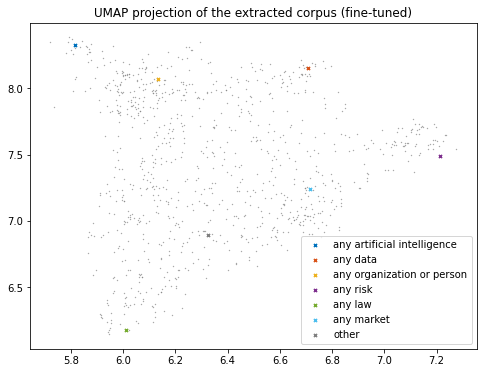

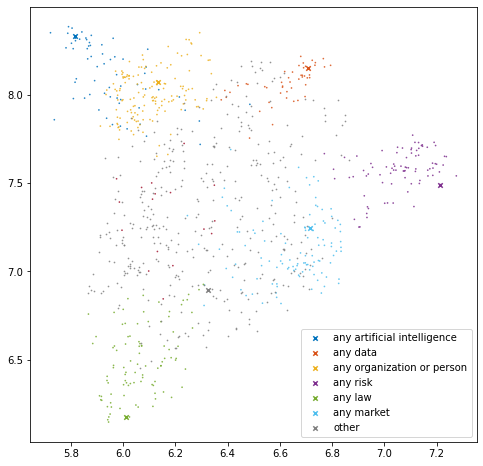

cluster size :
|-any artificial intelligence : 63
|-any data : 49
|-any organization or person : 146
|-any risk : 83
|-any law : 97
|-any market : 111
|-other : 387
  |-unlabeled terms within 'other': 369
0.3225841


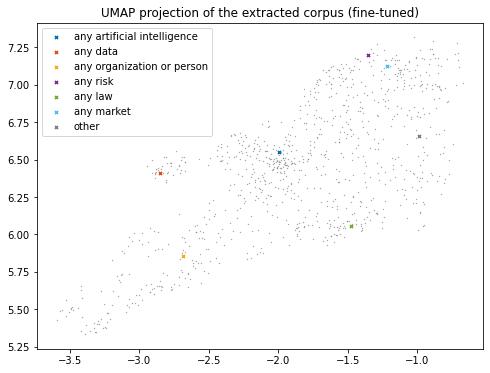

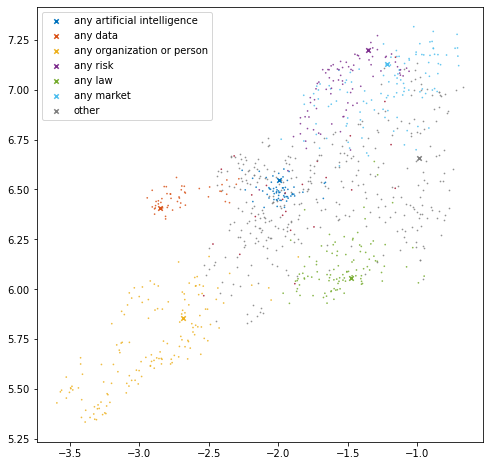

cluster size :
|-any artificial intelligence : 63
|-any data : 49
|-any organization or person : 146
|-any risk : 84
|-any law : 104
|-any market : 116
|-other : 374
  |-unlabeled terms within 'other': 349
0.3371728


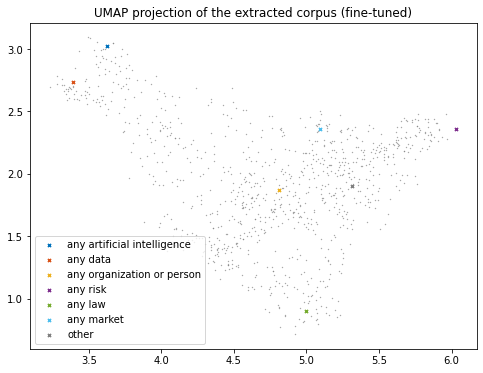

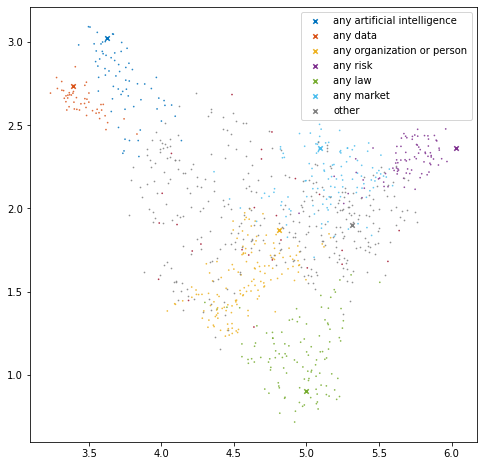

cluster size :
|-any artificial intelligence : 68
|-any data : 49
|-any organization or person : 147
|-any risk : 85
|-any law : 113
|-any market : 116
|-other : 358
  |-unlabeled terms within 'other': 331
0.3538602


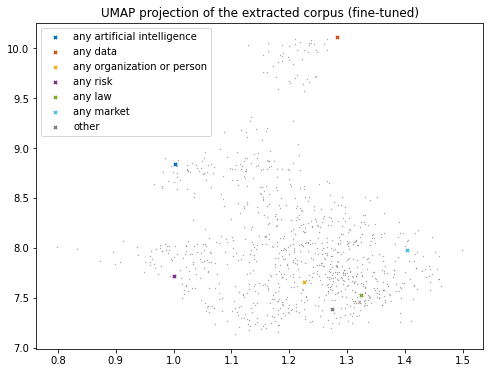

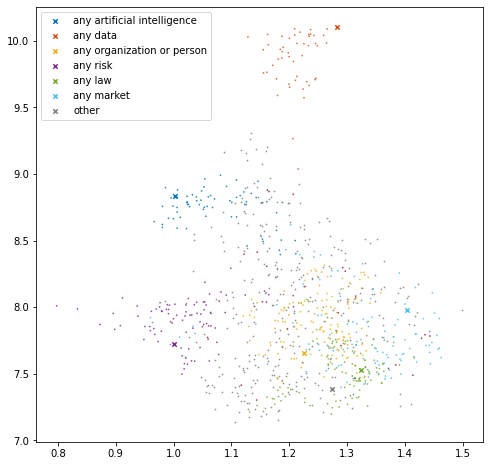

cluster size :
|-any artificial intelligence : 68
|-any data : 49
|-any organization or person : 147
|-any risk : 85
|-any law : 113
|-any market : 119
|-other : 355
  |-unlabeled terms within 'other': 325
0.3235064


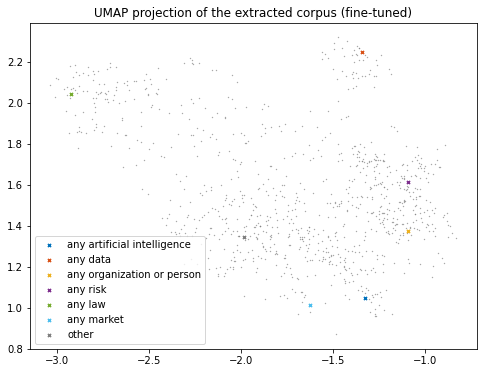

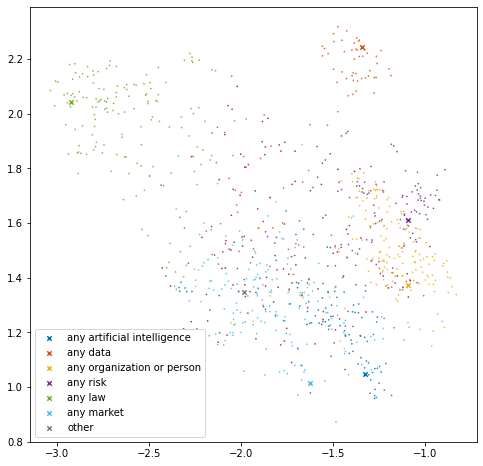

cluster size :
|-any artificial intelligence : 116
|-any data : 102
|-any organization or person : 174
|-any risk : 116
|-any law : 152
|-any market : 168
|-other : 108
  |-unlabeled terms within 'other': 0


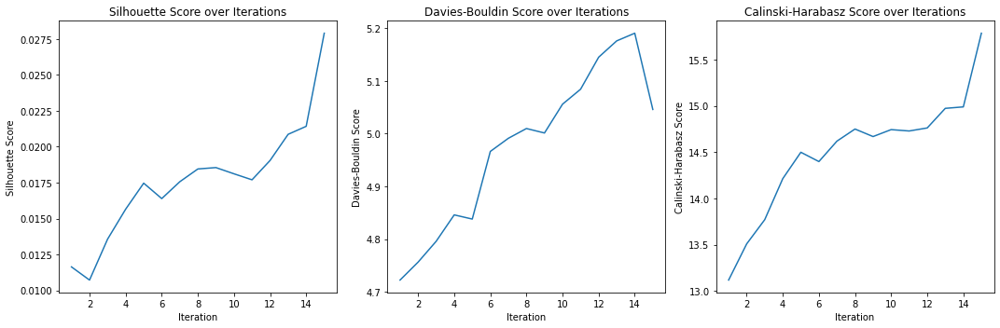

Silhouette : 0.027897444
Davies Bouldin : 5.04595794948517
Calinski Harabasz : 15.783969693944963


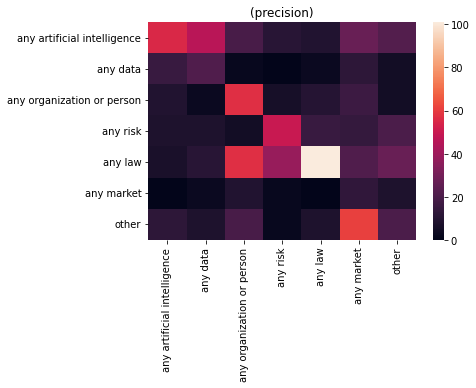

size of predicted terms: 900
Accuracy : 0.3522222222222222
Precision : 0.4550846955741074
Recall : 0.3522222222222222
f1 : 0.3762507924024962
                Term                  Prediction                 Ground truth
0            europol  any organization or person   any organization or person
1  uniform condition                     any law                      any law
2    legislative act                     any law                      any law
3        distributor                  any market   any organization or person
4    aviation safety                    any risk  any artificial intelligence


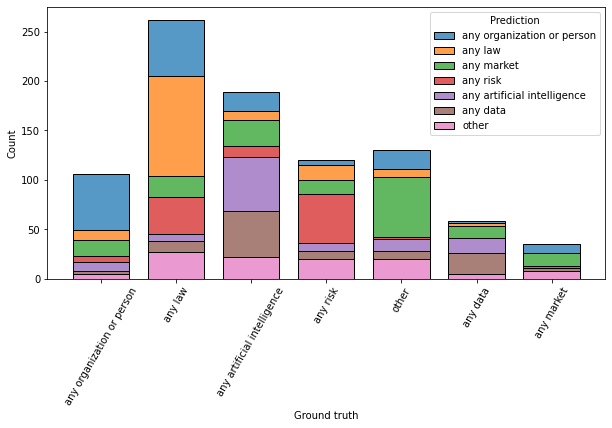


Summary:
    Accuracy  Precision    Recall        F1  Silhouette  Davies Bouldin  \
1   0.371111   0.468143  0.371111  0.386834    0.018507        5.883259   
2   0.404444   0.498499  0.404444  0.419819    0.027740        5.036277   
5   0.357778   0.449802  0.357778  0.374207    0.025293        5.146559   
10  0.366667   0.456529  0.366667  0.380722    0.025841        5.067340   
15  0.352222   0.455085  0.352222  0.376251    0.027897        5.045958   

    Calinski Harabasz  
1           13.716190  
2           14.818323  
5           14.486671  
10          15.238103  
15          15.783970  


In [19]:
_ = run_and_store_results(min_points=4,dimensions=10,prefix="Any ")  

# Corpus：CS (2560 terms)

In [25]:
## core ontology of cs corpus
read_cs_core_ontology("./Data/\cs_seed_words.txt")

{'data structures': {'data_structures': {},
  'relational_databases': {},
  'data_storage': {},
  'data_processing': {},
  'structured_data': {},
  'structured_storage': {},
  'database': {},
  'non-relational_database': {},
  'data_placement': {}},
 'cryptography': {'cryptography': {},
  'encryption': {},
  'quantum_cryptography': {},
  'elliptic_curve_cryptography': {},
  'decryption': {},
  'cryptanalysis': {},
  'cipher': {},
  'secret_key': {},
  'identity-based_cryptography': {},
  'decoding': {}},
 'software_engineering': {'software_engineering': {},
  'software': {},
  'software_development': {},
  'software_project': {},
  'development_process': {},
  'applications': {},
  'web_application': {},
  'requirements_engineering': {},
  'software_system': {},
  'software_development_process': {}},
 'computer_graphics': {'computer_graphics': {},
  'image_processing': {},
  'image_segmentation': {},
  'computer_vision': {},
  'augmented_reality': {},
  'image_analysis': {},
  'object_

1 iterations:
['data structures', 'data_structures', 'relational_databases', 'data_storage', 'data_processing', 'structured_data', 'structured_storage', 'database', 'non-relational_database', 'data_placement', 'cryptography', 'encryption', 'quantum_cryptography', 'elliptic_curve_cryptography', 'decryption', 'cryptanalysis', 'cipher', 'secret_key', 'identity-based_cryptography', 'decoding', 'software_engineering', 'software', 'software_development', 'software_project', 'development_process', 'applications', 'web_application', 'requirements_engineering', 'software_system', 'software_development_process', 'computer_graphics', 'image_processing', 'image_segmentation', 'computer_vision', 'augmented_reality', 'image_analysis', 'object_detection', 'computer_vision_techniques', 'computed_tomography', 'image_processing_algorithm', 'network_security', 'intrusion_detection', 'network_traffic', 'wireless_sensor_networks', 'firewall', 'security_risk', 'security_issue', 'network_security_situation',

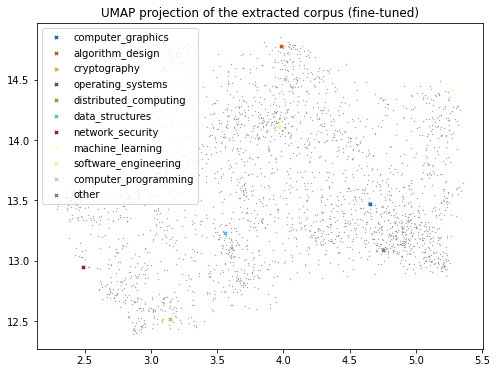

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


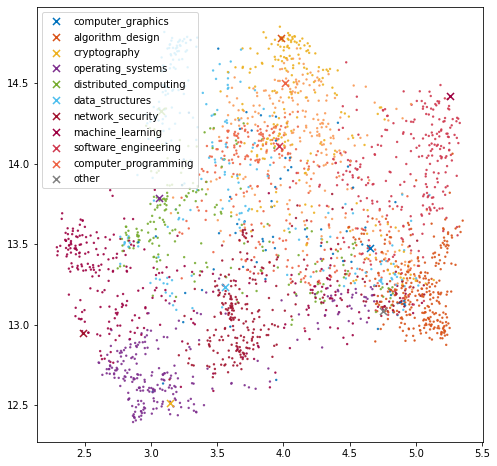

cluster size :
|-computer_graphics : 294
|-algorithm_design : 217
|-cryptography : 242
|-operating_systems : 204
|-distributed_computing : 227
|-data_structures : 269
|-network_security : 278
|-machine_learning : 267
|-software_engineering : 264
|-computer_programming : 239
|-other : 69
  |-unlabeled terms within 'other': 0


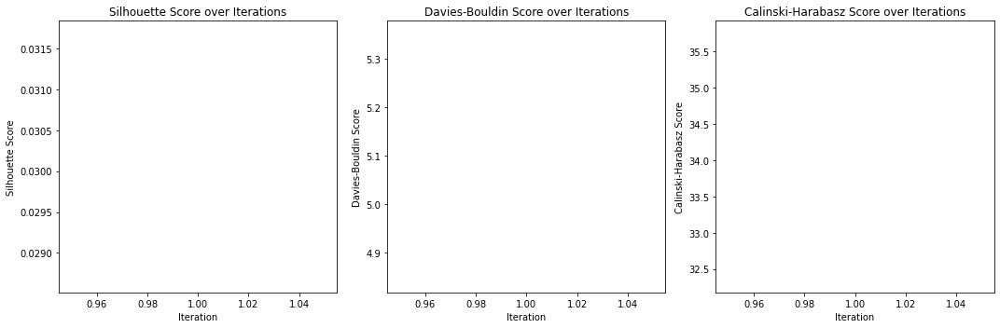

Silhouette : 0.030176705
Davies Bouldin : 5.097987269468257
Calinski Harabasz : 34.04947443334399


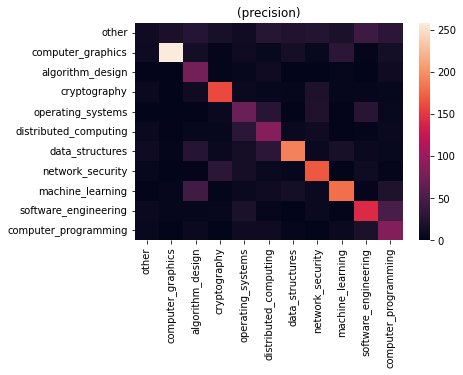

size of predicted terms: 2560
Accuracy : 0.558203125
Precision : 0.5645298471722789
Recall : 0.558203125
f1 : 0.5511555130140974
                                    Term            Prediction  \
0                 reliable_communication      network_security   
1                             classifier      machine_learning   
2  radial_basis_function_neural_networks      machine_learning   
3                          ns2_simulator  computer_programming   
4                visualization_technique     computer_graphics   

        Ground truth  
0   network_security  
1   machine_learning  
2   machine_learning  
3   network_security  
4  computer_graphics  


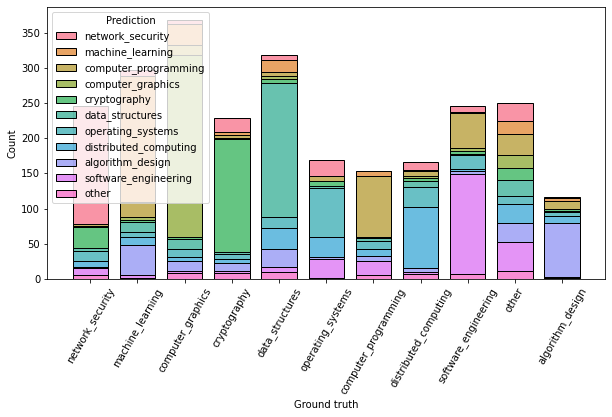

2 iterations:
['data structures', 'data_structures', 'relational_databases', 'data_storage', 'data_processing', 'structured_data', 'structured_storage', 'database', 'non-relational_database', 'data_placement', 'cryptography', 'encryption', 'quantum_cryptography', 'elliptic_curve_cryptography', 'decryption', 'cryptanalysis', 'cipher', 'secret_key', 'identity-based_cryptography', 'decoding', 'software_engineering', 'software', 'software_development', 'software_project', 'development_process', 'applications', 'web_application', 'requirements_engineering', 'software_system', 'software_development_process', 'computer_graphics', 'image_processing', 'image_segmentation', 'computer_vision', 'augmented_reality', 'image_analysis', 'object_detection', 'computer_vision_techniques', 'computed_tomography', 'image_processing_algorithm', 'network_security', 'intrusion_detection', 'network_traffic', 'wireless_sensor_networks', 'firewall', 'security_risk', 'security_issue', 'network_security_situation',

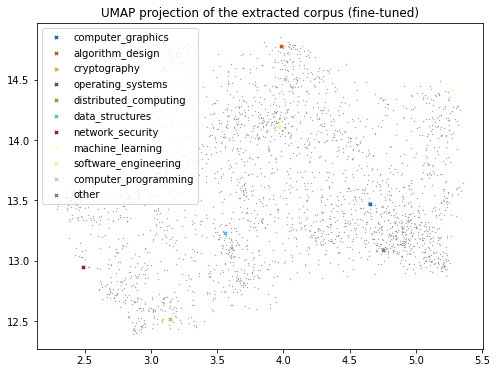

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


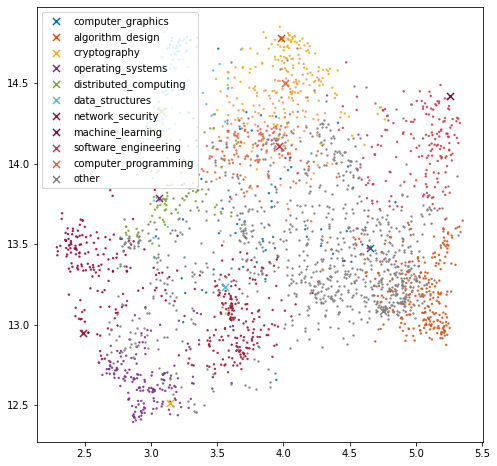

cluster size :
|-computer_graphics : 266
|-algorithm_design : 145
|-cryptography : 168
|-operating_systems : 94
|-distributed_computing : 104
|-data_structures : 200
|-network_security : 161
|-machine_learning : 176
|-software_engineering : 139
|-computer_programming : 117
|-other : 1000
  |-unlabeled terms within 'other': 934
0.3236767


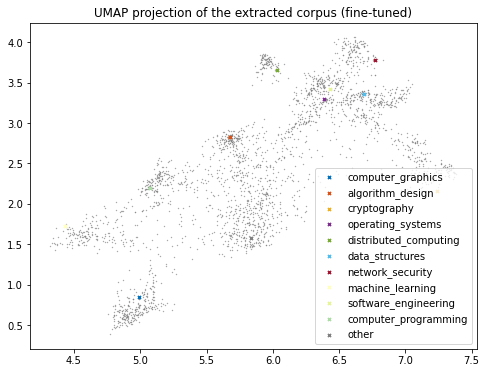

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


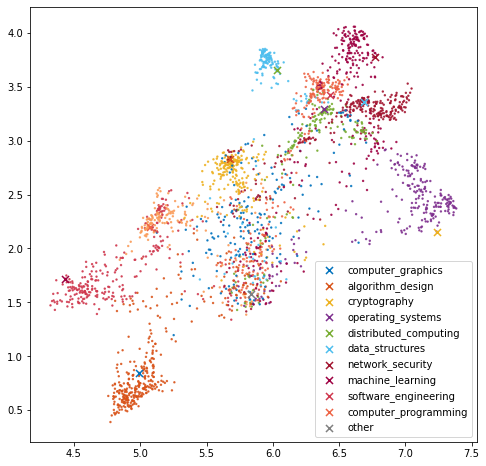

cluster size :
|-computer_graphics : 370
|-algorithm_design : 217
|-cryptography : 230
|-operating_systems : 160
|-distributed_computing : 148
|-data_structures : 281
|-network_security : 287
|-machine_learning : 278
|-software_engineering : 243
|-computer_programming : 173
|-other : 183
  |-unlabeled terms within 'other': 0


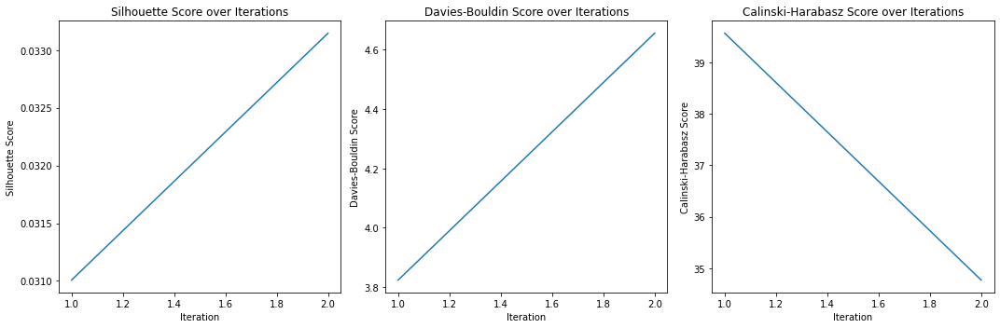

Silhouette : 0.033146203
Davies Bouldin : 4.656012385813057
Calinski Harabasz : 34.77323686723418


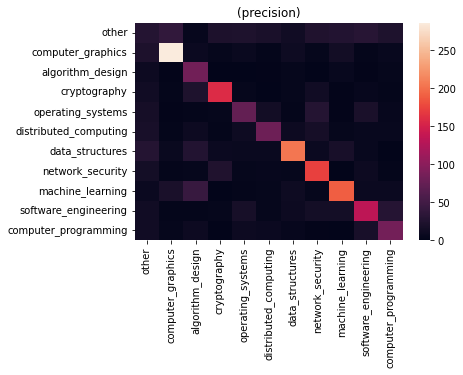

size of predicted terms: 2560
Accuracy : 0.582421875
Precision : 0.5812028897969571
Recall : 0.582421875
f1 : 0.5781385066053557
                                    Term            Prediction  \
0                 reliable_communication      network_security   
1                             classifier      machine_learning   
2  radial_basis_function_neural_networks      machine_learning   
3                          ns2_simulator  computer_programming   
4                visualization_technique     computer_graphics   

        Ground truth  
0   network_security  
1   machine_learning  
2   machine_learning  
3   network_security  
4  computer_graphics  


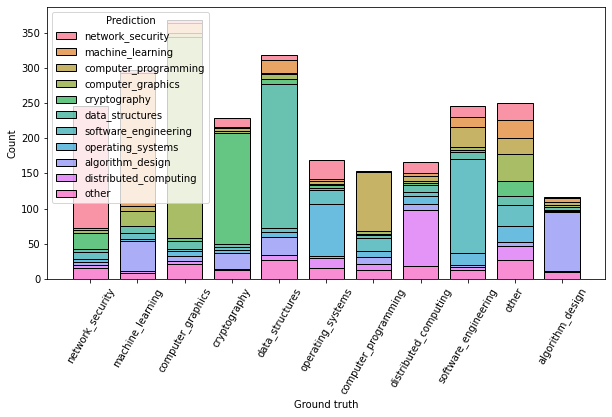

5 iterations:
['data structures', 'data_structures', 'relational_databases', 'data_storage', 'data_processing', 'structured_data', 'structured_storage', 'database', 'non-relational_database', 'data_placement', 'cryptography', 'encryption', 'quantum_cryptography', 'elliptic_curve_cryptography', 'decryption', 'cryptanalysis', 'cipher', 'secret_key', 'identity-based_cryptography', 'decoding', 'software_engineering', 'software', 'software_development', 'software_project', 'development_process', 'applications', 'web_application', 'requirements_engineering', 'software_system', 'software_development_process', 'computer_graphics', 'image_processing', 'image_segmentation', 'computer_vision', 'augmented_reality', 'image_analysis', 'object_detection', 'computer_vision_techniques', 'computed_tomography', 'image_processing_algorithm', 'network_security', 'intrusion_detection', 'network_traffic', 'wireless_sensor_networks', 'firewall', 'security_risk', 'security_issue', 'network_security_situation',

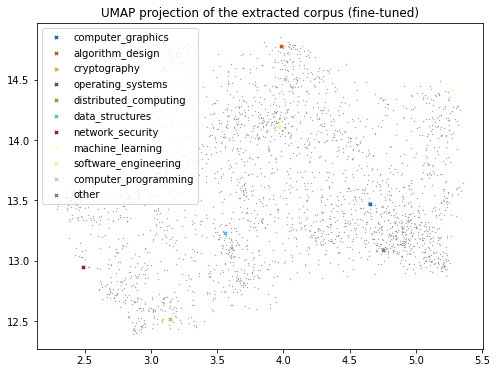

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


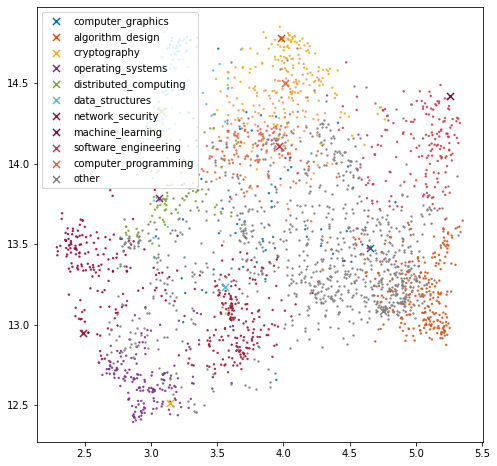

cluster size :
|-computer_graphics : 266
|-algorithm_design : 145
|-cryptography : 168
|-operating_systems : 94
|-distributed_computing : 104
|-data_structures : 200
|-network_security : 161
|-machine_learning : 176
|-software_engineering : 139
|-computer_programming : 117
|-other : 1000
  |-unlabeled terms within 'other': 934
0.45161542


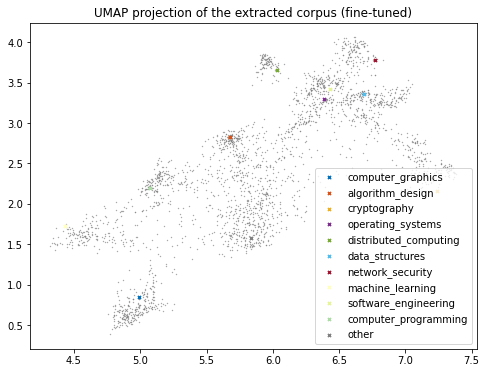

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


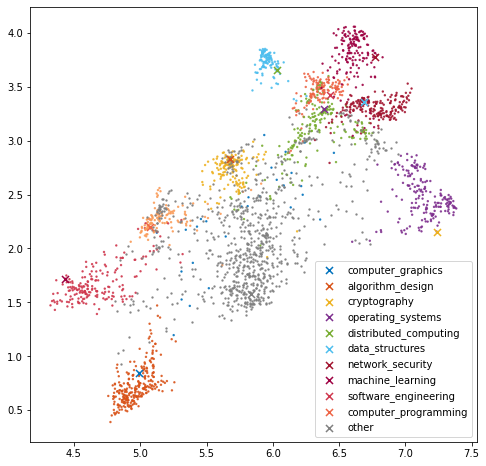

cluster size :
|-computer_graphics : 271
|-algorithm_design : 156
|-cryptography : 184
|-operating_systems : 196
|-distributed_computing : 107
|-data_structures : 202
|-network_security : 163
|-machine_learning : 192
|-software_engineering : 139
|-computer_programming : 120
|-other : 840
  |-unlabeled terms within 'other': 811
0.49496394


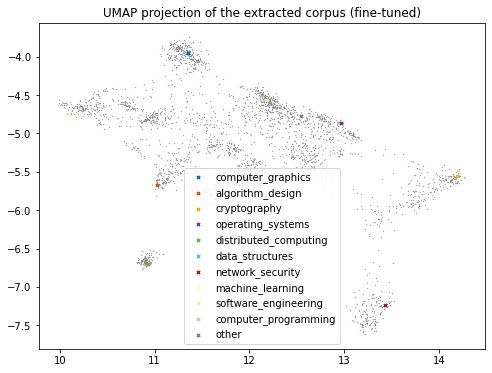

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


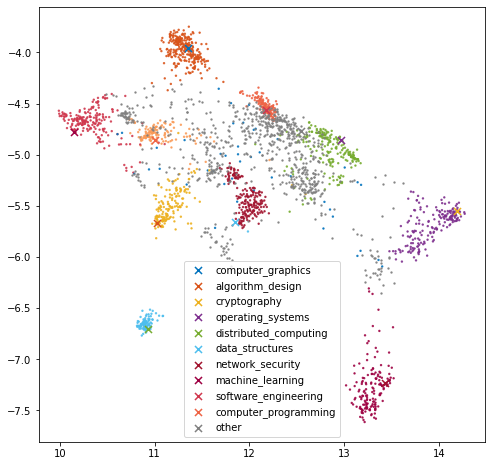

cluster size :
|-computer_graphics : 276
|-algorithm_design : 159
|-cryptography : 187
|-operating_systems : 206
|-distributed_computing : 108
|-data_structures : 204
|-network_security : 163
|-machine_learning : 198
|-software_engineering : 140
|-computer_programming : 130
|-other : 799
  |-unlabeled terms within 'other': 754
0.52373886


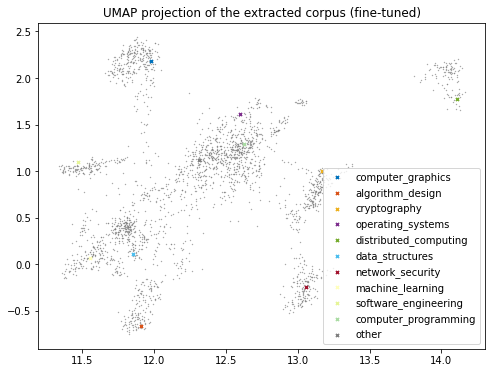

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


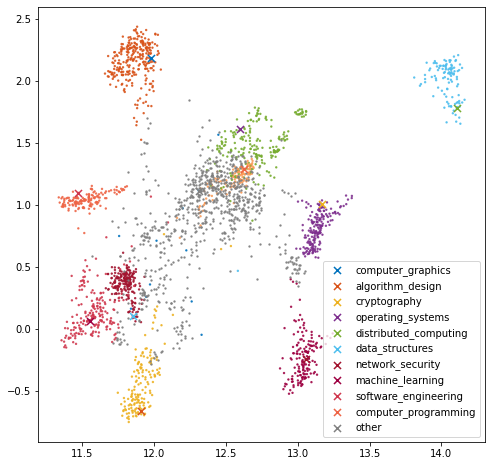

cluster size :
|-computer_graphics : 277
|-algorithm_design : 159
|-cryptography : 187
|-operating_systems : 212
|-distributed_computing : 108
|-data_structures : 205
|-network_security : 163
|-machine_learning : 202
|-software_engineering : 140
|-computer_programming : 130
|-other : 787
  |-unlabeled terms within 'other': 776
0.36501452


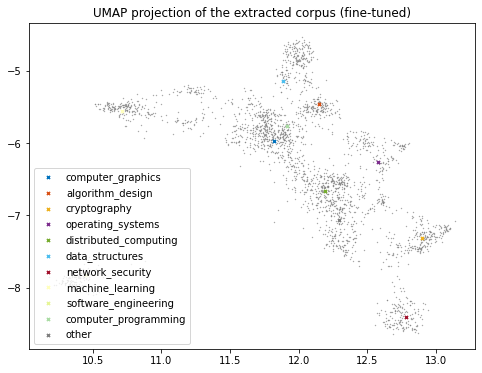

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


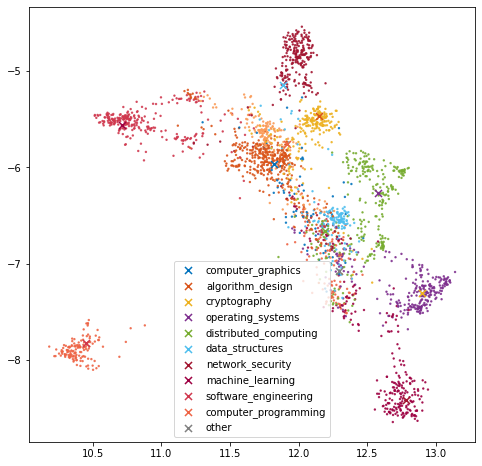

cluster size :
|-computer_graphics : 385
|-algorithm_design : 219
|-cryptography : 272
|-operating_systems : 283
|-distributed_computing : 168
|-data_structures : 250
|-network_security : 240
|-machine_learning : 268
|-software_engineering : 245
|-computer_programming : 173
|-other : 67
  |-unlabeled terms within 'other': 0


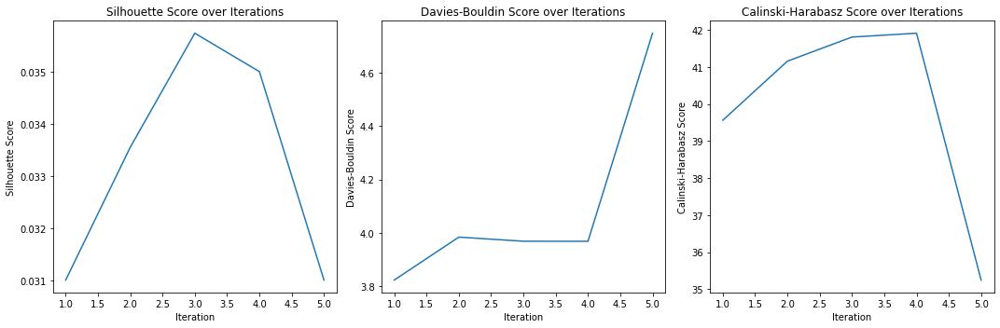

Silhouette : 0.031007297
Davies Bouldin : 4.746628697704801
Calinski Harabasz : 35.24632397162915


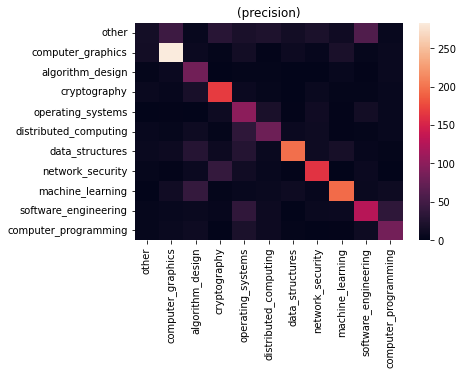

size of predicted terms: 2560
Accuracy : 0.5828125
Precision : 0.5826974549519959
Recall : 0.5828125
f1 : 0.5715091749311431
                                    Term            Prediction  \
0                 reliable_communication      network_security   
1                             classifier      machine_learning   
2  radial_basis_function_neural_networks      machine_learning   
3                          ns2_simulator  computer_programming   
4                visualization_technique     computer_graphics   

        Ground truth  
0   network_security  
1   machine_learning  
2   machine_learning  
3   network_security  
4  computer_graphics  


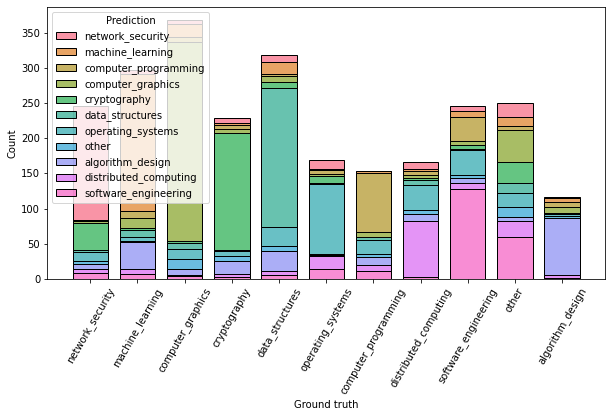

10 iterations:
['data structures', 'data_structures', 'relational_databases', 'data_storage', 'data_processing', 'structured_data', 'structured_storage', 'database', 'non-relational_database', 'data_placement', 'cryptography', 'encryption', 'quantum_cryptography', 'elliptic_curve_cryptography', 'decryption', 'cryptanalysis', 'cipher', 'secret_key', 'identity-based_cryptography', 'decoding', 'software_engineering', 'software', 'software_development', 'software_project', 'development_process', 'applications', 'web_application', 'requirements_engineering', 'software_system', 'software_development_process', 'computer_graphics', 'image_processing', 'image_segmentation', 'computer_vision', 'augmented_reality', 'image_analysis', 'object_detection', 'computer_vision_techniques', 'computed_tomography', 'image_processing_algorithm', 'network_security', 'intrusion_detection', 'network_traffic', 'wireless_sensor_networks', 'firewall', 'security_risk', 'security_issue', 'network_security_situation'

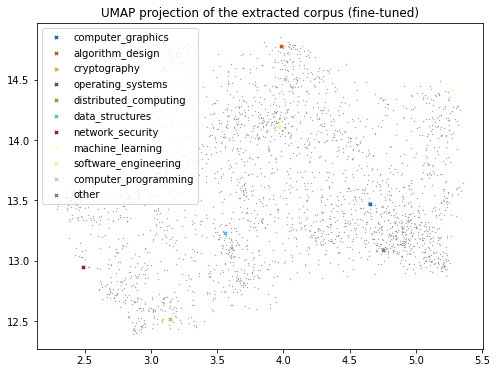

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


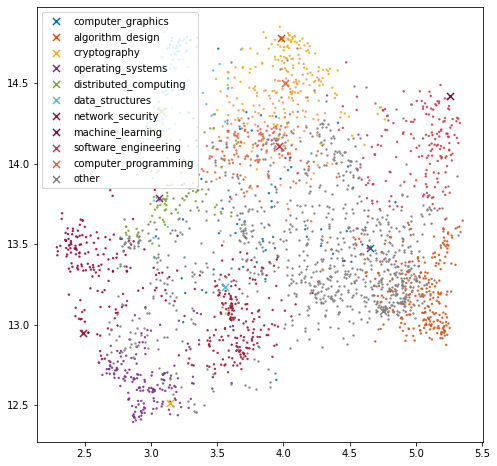

cluster size :
|-computer_graphics : 266
|-algorithm_design : 145
|-cryptography : 168
|-operating_systems : 94
|-distributed_computing : 104
|-data_structures : 200
|-network_security : 161
|-machine_learning : 176
|-software_engineering : 139
|-computer_programming : 117
|-other : 1000
  |-unlabeled terms within 'other': 934
0.45161542


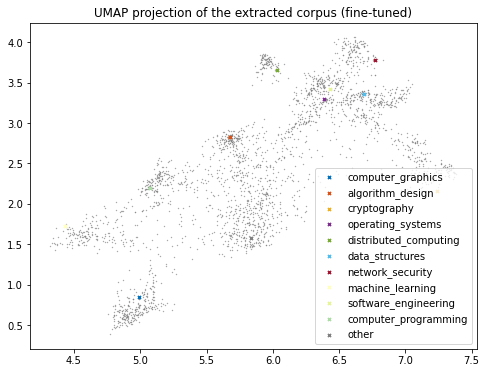

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


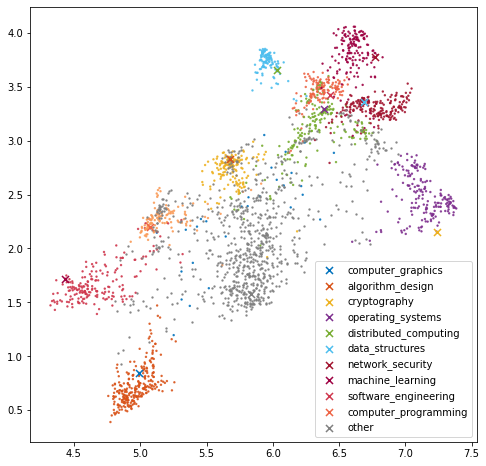

cluster size :
|-computer_graphics : 271
|-algorithm_design : 156
|-cryptography : 184
|-operating_systems : 196
|-distributed_computing : 107
|-data_structures : 202
|-network_security : 163
|-machine_learning : 192
|-software_engineering : 139
|-computer_programming : 120
|-other : 840
  |-unlabeled terms within 'other': 811
0.49496394


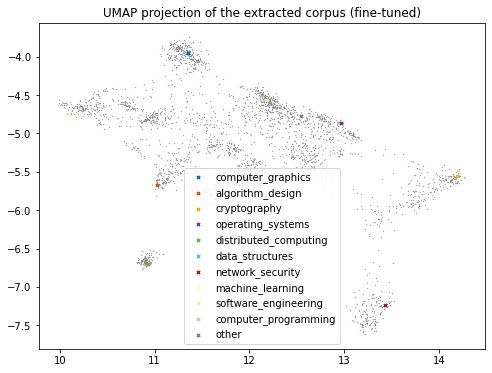

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


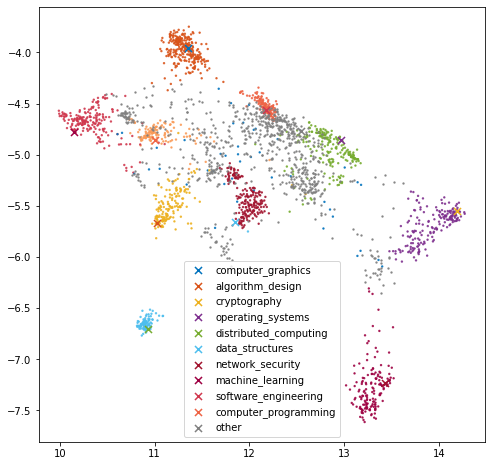

cluster size :
|-computer_graphics : 276
|-algorithm_design : 159
|-cryptography : 187
|-operating_systems : 206
|-distributed_computing : 108
|-data_structures : 204
|-network_security : 163
|-machine_learning : 198
|-software_engineering : 140
|-computer_programming : 130
|-other : 799
  |-unlabeled terms within 'other': 754
0.52373886


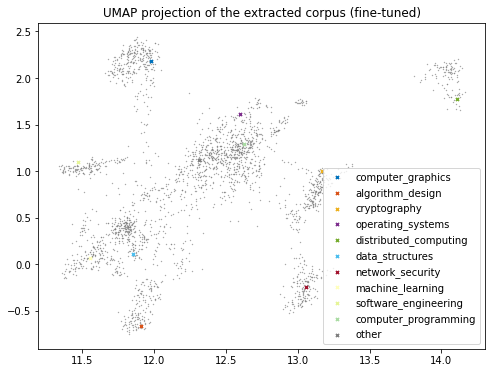

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


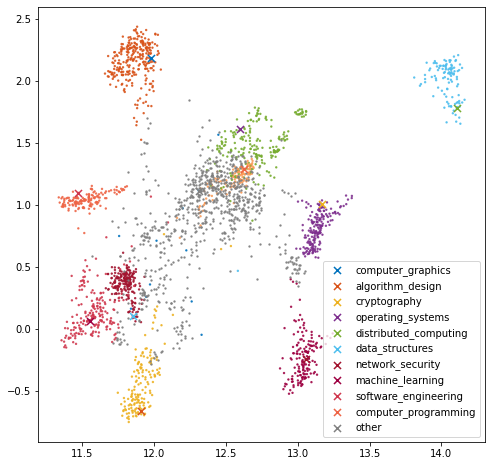

cluster size :
|-computer_graphics : 277
|-algorithm_design : 159
|-cryptography : 187
|-operating_systems : 212
|-distributed_computing : 108
|-data_structures : 205
|-network_security : 163
|-machine_learning : 202
|-software_engineering : 140
|-computer_programming : 130
|-other : 787
  |-unlabeled terms within 'other': 776
0.51253116


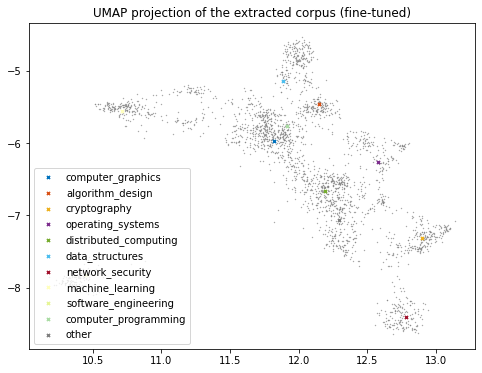

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


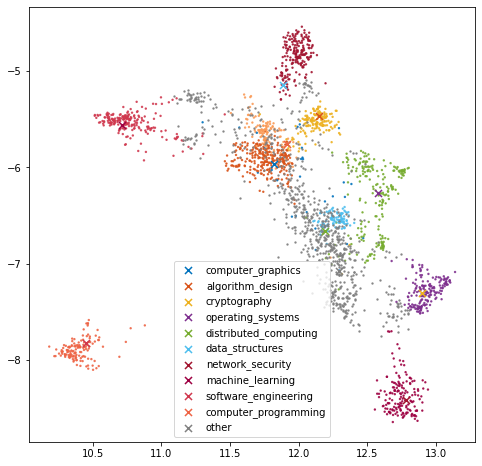

cluster size :
|-computer_graphics : 277
|-algorithm_design : 159
|-cryptography : 187
|-operating_systems : 212
|-distributed_computing : 108
|-data_structures : 206
|-network_security : 163
|-machine_learning : 206
|-software_engineering : 140
|-computer_programming : 130
|-other : 782
  |-unlabeled terms within 'other': 753
0.52760625


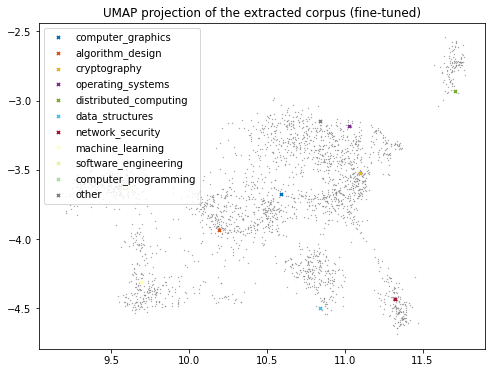

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


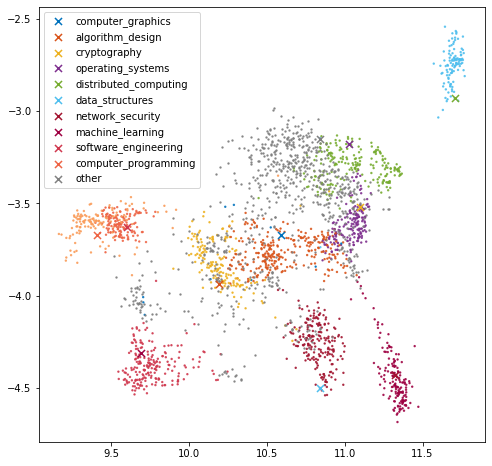

cluster size :
|-computer_graphics : 278
|-algorithm_design : 164
|-cryptography : 187
|-operating_systems : 214
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 208
|-software_engineering : 140
|-computer_programming : 130
|-other : 769
  |-unlabeled terms within 'other': 758
0.52335227


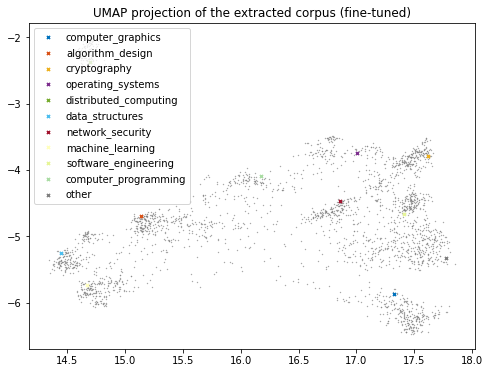

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


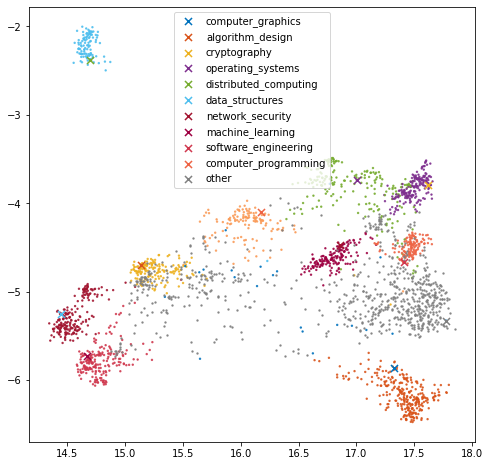

cluster size :
|-computer_graphics : 280
|-algorithm_design : 164
|-cryptography : 187
|-operating_systems : 215
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 208
|-software_engineering : 140
|-computer_programming : 130
|-other : 766
  |-unlabeled terms within 'other': 744
0.526611


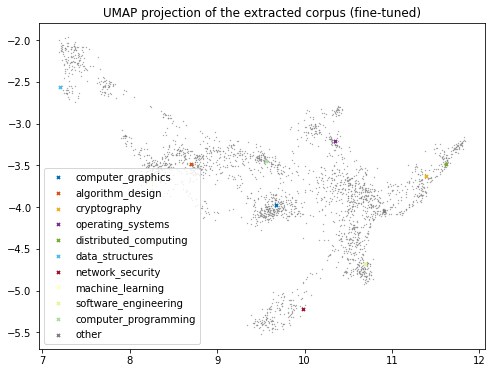

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


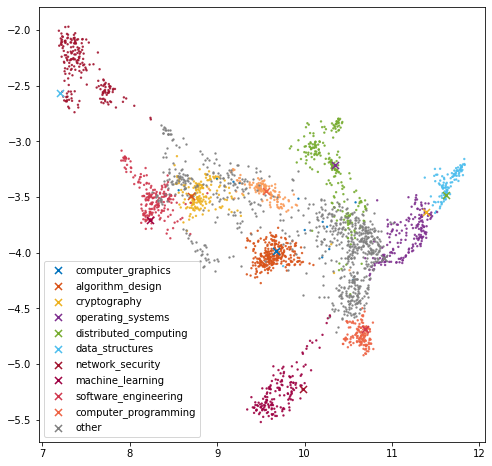

cluster size :
|-computer_graphics : 281
|-algorithm_design : 164
|-cryptography : 190
|-operating_systems : 219
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 208
|-software_engineering : 140
|-computer_programming : 130
|-other : 758
  |-unlabeled terms within 'other': 744
0.5470308


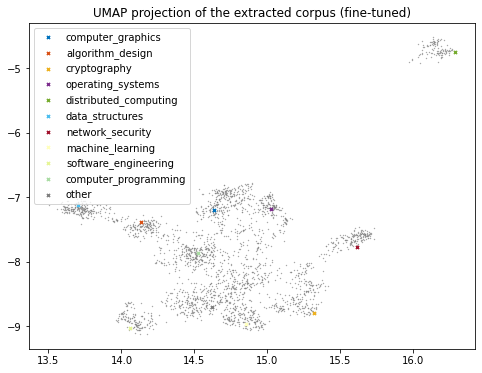

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


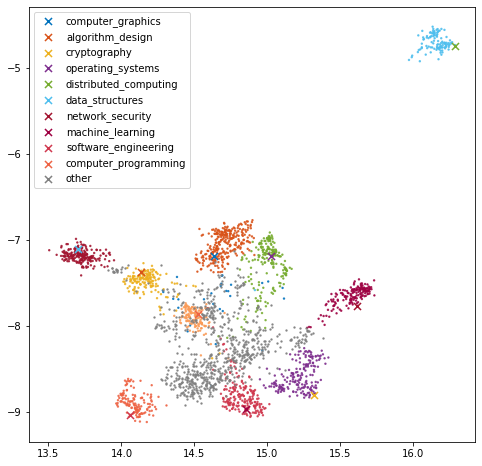

cluster size :
|-computer_graphics : 283
|-algorithm_design : 164
|-cryptography : 193
|-operating_systems : 219
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 208
|-software_engineering : 140
|-computer_programming : 135
|-other : 748
  |-unlabeled terms within 'other': 719
0.37427104


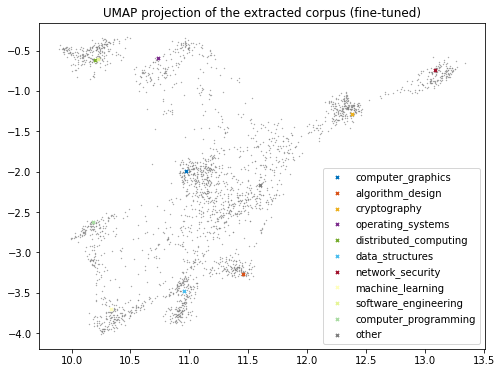

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


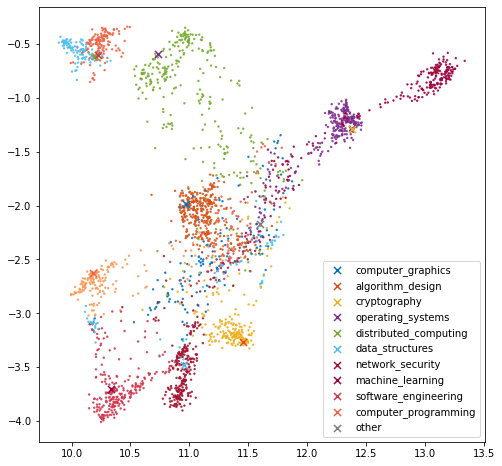

cluster size :
|-computer_graphics : 329
|-algorithm_design : 202
|-cryptography : 268
|-operating_systems : 295
|-distributed_computing : 178
|-data_structures : 276
|-network_security : 243
|-machine_learning : 261
|-software_engineering : 218
|-computer_programming : 169
|-other : 131
  |-unlabeled terms within 'other': 0


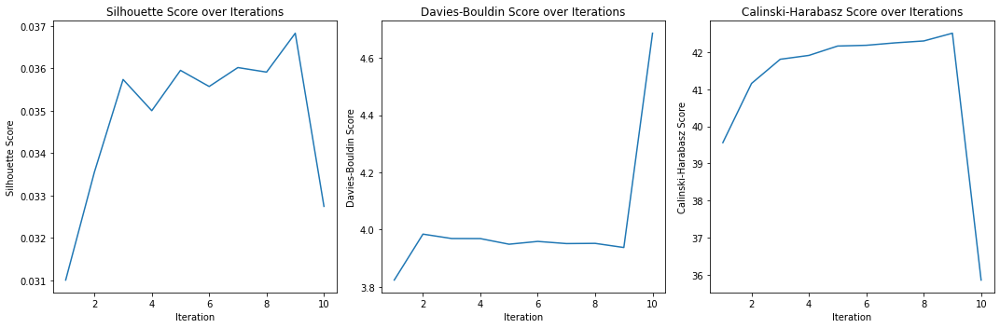

Silhouette : 0.032745335
Davies Bouldin : 4.686542805967315
Calinski Harabasz : 35.86277845901584


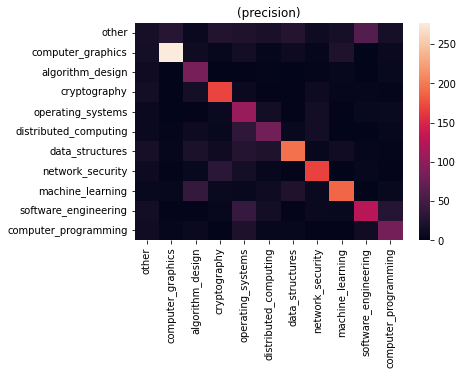

size of predicted terms: 2560
Accuracy : 0.583203125
Precision : 0.5870559601547677
Recall : 0.583203125
f1 : 0.5780585211961163
                                    Term            Prediction  \
0                 reliable_communication      network_security   
1                             classifier      machine_learning   
2  radial_basis_function_neural_networks      machine_learning   
3                          ns2_simulator  computer_programming   
4                visualization_technique     computer_graphics   

        Ground truth  
0   network_security  
1   machine_learning  
2   machine_learning  
3   network_security  
4  computer_graphics  


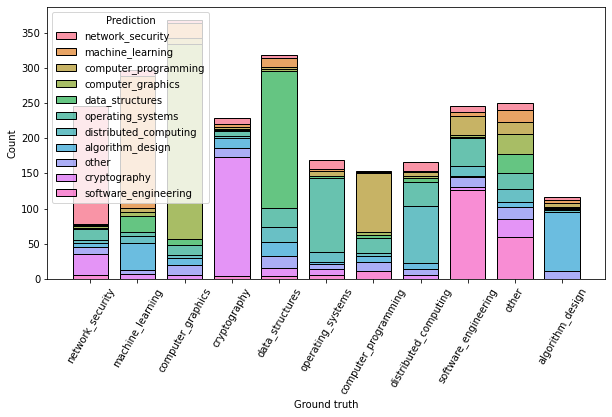

15 iterations:
['data structures', 'data_structures', 'relational_databases', 'data_storage', 'data_processing', 'structured_data', 'structured_storage', 'database', 'non-relational_database', 'data_placement', 'cryptography', 'encryption', 'quantum_cryptography', 'elliptic_curve_cryptography', 'decryption', 'cryptanalysis', 'cipher', 'secret_key', 'identity-based_cryptography', 'decoding', 'software_engineering', 'software', 'software_development', 'software_project', 'development_process', 'applications', 'web_application', 'requirements_engineering', 'software_system', 'software_development_process', 'computer_graphics', 'image_processing', 'image_segmentation', 'computer_vision', 'augmented_reality', 'image_analysis', 'object_detection', 'computer_vision_techniques', 'computed_tomography', 'image_processing_algorithm', 'network_security', 'intrusion_detection', 'network_traffic', 'wireless_sensor_networks', 'firewall', 'security_risk', 'security_issue', 'network_security_situation'

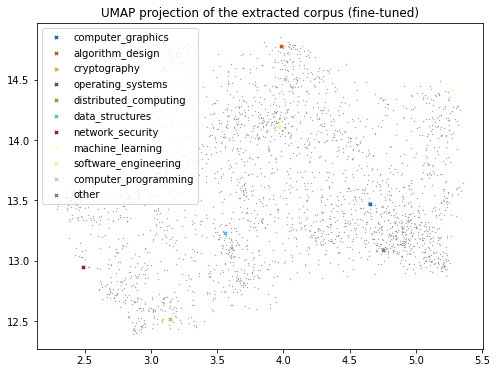

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


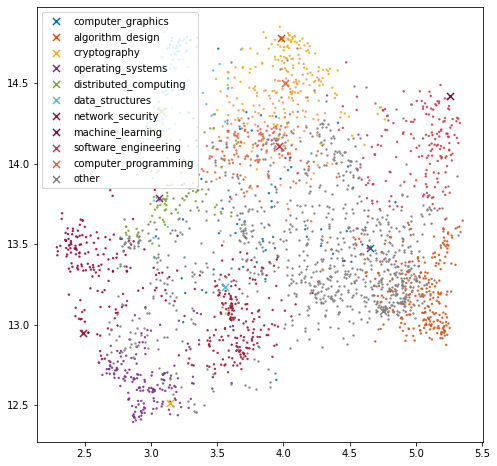

cluster size :
|-computer_graphics : 266
|-algorithm_design : 145
|-cryptography : 168
|-operating_systems : 94
|-distributed_computing : 104
|-data_structures : 200
|-network_security : 161
|-machine_learning : 176
|-software_engineering : 139
|-computer_programming : 117
|-other : 1000
  |-unlabeled terms within 'other': 934
0.45161542


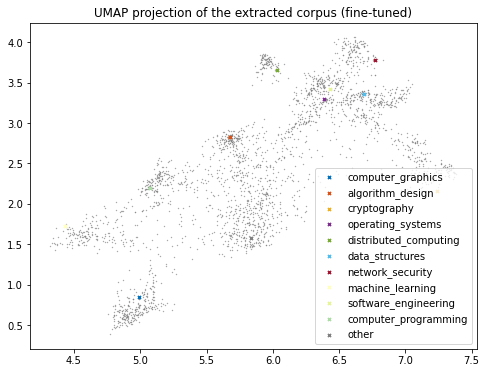

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


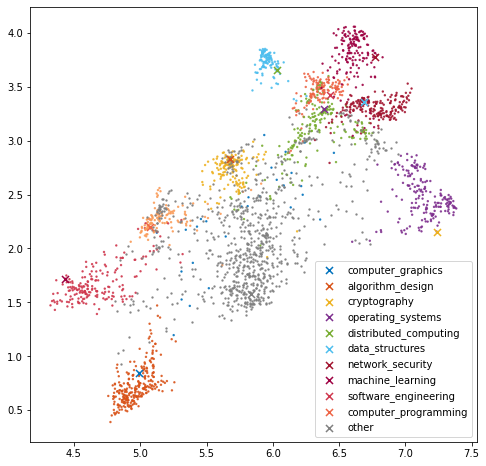

cluster size :
|-computer_graphics : 271
|-algorithm_design : 156
|-cryptography : 184
|-operating_systems : 196
|-distributed_computing : 107
|-data_structures : 202
|-network_security : 163
|-machine_learning : 192
|-software_engineering : 139
|-computer_programming : 120
|-other : 840
  |-unlabeled terms within 'other': 811
0.49496394


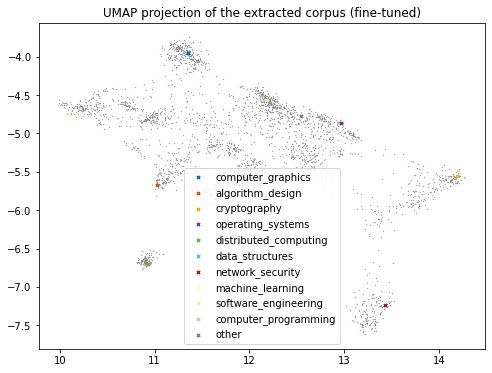

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


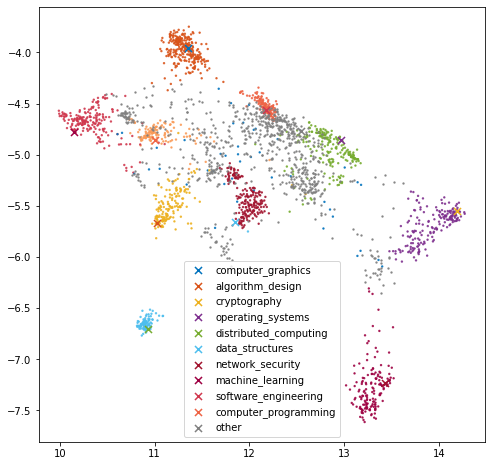

cluster size :
|-computer_graphics : 276
|-algorithm_design : 159
|-cryptography : 187
|-operating_systems : 206
|-distributed_computing : 108
|-data_structures : 204
|-network_security : 163
|-machine_learning : 198
|-software_engineering : 140
|-computer_programming : 130
|-other : 799
  |-unlabeled terms within 'other': 754
0.52373886


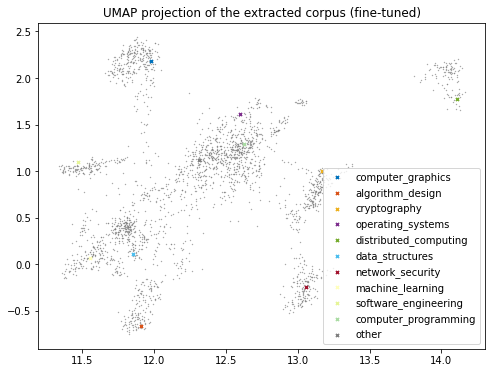

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


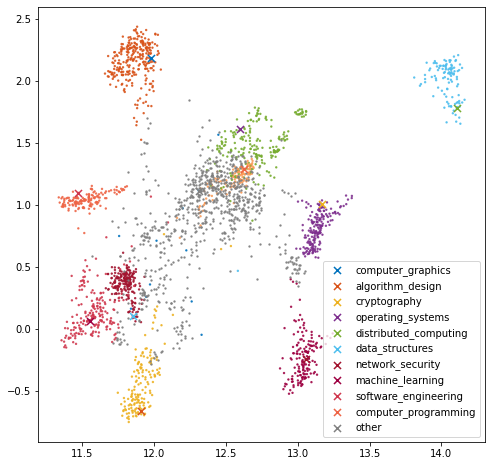

cluster size :
|-computer_graphics : 277
|-algorithm_design : 159
|-cryptography : 187
|-operating_systems : 212
|-distributed_computing : 108
|-data_structures : 205
|-network_security : 163
|-machine_learning : 202
|-software_engineering : 140
|-computer_programming : 130
|-other : 787
  |-unlabeled terms within 'other': 776
0.51253116


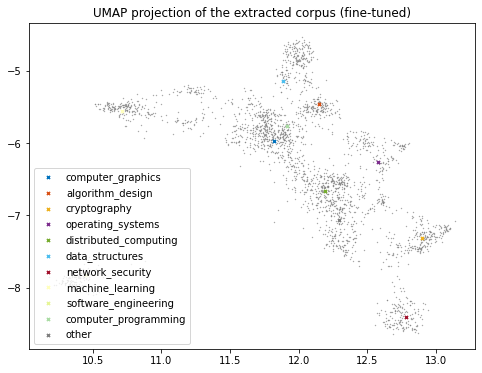

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


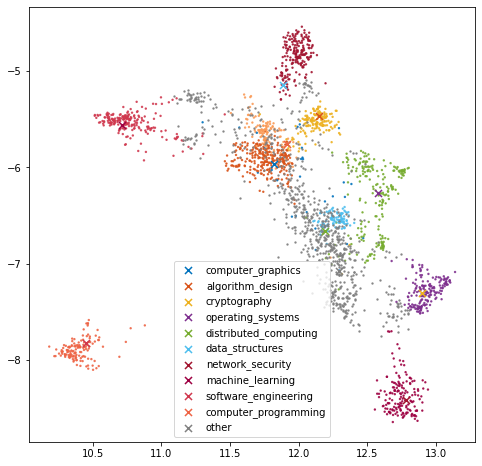

cluster size :
|-computer_graphics : 277
|-algorithm_design : 159
|-cryptography : 187
|-operating_systems : 212
|-distributed_computing : 108
|-data_structures : 206
|-network_security : 163
|-machine_learning : 206
|-software_engineering : 140
|-computer_programming : 130
|-other : 782
  |-unlabeled terms within 'other': 753
0.52760625


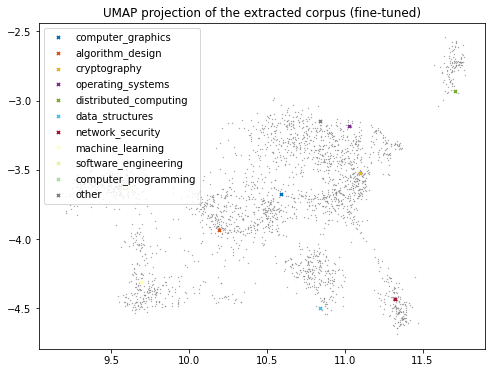

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


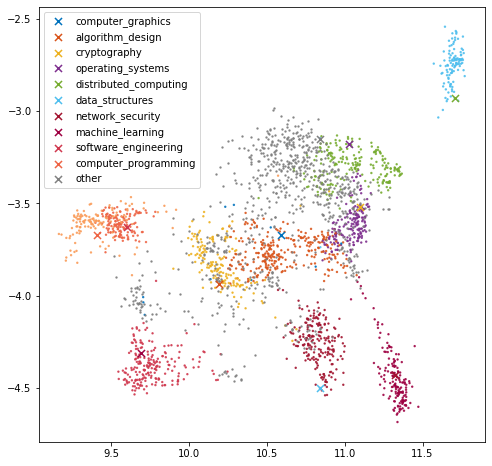

cluster size :
|-computer_graphics : 278
|-algorithm_design : 164
|-cryptography : 187
|-operating_systems : 214
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 208
|-software_engineering : 140
|-computer_programming : 130
|-other : 769
  |-unlabeled terms within 'other': 758
0.52335227


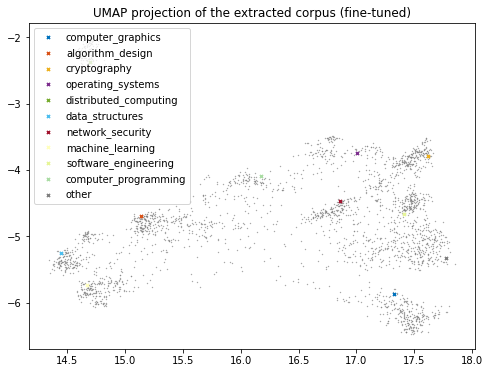

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


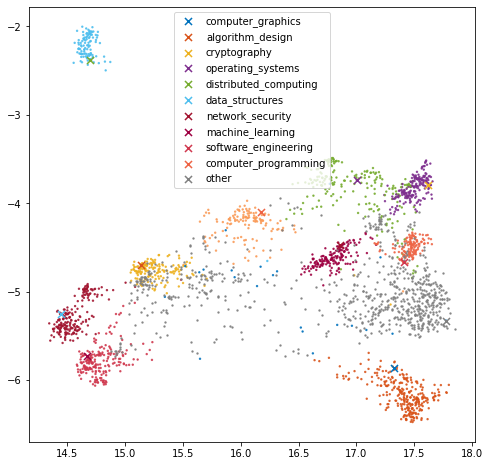

cluster size :
|-computer_graphics : 280
|-algorithm_design : 164
|-cryptography : 187
|-operating_systems : 215
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 208
|-software_engineering : 140
|-computer_programming : 130
|-other : 766
  |-unlabeled terms within 'other': 744
0.526611


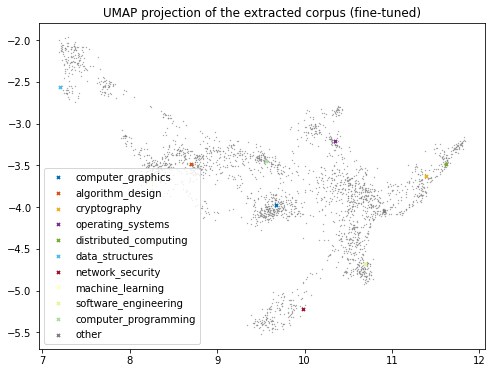

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


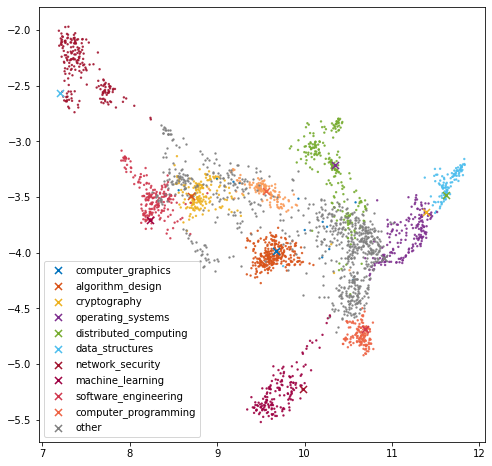

cluster size :
|-computer_graphics : 281
|-algorithm_design : 164
|-cryptography : 190
|-operating_systems : 219
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 208
|-software_engineering : 140
|-computer_programming : 130
|-other : 758
  |-unlabeled terms within 'other': 744
0.5470308


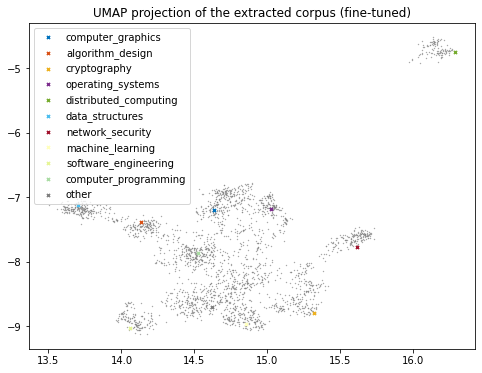

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


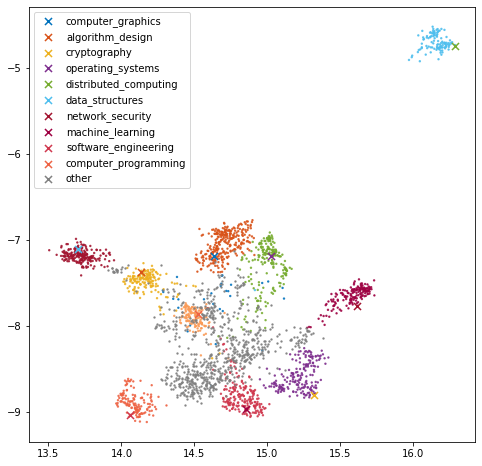

cluster size :
|-computer_graphics : 283
|-algorithm_design : 164
|-cryptography : 193
|-operating_systems : 219
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 208
|-software_engineering : 140
|-computer_programming : 135
|-other : 748
  |-unlabeled terms within 'other': 719
0.54904383


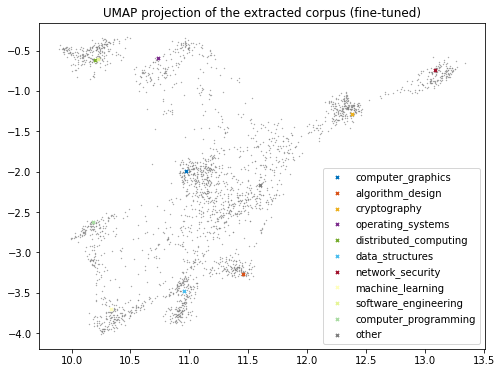

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


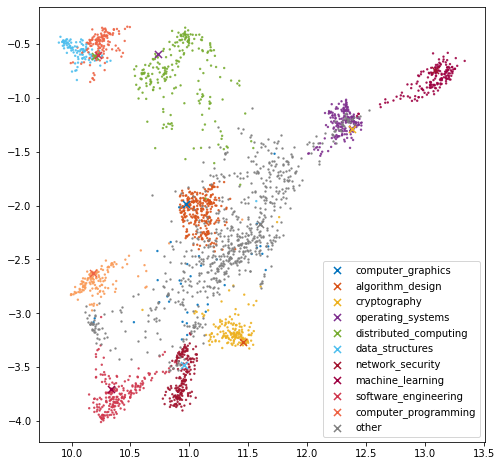

cluster size :
|-computer_graphics : 284
|-algorithm_design : 164
|-cryptography : 195
|-operating_systems : 219
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 208
|-software_engineering : 140
|-computer_programming : 135
|-other : 745
  |-unlabeled terms within 'other': 709
0.5405636


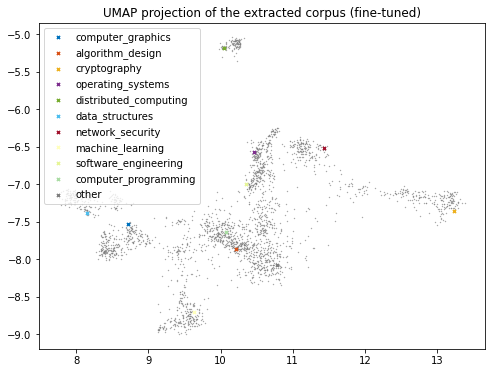

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


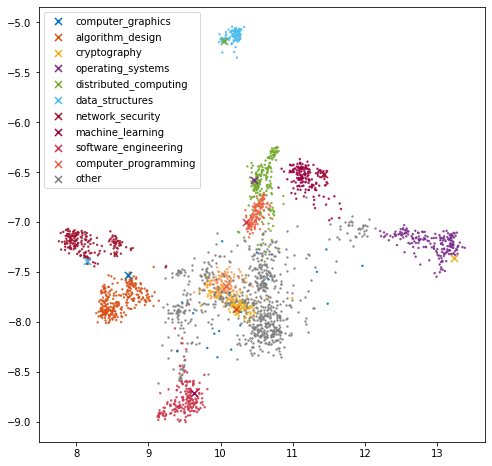

cluster size :
|-computer_graphics : 285
|-algorithm_design : 164
|-cryptography : 195
|-operating_systems : 219
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 208
|-software_engineering : 140
|-computer_programming : 135
|-other : 744
  |-unlabeled terms within 'other': 723
0.54504603


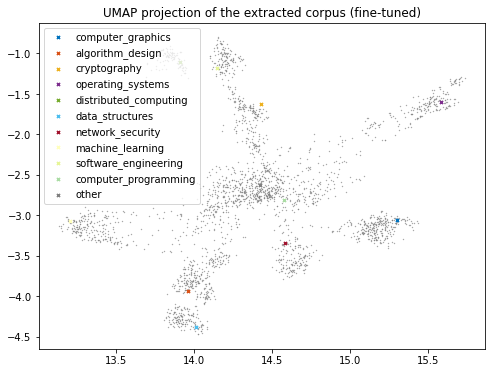

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


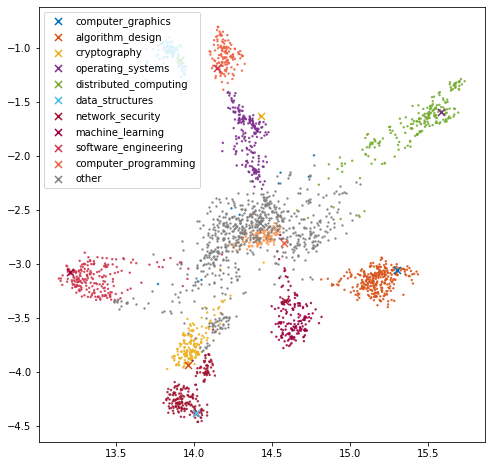

cluster size :
|-computer_graphics : 285
|-algorithm_design : 164
|-cryptography : 195
|-operating_systems : 219
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 213
|-software_engineering : 140
|-computer_programming : 135
|-other : 739
  |-unlabeled terms within 'other': 728
0.5588798


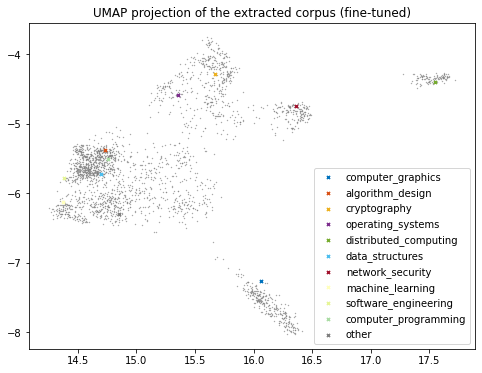

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


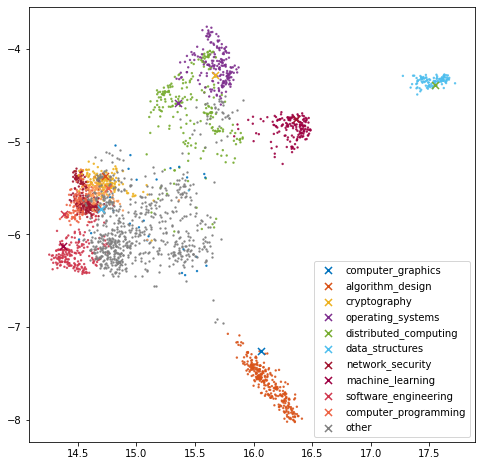

cluster size :
|-computer_graphics : 285
|-algorithm_design : 164
|-cryptography : 195
|-operating_systems : 219
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 214
|-software_engineering : 140
|-computer_programming : 137
|-other : 736
  |-unlabeled terms within 'other': 709
0.54160917


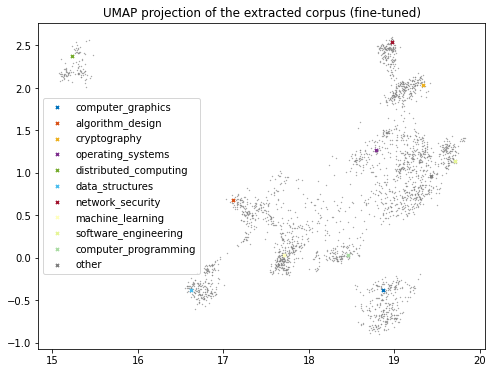

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


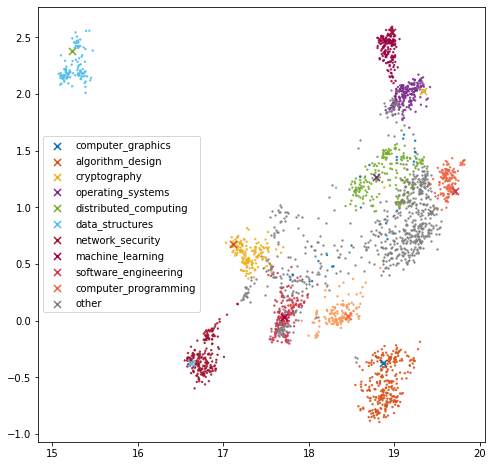

cluster size :
|-computer_graphics : 285
|-algorithm_design : 164
|-cryptography : 195
|-operating_systems : 219
|-distributed_computing : 109
|-data_structures : 206
|-network_security : 165
|-machine_learning : 214
|-software_engineering : 140
|-computer_programming : 137
|-other : 736
  |-unlabeled terms within 'other': 709
0.37175244


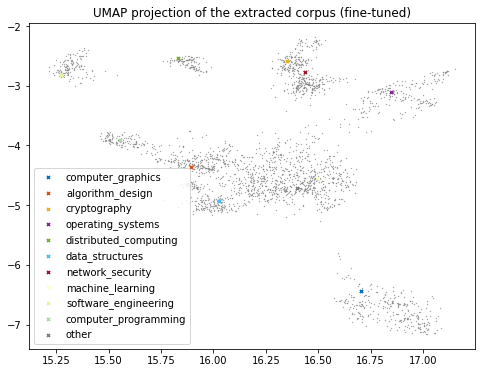

C:\Users\10258\AppData\Roaming\Python\Python39\site-packages\matplotlib\cbook\__init__.py:1026: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


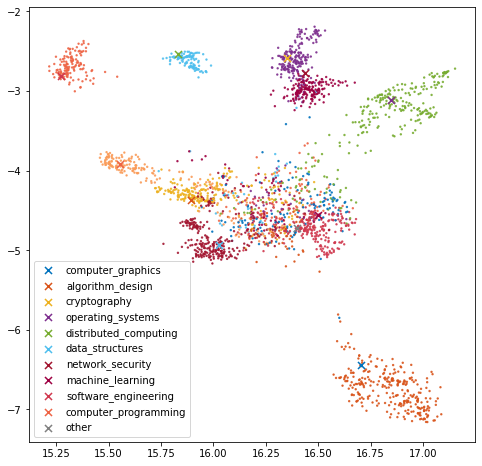

cluster size :
|-computer_graphics : 341
|-algorithm_design : 231
|-cryptography : 240
|-operating_systems : 271
|-distributed_computing : 146
|-data_structures : 281
|-network_security : 237
|-machine_learning : 264
|-software_engineering : 234
|-computer_programming : 195
|-other : 130
  |-unlabeled terms within 'other': 0


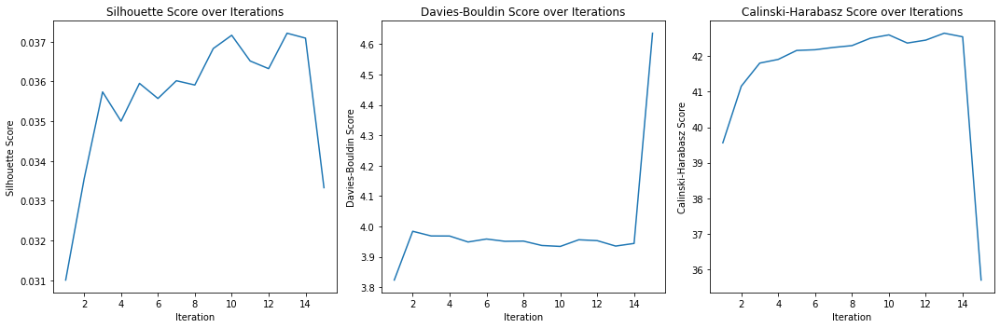

Silhouette : 0.03332962
Davies Bouldin : 4.636147257145426
Calinski Harabasz : 35.695244139372406


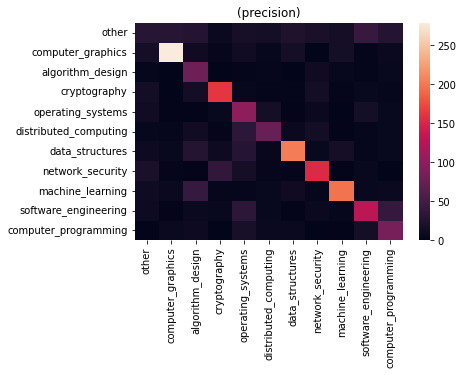

size of predicted terms: 2560
Accuracy : 0.58203125
Precision : 0.5929180467959209
Recall : 0.58203125
f1 : 0.5801364561954843
                                    Term            Prediction  \
0                 reliable_communication      network_security   
1                             classifier      machine_learning   
2  radial_basis_function_neural_networks      machine_learning   
3                          ns2_simulator  computer_programming   
4                visualization_technique     computer_graphics   

        Ground truth  
0   network_security  
1   machine_learning  
2   machine_learning  
3   network_security  
4  computer_graphics  


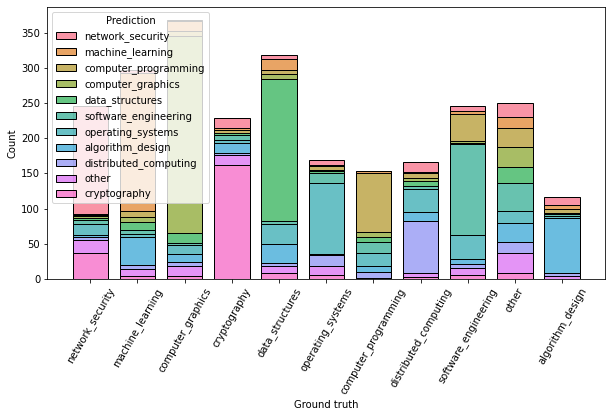


Summary:
    Accuracy  Precision    Recall        F1  Silhouette  Davies Bouldin  \
1   0.558203   0.564530  0.558203  0.551156    0.030177        5.097987   
2   0.582422   0.581203  0.582422  0.578139    0.033146        4.656012   
5   0.582812   0.582697  0.582812  0.571509    0.031007        4.746629   
10  0.583203   0.587056  0.583203  0.578059    0.032745        4.686543   
15  0.582031   0.592918  0.582031  0.580136    0.033330        4.636147   

    Calinski Harabasz  
1           34.049474  
2           34.773237  
5           35.246324  
10          35.862778  
15          35.695244  


In [26]:
df=run_and_store_results(corpus_name="cs",min_points=4,dimensions=10,clusterer="c-dbscan",reducer="umap")